In [1]:
import os
os.chdir(r'C:\Users\jfran\OneDrive\Documentos\MCD\Regresion Avanzada\Datos para TPs')

In [2]:
# Funciones

def calcular_vif(data_frame):
    variables = data_frame.values
    vif_data = pd.DataFrame()
    vif_data["Variable"] = data_frame.columns
    vif_data["VIF"] = [variance_inflation_factor(variables, i) for i in range(variables.shape[1])]
    return vif_data

def forward_selection_aic(X, y):
    """
    Realiza la selección de variables hacia adelante utilizando el criterio de AIC.

    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.

    Returns:
    - selected_features: Lista de nombres de las variables seleccionadas.
    """

    features = list(X.columns)
    selected_features = []
    best_aic = np.inf

    while features:
        aic_values = []
        for feature in features:
            model = sm.OLS(y, sm.add_constant(X[selected_features + [feature]])).fit()
            aic = model.aic
            aic_values.append((feature, aic))

        best_feature, min_aic = min(aic_values, key=lambda x: x[1])

        if min_aic < best_aic:
            selected_features.append(best_feature)
            best_aic = min_aic
        else:
            break

    return selected_features

def backward_selected(X, y):
    """
    Realiza la selección de variables hacia atrás utilizando el criterio de R2 ajustado.

    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.

    Returns:
    - model: Modelo ajustado con las variables seleccionadas.
    """

    features = list(X.columns)
    while features:
        X_temp = sm.add_constant(X[features])
        model = sm.OLS(y, X_temp).fit()
        adj_r2 = model.rsquared_adj
        p_values = model.pvalues.iloc[1:]

        # Encontrar la variable con el p-valor más alto
        max_p_value = p_values.max()
        if max_p_value > 0.05:
            exclude_feature = p_values.idxmax()
            features.remove(exclude_feature)
        else:
            break

    # Imprimir las variables seleccionadas
    print("Variables seleccionadas:", features)
    model = sm.OLS(y, sm.add_constant(X[features])).fit()
    return model

def all_subsets(X, y, n=None):
    """
    Obtiene todas las regresiones posibles utilizando combinaciones de variables predictoras.
    
    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.
    - n: Número máximo de predictores a utilizar (por defecto, utiliza todos los predictores disponibles).
    
    Returns:
    - results: Lista de modelos ajustados para cada combinación de variables.
    """
    results = []
    all_features = list(X.columns)
    
    if n is None:
        n = len(all_features)
    
    for k in range(1, min(n, len(all_features)) + 1):
        subsets = combinations(all_features, k)
        for subset in subsets:
            model = sm.OLS(y, sm.add_constant(X[list(subset)])).fit()
            results.append(model)
    
    return results

def visualize_results(todos_los_modelos):
    """
    Visualiza los resultados de las regresiones.

    Parameters:
    - results: Lista de modelos ajustados.
    """
    # Calcular el error cuadrático medio (RMSE) para cada modelo
    rmses = [model.mse_resid for model in todos_los_modelos]

    # Crear un gráfico con el RMSE en función del número de modelo
    plt.plot(range(1, len(todos_los_modelos) + 1), rmses, label='rmses')
    plt.xlabel("Número de modelo")
    plt.ylabel("Métricas")

    # Agregar las otras variables
    bics = [model.bic for model in todos_los_modelos]
    ais = [model.aic for model in todos_los_modelos]
    adj_rs = [model.rsquared_adj for model in todos_los_modelos]
    cps = [model.ssr / model.mse_resid - model.nobs + 2 * (len(model.params)) for model in todos_los_modelos] # Cp = RSSp/S2 – N + 2(P+1)
    
    plt.plot(range(1, len(todos_los_modelos) + 1), bics, label="BIC")
    plt.plot(range(1, len(todos_los_modelos) + 1), ais, label="AIC")
    plt.plot(range(1, len(todos_los_modelos) + 1), adj_rs, label="R2 ajustado")
    plt.plot(range(1, len(todos_los_modelos) + 1), cps, label="CP")

    plt.legend()
    plt.show()


# 1.1. Correlación

## Ejercicio 1.1.

En el archivo `grasacerdos.xlsx` se encuentran los datos del peso vivo (PV, en Kg) y al espesor de grasa dorsal (EGD, en mm) de 30 lechones elegidos al azar de una población de porcinos Duroc Jersey del Oeste de la provincia de Buenos Aires. Se pide:

### (a) Dibujar el diagrama de dispersión e interpretarlo.

### (b) Calcular el coeficiente de correlación muestral y explíquelo.

### (c) ¿Hay suficiente evidencia para admitir asociación entre el peso y el espesor de grasa? (α = 0,05). Verifique los supuestos para decidir el indicador que va a utilizar.


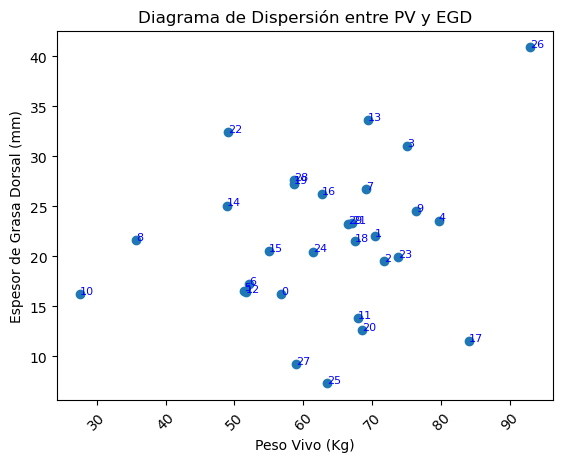

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Cargar los datos desde el archivo Excel
df = pd.read_excel('grasacerdos.xlsx', decimal=',')

# Agregar etiquetas de observación
for i, row in df.iterrows():
    plt.annotate(i, (row['PV'], row['EGD']), fontsize=8, color='blue')

# Crear el diagrama de dispersión
plt.scatter(df['PV'], df['EGD'])
plt.xlabel('Peso Vivo (Kg)')
plt.ylabel('Espesor de Grasa Dorsal (mm)')
plt.title('Diagrama de Dispersión entre PV y EGD')
plt.xticks(rotation=45)

plt.show()


In [3]:
# Calcular el coeficiente de correlación
correlation_coefficient = np.corrcoef(df['PV'], df['EGD'])[0, 1] # Sin el [] devuelve la matriz de correlaciónes
print(f"Coeficiente de correlación: {correlation_coefficient:.2f}") # Correlación baja, mucha aleatoriedad

Coeficiente de correlación: 0.25


In [4]:
from scipy.stats import pearsonr

# Realizar el test de correlación y obtener el valor p
corr, p_value = pearsonr(df['PV'], df['EGD'])

alpha = 0.05  # Nivel de significancia
if p_value < alpha:
    print("Hay suficiente evidencia para admitir una asociación significativa.")
else:
    print("No hay suficiente evidencia para admitir una asociación significativa.")


No hay suficiente evidencia para admitir una asociación significativa.


La variable 'PV' sigue una distribución normal.


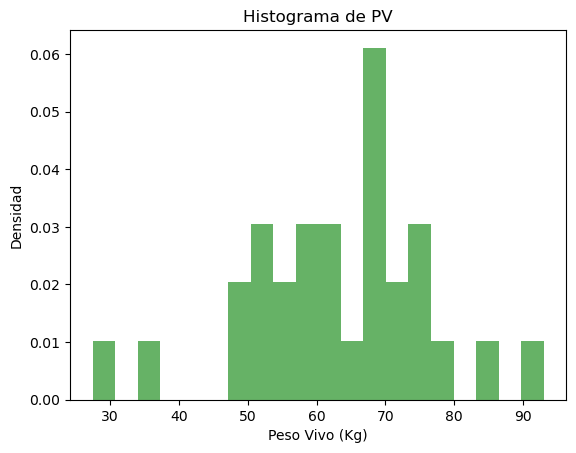

In [5]:
from scipy.stats import shapiro

# Prueba de normalidad para 'PV'
stat, p_value = shapiro(df['PV'])

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("La variable 'PV' sigue una distribución normal.")
else:
    print("La variable 'PV' no sigue una distribución normal.")
# Histograma
plt.hist(df['PV'], bins=20, density=True, alpha=0.6, color='g')
plt.title('Histograma de PV')
plt.xlabel('Peso Vivo (Kg)')
plt.ylabel('Densidad')
plt.show()

La variable 'EGD' sigue una distribución normal.


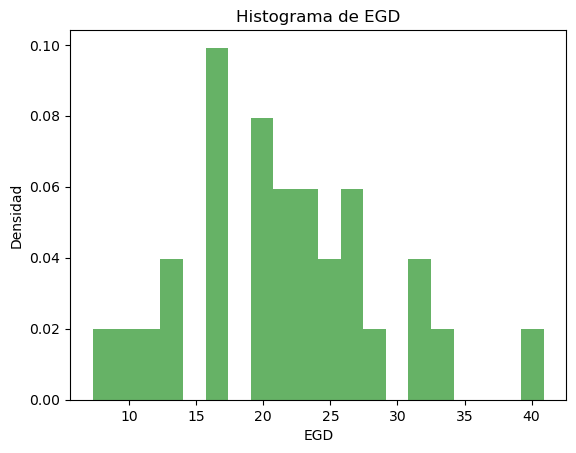

In [6]:
from scipy.stats import shapiro

# Prueba de normalidad para 'EGD'
stat, p_value = shapiro(df['EGD'])

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("La variable 'EGD' sigue una distribución normal.")
else:
    print("La variable 'EGD' no sigue una distribución normal.")
# Histograma
plt.hist(df['EGD'], bins=20, density=True, alpha=0.6, color='g')
plt.title('Histograma de EGD')
plt.xlabel('EGD')
plt.ylabel('Densidad')
plt.show()

In [7]:
from scipy.stats import levene

# Prueba de homocedasticidad para 'EGD' en función de 'PV'
stat, p_value = levene(df['EGD'], df['PV'])

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("La varianza de 'EGD' es constante en función de 'PV' (homocedasticidad).")
else:
    print("La varianza de 'EGD' no es constante en función de 'PV' (heterocedasticidad).")

La varianza de 'EGD' no es constante en función de 'PV' (heterocedasticidad).


## Ejercicio 1.2.

Los datos del cuarteto de Anscombe se encuentran en el archivo `anscombe.xlsx`. Se pide explorar los datos de la siguiente manera:

### (a) Graficar los cuatro pares de datos en un diagrama de dispersión cada uno.

### (b) Hallar los valores medios de las variables para cada par de datos.

### (c) Hallar los valores de la dispersión para cada conjunto de datos.

### (d) Hallar el coeficiente muestral de correlación lineal en cada caso.

### (e) Observar, comentar y concluir.


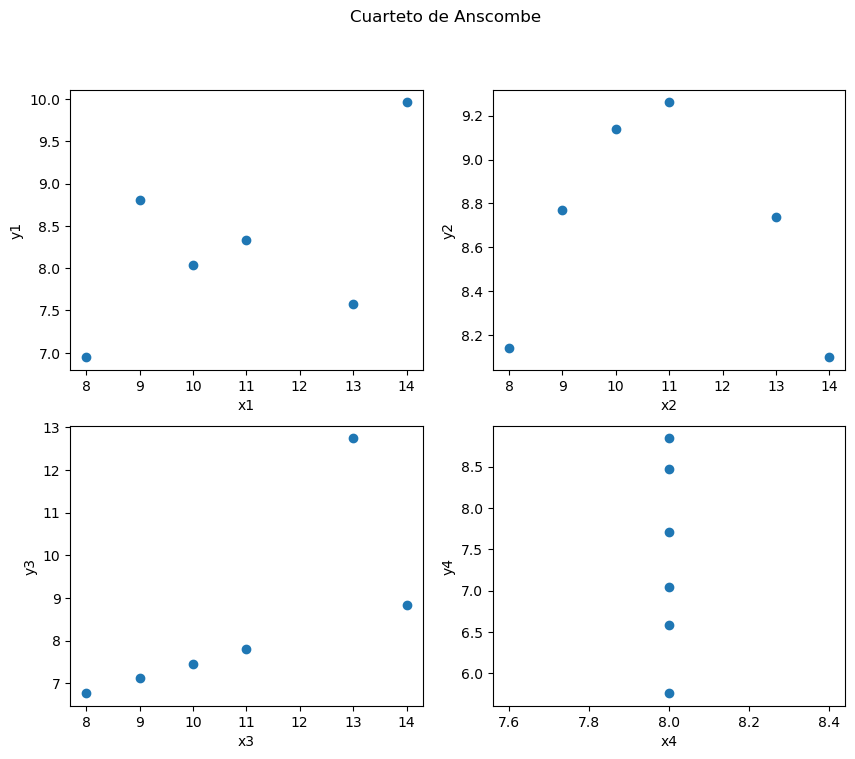

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargar los datos desde el archivo Excel
df = pd.read_excel('anscombe.xlsx')

# Crear un subplot de 2x2 para los cuatro gráficos de dispersión
fig, axs = plt.subplots(2, 2, figsize=(10, 8))
fig.suptitle("Cuarteto de Anscombe")

# Graficar los cuatro pares de datos
for i, (x, y) in enumerate([("x1", "y1"), ("x2", "y2"), ("x3", "y3"), ("x4", "y4")]):
    row, col = i // 2, i % 2
    axs[row, col].scatter(df[x], df[y])
    axs[row, col].set_xlabel(x)
    axs[row, col].set_ylabel(y)

plt.show()


In [9]:
df.describe()

,x1,x2,x3,x4,y1,y2,y3,y4
count,6.000000,6.000000,6.000000,6.0,6.000000,6.000000,6.000000,6.000000
mean,10.833333,10.833333,10.833333,8.0,8.278333,8.691667,8.455000,7.400000
std,2.316607,2.316607,2.316607,0.0,1.041372,0.487213,2.216472,1.166722
min,8.000000,8.000000,8.000000,8.0,6.950000,8.100000,6.770000,5.760000
25%,9.250000,9.250000,9.250000,8.0,7.695000,8.290000,7.197500,6.695000
50%,10.500000,10.500000,10.500000,8.0,8.185000,8.755000,7.635000,7.375000
75%,12.500000,12.500000,12.500000,8.0,8.690000,9.047500,8.582500,8.280000
max,14.000000,14.000000,14.000000,8.0,9.960000,9.260000,12.740000,8.840000


In [11]:
from scipy.stats import pearsonr


for idx, (x,y) in enumerate([("x1", "y1"), ("x2", "y2"), ("x3", "y3"), ("x4", "y4")]):
    # Realizar el test de correlación y obtener el valor p
    corr, p_value = pearsonr(df[x], df[y])
    print(corr)

    alpha = 0.05  # Nivel de significancia
    if p_value < alpha:
        print(f"Hay suficiente evidencia para admitir una asociación significativa entre {x} e {y}.")
    else:
        print(f"No hay suficiente evidencia para admitir una asociación significativa entre {x} e {y}.")



0.5644329959169474
No hay suficiente evidencia para admitir una asociación significativa entre x1 e y1.
-0.11133937301070038
No hay suficiente evidencia para admitir una asociación significativa entre x2 e y2.
0.7192248177123675
No hay suficiente evidencia para admitir una asociación significativa entre x3 e y3.
nan
No hay suficiente evidencia para admitir una asociación significativa entre x4 e y4.


# 1.2. Modelo Lineal Simple

## Ejercicio 1.3.

El archivo `peso_edad_colest.xlsx` disponible contiene registros correspondientes a 25 individuos respecto de su peso, su edad y el nivel de colesterol total en sangre. Se pide:

### (a) Realizar el diagrama de dispersión de colesterol en función de la edad y de colesterol en función de peso. ¿Le parece adecuado ajustar un modelo lineal para alguno de estos dos pares de variables?

### (b) Estime los coeficientes del modelo lineal para el colesterol en función de la edad.

### (c) Estime intervalos de confianza del 95 % para los coeficientes del modelo y compare estos resultados con el test de Wald para los coeficientes. ¿Le parece que hay asociación entre estos test y el test de la regresión?

### (d) A partir de esta recta, estime los valores de E(Y) para x = 25 años y x = 48 años. ¿Podría estimarse el valor de E(Y) para x = 80 años?

### (e) Testee la normalidad de los residuos y haga un gráfico para ver si son homocedásticos.


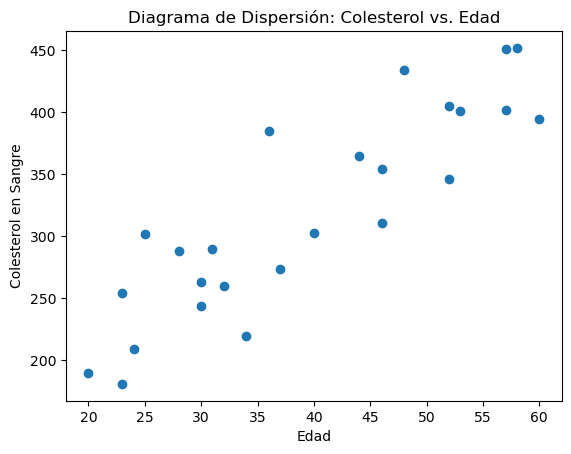

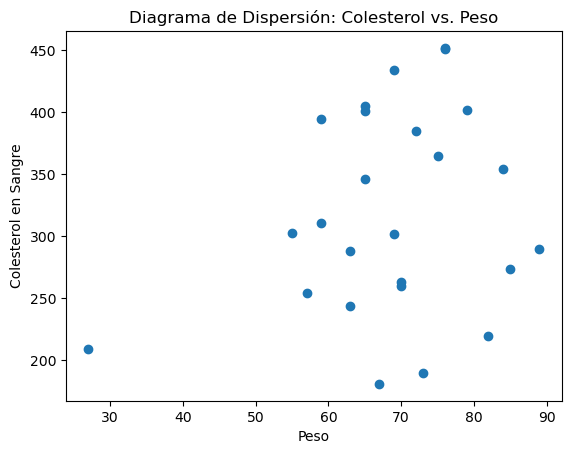

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargar los datos desde el archivo Excel
df = pd.read_excel('peso_edad_colest.xlsx')

# Diagrama de dispersión de colesterol en función de la edad
plt.scatter(df['edad'], df['colest'])
plt.xlabel('Edad')
plt.ylabel('Colesterol en Sangre')
plt.title('Diagrama de Dispersión: Colesterol vs. Edad')
plt.show()

# Diagrama de dispersión de colesterol en función del peso
plt.scatter(df['peso'], df['colest'])
plt.xlabel('Peso')
plt.ylabel('Colesterol en Sangre')
plt.title('Diagrama de Dispersión: Colesterol vs. Peso')
plt.show()


In [13]:
import statsmodels.api as sm

# Ajustar un modelo lineal
X = sm.add_constant(df['edad'])  # Agregar una constante para el intercepto
y = df['colest']
model = sm.OLS(y, X).fit()

# Obtener los coeficientes del modelo
coeficientes = model.params
print(coeficientes)

const    95.502004
edad      5.670842
dtype: float64


In [14]:
# Estimar intervalos de confianza del 95 % para los coeficientes
conf_int = model.conf_int(alpha=0.05)
print(conf_int)

# Realizar el test de Wald para los coeficientes
wald_test = model.wald_test("edad=0", scalar=True)
print(wald_test)
wald_test = model.wald_test("const=0", scalar=True)
print(wald_test)

               0           1
const  41.190390  149.813618
edad    4.358216    6.983467
<F test: F=79.8712756548758, p=6.094236895234453e-09, df_denom=23, df_num=1>
<F test: F=13.231734690789983, p=0.001377243659513038, df_denom=23, df_num=1>


In [15]:
# Estimar E(Y) para x = 25 años
estimacion_25 = model.predict([1, 25])
print(round(estimacion_25[0]))

# Estimar E(Y) para x = 48 años
estimacion_48 = model.predict([1, 48])
print(round(estimacion_48[0]))


# No se recomienda estimar E(Y) para x = 80 años si la edad está fuera del rango de datos observados en el conjunto de datos.

237
368


Los residuos siguen una distribución normal.


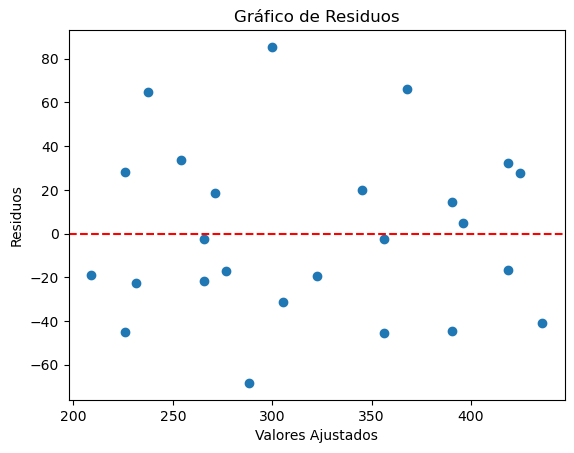

In [16]:
# Residuos del modelo
residuos = model.resid

# Test de normalidad de los residuos
from scipy.stats import shapiro
stat, p_value = shapiro(residuos)

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("Los residuos siguen una distribución normal.")
else:
    print("Los residuos no siguen una distribución normal.")

# Gráfico de residuos
plt.scatter(model.fittedvalues, residuos)
plt.xlabel('Valores Ajustados')
plt.ylabel('Residuos')
plt.title('Gráfico de Residuos')
plt.axhline(y=0, color='r', linestyle='--')
plt.show()


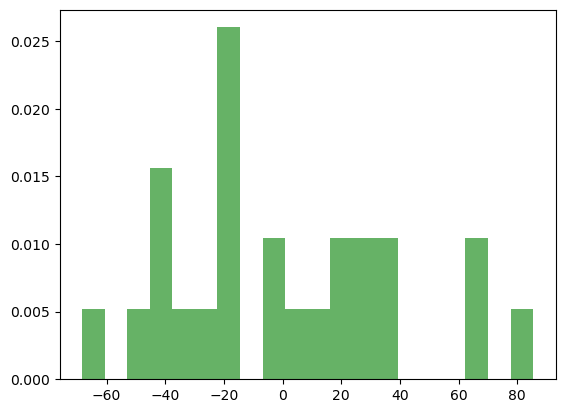

In [17]:
plt.hist(residuos, bins=20, density=True, alpha=0.6, color='g')
plt.show()

# 1.3. Transformación de Variables

## Ejercicio 1.4.

Una empresa desarrolló un sistema de energía solar para calentar el agua para una caldera que es parte del sistema de energía del proceso productivo. Existe el interés de controlar la estabilidad del sistema, para ello se monitorea el mismo y se registran los datos cada hora. Los datos se encuentran disponibles en el archivo `energia.xlsx`.

### (a) Realizar el diagrama de dispersión y evaluar si un modelo de regresión lineal es adecuado.

### (b) Estimar un modelo lineal y verificar la normalidad de los residuos del mismo.

### (c) En caso de rechazar este supuesto, buscar una transformación lineal para este modelo y aplicarla.

### (d) Realizar el análisis diagnóstico del nuevo modelo y estimar un intervalo de confianza y un intervalo de predicción para 27.5 hs con ambos modelos. Comparar los intervalos.


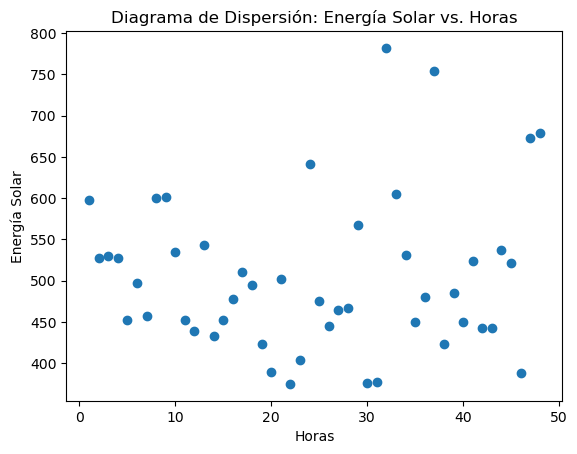

In [18]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargar los datos desde el archivo Excel
df = pd.read_excel('energia.xlsx')

# Diagrama de dispersión
plt.scatter(df['Hora'], df['Energía'])
plt.xlabel('Horas')
plt.ylabel('Energía Solar')
plt.title('Diagrama de Dispersión: Energía Solar vs. Horas')
plt.show()

const    491.489362
Hora       0.520842
dtype: float64
Los residuos no siguen una distribución normal.


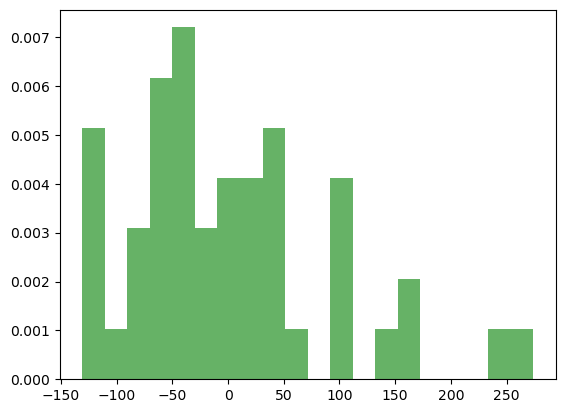

In [19]:
import statsmodels.api as sm
import scipy.stats as stats

# Ajustar un modelo lineal
X = sm.add_constant(df['Hora'])  # Agregar una constante para el intercepto
y = df['Energía']
model = sm.OLS(y, X).fit()

# Obtener los coeficientes del modelo
coeficientes = model.params
print(coeficientes)

# Residuos del modelo
residuos = model.resid

# Test de normalidad de los residuos (por ejemplo, el test de Shapiro-Wilk)
stat, p_value = stats.shapiro(residuos)

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("Los residuos siguen una distribución normal.")
else:
    print("Los residuos no siguen una distribución normal.")
plt.hist(residuos, bins=20, density=True, alpha=0.6, color='g')
plt.show()

const    491.323519
Hora       0.000012
dtype: float64
Los residuos no siguen una distribución normal.


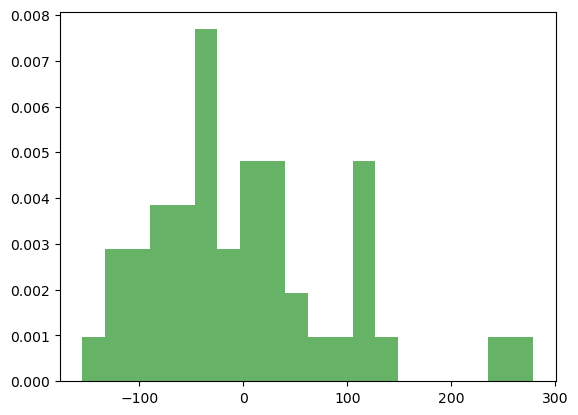

In [20]:
import statsmodels.api as sm
import scipy.stats as stats

# Ajustar un modelo lineal
X = sm.add_constant(df['Hora'] ** 4)  
y = df['Energía']
model = sm.OLS(y, X).fit()

# Obtener los coeficientes del modelo
coeficientes = model.params
print(coeficientes)

# Residuos del modelo
residuos = model.resid

# Test de normalidad de los residuos (por ejemplo, el test de Shapiro-Wilk)
stat, p_value = stats.shapiro(residuos)

alpha = 0.05  # Nivel de significancia

if p_value > alpha:
    print("Los residuos siguen una distribución normal.")
else:
    print("Los residuos no siguen una distribución normal.")
plt.hist(residuos, bins=20, density=True, alpha=0.6, color='g')
plt.show()

In [25]:
# Valor de horas para el que queremos estimar la energía
valor_hora = 27.5

# Modelo original
X_original = sm.add_constant(df['Hora'])
model_original = sm.OLS(y, X_original).fit()

# Intervalo de confianza para el modelo original
prediction_original = model_original.predict([1, valor_hora])
int_conf_original = model_original.conf_int(alpha=0.05)

# Nuevo modelo
X_nuevo = sm.add_constant(df['Hora'] ** 4)
model_nuevo = sm.OLS(y, X_nuevo).fit()

# Intervalo de confianza para el nuevo modelo
prediction_nuevo = model_nuevo.predict([1, valor_hora ** 4])
int_conf_nuevo = model_nuevo.conf_int(alpha=0.05)

# Imprimir los intervalos de confianza
print("Intervalo de confianza para el modelo original:")
print(int_conf_original)

print("Intervalo de confianza para el nuevo modelo:")
print(int_conf_nuevo)

# Intervalo de predicción para ambos modelos
int_pred_original = model_original.get_prediction([1, valor_hora]).conf_int()[0]
int_pred_nuevo = model_nuevo.get_prediction([1, valor_hora]).conf_int()[0]

# Imprimir predicción
print("Predicción para el modelo original:")
print(prediction_original[0])

print("Predicción para el nuevo modelo:")
print(prediction_nuevo[0])

# Imprimir los intervalos de predicción
print("Intervalo de predicción para el modelo original:")
print(int_pred_original)

print("Intervalo de predicción para el nuevo modelo:")
print(int_pred_nuevo)


Intervalo de confianza para el modelo original:
                0           1
const  436.125783  546.852940
Hora    -1.446210    2.487895
Intervalo de confianza para el nuevo modelo:
                0           1
const  457.644553  525.002485
Hora    -0.000007    0.000030
Predicción para el modelo original:
505.81252713851535
Predicción para el nuevo modelo:
497.93756968294775
Intervalo de predicción para el modelo original:
[477.9305315  533.69452278]
Intervalo de predicción para el nuevo modelo:
[457.64517299 525.00250162]


# 1.4. Tratamiento de la heterocedasticidad

## Ejercicio 1.5.

Se obtuvieron datos históricos del mercado inmobiliario de una ciudad de Nueva Taipei, en Taiwan. La base es `inmobiliaria.xlsx`. Las características son:

- edad: Edad de la propiedad (en años).
- distancia: La distancia a la estación de transporte más cercana (en metros).
- negocios: Cantidad de negocios de conveniencia en las cercanías a una distancia realizable a pie.
- latitud: Latitud de la ubicación de la propiedad (en grados).
- longitud: Longitud de la ubicación de la propiedad (en grados).
- precio: Precio por metro cuadrado (en miles de dólares).

### (a) Analizar si el precio depende de alguna de las variables.

### (b) Estudiar la linealidad de la relación precio-distancia.

### (c) Estimar los coeficientes del modelo y realizar el análisis diagnóstico de los residuos del mismo. Utilizar para este análisis los gráficos de residuos versus valores ajustados, el qq-plot de los residuos, la gráfica de residuos versus leverage.

### (d) Aplicar los test de Durbin-Watson Breush-Pagan.

### (e) Analice la presencia de outliers y verifique si coinciden con los puntos influyentes.


In [26]:
import pandas as pd

# Cargar los datos desde el archivo CSV
df = pd.read_csv('inmobiliaria.csv', sep=';', decimal='.')

# Calcular las correlaciones
correlations = df.corr()
print(correlations['precio'])



edad        -0.212531
distancia   -0.672186
negocios     0.571966
latitud      0.557476
longitud     0.499365
precio       1.000000
Name: precio, dtype: float64


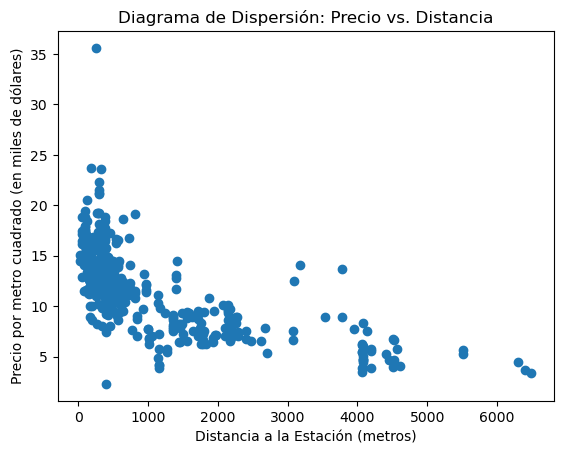

In [27]:
import matplotlib.pyplot as plt

plt.scatter(df['distancia'], df['precio'])
plt.xlabel('Distancia a la Estación (metros)')
plt.ylabel('Precio por metro cuadrado (en miles de dólares)')
plt.title('Diagrama de Dispersión: Precio vs. Distancia')
plt.show()

const        13.876642
distancia    -0.002190
dtype: float64


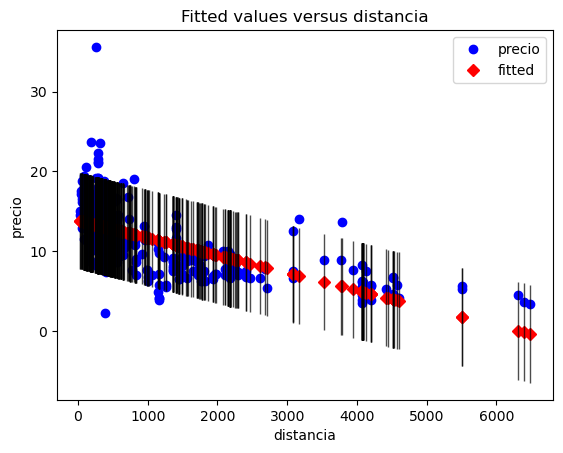

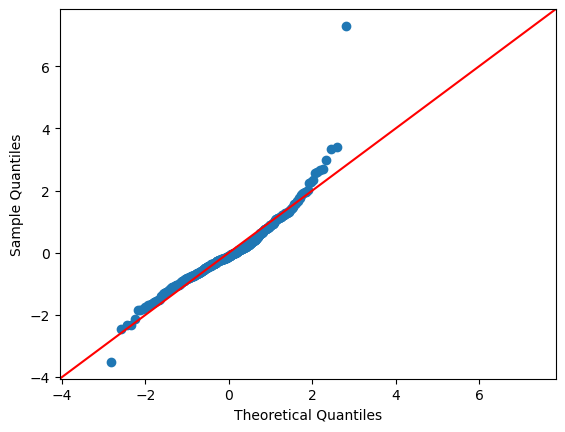

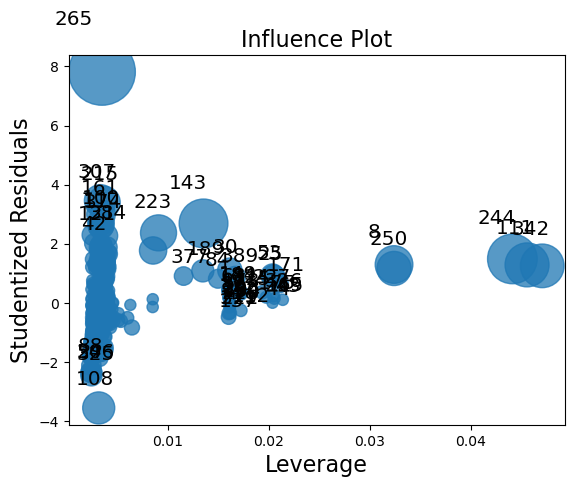

In [28]:
import statsmodels.api as sm
import statsmodels.stats as sms
import statsmodels.graphics as smg

# Ajustar un modelo de regresión lineal (por ejemplo, con la variable 'distancia')
X = sm.add_constant(df['distancia'])
y = df['precio']
model = sm.OLS(y, X).fit()

# Obtener los coeficientes del modelo
coeficientes = model.params
print(coeficientes)

# Análisis diagnóstico de los residuos
residuos = model.resid

# Gráfico de residuos vs. valores ajustados
smg.regressionplots.plot_fit(model, 1)
plt.show()

# Gráfico Q-Q de los residuos
sm.qqplot(residuos, line='45', fit=True)
plt.show()

# Gráfico de residuos vs. leverage
smg.regressionplots.influence_plot(model, criterion="cooks")

plt.show()


In [29]:
# Test de Durbin-Watson
durbin_watson_statistic = sms.stattools.durbin_watson(residuos)
print(f"Estadística de Durbin-Watson: {durbin_watson_statistic}")

# Test de Breusch-Pagan
breusch_pagan_test = sms.diagnostic.het_breuschpagan(residuos, model.model.exog)
print(f"Estadística de Breusch-Pagan: {breusch_pagan_test[0]}")
print(f"P-valor: {breusch_pagan_test[1]}")


Estadística de Durbin-Watson: 2.1606522805068313
Estadística de Breusch-Pagan: 1.4397422233172632
P-valor: 0.2301810588631272


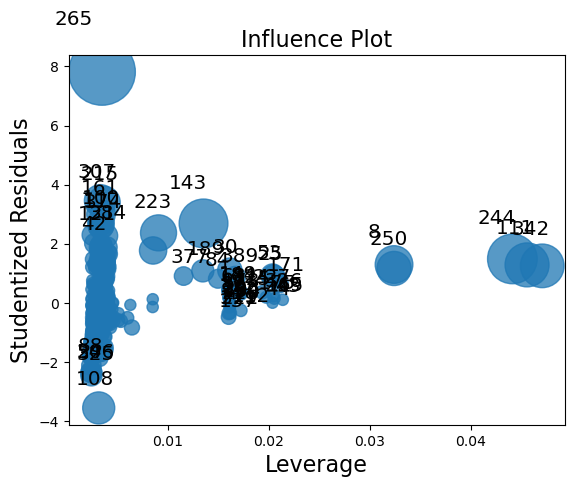

Puntos influyentes:
     dfb_const  dfb_distancia   cooks_d  standard_resid  hat_diag  \
8    -0.099009       0.227935  0.028051        1.294598  0.032390   
11    0.151851      -0.081527  0.011623        2.608509  0.003405   
30   -0.043186       0.130624  0.010048        1.106686  0.016144   
100   0.157674      -0.084653  0.012515        2.706757  0.003405   
108  -0.196561       0.096445  0.019620       -3.508826  0.003177   
111  -0.128304       0.272711  0.039233        1.282262  0.045549   
143  -0.084126       0.285111  0.048849        2.667336  0.013546   
161   0.173258      -0.093020  0.015054        2.968753  0.003405   
215   0.205428      -0.119499  0.020741        3.351331  0.003680   
223  -0.037054       0.193959  0.025439        2.354474  0.009094   
244  -0.144874       0.309985  0.050715        1.482796  0.044098   
250  -0.088806       0.204446  0.022586        1.161652  0.032390   
265   0.459804      -0.254909  0.093611        7.295811  0.003505   
307   0.197622

In [30]:
# Gráfico de residuos vs. leverage
smg.regressionplots.influence_plot(model, criterion="cooks")
plt.show()

# Identificar los puntos influyentes
influyentes = model.get_influence()
influencia = influyentes.summary_frame()
influyentes_indices = influencia[influencia['cooks_d'] > 4 / len(df)]
print("Puntos influyentes:")
print(influyentes_indices)


# 1.5. Cuadrados Mínimos Ponderados

## Ejercicio 1.6.

En la base `estudio.xlsx` se encuentran registradas las horas de estudio referidas por un conjunto de estudiantes y su calificación en la evaluación final.

### (a) Ajuste un modelo de regresión simple para estimar la nota final en función de las horas dedicadas al estudio.

### (b) Estudie el cumplimiento de los supuestos del modelo, gráfica y analíticamente.

### (c) Ajuste un modelo de mínimos cuadrados ponderados definiendo los pesos de tal manera que las observaciones con menor varianza tengan más peso.

### (d) Realice el análisis diagnóstico del segundo modelo ajustado.

### (e) Compare ambos ajustes realizados y concluya.


In [31]:
import pandas as pd
import statsmodels.api as sm

# Cargar los datos desde el archivo CSV
df = pd.read_csv('estudio.csv', sep=';', decimal='.')

# Ajustar un modelo de regresión simple
X = sm.add_constant(df['horas_estudio'])  # Agregar una constante para el intercepto
y = df['puntaje']
model = sm.OLS(y, X).fit()

# Obtener los coeficientes del modelo
coeficientes = model.params
print(coeficientes)


const            39.830513
horas_estudio     5.709388
dtype: float64


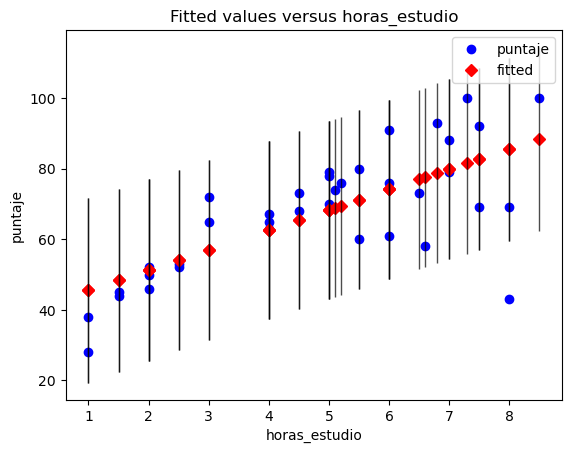

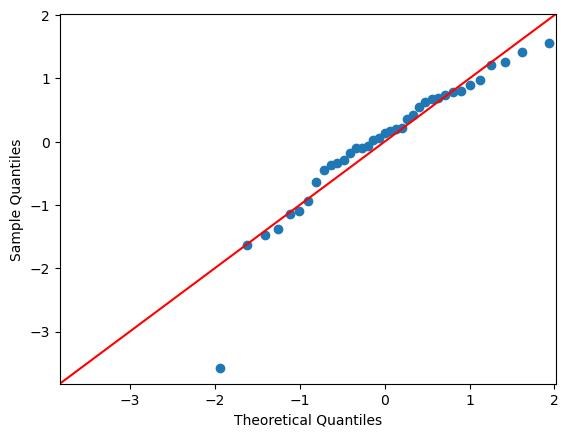

In [32]:
import matplotlib.pyplot as plt
import statsmodels.graphics as smg

# Residuos del modelo
residuos = model.resid

# Gráfico de residuos vs. valores ajustados
smg.regressionplots.plot_fit(model, 1)
plt.show()

# Gráfico Q-Q de los residuos
sm.qqplot(residuos, line='45', fit=True)
plt.show()


In [33]:
# Calcular los pesos como la inversa de la varianza de los residuos
pesos = 1 / (residuos ** 2)

# Ajustar un modelo de regresión ponderado
model_ponderado = sm.WLS(y, X, weights=pesos).fit()

# Obtener los coeficientes del modelo ponderado
coeficientes_ponderados = model_ponderado.params
print(coeficientes_ponderados)

const            39.749702
horas_estudio     5.779372
dtype: float64


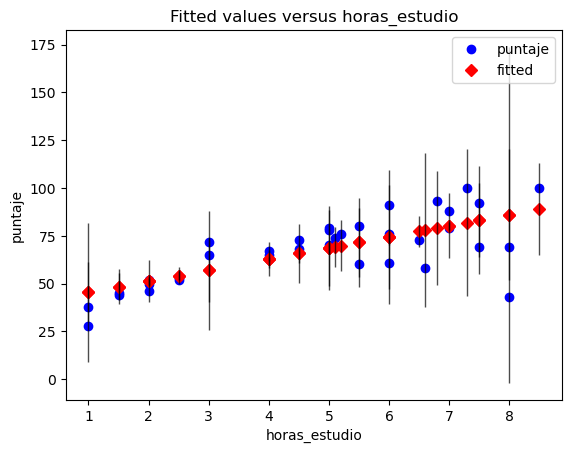

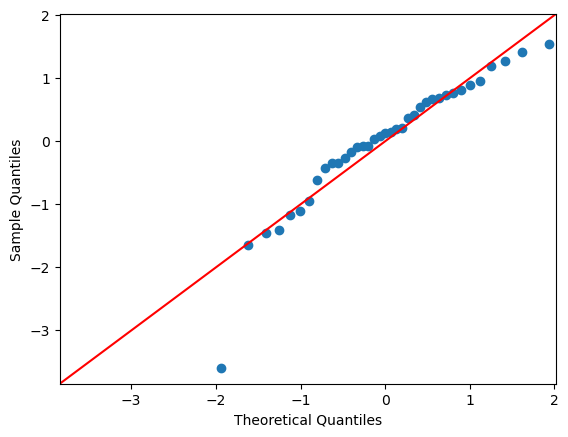

In [34]:
# Residuos del modelo ponderado
residuos_ponderados = model_ponderado.resid

# Gráfico de residuos vs. valores ajustados (modelo ponderado)
smg.regressionplots.plot_fit(model_ponderado, 1)
plt.show()

# Gráfico Q-Q de los residuos (modelo ponderado)
sm.qqplot(residuos_ponderados, line='45', fit=True)
plt.show()

In [35]:
# Comparar R² entre los dos modelos
r2_simple = model.rsquared
r2_ponderado = model_ponderado.rsquared

print(f"R² del modelo simple: {r2_simple}")
print(f"R² del modelo ponderado: {r2_ponderado}")

R² del modelo simple: 0.5191523411450686
R² del modelo ponderado: 0.9652552088345178


# 2.1. Modelo Aditivo

## Ejercicio 2.1.

Con el set de datos `trees`, disponible en la biblioteca `dplyr` de R, pretendemos ajustar un modelo que estime el volumen (en pies cúbicos) de los árboles de cerezo en función de la longitud de su circunferencia (en pulgadas) y de su altura (en pies).

### a) Visualizar la asociación entre las variables de a pares.

### b) Ajuste un modelo lineal simple para cada una de las dos predictoras disponibles.

### c) Realice un análisis diagnóstico en cada caso y señale en caso de haberlos puntos influyentes y outliers.

### d) Estime un intervalo de confianza para los coeficientes del modelo lineal estimado en cada caso.

### e) Ajuste un nuevo modelo sin la/s observaciones influyentes.

### f) Construya el intervalo de confianza y el de predicción del 95 % para un árbol cuyo diámetro es 16.1 pulgadas.

### g) Ajuste un modelo utilizando conjuntamente las dos variables predictoras y compare este ajuste con el mejor de los modelos anteriores mediante un test de modelos anidados. Concluya.


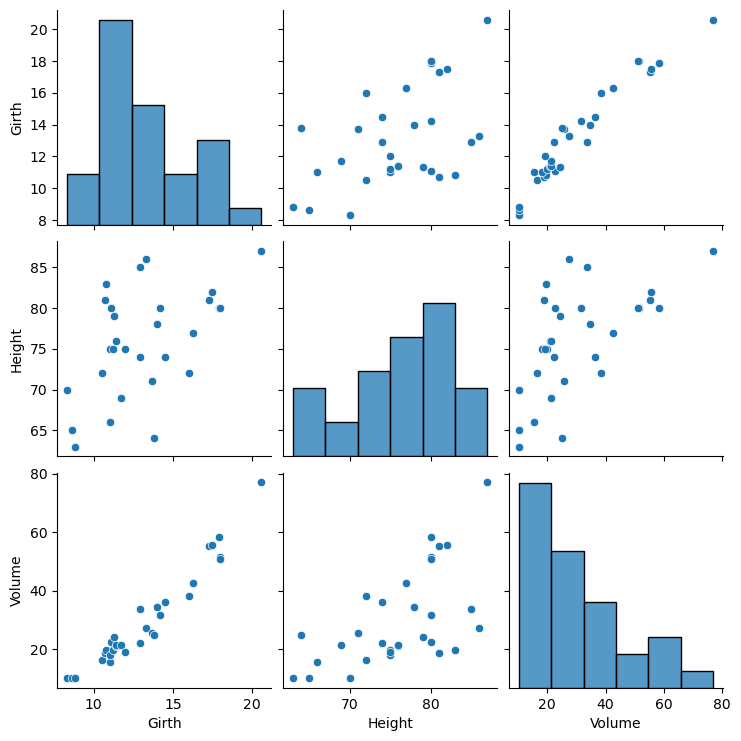

In [36]:
import seaborn as sns
import pandas as pd

# Cargar los datos desde el archivo Excel
df = pd.read_excel('trees.xlsx')
sns.pairplot(df)

In [37]:
import statsmodels.api as sm

X_girth = sm.add_constant(df['Girth'])
y = df['Volume']
model_girth = sm.OLS(y, X_girth).fit()
print(model_girth.summary())


                            OLS Regression Results                            
Dep. Variable:                 Volume   R-squared:                       0.935
Model:                            OLS   Adj. R-squared:                  0.933
Method:                 Least Squares   F-statistic:                     419.4
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.64e-19
Time:                        20:58:15   Log-Likelihood:                -87.822
No. Observations:                  31   AIC:                             179.6
Df Residuals:                      29   BIC:                             182.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -36.9435      3.365    -10.978      0.0

In [38]:
X_height = sm.add_constant(df['Height'])
model_height = sm.OLS(y, X_height).fit()
print(model_height.summary())


                            OLS Regression Results                            
Dep. Variable:                 Volume   R-squared:                       0.358
Model:                            OLS   Adj. R-squared:                  0.336
Method:                 Least Squares   F-statistic:                     16.16
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           0.000378
Time:                        20:58:17   Log-Likelihood:                -123.40
No. Observations:                  31   AIC:                             250.8
Df Residuals:                      29   BIC:                             253.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -87.1236     29.273     -2.976      0.0

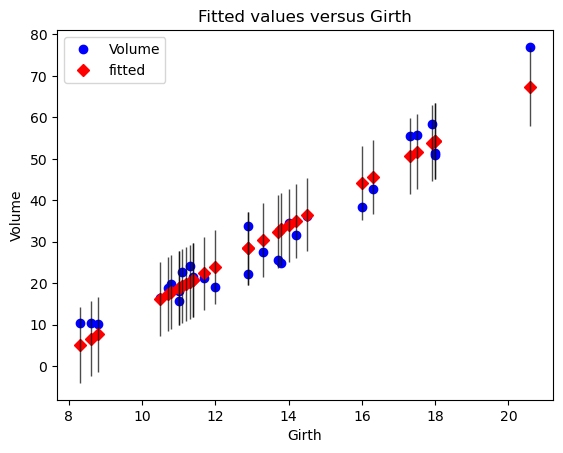

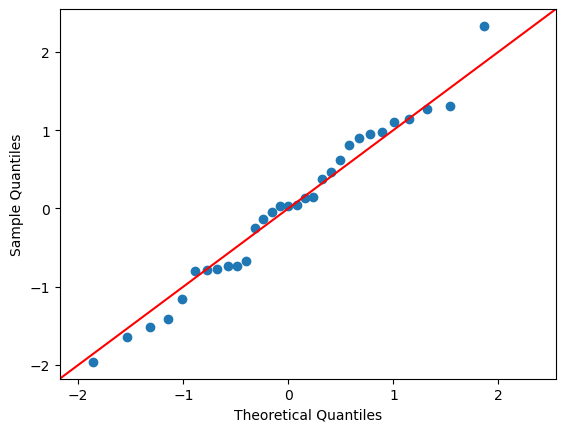

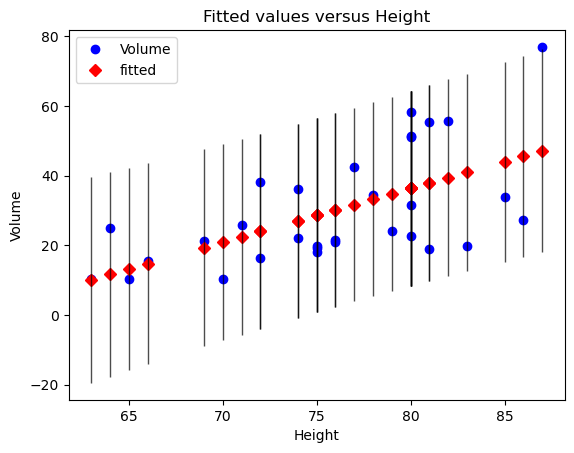

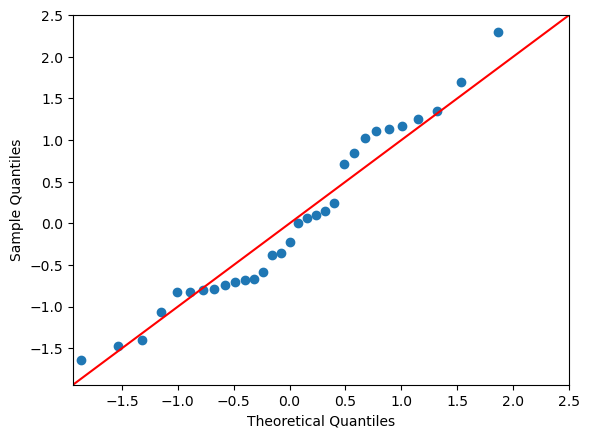

In [39]:
# Residuos del modelo para la longitud de circunferencia
residuos_girth = model_girth.resid

# Residuos del modelo para la altura
residuos_height = model_height.resid

# Gráfico de residuos vs. valores ajustados (modelo longitud de circunferencia)
smg.regressionplots.plot_fit(model_girth, 1)
plt.show()

# Gráfico Q-Q de los residuos (modelo longitud de circunferencia)
sm.qqplot(residuos_girth, line='45', fit=True)
plt.show()

# Gráfico de residuos vs. valores ajustados (modelo altura)
smg.regressionplots.plot_fit(model_height, 1)
plt.show()

# Gráfico Q-Q de los residuos (modelo altura)
sm.qqplot(residuos_height, line='45', fit=True)
plt.show()


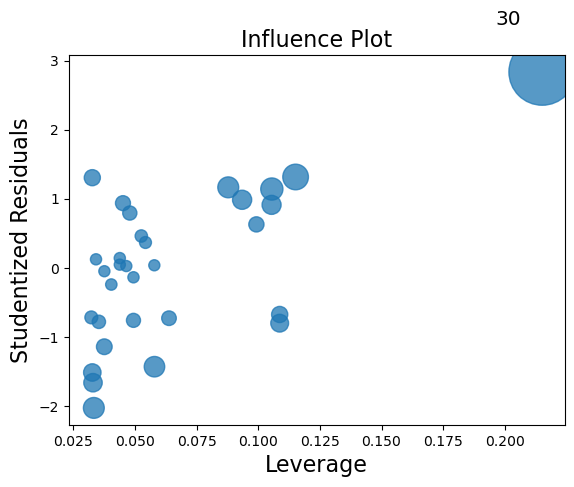

Puntos influyentes:
    dfb_const  dfb_Girth   cooks_d  standard_resid  hat_diag  dffits_internal  \
30  -1.203754   1.370062  0.888058         2.54508  0.215194          1.33271   

    student_resid    dffits  
30       2.837732  1.485955  


In [40]:
# Gráfico de residuos vs. leverage
smg.regressionplots.influence_plot(model_girth, criterion="cooks")
plt.show()

# Identificar los puntos influyentes
influyentes = model_girth.get_influence()
influencia = influyentes.summary_frame()
influyentes_indices = influencia[influencia['cooks_d'] > 4 / len(df)]
print("Puntos influyentes:")
print(influyentes_indices)


In [41]:
df2=df[df.index!=30].reset_index()
X_height = sm.add_constant(df2['Girth'])
y = df2['Volume']
model_height = sm.OLS(y, X_height).fit()
print(model_height.summary())

                            OLS Regression Results                            
Dep. Variable:                 Volume   R-squared:                       0.930
Model:                            OLS   Adj. R-squared:                  0.928
Method:                 Least Squares   F-statistic:                     373.6
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.92e-18
Time:                        20:58:20   Log-Likelihood:                -81.690
No. Observations:                  30   AIC:                             167.4
Df Residuals:                      28   BIC:                             170.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -33.3104      3.278    -10.161      0.0

In [42]:
df3=df[df.index!=30].reset_index()
X_height = sm.add_constant(df3['Height'])
y = df3['Volume']
model_height = sm.OLS(y, X_height).fit()
print(model_height.summary())

                            OLS Regression Results                            
Dep. Variable:                 Volume   R-squared:                       0.284
Model:                            OLS   Adj. R-squared:                  0.259
Method:                 Least Squares   F-statistic:                     11.13
Date:                Wed, 15 Nov 2023   Prob (F-statistic):            0.00241
Time:                        20:58:21   Log-Likelihood:                -116.62
No. Observations:                  30   AIC:                             237.2
Df Residuals:                      28   BIC:                             240.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -64.6377     28.037     -2.305      0.0

In [43]:
# Estimar el valor de volumen para un árbol con diámetro de 16.1 pulgadas
diametro = 16.1
valor_predicho = model_height.predict([1, diametro])[0]

# Obtener el error estándar de la predicción
error_estandar_prediccion = model_height.get_prediction([1, diametro]).se_mean

# Calcular el intervalo de confianza del 95%
intervalo_confianza = (valor_predicho - 1.96 * error_estandar_prediccion, valor_predicho + 1.96 * error_estandar_prediccion)

# Calcular el intervalo de predicción del 95%
intervalo_prediccion = (valor_predicho - 1.96 * error_estandar_prediccion, valor_predicho + 1.96 * error_estandar_prediccion)

print("Intervalo de Confianza del 95%:", intervalo_confianza)
print("Intervalo de Predicción del 95%:", intervalo_prediccion)


Intervalo de Confianza del 95%: (array([-88.12676443]), array([-1.44959167]))
Intervalo de Predicción del 95%: (array([-88.12676443]), array([-1.44959167]))


In [44]:
X_both = sm.add_constant(df2[['Girth', 'Height']])
model_both = sm.OLS(y, X_both).fit()
print(model_both.summary())

# Comparar los modelos mediante una prueba F
from statsmodels.stats.anova import anova_lm

anova_results = anova_lm(model_height, model_both)
print("Prueba F de modelos anidados:")
print(anova_results)


                            OLS Regression Results                            
Dep. Variable:                 Volume   R-squared:                       0.944
Model:                            OLS   Adj. R-squared:                  0.940
Method:                 Least Squares   F-statistic:                     226.3
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.35e-17
Time:                        20:58:27   Log-Likelihood:                -78.481
No. Observations:                  30   AIC:                             163.0
Df Residuals:                      27   BIC:                             167.2
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -52.2362      8.039     -6.498      0.0

# 2.2. Modelo con Interacción

## Ejercicio 2.2.

El departamento de ventas de una empresa quiere estudiar la influencia que tienen los distintos canales de publicidad sobre las ventas de un producto recién lanzado al mercado. Se dispone de un conjunto de datos que contiene los ingresos (en millones) conseguido por ventas en 200 regiones, así como la cantidad de presupuesto, también en millones, destinado a anuncios por radio, TV y periódicos en cada una de ellas. Los datos están disponibles en la base `publicidad.xlsx`.

### a) Ajustar un modelo de regresión lineal simple para cada una de las variables predictoras por separado. Realizar a continuación el análisis diagnóstico de los modelos.

### b) Ajustar un modelo aditivo con las tres variables y decidir si alguna de ellas no es significativa (test de Wald).

### c) Ajustar los modelos de a pares y quedarse con el que mejor explique la variable respuesta utilizando el criterio de AIC, R2 y Cp_Mallows.

### d) Grafique para el modelo seleccionado el plano de ajuste y evalúe si le parece adecuado.

### e) Considere el mejor modelo pero ahora con interacción. Compare los modelos con y sin interacción.


In [45]:
import pandas as pd
import statsmodels.api as sm

# Cargar los datos desde el archivo Excel
df = pd.read_excel('publicidad.xlsx')

# Ajustar modelo para publicidad en radio
X_radio = sm.add_constant(df['radio'])

y = df['ventas']
model_radio = sm.OLS(y, X_radio).fit()
print("Modelo para Radio:")
print(model_radio.summary())

# Ajustar modelo para publicidad en TV
X_tv = sm.add_constant(df['tv'])
model_tv = sm.OLS(y, X_tv).fit()
print("Modelo para TV:")
print(model_tv.summary())

# Ajustar modelo para publicidad en periódicos
X_newspaper = sm.add_constant(df['periodico'])
model_newspaper = sm.OLS(y, X_newspaper).fit()
print("Modelo para Periódicos:")
print(model_newspaper.summary())


Modelo para Radio:
                            OLS Regression Results                            
Dep. Variable:                 ventas   R-squared:                       0.332
Model:                            OLS   Adj. R-squared:                  0.329
Method:                 Least Squares   F-statistic:                     98.42
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.35e-19
Time:                        20:58:40   Log-Likelihood:                -573.34
No. Observations:                 200   AIC:                             1151.
Df Residuals:                     198   BIC:                             1157.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.3116      0.563 

In [46]:
# Ajustar un modelo aditivo con las tres variables
X = sm.add_constant(df[['radio', 'tv', 'periodico']])
model_aditivo = sm.OLS(y, X).fit()
print("Modelo Aditivo:")
print(model_aditivo.summary())

# Realizar un test de Wald para determinar la significancia de cada variable
wald_test = model_aditivo.wald_test('radio = 0, tv = 0, periodico = 0')
print("Test de Wald para la significancia de las variables:")
print(wald_test)


Modelo Aditivo:
                            OLS Regression Results                            
Dep. Variable:                 ventas   R-squared:                       0.897
Model:                            OLS   Adj. R-squared:                  0.896
Method:                 Least Squares   F-statistic:                     570.3
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.58e-96
Time:                        20:58:41   Log-Likelihood:                -386.18
No. Observations:                 200   AIC:                             780.4
Df Residuals:                     196   BIC:                             793.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.9389      0.312    

C:\Users\jfran\anaconda3\lib\site-packages\statsmodels\base\model.py:1906: FutureWarning: The behavior of wald_test will change after 0.14 to returning scalar test statistic values. To get the future behavior now, set scalar to True. To silence this message while retaining the legacy behavior, set scalar to False.
  warnings.warn(


In [47]:
X_radio_tv = sm.add_constant(df[['radio', 'tv']])
model_radio_tv = sm.OLS(y, X_radio_tv).fit()

X_radio_newspaper = sm.add_constant(df[['radio', 'periodico']])
model_radio_newspaper = sm.OLS(y, X_radio_newspaper).fit()

X_tv_newspaper = sm.add_constant(df[['tv', 'periodico']])
model_tv_newspaper = sm.OLS(y, X_tv_newspaper).fit()

# Obtener AIC para cada modelo
aic_radio_tv = model_radio_tv.aic
aic_radio_newspaper = model_radio_newspaper.aic
aic_tv_newspaper = model_tv_newspaper.aic

# Obtener R² para cada modelo
r2_radio_tv = model_radio_tv.rsquared
r2_radio_newspaper = model_radio_newspaper.rsquared
r2_tv_newspaper = model_tv_newspaper.rsquared

# Obtener Cp de Mallows para cada modelo
n = len(y)
k = 2  # Número de predictores en cada modelo
cp_radio_tv = ((1 / n) * (model_radio_tv.ssr / model_radio_tv.mse_model)) + (2 * k)
cp_radio_newspaper = ((1 / n) * (model_radio_newspaper.ssr / model_radio_newspaper.mse_model)) + (2 * k)
cp_tv_newspaper = ((1 / n) * (model_tv_newspaper.ssr / model_tv_newspaper.mse_model)) + (2 * k)

# Imprimir los criterios para comparar
print("AIC para Radio y TV:", aic_radio_tv)
print("AIC para Radio y Periódicos:", aic_radio_newspaper)
print("AIC para TV y Periódicos:", aic_tv_newspaper)

print("R² para Radio y TV:", r2_radio_tv)
print("R² para Radio y Periódicos:", r2_radio_newspaper)
print("R² para TV y Periódicos:", r2_tv_newspaper)

print("Cp de Mallows para Radio y TV:", cp_radio_tv)
print("Cp de Mallows para Radio y Periódicos:", cp_radio_newspaper)
print("Cp de Mallows para TV y Periódicos:", cp_tv_newspaper)


AIC para Radio y TV: 778.3940987026801
AIC para Radio y Periódicos: 1152.4722534685402
AIC para TV y Periódicos: 1025.7781655793108
R² para Radio y TV: 0.8971942610828956
R² para Radio y Periódicos: 0.33270518395032256
R² para TV y Periódicos: 0.6458354938293271
Cp de Mallows para Radio y TV: 4.001145858186755
Cp de Mallows para Radio y Periódicos: 4.020056640179953
Cp de Mallows para TV y Periódicos: 4.005483819169967


In [48]:
print('Elijo Radio y TV')

Elijo Radio y TV


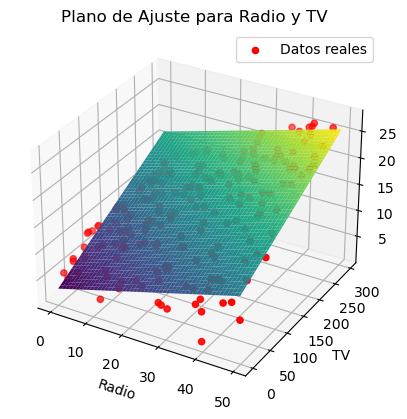

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Definir el rango de valores para Radio y TV
radio_values = np.linspace(df['radio'].min(), df['radio'].max(), 100)
tv_values = np.linspace(df['tv'].min(), df['tv'].max(), 100)
radio_values, tv_values = np.meshgrid(radio_values, tv_values)

# Preparar los datos para la superficie
X_surface = np.column_stack((np.ravel(radio_values), np.ravel(tv_values)))
X_surface = sm.add_constant(X_surface)

# Calcular las predicciones del modelo seleccionado
predictions = model_radio_tv.predict(X_surface)

# Crear una figura 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Graficar la superficie de ajuste
ax.plot_surface(radio_values, tv_values, predictions.reshape(radio_values.shape), cmap='viridis')

# Graficar los datos reales
ax.scatter(df['radio'], df['tv'], y, c='r', marker='o', label='Datos reales')

# Configurar etiquetas de los ejes
ax.set_xlabel('Radio')
ax.set_ylabel('TV')
ax.set_zlabel('Ventas')

# Mostrar el gráfico
plt.title('Plano de Ajuste para Radio y TV')
plt.legend()
plt.show()


In [50]:
# Crear una variable de interacción entre Radio y TV
df['radio_TV_Interaccion'] = df['radio'] * df['tv']

# Ajustar el modelo con interacción
X_interaccion = sm.add_constant(df[['radio', 'tv', 'radio_TV_Interaccion']])
model_interaccion = sm.OLS(y, X_interaccion).fit()
print("Modelo con Interacción:")
print(model_interaccion.summary())

# Realizar una prueba F para comparar los modelos
anova_results = sm.stats.anova_lm(model_radio_tv, model_interaccion)
print("Prueba F para comparar modelos con y sin interacción:")
print(anova_results)



Modelo con Interacción:
                            OLS Regression Results                            
Dep. Variable:                 ventas   R-squared:                       0.968
Model:                            OLS   Adj. R-squared:                  0.967
Method:                 Least Squares   F-statistic:                     1963.
Date:                Wed, 15 Nov 2023   Prob (F-statistic):          6.68e-146
Time:                        20:58:51   Log-Likelihood:                -270.14
No. Observations:                 200   AIC:                             548.3
Df Residuals:                     196   BIC:                             561.5
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const   

# 2.3. Regresoras Categóricas

## Ejercicio 2.3.

Con la base de datos `Salaries` con 397 registros de 6 variables de la biblioteca `carData` de R:

- `rank`: Factor con tres niveles: AssocProf, AsstProf y Prof.
- `discipline`: Factor con dos niveles A (departamentos teóricos) o B (departamentos aplicados).
- `yrs.since.phd`: Años transcurridos desde el doctorado.
- `yrs.service`: Años de servicio.
- `sex`: Factor con dos niveles Femenino y Masculino.
- `salary`: Salario por nueve meses en dólares.

### a) Ajustar un modelo lineal para estimar el salario en función del sexo.

### b) Ajustar un modelo lineal para estimar el salario en función de los años de servicio.

### c) Encontrar el modelo lineal que produzca el mejor ajuste con dos variables. ¿Es necesario considerar interacción?

### d) Ajustar el modelo completo.

### e) Proponer un modelo y justificar que es mejor que el modelo completo.

Realizar el análisis diagnóstico para este modelo.


In [51]:
import pandas as pd
import statsmodels.formula.api as smf
import statsmodels.api as sm


# Cargar los datos desde la base de datos Salaries
df = pd.read_csv('Salaries.csv')

# Escribir la fórmula del modelo
formula = "salary ~ C(sex)"

# Ajustar el modelo para estimar el salario en función del sexo
model = smf.ols(formula, data=df).fit()

# Obtener los coeficientes del modelo
coef = model.params

# Imprimir los coeficientes del modelo
print("Modelo para el sexo:")
print(coef)

#df['predict']=model.predict()

print('Salario de los hombres:', model.predict(pd.DataFrame({'intercept': 1, 'sex': ['Male']})).values)
print('Salario de los hombres:', model.predict(pd.DataFrame({'intercept': 1, 'sex': ['Female']})).values)

Modelo para el sexo:
Intercept         101002.410256
C(sex)[T.Male]     14088.008738
dtype: float64
Salario de los hombres: [115090.41899441]
Salario de los hombres: [101002.41025641]


In [53]:
# Ajustar modelo para estimar el salario en función de los años de servicio
X_service = sm.add_constant(df['yrs.service'])
y=df['salary']
model_service = sm.OLS(y, X_service).fit()
print("Modelo para los años de servicio:")
print(model_service.summary())

Modelo para los años de servicio:
                            OLS Regression Results                            
Dep. Variable:                 salary   R-squared:                       0.112
Model:                            OLS   Adj. R-squared:                  0.110
Method:                 Least Squares   F-statistic:                     49.85
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.53e-12
Time:                        20:59:07   Log-Likelihood:                -4635.7
No. Observations:                 397   AIC:                             9275.
Df Residuals:                     395   BIC:                             9283.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const        9.9

In [54]:
# Los '.' en los nombres de las columnas traen problemas
for columna in df.columns:
    df.rename(columns={columna: columna.replace('.', '')}, inplace=True)
    
# Ajustar el modelo completo
# Escribir la fórmula del modelo
formula = "salary ~ C(rank) + C(discipline) + yrssincephd + yrsservice + C(sex)" # No me deja usar el punto salary ~ .

# Ajustar el modelo para estimar el salario en función del sexo
model = smf.ols(formula, data=df).fit()

# Obtener los coeficientes del modelo
coef = model.params
r2ant = model.rsquared_adj 

# Imprimir los coeficientes del modelo
print("Modelo completo:")
print(coef,model.rsquared_adj)

Modelo completo:
Intercept              78862.820257
C(rank)[T.AsstProf]   -12907.587900
C(rank)[T.Prof]        32158.410772
C(discipline)[T.B]     14417.625571
C(sex)[T.Male]          4783.492837
yrssincephd              535.058282
yrsservice              -489.515715
dtype: float64 0.4462870318644281


In [55]:
# Resumen del modelo
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 salary   R-squared:                       0.455
Model:                            OLS   Adj. R-squared:                  0.446
Method:                 Least Squares   F-statistic:                     54.20
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.79e-48
Time:                        20:59:11   Log-Likelihood:                -4538.9
No. Observations:                 397   AIC:                             9092.
Df Residuals:                     390   BIC:                             9120.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept            7.886e+04   4990.326     15.803      0.000    6.91e+04    8.87e+04
C(rank)[T.AsstProf] -1.291e+04   4145.278     -3.114      0.002   -2.11e+04   -4757.700
C(rank)[T.Prof]      3.216e+04   3540.647      9.083      0.000    2.52e+04    3.91e+04
C(discipline)[T.B]   1.442e+04   2342.875      6.154      0.000    9811.380     1.9e+04
C(sex)[T.Male]       4783.4928   3858.668      1.240      0.216   -2802.901    1.24e+04
yrssincephd           535.0583    240.994      2.220      0.027      61.248    1008.869
yrsservice           -489.5157    211.938     -2.310      0.021    -906.199     -72.833
==============================================================================
Omnibus:                       46.385   Durbin-Watson:                   1.919
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               82.047
Skew:                           0.699   Prob(JB):                     1.53e-18
Kurtosis:                       4.733   Cond. No.                         183.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [56]:
formula = "salary ~ C(rank) + C(discipline) + yrssincephd + yrsservice " # El mundo es color de rosas che!

# Ajustar el modelo para estimar el salario en función del sexo
model = smf.ols(formula, data=df).fit()

# Obtener los coeficientes del modelo
coef = model.params

# Imprimir los coeficientes del modelo
print("Modelo completo:")
print(coef,model.rsquared_adj)
if r2ant < model.rsquared_adj:
    print('Parece que si che!')
else:
    print('Parece que no che')

Modelo completo:
Intercept              82700.548525
C(rank)[T.AsstProf]   -12831.537479
C(rank)[T.Prof]        32456.151568
C(discipline)[T.B]     14505.151384
yrssincephd              534.631272
yrsservice              -476.717890
dtype: float64 0.4455268548844675
Parece que no che


# 2.4. Regresión Polinómica

## Ejercicio 2.4.

El conjunto de datos de Boston del paquete MASS recoge la mediana del valor de la vivienda en 506 áreas residenciales de Boston. Junto con el precio (medv), se han registrado 13 variables adicionales.

- crim: Ratio de criminalidad per cápita de cada ciudad.
- zn: Proporción de zonas residenciales con edificaciones de más de 25,000 pies cuadrados.
- indus: Proporción de zona industrializada.
- chas: Si hay río en la ciudad (= 1 si hay río; 0 no hay).
- nox: Concentración de óxidos de nitrógeno (partes por 10 millones).
- rm: Promedio de habitaciones por vivienda.
- age: Proporción de viviendas ocupadas por el propietario construidas antes de 1940.
- dis: Media ponderada de la distancia a cinco centros de empleo de Boston.
- rad: Índice de accesibilidad a las autopistas radiales.
- tax: Tasa de impuesto a la propiedad en unidades de $10,000.
- ptratio: Ratio de alumnos/profesor por ciudad.
- black: 1000(Bk − 0.63)² donde Bk es la proporción de gente de color por ciudad.
- lstat: Porcentaje de población en condición de pobreza.
- medv: Valor mediano de las casas ocupadas por el dueño en unidades de $1000s.

### a) Utilizar una regresión polinómica de grado 2, otra de grado 5 y otra de grado 10 para estimar la variable medv en función de la variable lstat.

### b) Comparar estos dos modelos utilizando el criterio de R², ¿son mejores que un modelo lineal simple?

### c) Estudiar la incorporación de otra de las variables al modelo seleccionado.



In [57]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt


df=pd.read_csv('boston.csv')
# Vamos a centrarnos en la variable 'lstat' y 'medv' para esta tarea
X = df[['lstat']]
y = df['medv']

# Particionamos los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [58]:
# Regresión polinómica de grado 2
poly_degree_2 = PolynomialFeatures(degree=2)
X_poly_2 = poly_degree_2.fit_transform(X_train)

model_poly_2 = LinearRegression()
model_poly_2.fit(X_poly_2, y_train)

# Regresión polinómica de grado 5
poly_degree_5 = PolynomialFeatures(degree=5)
X_poly_5 = poly_degree_5.fit_transform(X_train)

model_poly_5 = LinearRegression()
model_poly_5.fit(X_poly_5, y_train)

# Regresión polinómica de grado 10
poly_degree_10 = PolynomialFeatures(degree=10)
X_poly_10 = poly_degree_10.fit_transform(X_train)

model_poly_10 = LinearRegression()
model_poly_10.fit(X_poly_10, y_train)


LinearRegression()

In [59]:
# Predicciones en el conjunto de prueba
y_pred_2 = model_poly_2.predict(poly_degree_2.transform(X_test))
y_pred_5 = model_poly_5.predict(poly_degree_5.transform(X_test))
y_pred_10 = model_poly_10.predict(poly_degree_10.transform(X_test))

# Evaluación usando R2
r2_2 = r2_score(y_test, y_pred_2)
r2_5 = r2_score(y_test, y_pred_5)
r2_10 = r2_score(y_test, y_pred_10)

print(f'R2 para regresión polinómica de grado 2: {r2_2}')
print(f'R2 para regresión polinómica de grado 5: {r2_5}')
print(f'R2 para regresión polinómica de grado 10: {r2_10}')


R2 para regresión polinómica de grado 2: 0.6268727686008047
R2 para regresión polinómica de grado 5: 0.6866010102296517
R2 para regresión polinómica de grado 10: 0.6819556392712222


In [60]:
X_single = df[['lstat']]
X_train_single, X_test_single, y_train_single, y_test_single = train_test_split(X_single, y, test_size=0.2, random_state=42)

# Entrenamiento del modelo con dos variables
model_single = LinearRegression()
model_single.fit(X_train_single, y_train_single)

# Predicciones y evaluación
y_pred_single = model_single.predict(X_test_single)
r2_single = r2_score(y_test_single, y_pred_single)

print(f'R2 para modelo con una variable (lstat): {r2_single}')

R2 para modelo con una variable (lstat): 0.5429180422970386


In [61]:
X_multi = df[['lstat', 'rm']]
X_train_multi, X_test_multi, y_train_multi, y_test_multi = train_test_split(X_multi, y, test_size=0.2, random_state=42)

# Entrenamiento del modelo con dos variables
model_multi = LinearRegression()
model_multi.fit(X_train_multi, y_train_multi)

# Predicciones y evaluación
y_pred_multi = model_multi.predict(X_test_multi)
r2_multi = r2_score(y_test_multi, y_pred_multi)

print(f'R2 para modelo con dos variables (lstat y rm): {r2_multi}')


R2 para modelo con dos variables (lstat y rm): 0.5739577415025858


## Ejercicio 2.5.

Con los datos `fifa` que contienen 17907 registros correspondientes a 51 variables.

Se identifican dos variables numéricas de interés:

- `Overall`: Reputación y jerarquía internacional numérica del jugador.
- `Valor`: Sería el valor económico internacional de los jugadores.

Definiendo como la variable predictora `Overall` y como variable respuesta `Valor`, se pide:

### a) Visualizar la relación entre ambas variables.

### b) Ajustar un modelo lineal simple.

### c) Ajustar un modelo lineal polinómico (seleccionar el grado adecuado).

### d) Definir la métrica RMSE y evaluar sobre un conjunto de validación los modelos ajustados.

### e) Realizar el análisis diagnóstico en cada caso.


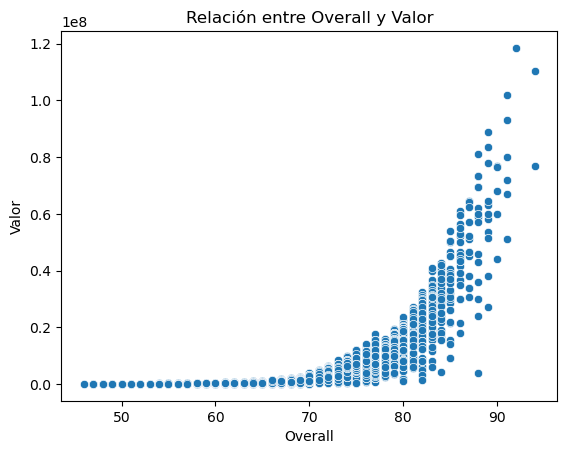

In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error
from math import sqrt

datos_fifa = pd.read_csv('datos_fifa.csv', sep=',', encoding='latin-1')

# Visualización de la relación
sns.scatterplot(x='Overall', y='Valor', data=datos_fifa)
plt.title('Relación entre Overall y Valor')
plt.xlabel('Overall')
plt.ylabel('Valor')
plt.show()



In [63]:
# División de los datos en conjunto de entrenamiento y prueba
X = datos_fifa[['Overall']]
y = datos_fifa['Valor']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Ajuste del modelo lineal simple
model_simple = LinearRegression()
model_simple.fit(X_train, y_train)


LinearRegression()

In [64]:
# Ajuste del modelo polinómico de grado 2
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X_train)

model_poly = LinearRegression()
model_poly.fit(X_poly, y_train)


LinearRegression()

In [65]:
# Función para calcular RMSE
def calcular_rmse(y_true, y_pred):
    return sqrt(mean_squared_error(y_true, y_pred))

# Predicciones en el conjunto de prueba
y_pred_simple = model_simple.predict(X_test)
y_pred_poly = model_poly.predict(poly.transform(X_test))

# Calcular RMSE
rmse_simple = calcular_rmse(y_test, y_pred_simple)
rmse_poly = calcular_rmse(y_test, y_pred_poly)

print(f'RMSE para modelo lineal simple: {rmse_simple}')
print(f'RMSE para modelo polinómico: {rmse_poly}')


RMSE para modelo lineal simple: 4541200.681202634
RMSE para modelo polinómico: 2776458.148868687


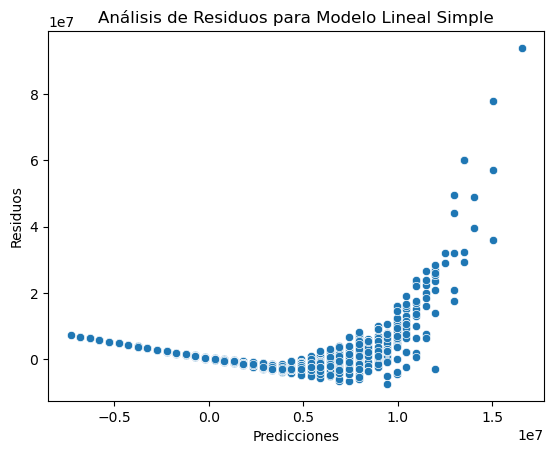

In [66]:
# Análisis de residuos para el modelo lineal simple
residuos_simple = y_test - y_pred_simple
sns.scatterplot(x=y_pred_simple, y=residuos_simple)
plt.title('Análisis de Residuos para Modelo Lineal Simple')
plt.xlabel('Predicciones')
plt.ylabel('Residuos')
plt.show()


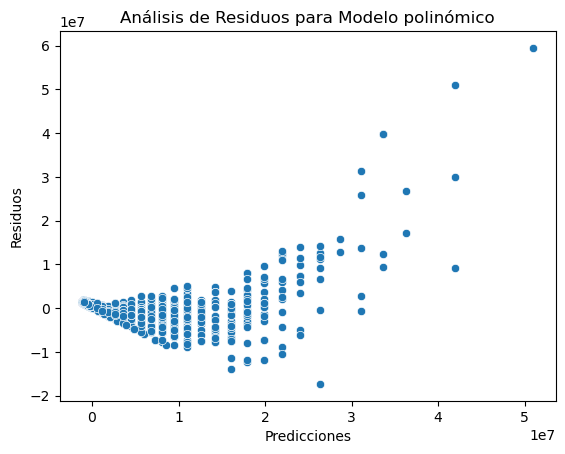

In [67]:
# Análisis de residuos para el modelo lineal simple
residuos_poly = y_test - y_pred_poly
sns.scatterplot(x=y_pred_poly, y=residuos_poly)
plt.title('Análisis de Residuos para Modelo polinómico')
plt.xlabel('Predicciones')
plt.ylabel('Residuos')
plt.show()


# 2.5. Modelo Robusto

## Ejercicio 2.6.

La base de datos `crime.xlsx` tiene 51 observaciones de las siguientes variables:

- `state`: Vector de caracteres que representa al estado.
- `violent`: Tasa de crímenes violentos por cada 100,000 habitantes.
- `murder`: Variable numérica que indica la cantidad cada 100,000 habitantes de asesinatos.
- `poverty`: Variable numérica que indica la proporción de habitantes que están por debajo del límite de pobreza.
- `single`: Variable numérica que indica el porcentaje de familias que tiene un único padre a cargo de la misma.
- `metro`: Variable numérica que indica la proporción de familias que habitan en áreas metropolitanas.
- `white`: Porcentaje de población blanca.
- `highschool`: Porcentaje de habitantes graduados de la escuela secundaria.

### a) Ajustar un modelo de regresión OLS y realizar analítica y gráficamente un análisis diagnóstico examinando leverage y distancias de Cook.

### b) Identificar las observaciones influyentes (recordar que 4/n es un valor de corte muy utilizado para las distancias de Cook). Ajustar un modelo OLS sin esas observaciones. Comparar los coeficientes estimados en ambos modelos.

### c) Generar una nueva variable con el valor absoluto de los residuos y señalar los diez residuos más altos. ¿Coinciden con los valores influyentes?

### d) Ajustar un modelo de regresión robusta mediante mínimos cuadrados ponderados iterados (IRLS). El comando para ejecutar una regresión robusta está `rlm` en la biblioteca `MASS`. Se pueden utilizar varias funciones de ponderación en IRLS, usar en primera instancia los pesos de Huber.

### e) Hacerlo ahora con los pesos de la función bicuadrada ( `psi = psi.bisquare`).

**Nota:** Para aquellos que quieran profundizar en modelos robustos: La regresión robusta no aborda los problemas de heterogeneidad de la varianza. Para solucionar este problema se puede utilizar la librería `sandwich`. El ejemplo presentado utiliza M estimadores. Hay otras opciones de estimación disponibles en `rlm`: mínimos cuadrados recortados usando `ltsReg` de la biblioteca `robustbase` y MM-estimadores usando `rlm`.


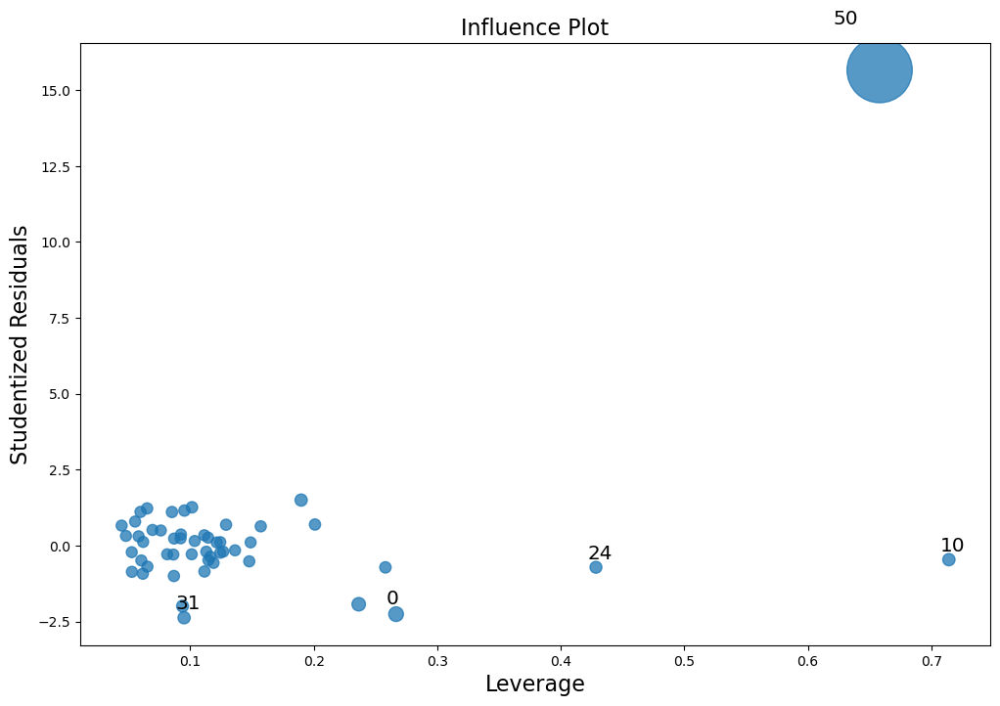

In [68]:
import pandas as pd
import statsmodels.api as sm
import statsmodels.stats as stats
import matplotlib.pyplot as plt

# Cargar los datos desde el archivo crime.xlsx
data = pd.read_csv('crime.csv', sep=';', decimal='.')

# Ajustar un modelo de regresión OLS
y = data['murder']
X = data.drop(['sid','murder','state'], axis=1)
X = sm.add_constant(X)

model_ols = sm.OLS(y, X).fit()

# Análisis diagnóstico
fig, ax = plt.subplots(figsize=(12,8))
sm.graphics.influence_plot(model_ols, ax=ax, criterion="cooks")
plt.show()


In [69]:
# Identificar las observaciones influyentes
influence = model_ols.get_influence()
cooks_distance = influence.cooks_distance[0]

# Identificar las observaciones influyentes usando un umbral
influential_obs = cooks_distance > 4 / len(data)

# Filtrar el DataFrame original para excluir las observaciones influyentes
data_no_influence = data[~influential_obs]

# Ajustar un nuevo modelo OLS sin las observaciones influyentes
y_no_influence = data_no_influence['murder']
X_no_influence = data_no_influence.drop(['sid','murder','state'], axis=1)
X_no_influence = sm.add_constant(X_no_influence)

model_ols_no_influence = sm.OLS(y_no_influence, X_no_influence).fit()

# Comparar los coeficientes estimados
print(model_ols.summary())
print(model_ols_no_influence.summary())


                            OLS Regression Results                            
Dep. Variable:                 murder   R-squared:                       0.857
Model:                            OLS   Adj. R-squared:                  0.837
Method:                 Least Squares   F-statistic:                     43.91
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.46e-17
Time:                        20:59:36   Log-Likelihood:                -143.25
No. Observations:                  51   AIC:                             300.5
Df Residuals:                      44   BIC:                             314.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -5.8125     17.278     -0.336      0.7

In [70]:
# Calcular los residuos absolutos
residuals_abs = abs(model_ols.resid)

# Añadir una nueva columna al DataFrame con los residuos absolutos
data['residuals_abs'] = residuals_abs

# Señalar los diez residuos más altos
top_residuals = data.nlargest(10, 'residuals_abs')
print(top_residuals['residuals_abs'].index.tolist())
print(data[influential_obs].index.tolist())

[50, 31, 0, 39, 8, 48, 44, 37, 6, 29]
[0, 8, 10, 50]


In [71]:
from statsmodels.robust.robust_linear_model import RLM

# Ajustar un modelo robusto con pesos de Huber
model_robust_huber = RLM(y, X, M=sm.robust.norms.HuberT()).fit()

# Mostrar los resultados del modelo robusto con pesos de Huber
print(model_robust_huber.summary())


                    Robust linear Model Regression Results                    
Dep. Variable:                 murder   No. Observations:                   51
Model:                            RLM   Df Residuals:                       44
Method:                          IRLS   Df Model:                            6
Norm:                          HuberT                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Wed, 15 Nov 2023                                         
Time:                        20:59:38                                         
No. Iterations:                    20                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.4836      6.744      0.961      0.3

In [72]:
# Ajustar un modelo robusto con pesos de la función bicuadrada
model_robust_bicuad = RLM(y, X, M=sm.robust.norms.TukeyBiweight()).fit()

# Mostrar los resultados del modelo robusto con pesos de la función bicuadrada
print(model_robust_bicuad.summary())

                    Robust linear Model Regression Results                    
Dep. Variable:                 murder   No. Observations:                   51
Model:                            RLM   Df Residuals:                       44
Method:                          IRLS   Df Model:                            6
Norm:                   TukeyBiweight                                         
Scale Est.:                       mad                                         
Cov Type:                          H1                                         
Date:                Wed, 15 Nov 2023                                         
Time:                        20:59:38                                         
No. Iterations:                    27                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.7592      7.093      1.376      0.1

# 2.6. Regresión Cuantiles

## Ejercicio 2.7.

En la base de datos `USgirl` de la biblioteca `Brq` de R, se encuentran 500 registros correspondientes a edad y peso de mujeres de Estados Unidos.

### a) Graficar los pesos versus las edades. ¿Qué se puede apreciar en este diagrama de dispersión?

### b) Ajustar un modelo para la mediana y graficar.

### c) Ajustar un modelo para los cuartiles y graficar.

### d) Ajustar un modelo para los deciles y graficar.


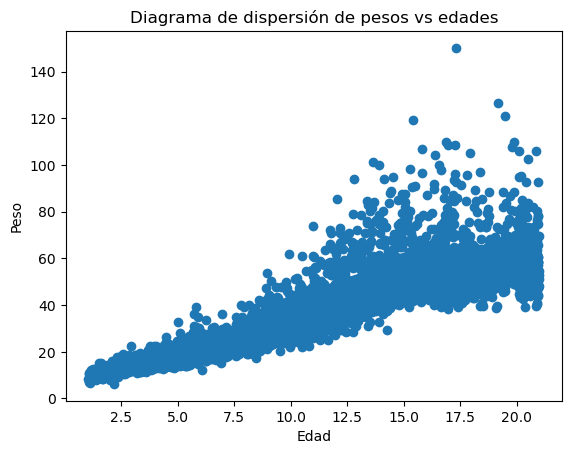

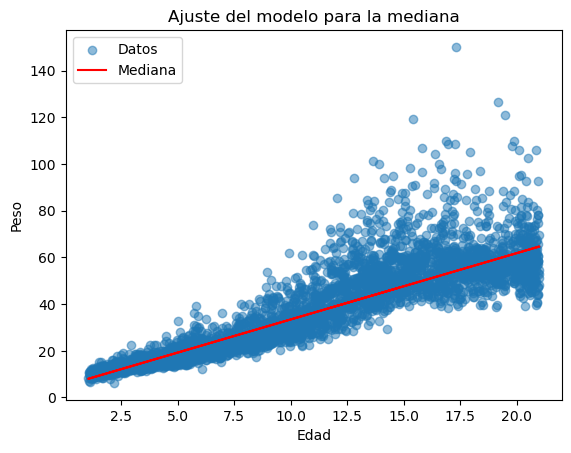

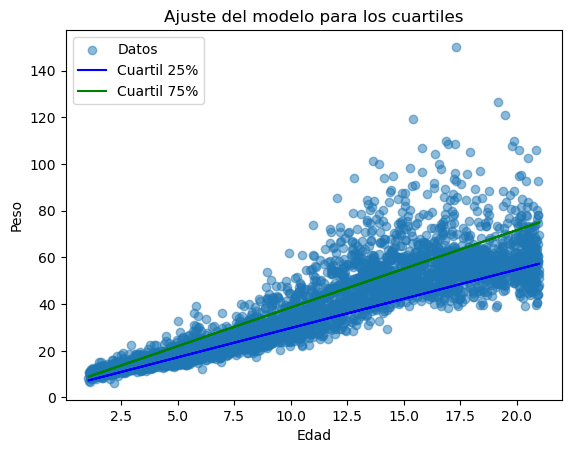

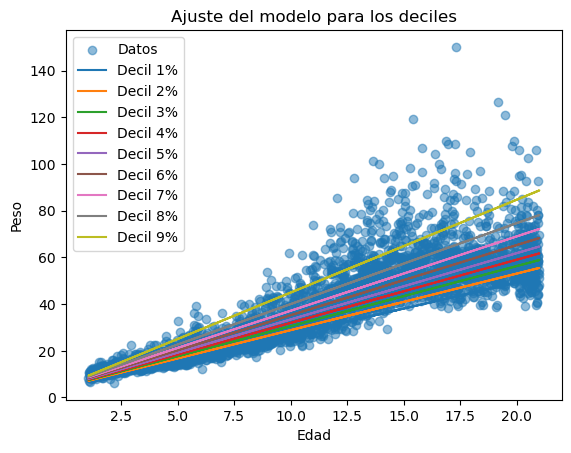

In [73]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm

df = pd.read_csv('USGirl.csv')

# a) Graficar los pesos versus las edades
plt.scatter(df['Age'], df['Weight'])
plt.title('Diagrama de dispersión de pesos vs edades')
plt.xlabel('Edad')
plt.ylabel('Peso')
plt.show()

# b) Ajustar un modelo para la mediana y graficar
# Utilizaremos la regresión cuantil con q=0.5 para la mediana
X = sm.add_constant(df['Age'])
model_median = sm.QuantReg(df['Weight'], X).fit(q=0.5)

# Graficar los resultados
plt.scatter(df['Age'], df['Weight'], alpha=0.5, label='Datos')
plt.plot(df['Age'], model_median.predict(X), color='red', label='Mediana')
plt.title('Ajuste del modelo para la mediana')
plt.xlabel('Edad')
plt.ylabel('Peso')
plt.legend()
plt.show()

# c) Ajustar un modelo para los cuartiles y graficar
# Utilizaremos la regresión cuantil con q=0.25 y q=0.75 para los cuartiles
model_q25 = sm.QuantReg(df['Weight'], X).fit(q=0.25)
model_q75 = sm.QuantReg(df['Weight'], X).fit(q=0.75)

# Graficar los resultados
plt.scatter(df['Age'], df['Weight'], alpha=0.5, label='Datos')
plt.plot(df['Age'], model_q25.predict(X), color='blue', label='Cuartil 25%')
plt.plot(df['Age'], model_q75.predict(X), color='green', label='Cuartil 75%')
plt.title('Ajuste del modelo para los cuartiles')
plt.xlabel('Edad')
plt.ylabel('Peso')
plt.legend()
plt.show()

# d) Ajustar un modelo para los deciles y graficar
# Utilizaremos la regresión cuantil con varios valores de q para los deciles
quantiles = np.arange(0.1, 1, 0.1)
models_deciles = [sm.QuantReg(df['Weight'], X).fit(q=q) for q in quantiles]

# Graficar los resultados
plt.scatter(df['Age'], df['Weight'], alpha=0.5, label='Datos')
for i, q in enumerate(quantiles):
    plt.plot(df['Age'], models_deciles[i].predict(X), label=f'Decil {int(q*100)}%')

plt.title('Ajuste del modelo para los deciles')
plt.xlabel('Edad')
plt.ylabel('Peso')
plt.legend()
plt.show()


# 3.1. Selección de Variables

## Ejercicio 3.1.

Con los datos `table.b3` de la librería `MPV` (Montgomery, D.C., Peck, E.A., and Vining, C.G. (2001)) de R, donde se registran para 32 automóviles las siguientes variables:

- `y` → Rendimiento en millas por galón
- `x1` → Desplazamiento
- `x2` → Potencia (pies-libras)
- `x3` → Torque (pies-libras)
- `x4` → Tasa de Compresión
- `x5` → Relación del eje trasero
- `x6` → Carburador (barriles)
- `x7` → Número de velocidades de trasmisión
- `x8` → Longitud Total (pulgadas)
- `x9` → Ancho (pulgadas)
- `x10` → Peso (libras)
- `x11` → Tipo de trasmisión (1=automática, 0=manual)

### (a) Ajustar el modelo saturado (que contiene a todas las variables dependientes).

### (b) Analizar a través del VIF la presencia de multicolinealidad.

### (c) Realizar una selección de variables forward teniendo en cuenta el criterio de Akaike.

### (d) Escribir la expresión del modelo seleccionado. Realizar un análisis diagnóstico del mismo.

### (e) Realizar una selección backward teniendo en cuenta el criterio de R2 ajustado. ¿Se selecciona el mismo modelo?

### (f) Utilizando la función `ols_step_all_possible` de la biblioteca `olsrr` creada por Hebbali (2020) obtener todas las regresiones posibles. Elegir un único modelo visualizando gráficamente los resultados y considerando los criterios BIC, AIC, CP y R2 adj.


In [104]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Cargar el conjunto de datos desde el archivo tableb3.csv
df = pd.read_csv("tableb3.csv").dropna()

# (a) Ajustar el modelo saturado
X_saturado = sm.add_constant(df.drop('y', axis=1))  # Agregar la constante al conjunto de datos
y = df['y']
modelo_saturado = sm.OLS(y, X_saturado).fit()

# Mostrar resumen del modelo saturado
print(modelo_saturado.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.835
Model:                            OLS   Adj. R-squared:                  0.735
Method:                 Least Squares   F-statistic:                     8.310
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.23e-05
Time:                        23:07:23   Log-Likelihood:                -70.049
No. Observations:                  30   AIC:                             164.1
Df Residuals:                      18   BIC:                             180.9
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.3398     30.355      0.571      0.5

In [105]:
# (b) Analizar a través del VIF la presencia de multicolinealidad
def calcular_vif(data_frame):
    variables = data_frame.values
    vif_data = pd.DataFrame()
    vif_data["Variable"] = data_frame.columns
    vif_data["VIF"] = [variance_inflation_factor(variables, i) for i in range(variables.shape[1])]
    return vif_data

# Calcular y mostrar el VIF para cada variable
vif_resultados = calcular_vif(df.drop('y', axis=1))
print("\nResultados del VIF:") # multicolinealidad
print(vif_resultados)


Resultados del VIF:
   Variable          VIF
0        x1   779.976265
1        x2   415.926499
2        x3  1107.123637
3        x4  1222.684743
4        x5   274.598070
5        x6    35.086199
6        x7   316.246279
7        x8  1639.001636
8        x9  1110.932668
9       x10  1128.323533
10      x11    18.295405


In [106]:
import numpy as np

def forward_selection_aic(X, y):
    """
    Realiza la selección de variables hacia adelante utilizando el criterio de AIC.

    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.

    Returns:
    - selected_features: Lista de nombres de las variables seleccionadas.
    """

    features = list(X.columns)
    selected_features = []
    best_aic = np.inf

    while features:
        aic_values = []
        for feature in features:
            model = sm.OLS(y, sm.add_constant(X[selected_features + [feature]])).fit()
            aic = model.aic
            aic_values.append((feature, aic))

        best_feature, min_aic = min(aic_values, key=lambda x: x[1])

        if min_aic < best_aic:
            selected_features.append(best_feature)
            best_aic = min_aic
        else:
            break

    return selected_features

# Separar variables predictoras y variable de respuesta
X = df.drop('y', axis=1)
y = df['y']

# Realizar la selección de variables hacia adelante con AIC
selected_features = forward_selection_aic(X, y)

# Imprimir las variables seleccionadas
print("Variables seleccionadas:", selected_features)

# (d) Escribir la expresión del modelo seleccionado y realizar un análisis diagnóstico
model = sm.OLS(y, sm.add_constant(X[selected_features])).fit()
print(model.summary())


Variables seleccionadas: ['x1', 'x4']
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.777
Model:                            OLS   Adj. R-squared:                  0.760
Method:                 Least Squares   F-statistic:                     47.03
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.59e-09
Time:                        23:07:25   Log-Likelihood:                -74.612
No. Observations:                  30   AIC:                             155.2
Df Residuals:                      27   BIC:                             159.4
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         

In [107]:
def backward_selected(X, y):
    """
    Realiza la selección de variables hacia atrás utilizando el criterio de R2 ajustado.

    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.

    Returns:
    - model: Modelo ajustado con las variables seleccionadas.
    """

    features = list(X.columns)
    while features:
        X_temp = sm.add_constant(X[features])
        model = sm.OLS(y, X_temp).fit()
        adj_r2 = model.rsquared_adj
        p_values = model.pvalues.iloc[1:]

        # Encontrar la variable con el p-valor más alto
        max_p_value = p_values.max()
        if max_p_value > 0.05:
            exclude_feature = p_values.idxmax()
            features.remove(exclude_feature)
        else:
            break

    # Imprimir las variables seleccionadas
    print("Variables seleccionadas:", features)
    model = sm.OLS(y, sm.add_constant(X[features])).fit()
    return model

# Realizar la selección hacia atrás
model = backward_selected(X, y)

# Imprimir el resumen del modelo seleccionado
print(model.summary())

Variables seleccionadas: ['x8', 'x10']
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.772
Model:                            OLS   Adj. R-squared:                  0.755
Method:                 Least Squares   F-statistic:                     45.61
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.20e-09
Time:                        23:07:26   Log-Likelihood:                -74.968
No. Observations:                  30   AIC:                             155.9
Df Residuals:                      27   BIC:                             160.1
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        

In [108]:
# (f) Obtener todas las regresiones posibles
from itertools import chain, combinations

# Separar variables predictoras y variable de respuesta
X = df.drop('y', axis=1)
y = df['y']

# Función para obtener todas las regresiones posibles
# def all_subsets(X, y):
#     """
#     Obtiene todas las regresiones posibles utilizando combinaciones de variables predictoras.

#     Parameters:
#     - X: DataFrame de variables predictoras.
#     - y: Serie de la variable de respuesta.

#     Returns:
#     - results: Lista de modelos ajustados para cada combinación de variables.
#     """

#     results = []
#     all_features = list(X.columns)

#     for k in range(1, len(all_features) + 1):
#         subsets = combinations(all_features, k)
#         for subset in subsets:
#             model = sm.OLS(y, sm.add_constant(X[list(subset)])).fit()
#             results.append(model)

#     return results

def all_subsets(X, y, n=None):
    """
    Obtiene todas las regresiones posibles utilizando combinaciones de variables predictoras.
    
    Parameters:
    - X: DataFrame de variables predictoras.
    - y: Serie de la variable de respuesta.
    - n: Número máximo de predictores a utilizar (por defecto, utiliza todos los predictores disponibles).
    
    Returns:
    - results: Lista de modelos ajustados para cada combinación de variables.
    """
    results = []
    all_features = list(X.columns)
    
    if n is None:
        n = len(all_features)
    
    for k in range(1, min(n, len(all_features)) + 1):
        subsets = combinations(all_features, k)
        for subset in subsets:
            model = sm.OLS(y, sm.add_constant(X[list(subset)])).fit()
            results.append(model)
    
    return results




# Obtener todas las regresiones posibles
all_models = all_subsets(X, y)

# Imprimir resumen de cada modelo
for idx, model in enumerate(all_models):
    print(f"Modelo {idx + 1} - Variables: {list(model.model.exog_names[1:])}")
    print(model.summary())
    print("="*80) # Separador para mayor claridad en la salida



Modelo 1 - Variables: ['x1']
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.761
Model:                            OLS   Adj. R-squared:                  0.752
Method:                 Least Squares   F-statistic:                     89.00
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.43e-10
Time:                        23:07:45   Log-Likelihood:                -75.671
No. Observations:                  30   AIC:                             155.3
Df Residuals:                      28   BIC:                             158.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.4900  

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.765
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     43.94
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.23e-09
Time:                        23:07:45   Log-Likelihood:                -75.399
No. Observations:                  30   AIC:                             156.8
Df Residuals:                      27   BIC:                             161.0
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.3616      6.073      4.835      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.713
Model:                            OLS   Adj. R-squared:                  0.692
Method:                 Least Squares   F-statistic:                     33.57
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.76e-08
Time:                        23:07:46   Log-Likelihood:                -78.386
No. Observations:                  30   AIC:                             162.8
Df Residuals:                      27   BIC:                             167.0
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         61.2621      9.769      6.271      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.608
Model:                            OLS   Adj. R-squared:                  0.579
Method:                 Least Squares   F-statistic:                     20.93
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.24e-06
Time:                        23:07:46   Log-Likelihood:                -83.074
No. Observations:                  30   AIC:                             172.1
Df Residuals:                      27   BIC:                             176.4
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.4277     26.887      0.723      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.728
Model:                            OLS   Adj. R-squared:                  0.708
Method:                 Least Squares   F-statistic:                     36.22
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.27e-08
Time:                        23:07:46   Log-Likelihood:                -77.564
No. Observations:                  30   AIC:                             161.1
Df Residuals:                      27   BIC:                             165.3
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.7284      2.516     16.190      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.780
Model:                            OLS   Adj. R-squared:                  0.755
Method:                 Least Squares   F-statistic:                     30.74
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.05e-08
Time:                        23:07:46   Log-Likelihood:                -74.402
No. Observations:                  30   AIC:                             156.8
Df Residuals:                      26   BIC:                             162.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.7289     19.033      0.406      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.775
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     29.84
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.41e-08
Time:                        23:07:46   Log-Likelihood:                -74.749
No. Observations:                  30   AIC:                             157.5
Df Residuals:                      26   BIC:                             163.1
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         35.1816      3.313     10.620      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.774
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     29.69
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.49e-08
Time:                        23:07:47   Log-Likelihood:                -74.809
No. Observations:                  30   AIC:                             157.6
Df Residuals:                      26   BIC:                             163.2
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7740      6.223      4.945      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.773
Model:                            OLS   Adj. R-squared:                  0.747
Method:                 Least Squares   F-statistic:                     29.58
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.54e-08
Time:                        23:07:47   Log-Likelihood:                -74.850
No. Observations:                  30   AIC:                             157.7
Df Residuals:                      26   BIC:                             163.3
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         47.0660     12.861      3.660      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.712
Model:                            OLS   Adj. R-squared:                  0.679
Method:                 Least Squares   F-statistic:                     21.46
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.30e-07
Time:                        23:07:47   Log-Likelihood:                -78.429
No. Observations:                  30   AIC:                             164.9
Df Residuals:                      26   BIC:                             170.5
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.2657     22.094      0.238      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.737
Model:                            OLS   Adj. R-squared:                  0.707
Method:                 Least Squares   F-statistic:                     24.33
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.03e-07
Time:                        23:07:47   Log-Likelihood:                -77.065
No. Observations:                  30   AIC:                             162.1
Df Residuals:                      26   BIC:                             167.7
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         39.7113      2.745     14.469      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.720
Method:                 Least Squares   F-statistic:                     25.87
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.74e-08
Time:                        23:07:48   Log-Likelihood:                -76.384
No. Observations:                  30   AIC:                             160.8
Df Residuals:                      26   BIC:                             166.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.7597     21.310      0.317      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.720
Method:                 Least Squares   F-statistic:                     25.83
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.82e-08
Time:                        23:07:48   Log-Likelihood:                -76.400
No. Observations:                  30   AIC:                             160.8
Df Residuals:                      26   BIC:                             166.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         37.1177      3.506     10.587      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.504
Model:                            OLS   Adj. R-squared:                  0.447
Method:                 Least Squares   F-statistic:                     8.801
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           0.000339
Time:                        23:07:48   Log-Likelihood:                -86.607
No. Observations:                  30   AIC:                             181.2
Df Residuals:                      26   BIC:                             186.8
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -11.4506     29.698     -0.386      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.635
Model:                            OLS   Adj. R-squared:                  0.593
Method:                 Least Squares   F-statistic:                     15.08
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.94e-06
Time:                        23:07:48   Log-Likelihood:                -82.002
No. Observations:                  30   AIC:                             172.0
Df Residuals:                      26   BIC:                             177.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         38.5928     29.825      1.294      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.658
Model:                            OLS   Adj. R-squared:                  0.619
Method:                 Least Squares   F-statistic:                     16.68
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.01e-06
Time:                        23:07:49   Log-Likelihood:                -81.021
No. Observations:                  30   AIC:                             170.0
Df Residuals:                      26   BIC:                             175.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.2775     11.671      3.794      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.789
Model:                            OLS   Adj. R-squared:                  0.764
Method:                 Least Squares   F-statistic:                     32.35
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.28e-09
Time:                        23:07:49   Log-Likelihood:                -73.804
No. Observations:                  30   AIC:                             155.6
Df Residuals:                      26   BIC:                             161.2
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.6209     11.920      0.723      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.781
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     22.33
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.04e-08
Time:                        23:07:49   Log-Likelihood:                -74.321
No. Observations:                  30   AIC:                             158.6
Df Residuals:                      25   BIC:                             165.6
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.6944     11.153      4.097      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.781
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     22.31
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.06e-08
Time:                        23:07:49   Log-Likelihood:                -74.326
No. Observations:                  30   AIC:                             158.7
Df Residuals:                      25   BIC:                             165.7
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         41.6362     11.369      3.662      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     22.57
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.43e-08
Time:                        23:07:50   Log-Likelihood:                -74.192
No. Observations:                  30   AIC:                             158.4
Df Residuals:                      25   BIC:                             165.4
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         42.4886     11.041      3.848      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.784
Model:                            OLS   Adj. R-squared:                  0.750
Method:                 Least Squares   F-statistic:                     22.74
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.07e-08
Time:                        23:07:50   Log-Likelihood:                -74.107
No. Observations:                  30   AIC:                             158.2
Df Residuals:                      25   BIC:                             165.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.5821      6.295      4.699      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.753
Method:                 Least Squares   F-statistic:                     23.08
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.38e-08
Time:                        23:07:50   Log-Likelihood:                -73.928
No. Observations:                  30   AIC:                             157.9
Df Residuals:                      25   BIC:                             164.9
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.8218     11.736      1.859      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.753
Method:                 Least Squares   F-statistic:                     23.06
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.43e-08
Time:                        23:07:50   Log-Likelihood:                -73.942
No. Observations:                  30   AIC:                             157.9
Df Residuals:                      25   BIC:                             164.9
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0865     23.588      0.894      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.781
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     22.33
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.01e-08
Time:                        23:07:51   Log-Likelihood:                -74.316
No. Observations:                  30   AIC:                             158.6
Df Residuals:                      25   BIC:                             165.6
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.8516     20.999      0.422      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.766
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     20.46
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.38e-07
Time:                        23:07:51   Log-Likelihood:                -75.336
No. Observations:                  30   AIC:                             160.7
Df Residuals:                      25   BIC:                             167.7
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.6068     10.876      2.630      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.776
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     21.62
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.19e-08
Time:                        23:07:51   Log-Likelihood:                -74.695
No. Observations:                  30   AIC:                             159.4
Df Residuals:                      25   BIC:                             166.4
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.6338      3.955      8.504      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.711
Method:                 Least Squares   F-statistic:                     18.81
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.00e-07
Time:                        23:07:51   Log-Likelihood:                -76.290
No. Observations:                  30   AIC:                             162.6
Df Residuals:                      25   BIC:                             169.6
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.4554     22.649      0.197      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.747
Model:                            OLS   Adj. R-squared:                  0.707
Method:                 Least Squares   F-statistic:                     18.47
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.55e-07
Time:                        23:07:52   Log-Likelihood:                -76.496
No. Observations:                  30   AIC:                             163.0
Df Residuals:                      25   BIC:                             170.0
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         47.2613     12.613      3.747      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.716
Model:                            OLS   Adj. R-squared:                  0.670
Method:                 Least Squares   F-statistic:                     15.74
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.48e-06
Time:                        23:07:52   Log-Likelihood:                -78.251
No. Observations:                  30   AIC:                             166.5
Df Residuals:                      25   BIC:                             173.5
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.9923     23.849      0.209      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.747
Model:                            OLS   Adj. R-squared:                  0.707
Method:                 Least Squares   F-statistic:                     18.46
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.56e-07
Time:                        23:07:52   Log-Likelihood:                -76.499
No. Observations:                  30   AIC:                             163.0
Df Residuals:                      25   BIC:                             170.0
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         31.2859     25.370      1.233      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     20.00
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.71e-07
Time:                        23:07:52   Log-Likelihood:                -75.595
No. Observations:                  30   AIC:                             161.2
Df Residuals:                      25   BIC:                             168.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.1176      6.546      4.601      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.720
Model:                            OLS   Adj. R-squared:                  0.675
Method:                 Least Squares   F-statistic:                     16.07
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.23e-06
Time:                        23:07:53   Log-Likelihood:                -78.026
No. Observations:                  30   AIC:                             166.1
Df Residuals:                      25   BIC:                             173.1
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.6619      8.836      2.791      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.778
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     21.95
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.09e-08
Time:                        23:07:53   Log-Likelihood:                -74.518
No. Observations:                  30   AIC:                             159.0
Df Residuals:                      25   BIC:                             166.0
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.4339     11.704      1.490      0.1

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.709
Method:                 Least Squares   F-statistic:                     18.66
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.23e-07
Time:                        23:07:53   Log-Likelihood:                -76.380
No. Observations:                  30   AIC:                             162.8
Df Residuals:                      25   BIC:                             169.8
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.1969     22.311      0.323      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.758
Model:                            OLS   Adj. R-squared:                  0.719
Method:                 Least Squares   F-statistic:                     19.56
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.10e-07
Time:                        23:07:53   Log-Likelihood:                -75.848
No. Observations:                  30   AIC:                             161.7
Df Residuals:                      25   BIC:                             168.7
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.8099     12.382      3.700      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.758
Model:                            OLS   Adj. R-squared:                  0.719
Method:                 Least Squares   F-statistic:                     19.54
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.11e-07
Time:                        23:07:54   Log-Likelihood:                -75.858
No. Observations:                  30   AIC:                             161.7
Df Residuals:                      25   BIC:                             168.7
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.2822     11.791      3.840      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.789
Model:                            OLS   Adj. R-squared:                  0.755
Method:                 Least Squares   F-statistic:                     23.37
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.89e-08
Time:                        23:07:54   Log-Likelihood:                -73.783
No. Observations:                  30   AIC:                             157.6
Df Residuals:                      25   BIC:                             164.6
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.4718     12.970      0.730      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.770
Model:                            OLS   Adj. R-squared:                  0.733
Method:                 Least Squares   F-statistic:                     20.88
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.14e-07
Time:                        23:07:54   Log-Likelihood:                -75.099
No. Observations:                  30   AIC:                             160.2
Df Residuals:                      25   BIC:                             167.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.0685     21.131      0.429      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.691
Model:                            OLS   Adj. R-squared:                  0.641
Method:                 Least Squares   F-statistic:                     13.96
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.10e-06
Time:                        23:07:54   Log-Likelihood:                -79.515
No. Observations:                  30   AIC:                             169.0
Df Residuals:                      25   BIC:                             176.0
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.6756     28.309      1.048      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.754
Model:                            OLS   Adj. R-squared:                  0.715
Method:                 Least Squares   F-statistic:                     19.21
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.48e-07
Time:                        23:07:55   Log-Likelihood:                -76.054
No. Observations:                  30   AIC:                             162.1
Df Residuals:                      25   BIC:                             169.1
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.6643     21.549      0.866      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.689
Model:                            OLS   Adj. R-squared:                  0.640
Method:                 Least Squares   F-statistic:                     13.88
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.31e-06
Time:                        23:07:55   Log-Likelihood:                -79.579
No. Observations:                  30   AIC:                             169.2
Df Residuals:                      25   BIC:                             176.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         53.5662     15.455      3.466      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.753
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     19.04
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.68e-07
Time:                        23:07:55   Log-Likelihood:                -76.151
No. Observations:                  30   AIC:                             162.3
Df Residuals:                      25   BIC:                             169.3
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.8820     16.383      1.885      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     18.07
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.91e-07
Time:                        23:07:55   Log-Likelihood:                -73.699
No. Observations:                  30   AIC:                             159.4
Df Residuals:                      24   BIC:                             167.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.7126     21.779      0.813      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.742
Method:                 Least Squares   F-statistic:                     17.71
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.31e-07
Time:                        23:07:56   Log-Likelihood:                -73.941
No. Observations:                  30   AIC:                             159.9
Df Residuals:                      24   BIC:                             168.3
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.0855      9.202      3.269      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.775
Model:                            OLS   Adj. R-squared:                  0.728
Method:                 Least Squares   F-statistic:                     16.53
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.32e-07
Time:                        23:07:56   Log-Likelihood:                -74.748
No. Observations:                  30   AIC:                             161.5
Df Residuals:                      24   BIC:                             169.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         35.1711      3.869      9.090      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.784
Model:                            OLS   Adj. R-squared:                  0.739
Method:                 Least Squares   F-statistic:                     17.44
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.65e-07
Time:                        23:07:56   Log-Likelihood:                -74.120
No. Observations:                  30   AIC:                             160.2
Df Residuals:                      24   BIC:                             168.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.4561     20.822      0.454      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.768
Model:                            OLS   Adj. R-squared:                  0.719
Method:                 Least Squares   F-statistic:                     15.87
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.21e-07
Time:                        23:07:56   Log-Likelihood:                -75.219
No. Observations:                  30   AIC:                             162.4
Df Residuals:                      24   BIC:                             170.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.1961     11.014      2.742      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.779
Model:                            OLS   Adj. R-squared:                  0.732
Method:                 Least Squares   F-statistic:                     16.88
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.57e-07
Time:                        23:07:57   Log-Likelihood:                -74.502
No. Observations:                  30   AIC:                             161.0
Df Residuals:                      24   BIC:                             169.4
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.6041     13.636      2.978      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.773
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     16.34
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.78e-07
Time:                        23:07:57   Log-Likelihood:                -74.879
No. Observations:                  30   AIC:                             161.8
Df Residuals:                      24   BIC:                             170.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7588      8.612      3.572      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.792
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     18.25
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.76e-07
Time:                        23:07:57   Log-Likelihood:                -73.588
No. Observations:                  30   AIC:                             159.2
Df Residuals:                      24   BIC:                             167.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.4206     23.856      0.940      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.738
Method:                 Least Squares   F-statistic:                     17.32
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.83e-07
Time:                        23:07:57   Log-Likelihood:                -74.205
No. Observations:                  30   AIC:                             160.4
Df Residuals:                      24   BIC:                             168.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         31.6063      7.423      4.258      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.777
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     16.75
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.84e-07
Time:                        23:07:58   Log-Likelihood:                -74.596
No. Observations:                  30   AIC:                             161.2
Df Residuals:                      24   BIC:                             169.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.7159     10.860      2.552      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     17.74
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.27e-07
Time:                        23:07:58   Log-Likelihood:                -73.920
No. Observations:                  30   AIC:                             159.8
Df Residuals:                      24   BIC:                             168.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         41.9631     13.006      3.226      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.753
Method:                 Least Squares   F-statistic:                     18.69
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.40e-07
Time:                        23:07:58   Log-Likelihood:                -73.300
No. Observations:                  30   AIC:                             158.6
Df Residuals:                      24   BIC:                             167.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         20.6076     23.755      0.868      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.786
Model:                            OLS   Adj. R-squared:                  0.741
Method:                 Least Squares   F-statistic:                     17.58
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.47e-07
Time:                        23:07:58   Log-Likelihood:                -74.026
No. Observations:                  30   AIC:                             160.1
Df Residuals:                      24   BIC:                             168.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         10.4930     21.135      0.496      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.782
Model:                            OLS   Adj. R-squared:                  0.736
Method:                 Least Squares   F-statistic:                     17.19
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.03e-07
Time:                        23:07:59   Log-Likelihood:                -74.291
No. Observations:                  30   AIC:                             160.6
Df Residuals:                      24   BIC:                             169.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.1267     21.459      0.425      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.738
Method:                 Least Squares   F-statistic:                     17.37
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.76e-07
Time:                        23:07:59   Log-Likelihood:                -74.170
No. Observations:                  30   AIC:                             160.3
Df Residuals:                      24   BIC:                             168.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         39.0005     12.776      3.053      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.788
Model:                            OLS   Adj. R-squared:                  0.744
Method:                 Least Squares   F-statistic:                     17.82
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.18e-07
Time:                        23:07:59   Log-Likelihood:                -73.864
No. Observations:                  30   AIC:                             159.7
Df Residuals:                      24   BIC:                             168.1
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         38.9918     13.326      2.926      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.775
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     16.57
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.23e-07
Time:                        23:07:59   Log-Likelihood:                -74.722
No. Observations:                  30   AIC:                             161.4
Df Residuals:                      24   BIC:                             169.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         41.2123     18.620      2.213      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.699
Method:                 Least Squares   F-statistic:                     14.46
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.41e-06
Time:                        23:08:00   Log-Likelihood:                -76.281
No. Observations:                  30   AIC:                             164.6
Df Residuals:                      24   BIC:                             173.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.0787     24.017      0.170      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.736
Model:                            OLS   Adj. R-squared:                  0.681
Method:                 Least Squares   F-statistic:                     13.38
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.73e-06
Time:                        23:08:00   Log-Likelihood:                -77.143
No. Observations:                  30   AIC:                             166.3
Df Residuals:                      24   BIC:                             174.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.8651     11.232      2.748      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.759
Model:                            OLS   Adj. R-squared:                  0.709
Method:                 Least Squares   F-statistic:                     15.11
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.61e-07
Time:                        23:08:00   Log-Likelihood:                -75.784
No. Observations:                  30   AIC:                             163.6
Df Residuals:                      24   BIC:                             172.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.2942     12.360      3.745      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.736
Model:                            OLS   Adj. R-squared:                  0.681
Method:                 Least Squares   F-statistic:                     13.37
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.76e-06
Time:                        23:08:00   Log-Likelihood:                -77.156
No. Observations:                  30   AIC:                             166.3
Df Residuals:                      24   BIC:                             174.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.5365     12.960      2.279      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.712
Method:                 Least Squares   F-statistic:                     15.36
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.28e-07
Time:                        23:08:01   Log-Likelihood:                -75.591
No. Observations:                  30   AIC:                             163.2
Df Residuals:                      24   BIC:                             171.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.8240     25.124      1.227      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.712
Method:                 Least Squares   F-statistic:                     15.37
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.24e-07
Time:                        23:08:01   Log-Likelihood:                -75.586
No. Observations:                  30   AIC:                             163.2
Df Residuals:                      24   BIC:                             171.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.5748     22.476      0.693      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.697
Method:                 Least Squares   F-statistic:                     14.33
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.52e-06
Time:                        23:08:01   Log-Likelihood:                -76.379
No. Observations:                  30   AIC:                             164.8
Df Residuals:                      24   BIC:                             173.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.5556     26.301      1.276      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.766
Model:                            OLS   Adj. R-squared:                  0.717
Method:                 Least Squares   F-statistic:                     15.68
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.90e-07
Time:                        23:08:01   Log-Likelihood:                -75.356
No. Observations:                  30   AIC:                             162.7
Df Residuals:                      24   BIC:                             171.1
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         38.5371     15.095      2.553      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.764
Method:                 Least Squares   F-statistic:                     19.78
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.28e-08
Time:                        23:08:02   Log-Likelihood:                -72.620
No. Observations:                  30   AIC:                             157.2
Df Residuals:                      24   BIC:                             165.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.2429     14.037      0.160      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     18.06
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.93e-07
Time:                        23:08:02   Log-Likelihood:                -73.709
No. Observations:                  30   AIC:                             159.4
Df Residuals:                      24   BIC:                             167.8
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         13.6011     18.472      0.736      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.748
Model:                            OLS   Adj. R-squared:                  0.695
Method:                 Least Squares   F-statistic:                     14.21
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.63e-06
Time:                        23:08:02   Log-Likelihood:                -76.473
No. Observations:                  30   AIC:                             164.9
Df Residuals:                      24   BIC:                             173.4
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.7334     22.806      0.120      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     17.79
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.22e-07
Time:                        23:08:02   Log-Likelihood:                -73.889
No. Observations:                  30   AIC:                             159.8
Df Residuals:                      24   BIC:                             168.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.6378     21.908     -0.029      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.766
Model:                            OLS   Adj. R-squared:                  0.717
Method:                 Least Squares   F-statistic:                     15.69
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.88e-07
Time:                        23:08:03   Log-Likelihood:                -75.350
No. Observations:                  30   AIC:                             162.7
Df Residuals:                      24   BIC:                             171.1
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         23.7989     26.320      0.904      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.761
Model:                            OLS   Adj. R-squared:                  0.711
Method:                 Least Squares   F-statistic:                     15.30
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.58e-07
Time:                        23:08:03   Log-Likelihood:                -75.638
No. Observations:                  30   AIC:                             163.3
Df Residuals:                      24   BIC:                             171.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7909      7.475      4.119      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.739
Model:                            OLS   Adj. R-squared:                  0.685
Method:                 Least Squares   F-statistic:                     13.59
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.40e-06
Time:                        23:08:03   Log-Likelihood:                -76.971
No. Observations:                  30   AIC:                             165.9
Df Residuals:                      24   BIC:                             174.3
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.7045     12.966      2.214      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.782
Model:                            OLS   Adj. R-squared:                  0.737
Method:                 Least Squares   F-statistic:                     17.25
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.93e-07
Time:                        23:08:03   Log-Likelihood:                -74.249
No. Observations:                  30   AIC:                             160.5
Df Residuals:                      24   BIC:                             168.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.1537     17.079      1.473      0.1

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.808
Model:                            OLS   Adj. R-squared:                  0.768
Method:                 Least Squares   F-statistic:                     20.22
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.74e-08
Time:                        23:08:04   Log-Likelihood:                -72.356
No. Observations:                  30   AIC:                             156.7
Df Residuals:                      24   BIC:                             165.1
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -7.9046     21.530     -0.367      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.724
Model:                            OLS   Adj. R-squared:                  0.667
Method:                 Least Squares   F-statistic:                     12.61
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.51e-06
Time:                        23:08:04   Log-Likelihood:                -77.795
No. Observations:                  30   AIC:                             167.6
Df Residuals:                      24   BIC:                             176.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         36.9264     27.563      1.340      0.1

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.739
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                     13.56
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.44e-06
Time:                        23:08:04   Log-Likelihood:                -76.993
No. Observations:                  30   AIC:                             166.0
Df Residuals:                      24   BIC:                             174.4
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         55.3896     14.496      3.821      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.764
Method:                 Least Squares   F-statistic:                     19.79
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.23e-08
Time:                        23:08:04   Log-Likelihood:                -72.614
No. Observations:                  30   AIC:                             157.2
Df Residuals:                      24   BIC:                             165.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.7832     13.913      0.200      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.801
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     15.39
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.98e-07
Time:                        23:08:05   Log-Likelihood:                -72.934
No. Observations:                  30   AIC:                             159.9
Df Residuals:                      23   BIC:                             169.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.9131     25.076      1.193      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.785
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     14.01
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.13e-06
Time:                        23:08:05   Log-Likelihood:                -74.052
No. Observations:                  30   AIC:                             162.1
Df Residuals:                      23   BIC:                             171.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.3085     20.943      0.253      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.741
Method:                 Least Squares   F-statistic:                     14.84
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.85e-07
Time:                        23:08:05   Log-Likelihood:                -73.368
No. Observations:                  30   AIC:                             160.7
Df Residuals:                      23   BIC:                             170.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.6161      6.724      4.256      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     14.15
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.04e-06
Time:                        23:08:05   Log-Likelihood:                -73.936
No. Observations:                  30   AIC:                             161.9
Df Residuals:                      23   BIC:                             171.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.6477     10.827      2.738      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.772
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     12.98
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.17e-06
Time:                        23:08:06   Log-Likelihood:                -74.941
No. Observations:                  30   AIC:                             163.9
Df Residuals:                      23   BIC:                             173.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.3245     12.298      2.385      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.798
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     15.17
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.65e-07
Time:                        23:08:06   Log-Likelihood:                -73.105
No. Observations:                  30   AIC:                             160.2
Df Residuals:                      23   BIC:                             170.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.6685     24.366      0.766      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     14.73
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.32e-07
Time:                        23:08:06   Log-Likelihood:                -73.456
No. Observations:                  30   AIC:                             160.9
Df Residuals:                      23   BIC:                             170.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.9177     24.405      0.898      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     14.76
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.21e-07
Time:                        23:08:06   Log-Likelihood:                -73.436
No. Observations:                  30   AIC:                             160.9
Df Residuals:                      23   BIC:                             170.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.2384     25.735      0.670      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.798
Model:                            OLS   Adj. R-squared:                  0.745
Method:                 Least Squares   F-statistic:                     15.11
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.84e-07
Time:                        23:08:07   Log-Likelihood:                -73.151
No. Observations:                  30   AIC:                             160.3
Df Residuals:                      23   BIC:                             170.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.0406     13.231      3.404      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.778
Model:                            OLS   Adj. R-squared:                  0.720
Method:                 Least Squares   F-statistic:                     13.44
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.62e-06
Time:                        23:08:07   Log-Likelihood:                -74.540
No. Observations:                  30   AIC:                             163.1
Df Residuals:                      23   BIC:                             172.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.5918     12.236      2.173      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.742
Method:                 Least Squares   F-statistic:                     14.89
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.65e-07
Time:                        23:08:07   Log-Likelihood:                -73.327
No. Observations:                  30   AIC:                             160.7
Df Residuals:                      23   BIC:                             170.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          7.7766     21.537      0.361      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.742
Method:                 Least Squares   F-statistic:                     14.90
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.62e-07
Time:                        23:08:07   Log-Likelihood:                -73.321
No. Observations:                  30   AIC:                             160.6
Df Residuals:                      23   BIC:                             170.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         23.3356     25.726      0.907      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     14.75
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.23e-07
Time:                        23:08:08   Log-Likelihood:                -73.439
No. Observations:                  30   AIC:                             160.9
Df Residuals:                      23   BIC:                             170.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.8832     25.354      0.745      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.797
Model:                            OLS   Adj. R-squared:                  0.744
Method:                 Least Squares   F-statistic:                     15.05
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.06e-07
Time:                        23:08:08   Log-Likelihood:                -73.201
No. Observations:                  30   AIC:                             160.4
Df Residuals:                      23   BIC:                             170.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         38.1961     12.410      3.078      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.793
Model:                            OLS   Adj. R-squared:                  0.739
Method:                 Least Squares   F-statistic:                     14.71
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.40e-07
Time:                        23:08:08   Log-Likelihood:                -73.471
No. Observations:                  30   AIC:                             160.9
Df Residuals:                      23   BIC:                             170.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         38.5678     14.536      2.653      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     14.77
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.16e-07
Time:                        23:08:08   Log-Likelihood:                -73.428
No. Observations:                  30   AIC:                             160.9
Df Residuals:                      23   BIC:                             170.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         12.9746     15.679      0.828      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.759
Method:                 Least Squares   F-statistic:                     16.22
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.12e-07
Time:                        23:08:09   Log-Likelihood:                -72.299
No. Observations:                  30   AIC:                             158.6
Df Residuals:                      23   BIC:                             168.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.6730     23.484      0.923      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.788
Model:                            OLS   Adj. R-squared:                  0.733
Method:                 Least Squares   F-statistic:                     14.27
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.69e-07
Time:                        23:08:09   Log-Likelihood:                -73.839
No. Observations:                  30   AIC:                             161.7
Df Residuals:                      23   BIC:                             171.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.6497     26.194      0.865      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.799
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     15.22
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.49e-07
Time:                        23:08:09   Log-Likelihood:                -73.065
No. Observations:                  30   AIC:                             160.1
Df Residuals:                      23   BIC:                             169.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.2540     13.789      3.137      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.727
Method:                 Least Squares   F-statistic:                     13.84
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.26e-06
Time:                        23:08:09   Log-Likelihood:                -74.195
No. Observations:                  30   AIC:                             162.4
Df Residuals:                      23   BIC:                             172.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.6008     19.304      2.362      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.686
Method:                 Least Squares   F-statistic:                     11.55
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.74e-06
Time:                        23:08:10   Log-Likelihood:                -76.272
No. Observations:                  30   AIC:                             166.5
Df Residuals:                      23   BIC:                             176.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.9270     24.746      0.159      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.767
Model:                            OLS   Adj. R-squared:                  0.706
Method:                 Least Squares   F-statistic:                     12.59
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.82e-06
Time:                        23:08:10   Log-Likelihood:                -75.297
No. Observations:                  30   AIC:                             164.6
Df Residuals:                      23   BIC:                             174.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.9328     26.408      0.755      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.789
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     14.36
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.14e-07
Time:                        23:08:10   Log-Likelihood:                -73.758
No. Observations:                  30   AIC:                             161.5
Df Residuals:                      23   BIC:                             171.3
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.0818     27.058      0.114      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.759
Model:                            OLS   Adj. R-squared:                  0.696
Method:                 Least Squares   F-statistic:                     12.07
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.02e-06
Time:                        23:08:10   Log-Likelihood:                -75.783
No. Observations:                  30   AIC:                             165.6
Df Residuals:                      23   BIC:                             175.4
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.4758     13.152      3.534      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.736
Method:                 Least Squares   F-statistic:                     14.44
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.69e-07
Time:                        23:08:11   Log-Likelihood:                -73.691
No. Observations:                  30   AIC:                             161.4
Df Residuals:                      23   BIC:                             171.2
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          9.0234     13.602      0.663      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.729
Model:                            OLS   Adj. R-squared:                  0.658
Method:                 Least Squares   F-statistic:                     10.31
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.43e-05
Time:                        23:08:11   Log-Likelihood:                -77.534
No. Observations:                  30   AIC:                             169.1
Df Residuals:                      23   BIC:                             178.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         14.5049     25.990      0.558      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.808
Model:                            OLS   Adj. R-squared:                  0.758
Method:                 Least Squares   F-statistic:                     16.15
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.25e-07
Time:                        23:08:11   Log-Likelihood:                -72.355
No. Observations:                  30   AIC:                             158.7
Df Residuals:                      23   BIC:                             168.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -8.0120     22.130     -0.362      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                     11.45
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.17e-06
Time:                        23:08:11   Log-Likelihood:                -76.372
No. Observations:                  30   AIC:                             166.7
Df Residuals:                      23   BIC:                             176.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.7507     26.934      1.253      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.804
Model:                            OLS   Adj. R-squared:                  0.753
Method:                 Least Squares   F-statistic:                     15.75
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.05e-07
Time:                        23:08:12   Log-Likelihood:                -72.654
No. Observations:                  30   AIC:                             159.3
Df Residuals:                      23   BIC:                             169.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.4466     13.133      0.339      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.754
Method:                 Least Squares   F-statistic:                     15.81
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.92e-07
Time:                        23:08:12   Log-Likelihood:                -72.611
No. Observations:                  30   AIC:                             159.2
Df Residuals:                      23   BIC:                             169.0
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.5637     14.578      0.176      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.773
Model:                            OLS   Adj. R-squared:                  0.713
Method:                 Least Squares   F-statistic:                     13.04
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.10e-06
Time:                        23:08:12   Log-Likelihood:                -74.894
No. Observations:                  30   AIC:                             163.8
Df Residuals:                      23   BIC:                             173.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.6352     25.655      0.960      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.759
Method:                 Least Squares   F-statistic:                     16.26
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.05e-07
Time:                        23:08:12   Log-Likelihood:                -72.270
No. Observations:                  30   AIC:                             158.5
Df Residuals:                      23   BIC:                             168.3
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.4119     25.509      0.134      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.788
Model:                            OLS   Adj. R-squared:                  0.733
Method:                 Least Squares   F-statistic:                     14.25
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.77e-07
Time:                        23:08:13   Log-Likelihood:                -73.850
No. Observations:                  30   AIC:                             161.7
Df Residuals:                      23   BIC:                             171.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7269     23.048      0.032      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.758
Model:                            OLS   Adj. R-squared:                  0.695
Method:                 Least Squares   F-statistic:                     12.02
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.13e-06
Time:                        23:08:13   Log-Likelihood:                -75.821
No. Observations:                  30   AIC:                             165.6
Df Residuals:                      23   BIC:                             175.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         47.7502     17.085      2.795      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.735
Method:                 Least Squares   F-statistic:                     14.40
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.94e-07
Time:                        23:08:14   Log-Likelihood:                -73.728
No. Observations:                  30   AIC:                             161.5
Df Residuals:                      23   BIC:                             171.3
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.6231     14.628      0.589      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.749
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                     11.45
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.16e-06
Time:                        23:08:14   Log-Likelihood:                -76.370
No. Observations:                  30   AIC:                             166.7
Df Residuals:                      23   BIC:                             176.5
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.3721     27.106      1.231      0.2

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.736
Method:                 Least Squares   F-statistic:                     14.47
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           8.54e-07
Time:                        23:08:14   Log-Likelihood:                -73.666
No. Observations:                  30   AIC:                             161.3
Df Residuals:                      23   BIC:                             171.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.1642     27.550      0.079      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.798
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     12.41
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.39e-06
Time:                        23:08:15   Log-Likelihood:                -73.131
No. Observations:                  30   AIC:                             162.3
Df Residuals:                      22   BIC:                             173.5
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         12.8991     23.230      0.555      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.795
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     12.15
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.85e-06
Time:                        23:08:15   Log-Likelihood:                -73.383
No. Observations:                  30   AIC:                             162.8
Df Residuals:                      22   BIC:                             174.0
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.8350     26.291      0.945      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.785
Model:                            OLS   Adj. R-squared:                  0.717
Method:                 Least Squares   F-statistic:                     11.49
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.53e-06
Time:                        23:08:15   Log-Likelihood:                -74.052
No. Observations:                  30   AIC:                             164.1
Df Residuals:                      22   BIC:                             175.3
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.4151     23.967      0.226      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     13.32
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.32e-06
Time:                        23:08:15   Log-Likelihood:                -72.278
No. Observations:                  30   AIC:                             160.6
Df Residuals:                      22   BIC:                             171.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         37.4747     12.320      3.042      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.725
Method:                 Least Squares   F-statistic:                     11.90
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.40e-06
Time:                        23:08:16   Log-Likelihood:                -73.638
No. Observations:                  30   AIC:                             163.3
Df Residuals:                      22   BIC:                             174.5
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.7902      8.910      3.119      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.797
Model:                            OLS   Adj. R-squared:                  0.732
Method:                 Least Squares   F-statistic:                     12.33
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.52e-06
Time:                        23:08:16   Log-Likelihood:                -73.208
No. Observations:                  30   AIC:                             162.4
Df Residuals:                      22   BIC:                             173.6
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.1370     12.747      1.658      0.1

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.789
Model:                            OLS   Adj. R-squared:                  0.722
Method:                 Least Squares   F-statistic:                     11.74
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.78e-06
Time:                        23:08:16   Log-Likelihood:                -73.790
No. Observations:                  30   AIC:                             163.6
Df Residuals:                      22   BIC:                             174.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.5835     27.174      0.794      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.792
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     11.99
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.18e-06
Time:                        23:08:16   Log-Likelihood:                -73.542
No. Observations:                  30   AIC:                             163.1
Df Residuals:                      22   BIC:                             174.3
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.0838     27.620      0.619      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     12.13
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.89e-06
Time:                        23:08:17   Log-Likelihood:                -73.405
No. Observations:                  30   AIC:                             162.8
Df Residuals:                      22   BIC:                             174.0
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.1163     26.294      0.651      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     13.01
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.62e-06
Time:                        23:08:17   Log-Likelihood:                -72.569
No. Observations:                  30   AIC:                             161.1
Df Residuals:                      22   BIC:                             172.3
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.1906     16.575      0.253      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.794
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     12.15
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.86e-06
Time:                        23:08:17   Log-Likelihood:                -73.387
No. Observations:                  30   AIC:                             162.8
Df Residuals:                      22   BIC:                             174.0
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.5925     19.155      1.388      0.1

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     12.28
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.62e-06
Time:                        23:08:17   Log-Likelihood:                -73.260
No. Observations:                  30   AIC:                             162.5
Df Residuals:                      22   BIC:                             173.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.9077     22.253      0.400      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.792
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     11.95
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.27e-06
Time:                        23:08:18   Log-Likelihood:                -73.583
No. Observations:                  30   AIC:                             163.2
Df Residuals:                      22   BIC:                             174.4
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.5338     23.089      0.370      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.800
Model:                            OLS   Adj. R-squared:                  0.737
Method:                 Least Squares   F-statistic:                     12.58
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.13e-06
Time:                        23:08:18   Log-Likelihood:                -72.967
No. Observations:                  30   AIC:                             161.9
Df Residuals:                      22   BIC:                             173.1
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         12.3899     27.920      0.444      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.812
Model:                            OLS   Adj. R-squared:                  0.753
Method:                 Least Squares   F-statistic:                     13.61
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.10e-06
Time:                        23:08:18   Log-Likelihood:                -72.022
No. Observations:                  30   AIC:                             160.0
Df Residuals:                      22   BIC:                             171.3
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.1902     16.187      0.321      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.723
Method:                 Least Squares   F-statistic:                     11.82
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.58e-06
Time:                        23:08:18   Log-Likelihood:                -73.712
No. Observations:                  30   AIC:                             163.4
Df Residuals:                      22   BIC:                             174.6
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.2322     23.796      0.178      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     12.25
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.67e-06
Time:                        23:08:19   Log-Likelihood:                -73.292
No. Observations:                  30   AIC:                             162.6
Df Residuals:                      22   BIC:                             173.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.7591     25.796      0.727      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.672
Method:                 Least Squares   F-statistic:                     9.480
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.08e-05
Time:                        23:08:19   Log-Likelihood:                -76.265
No. Observations:                  30   AIC:                             168.5
Df Residuals:                      22   BIC:                             179.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.7221     26.423      0.179      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.672
Method:                 Least Squares   F-statistic:                     9.477
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.08e-05
Time:                        23:08:19   Log-Likelihood:                -76.268
No. Observations:                  30   AIC:                             168.5
Df Residuals:                      22   BIC:                             179.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.4499     26.099      0.132      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.687
Method:                 Least Squares   F-statistic:                     10.08
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.29e-05
Time:                        23:08:19   Log-Likelihood:                -75.571
No. Observations:                  30   AIC:                             167.1
Df Residuals:                      22   BIC:                             178.4
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         20.6654     29.338      0.704      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     13.34
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.30e-06
Time:                        23:08:20   Log-Likelihood:                -72.262
No. Observations:                  30   AIC:                             160.5
Df Residuals:                      22   BIC:                             171.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.4338     14.715     -0.029      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.749
Method:                 Least Squares   F-statistic:                     13.35
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.30e-06
Time:                        23:08:20   Log-Likelihood:                -72.253
No. Observations:                  30   AIC:                             160.5
Df Residuals:                      22   BIC:                             171.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.2996     15.654     -0.083      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.774
Model:                            OLS   Adj. R-squared:                  0.702
Method:                 Least Squares   F-statistic:                     10.78
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.57e-06
Time:                        23:08:20   Log-Likelihood:                -74.794
No. Observations:                  30   AIC:                             165.6
Df Residuals:                      22   BIC:                             176.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.2429     28.029      0.651      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.687
Method:                 Least Squares   F-statistic:                     10.09
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.28e-05
Time:                        23:08:20   Log-Likelihood:                -75.557
No. Observations:                  30   AIC:                             167.1
Df Residuals:                      22   BIC:                             178.3
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.1549     29.859      0.642      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.775
Model:                            OLS   Adj. R-squared:                  0.704
Method:                 Least Squares   F-statistic:                     10.83
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.27e-06
Time:                        23:08:21   Log-Likelihood:                -74.735
No. Observations:                  30   AIC:                             165.5
Df Residuals:                      22   BIC:                             176.7
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         17.5147     27.325      0.641      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.750
Method:                 Least Squares   F-statistic:                     13.46
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.21e-06
Time:                        23:08:21   Log-Likelihood:                -72.156
No. Observations:                  30   AIC:                             160.3
Df Residuals:                      22   BIC:                             171.5
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2611     27.094      0.010      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.751
Method:                 Least Squares   F-statistic:                     13.48
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.19e-06
Time:                        23:08:21   Log-Likelihood:                -72.133
No. Observations:                  30   AIC:                             160.3
Df Residuals:                      22   BIC:                             171.5
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.7066     19.457      0.447      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.791
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     11.88
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.44e-06
Time:                        23:08:21   Log-Likelihood:                -73.657
No. Observations:                  30   AIC:                             163.3
Df Residuals:                      22   BIC:                             174.5
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.5386     28.338      0.090      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.801
Model:                            OLS   Adj. R-squared:                  0.725
Method:                 Least Squares   F-statistic:                     10.55
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.78e-06
Time:                        23:08:22   Log-Likelihood:                -72.917
No. Observations:                  30   AIC:                             163.8
Df Residuals:                      21   BIC:                             176.4
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         14.0644     23.703      0.593      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.738
Method:                 Least Squares   F-statistic:                     11.23
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.75e-06
Time:                        23:08:22   Log-Likelihood:                -72.167
No. Observations:                  30   AIC:                             162.3
Df Residuals:                      21   BIC:                             174.9
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.4716     26.749      0.952      0.3

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.801
Model:                            OLS   Adj. R-squared:                  0.725
Method:                 Least Squares   F-statistic:                     10.57
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.71e-06
Time:                        23:08:22   Log-Likelihood:                -72.904
No. Observations:                  30   AIC:                             163.8
Df Residuals:                      21   BIC:                             176.4
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         23.1582     27.407      0.845      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.718
Method:                 Least Squares   F-statistic:                     10.24
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.89e-06
Time:                        23:08:22   Log-Likelihood:                -73.284
No. Observations:                  30   AIC:                             164.6
Df Residuals:                      21   BIC:                             177.2
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.9523     12.370      2.098      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.807
Model:                            OLS   Adj. R-squared:                  0.733
Method:                 Least Squares   F-statistic:                     10.94
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.84e-06
Time:                        23:08:23   Log-Likelihood:                -72.481
No. Observations:                  30   AIC:                             163.0
Df Residuals:                      21   BIC:                             175.6
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         50.1276     19.320      2.595      0.0

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.739
Method:                 Least Squares   F-statistic:                     11.25
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.69e-06
Time:                        23:08:23   Log-Likelihood:                -72.146
No. Observations:                  30   AIC:                             162.3
Df Residuals:                      21   BIC:                             174.9
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.9342     24.805      0.804      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.740
Method:                 Least Squares   F-statistic:                     11.29
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.54e-06
Time:                        23:08:23   Log-Likelihood:                -72.098
No. Observations:                  30   AIC:                             162.2
Df Residuals:                      21   BIC:                             174.8
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.0530     25.774      0.700      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.806
Model:                            OLS   Adj. R-squared:                  0.732
Method:                 Least Squares   F-statistic:                     10.88
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.12e-06
Time:                        23:08:23   Log-Likelihood:                -72.552
No. Observations:                  30   AIC:                             163.1
Df Residuals:                      21   BIC:                             175.7
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.8175     17.431      0.276      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.815
Model:                            OLS   Adj. R-squared:                  0.744
Method:                 Least Squares   F-statistic:                     11.55
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.79e-06
Time:                        23:08:24   Log-Likelihood:                -71.822
No. Observations:                  30   AIC:                             161.6
Df Residuals:                      21   BIC:                             174.3
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.3550     27.531      0.303      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.801
Model:                            OLS   Adj. R-squared:                  0.725
Method:                 Least Squares   F-statistic:                     10.54
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           7.84e-06
Time:                        23:08:24   Log-Likelihood:                -72.929
No. Observations:                  30   AIC:                             163.9
Df Residuals:                      21   BIC:                             176.5
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         10.7895     29.384      0.367      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.798
Model:                            OLS   Adj. R-squared:                  0.721
Method:                 Least Squares   F-statistic:                     10.35
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           9.09e-06
Time:                        23:08:24   Log-Likelihood:                -73.154
No. Observations:                  30   AIC:                             164.3
Df Residuals:                      21   BIC:                             176.9
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.0641     27.737      0.795      0.4

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.810
Model:                            OLS   Adj. R-squared:                  0.738
Method:                 Least Squares   F-statistic:                     11.21
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.83e-06
Time:                        23:08:24   Log-Likelihood:                -72.191
No. Observations:                  30   AIC:                             162.4
Df Residuals:                      21   BIC:                             175.0
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -7.3641     24.268     -0.303      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.710
Method:                 Least Squares   F-statistic:                     9.856
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.33e-05
Time:                        23:08:25   Log-Likelihood:                -73.733
No. Observations:                  30   AIC:                             165.5
Df Residuals:                      21   BIC:                             178.1
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.9998     30.097      0.166      0.8

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.736
Method:                 Least Squares   F-statistic:                     11.11
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.19e-06
Time:                        23:08:25   Log-Likelihood:                -72.303
No. Observations:                  30   AIC:                             162.6
Df Residuals:                      21   BIC:                             175.2
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -10.1837     24.840     -0.410      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.814
Model:                            OLS   Adj. R-squared:                  0.743
Method:                 Least Squares   F-statistic:                     11.47
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           4.02e-06
Time:                        23:08:25   Log-Likelihood:                -71.913
No. Observations:                  30   AIC:                             161.8
Df Residuals:                      21   BIC:                             174.4
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         13.5104     21.566      0.626      0.5

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.819
Model:                            OLS   Adj. R-squared:                  0.738
Method:                 Least Squares   F-statistic:                     10.06
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.10e-05
Time:                        23:08:25   Log-Likelihood:                -71.474
No. Observations:                  30   AIC:                             162.9
Df Residuals:                      20   BIC:                             177.0
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.3901     25.283     -0.015      0.9

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.804
Model:                            OLS   Adj. R-squared:                  0.715
Method:                 Least Squares   F-statistic:                     9.096
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           2.34e-05
Time:                        23:08:26   Log-Likelihood:                -72.701
No. Observations:                  30   AIC:                             165.4
Df Residuals:                      20   BIC:                             179.4
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.9120     31.169      0.511      0.6

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     9.526
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.66e-05
Time:                        23:08:26   Log-Likelihood:                -72.142
No. Observations:                  30   AIC:                             164.3
Df Residuals:                      20   BIC:                             178.3
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -8.8756     25.474     -0.348      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.829
Model:                            OLS   Adj. R-squared:                  0.752
Method:                 Least Squares   F-statistic:                     10.79
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           6.38e-06
Time:                        23:08:26   Log-Likelihood:                -70.604
No. Observations:                  30   AIC:                             161.2
Df Residuals:                      20   BIC:                             175.2
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         10.3863     27.865      0.373      0.7

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.817
Model:                            OLS   Adj. R-squared:                  0.735
Method:                 Least Squares   F-statistic:                     9.940
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           1.20e-05
Time:                        23:08:26   Log-Likelihood:                -71.623
No. Observations:                  30   AIC:                             163.2
Df Residuals:                      20   BIC:                             177.3
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         12.5094     21.944      0.570      0.5

strong multicollinearity or other numerical problems.
Modelo 2044 - Variables: ['x1', 'x2', 'x4', 'x5', 'x6', 'x7', 'x8', 'x9', 'x10', 'x11']
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.820
Model:                            OLS   Adj. R-squared:                  0.725
Method:                 Least Squares   F-statistic:                     8.649
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.54e-05
Time:                        23:08:27   Log-Likelihood:                -71.408
No. Observations:                  30   AIC:                             164.8
Df Residuals:                      19   BIC:                             180.2
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025  

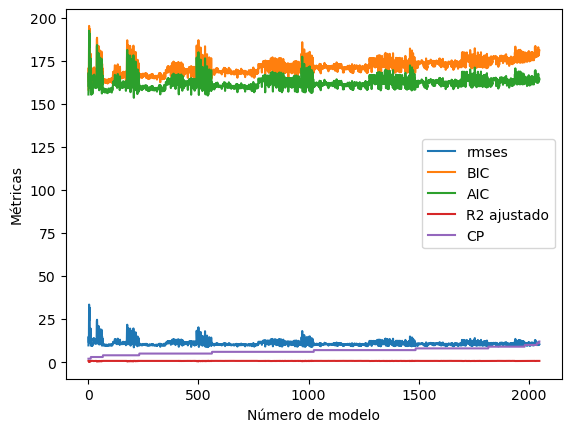

In [114]:
# Importar librerías
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

def visualize_results(todos_los_modelos):
    """
    Visualiza los resultados de las regresiones.

    Parameters:
    - results: Lista de modelos ajustados.
    """
    # Calcular el error cuadrático medio (RMSE) para cada modelo
    rmses = [model.mse_resid for model in todos_los_modelos]

    # Crear un gráfico con el RMSE en función del número de modelo
    plt.plot(range(1, len(todos_los_modelos) + 1), rmses, label='rmses')
    plt.xlabel("Número de modelo")
    plt.ylabel("Métricas")

    # Agregar las otras variables
    bics = [model.bic for model in todos_los_modelos]
    ais = [model.aic for model in todos_los_modelos]
    adj_rs = [model.rsquared_adj for model in todos_los_modelos]
    cps = [model.ssr / model.mse_resid - model.nobs + 2 * (len(model.params)) for model in todos_los_modelos] # Cp = RSSp/S2 – N + 2(P+1)
    
    plt.plot(range(1, len(todos_los_modelos) + 1), bics, label="BIC")
    plt.plot(range(1, len(todos_los_modelos) + 1), ais, label="AIC")
    plt.plot(range(1, len(todos_los_modelos) + 1), adj_rs, label="R2 ajustado")
    plt.plot(range(1, len(todos_los_modelos) + 1), cps, label="CP")

    plt.legend()
    plt.show()
    
# Visualizar los resultados
visualize_results(all_models)

In [110]:
all_models[0].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.761
Model:                            OLS   Adj. R-squared:                  0.752
Method:                 Least Squares   F-statistic:                     89.00
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           3.43e-10
Time:                        23:08:27   Log-Likelihood:                -75.671
No. Observations:                  30   AIC:                             155.3
Df Residuals:                      28   BIC:                             158.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         33.4900      1.535     21.811      0.000      30.345      36.635
x1            -0.0470      0.005     -9.434      0.000      -0.057      -0.037
==============================================================================
Omnibus:                        0.609   Durbin-Watson:                   1.711
Prob(Omnibus):                  0.737   Jarque-Bera (JB):                0.396
Skew:                           0.274   Prob(JB):                        0.820
Kurtosis:                       2.868   Cond. No.                         830.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Ejercicio 3.2.

Con el conjunto de datos `fat` de la biblioteca `faraway` de R, se registran la edad, el peso, la altura y 10 mediciones de la circunferencia corporal de 252 hombres. El porcentaje de grasa corporal de cada hombre se estimó con precisión mediante una técnica de pesaje bajo el agua. Las variables de la base son:

- `brozek`: Porcentaje de masa grasa según Brozek.
- `siri`: Porcentaje de masa grasa según Siri.
- `density`: Densidad (gm/cm³).
- `age`: Edad (años).
- `weight`: Peso (lbs).
- `height`: Estatura (pulgadas).
- `adipos`: BMI = Peso/Estatura² (kg/m²).
- `free`: Peso libre de grasa (Brozek).
- `neck`: Circunferencia del cuello (cm).
- `chest`: Circunferencia del pecho (cm).
- `abdom`: Circunferencia abdominal (cm).
- `hip`: Circunferencia de la cadera (cm).
- `thigh`: Circunferencia del muslo (cm).
- `knee`: Circunferencia de la rodilla (cm).
- `ankle`: Circunferencia del tobillo (cm).
- `biceps`: Circunferencia extendida del bíceps (cm).
- `forearm`: Circunferencia del antebrazo (cm).
- `wrist`: Circunferencia de la muñeca (cm).

### a) Hallar el mejor modelo de regresión lineal con variable respuesta `brozek` utilizando entre 1 y 14 variables predictoras. Elegir el mejor considerando el criterio CP de Mallows y R² adj.

### b) Repetir considerando ahora la minimización del Error Cuadrático Medio del modelo usando validación cruzada leave one out.

### c) Inspeccionar gráficamente el MSE y decidir cuál es el mejor modelo. Interpretar los coeficientes del mismo.

### d) ¿Coinciden las variables de los modelos elegidos con los diferentes criterios?


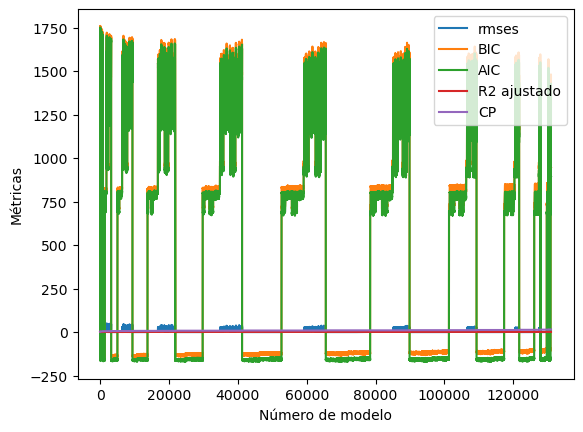

In [115]:
import pandas as pd
import statsmodels.api as sm

n_max_var_predict = 14
# Cargar el conjunto de datos desde el archivo CSV
df = pd.read_csv("fat.csv")


# Definir la variable respuesta y las variables predictoras
y = df["brozek"]
X = df.drop("brozek", axis=1)

# Obtener todas las regresiones posibles
all_models = all_subsets(X, y, n = n_max_var_predict )

# Variables: {list(all_models[0].exog_names[1:])}
visualize_results(all_models)

In [21]:
from sklearn.model_selection import cross_val_score, LeaveOneOut

# Inicializar variables para el mejor modelo con validación cruzada
best_model_cv = None
best_features_cv = None
best_mse_cv = float('inf')




    results = []
    all_features = list(X.columns)
    
    if n is None:
        n = len(all_features)
    
    for k in range(1, min(n, len(all_features)) + 1):
        subsets = combinations(all_features, k)
        for subset in subsets:
            model = sm.OLS(y, sm.add_constant(X[list(subset)])).fit()
            results.append(model)
    
    return results





# Iterar sobre todas las combinaciones de variables predictoras
for k in range(1, 15):
    for features in combinations(X.columns, k):
        X_subset = X[list(features)]
        
        # Utilizar validación cruzada leave one out
        loo = LeaveOneOut()
        mse_values = cross_val_score(LinearRegression(), X_subset, y.head(10), scoring='neg_mean_squared_error', cv=loo)
        
        # Calcular el MSE promedio
        avg_mse = np.mean(-mse_values)
        
        # Actualizar el mejor modelo si se encuentra un modelo con menor MSE
        if avg_mse < best_mse_cv:
            best_mse_cv = avg_mse
            best_model_cv = LinearRegression().fit(X_subset, y.head(10))
            best_features_cv = features

# Mostrar las variables del mejor modelo con validación cruzada y sus coeficientes
print("\nMejor modelo (Validación cruzada MSE):")
print("Variables:", best_features_cv)
print("Coeficientes:", best_model_cv.coef_)
print("Intercepto:", best_model_cv.intercept_)
print("MSE promedio:", best_mse_cv)

0.06666666666666667
('siri',)
('density',)
('age',)
('weight',)
('height',)
('adipos',)
('free',)
('neck',)
('chest',)
('abdom',)
('hip',)
('thigh',)
('knee',)
('ankle',)
('biceps',)
('forearm',)
('wrist',)
0.13333333333333333
('siri', 'density')
('siri', 'age')
('siri', 'weight')
('siri', 'height')
('siri', 'adipos')
('siri', 'free')
('siri', 'neck')
('siri', 'chest')
('siri', 'abdom')
('siri', 'hip')
('siri', 'thigh')
('siri', 'knee')
('siri', 'ankle')
('siri', 'biceps')
('siri', 'forearm')
('siri', 'wrist')
('density', 'age')
('density', 'weight')
('density', 'height')
('density', 'adipos')
('density', 'free')
('density', 'neck')
('density', 'chest')
('density', 'abdom')
('density', 'hip')
('density', 'thigh')
('density', 'knee')
('density', 'ankle')
('density', 'biceps')
('density', 'forearm')
('density', 'wrist')
('age', 'weight')
('age', 'height')
('age', 'adipos')
('age', 'free')
('age', 'neck')
('age', 'chest')
('age', 'abdom')
('age', 'hip')
('age', 'thigh')
('age', 'knee')
('

('density', 'chest', 'knee')
('density', 'chest', 'ankle')
('density', 'chest', 'biceps')
('density', 'chest', 'forearm')
('density', 'chest', 'wrist')
('density', 'abdom', 'hip')
('density', 'abdom', 'thigh')
('density', 'abdom', 'knee')
('density', 'abdom', 'ankle')
('density', 'abdom', 'biceps')
('density', 'abdom', 'forearm')
('density', 'abdom', 'wrist')
('density', 'hip', 'thigh')
('density', 'hip', 'knee')
('density', 'hip', 'ankle')
('density', 'hip', 'biceps')
('density', 'hip', 'forearm')
('density', 'hip', 'wrist')
('density', 'thigh', 'knee')
('density', 'thigh', 'ankle')
('density', 'thigh', 'biceps')
('density', 'thigh', 'forearm')
('density', 'thigh', 'wrist')
('density', 'knee', 'ankle')
('density', 'knee', 'biceps')
('density', 'knee', 'forearm')
('density', 'knee', 'wrist')
('density', 'ankle', 'biceps')
('density', 'ankle', 'forearm')
('density', 'ankle', 'wrist')
('density', 'biceps', 'forearm')
('density', 'biceps', 'wrist')
('density', 'forearm', 'wrist')
('age', 

('adipos', 'chest', 'forearm')
('adipos', 'chest', 'wrist')
('adipos', 'abdom', 'hip')
('adipos', 'abdom', 'thigh')
('adipos', 'abdom', 'knee')
('adipos', 'abdom', 'ankle')
('adipos', 'abdom', 'biceps')
('adipos', 'abdom', 'forearm')
('adipos', 'abdom', 'wrist')
('adipos', 'hip', 'thigh')
('adipos', 'hip', 'knee')
('adipos', 'hip', 'ankle')
('adipos', 'hip', 'biceps')
('adipos', 'hip', 'forearm')
('adipos', 'hip', 'wrist')
('adipos', 'thigh', 'knee')
('adipos', 'thigh', 'ankle')
('adipos', 'thigh', 'biceps')
('adipos', 'thigh', 'forearm')
('adipos', 'thigh', 'wrist')
('adipos', 'knee', 'ankle')
('adipos', 'knee', 'biceps')
('adipos', 'knee', 'forearm')
('adipos', 'knee', 'wrist')
('adipos', 'ankle', 'biceps')
('adipos', 'ankle', 'forearm')
('adipos', 'ankle', 'wrist')
('adipos', 'biceps', 'forearm')
('adipos', 'biceps', 'wrist')
('adipos', 'forearm', 'wrist')
('free', 'neck', 'chest')
('free', 'neck', 'abdom')
('free', 'neck', 'hip')
('free', 'neck', 'thigh')
('free', 'neck', 'knee')
(

('siri', 'density', 'abdom', 'hip')
('siri', 'density', 'abdom', 'thigh')
('siri', 'density', 'abdom', 'knee')
('siri', 'density', 'abdom', 'ankle')
('siri', 'density', 'abdom', 'biceps')
('siri', 'density', 'abdom', 'forearm')
('siri', 'density', 'abdom', 'wrist')
('siri', 'density', 'hip', 'thigh')
('siri', 'density', 'hip', 'knee')
('siri', 'density', 'hip', 'ankle')
('siri', 'density', 'hip', 'biceps')
('siri', 'density', 'hip', 'forearm')
('siri', 'density', 'hip', 'wrist')
('siri', 'density', 'thigh', 'knee')
('siri', 'density', 'thigh', 'ankle')
('siri', 'density', 'thigh', 'biceps')
('siri', 'density', 'thigh', 'forearm')
('siri', 'density', 'thigh', 'wrist')
('siri', 'density', 'knee', 'ankle')
('siri', 'density', 'knee', 'biceps')
('siri', 'density', 'knee', 'forearm')
('siri', 'density', 'knee', 'wrist')
('siri', 'density', 'ankle', 'biceps')
('siri', 'density', 'ankle', 'forearm')
('siri', 'density', 'ankle', 'wrist')
('siri', 'density', 'biceps', 'forearm')
('siri', 'densi

('siri', 'height', 'chest', 'thigh')
('siri', 'height', 'chest', 'knee')
('siri', 'height', 'chest', 'ankle')
('siri', 'height', 'chest', 'biceps')
('siri', 'height', 'chest', 'forearm')
('siri', 'height', 'chest', 'wrist')
('siri', 'height', 'abdom', 'hip')
('siri', 'height', 'abdom', 'thigh')
('siri', 'height', 'abdom', 'knee')
('siri', 'height', 'abdom', 'ankle')
('siri', 'height', 'abdom', 'biceps')
('siri', 'height', 'abdom', 'forearm')
('siri', 'height', 'abdom', 'wrist')
('siri', 'height', 'hip', 'thigh')
('siri', 'height', 'hip', 'knee')
('siri', 'height', 'hip', 'ankle')
('siri', 'height', 'hip', 'biceps')
('siri', 'height', 'hip', 'forearm')
('siri', 'height', 'hip', 'wrist')
('siri', 'height', 'thigh', 'knee')
('siri', 'height', 'thigh', 'ankle')
('siri', 'height', 'thigh', 'biceps')
('siri', 'height', 'thigh', 'forearm')
('siri', 'height', 'thigh', 'wrist')
('siri', 'height', 'knee', 'ankle')
('siri', 'height', 'knee', 'biceps')
('siri', 'height', 'knee', 'forearm')
('siri'

('siri', 'hip', 'ankle', 'forearm')
('siri', 'hip', 'ankle', 'wrist')
('siri', 'hip', 'biceps', 'forearm')
('siri', 'hip', 'biceps', 'wrist')
('siri', 'hip', 'forearm', 'wrist')
('siri', 'thigh', 'knee', 'ankle')
('siri', 'thigh', 'knee', 'biceps')
('siri', 'thigh', 'knee', 'forearm')
('siri', 'thigh', 'knee', 'wrist')
('siri', 'thigh', 'ankle', 'biceps')
('siri', 'thigh', 'ankle', 'forearm')
('siri', 'thigh', 'ankle', 'wrist')
('siri', 'thigh', 'biceps', 'forearm')
('siri', 'thigh', 'biceps', 'wrist')
('siri', 'thigh', 'forearm', 'wrist')
('siri', 'knee', 'ankle', 'biceps')
('siri', 'knee', 'ankle', 'forearm')
('siri', 'knee', 'ankle', 'wrist')
('siri', 'knee', 'biceps', 'forearm')
('siri', 'knee', 'biceps', 'wrist')
('siri', 'knee', 'forearm', 'wrist')
('siri', 'ankle', 'biceps', 'forearm')
('siri', 'ankle', 'biceps', 'wrist')
('siri', 'ankle', 'forearm', 'wrist')
('siri', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height')
('density', 'age', 'weight', 'adipos')
('de

('density', 'height', 'neck', 'abdom')
('density', 'height', 'neck', 'hip')
('density', 'height', 'neck', 'thigh')
('density', 'height', 'neck', 'knee')
('density', 'height', 'neck', 'ankle')
('density', 'height', 'neck', 'biceps')
('density', 'height', 'neck', 'forearm')
('density', 'height', 'neck', 'wrist')
('density', 'height', 'chest', 'abdom')
('density', 'height', 'chest', 'hip')
('density', 'height', 'chest', 'thigh')
('density', 'height', 'chest', 'knee')
('density', 'height', 'chest', 'ankle')
('density', 'height', 'chest', 'biceps')
('density', 'height', 'chest', 'forearm')
('density', 'height', 'chest', 'wrist')
('density', 'height', 'abdom', 'hip')
('density', 'height', 'abdom', 'thigh')
('density', 'height', 'abdom', 'knee')
('density', 'height', 'abdom', 'ankle')
('density', 'height', 'abdom', 'biceps')
('density', 'height', 'abdom', 'forearm')
('density', 'height', 'abdom', 'wrist')
('density', 'height', 'hip', 'thigh')
('density', 'height', 'hip', 'knee')
('density', '

('density', 'abdom', 'hip', 'biceps')
('density', 'abdom', 'hip', 'forearm')
('density', 'abdom', 'hip', 'wrist')
('density', 'abdom', 'thigh', 'knee')
('density', 'abdom', 'thigh', 'ankle')
('density', 'abdom', 'thigh', 'biceps')
('density', 'abdom', 'thigh', 'forearm')
('density', 'abdom', 'thigh', 'wrist')
('density', 'abdom', 'knee', 'ankle')
('density', 'abdom', 'knee', 'biceps')
('density', 'abdom', 'knee', 'forearm')
('density', 'abdom', 'knee', 'wrist')
('density', 'abdom', 'ankle', 'biceps')
('density', 'abdom', 'ankle', 'forearm')
('density', 'abdom', 'ankle', 'wrist')
('density', 'abdom', 'biceps', 'forearm')
('density', 'abdom', 'biceps', 'wrist')
('density', 'abdom', 'forearm', 'wrist')
('density', 'hip', 'thigh', 'knee')
('density', 'hip', 'thigh', 'ankle')
('density', 'hip', 'thigh', 'biceps')
('density', 'hip', 'thigh', 'forearm')
('density', 'hip', 'thigh', 'wrist')
('density', 'hip', 'knee', 'ankle')
('density', 'hip', 'knee', 'biceps')
('density', 'hip', 'knee', 'for

('age', 'adipos', 'abdom', 'thigh')
('age', 'adipos', 'abdom', 'knee')
('age', 'adipos', 'abdom', 'ankle')
('age', 'adipos', 'abdom', 'biceps')
('age', 'adipos', 'abdom', 'forearm')
('age', 'adipos', 'abdom', 'wrist')
('age', 'adipos', 'hip', 'thigh')
('age', 'adipos', 'hip', 'knee')
('age', 'adipos', 'hip', 'ankle')
('age', 'adipos', 'hip', 'biceps')
('age', 'adipos', 'hip', 'forearm')
('age', 'adipos', 'hip', 'wrist')
('age', 'adipos', 'thigh', 'knee')
('age', 'adipos', 'thigh', 'ankle')
('age', 'adipos', 'thigh', 'biceps')
('age', 'adipos', 'thigh', 'forearm')
('age', 'adipos', 'thigh', 'wrist')
('age', 'adipos', 'knee', 'ankle')
('age', 'adipos', 'knee', 'biceps')
('age', 'adipos', 'knee', 'forearm')
('age', 'adipos', 'knee', 'wrist')
('age', 'adipos', 'ankle', 'biceps')
('age', 'adipos', 'ankle', 'forearm')
('age', 'adipos', 'ankle', 'wrist')
('age', 'adipos', 'biceps', 'forearm')
('age', 'adipos', 'biceps', 'wrist')
('age', 'adipos', 'forearm', 'wrist')
('age', 'free', 'neck', 'c

('weight', 'height', 'abdom', 'biceps')
('weight', 'height', 'abdom', 'forearm')
('weight', 'height', 'abdom', 'wrist')
('weight', 'height', 'hip', 'thigh')
('weight', 'height', 'hip', 'knee')
('weight', 'height', 'hip', 'ankle')
('weight', 'height', 'hip', 'biceps')
('weight', 'height', 'hip', 'forearm')
('weight', 'height', 'hip', 'wrist')
('weight', 'height', 'thigh', 'knee')
('weight', 'height', 'thigh', 'ankle')
('weight', 'height', 'thigh', 'biceps')
('weight', 'height', 'thigh', 'forearm')
('weight', 'height', 'thigh', 'wrist')
('weight', 'height', 'knee', 'ankle')
('weight', 'height', 'knee', 'biceps')
('weight', 'height', 'knee', 'forearm')
('weight', 'height', 'knee', 'wrist')
('weight', 'height', 'ankle', 'biceps')
('weight', 'height', 'ankle', 'forearm')
('weight', 'height', 'ankle', 'wrist')
('weight', 'height', 'biceps', 'forearm')
('weight', 'height', 'biceps', 'wrist')
('weight', 'height', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck')
('weight', 'adipos', 'fr

('weight', 'hip', 'ankle', 'forearm')
('weight', 'hip', 'ankle', 'wrist')
('weight', 'hip', 'biceps', 'forearm')
('weight', 'hip', 'biceps', 'wrist')
('weight', 'hip', 'forearm', 'wrist')
('weight', 'thigh', 'knee', 'ankle')
('weight', 'thigh', 'knee', 'biceps')
('weight', 'thigh', 'knee', 'forearm')
('weight', 'thigh', 'knee', 'wrist')
('weight', 'thigh', 'ankle', 'biceps')
('weight', 'thigh', 'ankle', 'forearm')
('weight', 'thigh', 'ankle', 'wrist')
('weight', 'thigh', 'biceps', 'forearm')
('weight', 'thigh', 'biceps', 'wrist')
('weight', 'thigh', 'forearm', 'wrist')
('weight', 'knee', 'ankle', 'biceps')
('weight', 'knee', 'ankle', 'forearm')
('weight', 'knee', 'ankle', 'wrist')
('weight', 'knee', 'biceps', 'forearm')
('weight', 'knee', 'biceps', 'wrist')
('weight', 'knee', 'forearm', 'wrist')
('weight', 'ankle', 'biceps', 'forearm')
('weight', 'ankle', 'biceps', 'wrist')
('weight', 'ankle', 'forearm', 'wrist')
('weight', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'ne

('height', 'hip', 'ankle', 'biceps')
('height', 'hip', 'ankle', 'forearm')
('height', 'hip', 'ankle', 'wrist')
('height', 'hip', 'biceps', 'forearm')
('height', 'hip', 'biceps', 'wrist')
('height', 'hip', 'forearm', 'wrist')
('height', 'thigh', 'knee', 'ankle')
('height', 'thigh', 'knee', 'biceps')
('height', 'thigh', 'knee', 'forearm')
('height', 'thigh', 'knee', 'wrist')
('height', 'thigh', 'ankle', 'biceps')
('height', 'thigh', 'ankle', 'forearm')
('height', 'thigh', 'ankle', 'wrist')
('height', 'thigh', 'biceps', 'forearm')
('height', 'thigh', 'biceps', 'wrist')
('height', 'thigh', 'forearm', 'wrist')
('height', 'knee', 'ankle', 'biceps')
('height', 'knee', 'ankle', 'forearm')
('height', 'knee', 'ankle', 'wrist')
('height', 'knee', 'biceps', 'forearm')
('height', 'knee', 'biceps', 'wrist')
('height', 'knee', 'forearm', 'wrist')
('height', 'ankle', 'biceps', 'forearm')
('height', 'ankle', 'biceps', 'wrist')
('height', 'ankle', 'forearm', 'wrist')
('height', 'biceps', 'forearm', 'wri

('free', 'neck', 'ankle', 'biceps')
('free', 'neck', 'ankle', 'forearm')
('free', 'neck', 'ankle', 'wrist')
('free', 'neck', 'biceps', 'forearm')
('free', 'neck', 'biceps', 'wrist')
('free', 'neck', 'forearm', 'wrist')
('free', 'chest', 'abdom', 'hip')
('free', 'chest', 'abdom', 'thigh')
('free', 'chest', 'abdom', 'knee')
('free', 'chest', 'abdom', 'ankle')
('free', 'chest', 'abdom', 'biceps')
('free', 'chest', 'abdom', 'forearm')
('free', 'chest', 'abdom', 'wrist')
('free', 'chest', 'hip', 'thigh')
('free', 'chest', 'hip', 'knee')
('free', 'chest', 'hip', 'ankle')
('free', 'chest', 'hip', 'biceps')
('free', 'chest', 'hip', 'forearm')
('free', 'chest', 'hip', 'wrist')
('free', 'chest', 'thigh', 'knee')
('free', 'chest', 'thigh', 'ankle')
('free', 'chest', 'thigh', 'biceps')
('free', 'chest', 'thigh', 'forearm')
('free', 'chest', 'thigh', 'wrist')
('free', 'chest', 'knee', 'ankle')
('free', 'chest', 'knee', 'biceps')
('free', 'chest', 'knee', 'forearm')
('free', 'chest', 'knee', 'wrist'

('chest', 'ankle', 'biceps', 'wrist')
('chest', 'ankle', 'forearm', 'wrist')
('chest', 'biceps', 'forearm', 'wrist')
('abdom', 'hip', 'thigh', 'knee')
('abdom', 'hip', 'thigh', 'ankle')
('abdom', 'hip', 'thigh', 'biceps')
('abdom', 'hip', 'thigh', 'forearm')
('abdom', 'hip', 'thigh', 'wrist')
('abdom', 'hip', 'knee', 'ankle')
('abdom', 'hip', 'knee', 'biceps')
('abdom', 'hip', 'knee', 'forearm')
('abdom', 'hip', 'knee', 'wrist')
('abdom', 'hip', 'ankle', 'biceps')
('abdom', 'hip', 'ankle', 'forearm')
('abdom', 'hip', 'ankle', 'wrist')
('abdom', 'hip', 'biceps', 'forearm')
('abdom', 'hip', 'biceps', 'wrist')
('abdom', 'hip', 'forearm', 'wrist')
('abdom', 'thigh', 'knee', 'ankle')
('abdom', 'thigh', 'knee', 'biceps')
('abdom', 'thigh', 'knee', 'forearm')
('abdom', 'thigh', 'knee', 'wrist')
('abdom', 'thigh', 'ankle', 'biceps')
('abdom', 'thigh', 'ankle', 'forearm')
('abdom', 'thigh', 'ankle', 'wrist')
('abdom', 'thigh', 'biceps', 'forearm')
('abdom', 'thigh', 'biceps', 'wrist')
('abdom',

('siri', 'density', 'weight', 'free', 'ankle')
('siri', 'density', 'weight', 'free', 'biceps')
('siri', 'density', 'weight', 'free', 'forearm')
('siri', 'density', 'weight', 'free', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest')
('siri', 'density', 'weight', 'neck', 'abdom')
('siri', 'density', 'weight', 'neck', 'hip')
('siri', 'density', 'weight', 'neck', 'thigh')
('siri', 'density', 'weight', 'neck', 'knee')
('siri', 'density', 'weight', 'neck', 'ankle')
('siri', 'density', 'weight', 'neck', 'biceps')
('siri', 'density', 'weight', 'neck', 'forearm')
('siri', 'density', 'weight', 'neck', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom')
('siri', 'density', 'weight', 'chest', 'hip')
('siri', 'density', 'weight', 'chest', 'thigh')
('siri', 'density', 'weight', 'chest', 'knee')
('siri', 'density', 'weight', 'chest', 'ankle')
('siri', 'density', 'weight', 'chest', 'biceps')
('siri', 'density', 'weight', 'chest', 'forearm')
('siri', 'density', 'weight', 'chest', 'wrist')
('

('siri', 'density', 'free', 'neck', 'thigh')
('siri', 'density', 'free', 'neck', 'knee')
('siri', 'density', 'free', 'neck', 'ankle')
('siri', 'density', 'free', 'neck', 'biceps')
('siri', 'density', 'free', 'neck', 'forearm')
('siri', 'density', 'free', 'neck', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom')
('siri', 'density', 'free', 'chest', 'hip')
('siri', 'density', 'free', 'chest', 'thigh')
('siri', 'density', 'free', 'chest', 'knee')
('siri', 'density', 'free', 'chest', 'ankle')
('siri', 'density', 'free', 'chest', 'biceps')
('siri', 'density', 'free', 'chest', 'forearm')
('siri', 'density', 'free', 'chest', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip')
('siri', 'density', 'free', 'abdom', 'thigh')
('siri', 'density', 'free', 'abdom', 'knee')
('siri', 'density', 'free', 'abdom', 'ankle')
('siri', 'density', 'free', 'abdom', 'biceps')
('siri', 'density', 'free', 'abdom', 'forearm')
('siri', 'density', 'free', 'abdom', 'wrist')
('siri', 'density', 'free', 'hip', 'th

('siri', 'age', 'weight', 'adipos', 'hip')
('siri', 'age', 'weight', 'adipos', 'thigh')
('siri', 'age', 'weight', 'adipos', 'knee')
('siri', 'age', 'weight', 'adipos', 'ankle')
('siri', 'age', 'weight', 'adipos', 'biceps')
('siri', 'age', 'weight', 'adipos', 'forearm')
('siri', 'age', 'weight', 'adipos', 'wrist')
('siri', 'age', 'weight', 'free', 'neck')
('siri', 'age', 'weight', 'free', 'chest')
('siri', 'age', 'weight', 'free', 'abdom')
('siri', 'age', 'weight', 'free', 'hip')
('siri', 'age', 'weight', 'free', 'thigh')
('siri', 'age', 'weight', 'free', 'knee')
('siri', 'age', 'weight', 'free', 'ankle')
('siri', 'age', 'weight', 'free', 'biceps')
('siri', 'age', 'weight', 'free', 'forearm')
('siri', 'age', 'weight', 'free', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest')
('siri', 'age', 'weight', 'neck', 'abdom')
('siri', 'age', 'weight', 'neck', 'hip')
('siri', 'age', 'weight', 'neck', 'thigh')
('siri', 'age', 'weight', 'neck', 'knee')
('siri', 'age', 'weight', 'neck', 'ankle')
(

('siri', 'age', 'free', 'neck', 'biceps')
('siri', 'age', 'free', 'neck', 'forearm')
('siri', 'age', 'free', 'neck', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom')
('siri', 'age', 'free', 'chest', 'hip')
('siri', 'age', 'free', 'chest', 'thigh')
('siri', 'age', 'free', 'chest', 'knee')
('siri', 'age', 'free', 'chest', 'ankle')
('siri', 'age', 'free', 'chest', 'biceps')
('siri', 'age', 'free', 'chest', 'forearm')
('siri', 'age', 'free', 'chest', 'wrist')
('siri', 'age', 'free', 'abdom', 'hip')
('siri', 'age', 'free', 'abdom', 'thigh')
('siri', 'age', 'free', 'abdom', 'knee')
('siri', 'age', 'free', 'abdom', 'ankle')
('siri', 'age', 'free', 'abdom', 'biceps')
('siri', 'age', 'free', 'abdom', 'forearm')
('siri', 'age', 'free', 'abdom', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh')
('siri', 'age', 'free', 'hip', 'knee')
('siri', 'age', 'free', 'hip', 'ankle')
('siri', 'age', 'free', 'hip', 'biceps')
('siri', 'age', 'free', 'hip', 'forearm')
('siri', 'age', 'free', 'hip', 'wrist')
('

('siri', 'weight', 'height', 'chest', 'hip')
('siri', 'weight', 'height', 'chest', 'thigh')
('siri', 'weight', 'height', 'chest', 'knee')
('siri', 'weight', 'height', 'chest', 'ankle')
('siri', 'weight', 'height', 'chest', 'biceps')
('siri', 'weight', 'height', 'chest', 'forearm')
('siri', 'weight', 'height', 'chest', 'wrist')
('siri', 'weight', 'height', 'abdom', 'hip')
('siri', 'weight', 'height', 'abdom', 'thigh')
('siri', 'weight', 'height', 'abdom', 'knee')
('siri', 'weight', 'height', 'abdom', 'ankle')
('siri', 'weight', 'height', 'abdom', 'biceps')
('siri', 'weight', 'height', 'abdom', 'forearm')
('siri', 'weight', 'height', 'abdom', 'wrist')
('siri', 'weight', 'height', 'hip', 'thigh')
('siri', 'weight', 'height', 'hip', 'knee')
('siri', 'weight', 'height', 'hip', 'ankle')
('siri', 'weight', 'height', 'hip', 'biceps')
('siri', 'weight', 'height', 'hip', 'forearm')
('siri', 'weight', 'height', 'hip', 'wrist')
('siri', 'weight', 'height', 'thigh', 'knee')
('siri', 'weight', 'heig

('siri', 'weight', 'chest', 'hip', 'forearm')
('siri', 'weight', 'chest', 'hip', 'wrist')
('siri', 'weight', 'chest', 'thigh', 'knee')
('siri', 'weight', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'chest', 'thigh', 'forearm')
('siri', 'weight', 'chest', 'thigh', 'wrist')
('siri', 'weight', 'chest', 'knee', 'ankle')
('siri', 'weight', 'chest', 'knee', 'biceps')
('siri', 'weight', 'chest', 'knee', 'forearm')
('siri', 'weight', 'chest', 'knee', 'wrist')
('siri', 'weight', 'chest', 'ankle', 'biceps')
('siri', 'weight', 'chest', 'ankle', 'forearm')
('siri', 'weight', 'chest', 'ankle', 'wrist')
('siri', 'weight', 'chest', 'biceps', 'forearm')
('siri', 'weight', 'chest', 'biceps', 'wrist')
('siri', 'weight', 'chest', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'hip', 'thigh')
('siri', 'weight', 'abdom', 'hip', 'knee')
('siri', 'weight', 'abdom', 'hip', 'ankle')
('siri', 'weight', 'abdom', 'hip', 'biceps')
('siri', 'weight', 'abdom', 'hip',

('siri', 'height', 'neck', 'abdom', 'hip')
('siri', 'height', 'neck', 'abdom', 'thigh')
('siri', 'height', 'neck', 'abdom', 'knee')
('siri', 'height', 'neck', 'abdom', 'ankle')
('siri', 'height', 'neck', 'abdom', 'biceps')
('siri', 'height', 'neck', 'abdom', 'forearm')
('siri', 'height', 'neck', 'abdom', 'wrist')
('siri', 'height', 'neck', 'hip', 'thigh')
('siri', 'height', 'neck', 'hip', 'knee')
('siri', 'height', 'neck', 'hip', 'ankle')
('siri', 'height', 'neck', 'hip', 'biceps')
('siri', 'height', 'neck', 'hip', 'forearm')
('siri', 'height', 'neck', 'hip', 'wrist')
('siri', 'height', 'neck', 'thigh', 'knee')
('siri', 'height', 'neck', 'thigh', 'ankle')
('siri', 'height', 'neck', 'thigh', 'biceps')
('siri', 'height', 'neck', 'thigh', 'forearm')
('siri', 'height', 'neck', 'thigh', 'wrist')
('siri', 'height', 'neck', 'knee', 'ankle')
('siri', 'height', 'neck', 'knee', 'biceps')
('siri', 'height', 'neck', 'knee', 'forearm')
('siri', 'height', 'neck', 'knee', 'wrist')
('siri', 'height', 

('siri', 'adipos', 'neck', 'knee', 'ankle')
('siri', 'adipos', 'neck', 'knee', 'biceps')
('siri', 'adipos', 'neck', 'knee', 'forearm')
('siri', 'adipos', 'neck', 'knee', 'wrist')
('siri', 'adipos', 'neck', 'ankle', 'biceps')
('siri', 'adipos', 'neck', 'ankle', 'forearm')
('siri', 'adipos', 'neck', 'ankle', 'wrist')
('siri', 'adipos', 'neck', 'biceps', 'forearm')
('siri', 'adipos', 'neck', 'biceps', 'wrist')
('siri', 'adipos', 'neck', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'hip')
('siri', 'adipos', 'chest', 'abdom', 'thigh')
('siri', 'adipos', 'chest', 'abdom', 'knee')
('siri', 'adipos', 'chest', 'abdom', 'ankle')
('siri', 'adipos', 'chest', 'abdom', 'biceps')
('siri', 'adipos', 'chest', 'abdom', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'wrist')
('siri', 'adipos', 'chest', 'hip', 'thigh')
('siri', 'adipos', 'chest', 'hip', 'knee')
('siri', 'adipos', 'chest', 'hip', 'ankle')
('siri', 'adipos', 'chest', 'hip', 'biceps')
('siri', 'adipos', 'chest', 'hip', 'forearm'

('siri', 'free', 'hip', 'knee', 'biceps')
('siri', 'free', 'hip', 'knee', 'forearm')
('siri', 'free', 'hip', 'knee', 'wrist')
('siri', 'free', 'hip', 'ankle', 'biceps')
('siri', 'free', 'hip', 'ankle', 'forearm')
('siri', 'free', 'hip', 'ankle', 'wrist')
('siri', 'free', 'hip', 'biceps', 'forearm')
('siri', 'free', 'hip', 'biceps', 'wrist')
('siri', 'free', 'hip', 'forearm', 'wrist')
('siri', 'free', 'thigh', 'knee', 'ankle')
('siri', 'free', 'thigh', 'knee', 'biceps')
('siri', 'free', 'thigh', 'knee', 'forearm')
('siri', 'free', 'thigh', 'knee', 'wrist')
('siri', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'free', 'knee', 'ankle', 'biceps')
('siri', 'free', 'knee', 'ankle', 'forearm')
('siri', 'free', 'knee', 'ankle', 'wrist')
('siri', 'free', 'knee', 'biceps'

('siri', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'hip', 'thigh', 'knee', 'forea

('density', 'age', 'height', 'hip', 'knee')
('density', 'age', 'height', 'hip', 'ankle')
('density', 'age', 'height', 'hip', 'biceps')
('density', 'age', 'height', 'hip', 'forearm')
('density', 'age', 'height', 'hip', 'wrist')
('density', 'age', 'height', 'thigh', 'knee')
('density', 'age', 'height', 'thigh', 'ankle')
('density', 'age', 'height', 'thigh', 'biceps')
('density', 'age', 'height', 'thigh', 'forearm')
('density', 'age', 'height', 'thigh', 'wrist')
('density', 'age', 'height', 'knee', 'ankle')
('density', 'age', 'height', 'knee', 'biceps')
('density', 'age', 'height', 'knee', 'forearm')
('density', 'age', 'height', 'knee', 'wrist')
('density', 'age', 'height', 'ankle', 'biceps')
('density', 'age', 'height', 'ankle', 'forearm')
('density', 'age', 'height', 'ankle', 'wrist')
('density', 'age', 'height', 'biceps', 'forearm')
('density', 'age', 'height', 'biceps', 'wrist')
('density', 'age', 'height', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck')
('density', '

('density', 'age', 'chest', 'ankle', 'wrist')
('density', 'age', 'chest', 'biceps', 'forearm')
('density', 'age', 'chest', 'biceps', 'wrist')
('density', 'age', 'chest', 'forearm', 'wrist')
('density', 'age', 'abdom', 'hip', 'thigh')
('density', 'age', 'abdom', 'hip', 'knee')
('density', 'age', 'abdom', 'hip', 'ankle')
('density', 'age', 'abdom', 'hip', 'biceps')
('density', 'age', 'abdom', 'hip', 'forearm')
('density', 'age', 'abdom', 'hip', 'wrist')
('density', 'age', 'abdom', 'thigh', 'knee')
('density', 'age', 'abdom', 'thigh', 'ankle')
('density', 'age', 'abdom', 'thigh', 'biceps')
('density', 'age', 'abdom', 'thigh', 'forearm')
('density', 'age', 'abdom', 'thigh', 'wrist')
('density', 'age', 'abdom', 'knee', 'ankle')
('density', 'age', 'abdom', 'knee', 'biceps')
('density', 'age', 'abdom', 'knee', 'forearm')
('density', 'age', 'abdom', 'knee', 'wrist')
('density', 'age', 'abdom', 'ankle', 'biceps')
('density', 'age', 'abdom', 'ankle', 'forearm')
('density', 'age', 'abdom', 'ankle

('density', 'weight', 'adipos', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'knee', 'ankle')
('density', 'weight', 'adipos', 'knee', 'biceps')
('density', 'weight', 'adipos', 'knee', 'forearm')
('density', 'weight', 'adipos', 'knee', 'wrist')
('density', 'weight', 'adipos', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest')
('density', 'weight', 'free', 'neck', 'abdom')
('density', 'weight', 'free', 'neck', 'hip')
('density', 'weight', 'free', 'neck', 'thigh')
('density', 'weight', 'free', 'neck', 'knee')
('density', 'weight', 'free', 'neck', 'ankle')
('density', 'weight', 'free', 'neck', 'biceps')
('density', 'weight', 'free', 'neck', 'forearm')
('density', 'weight', 'free', 'neck', 'wrist')
('density', 'weight

('density', 'weight', 'knee', 'forearm', 'wrist')
('density', 'weight', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck')
('density', 'height', 'adipos', 'free', 'chest')
('density', 'height', 'adipos', 'free', 'abdom')
('density', 'height', 'adipos', 'free', 'hip')
('density', 'height', 'adipos', 'free', 'thigh')
('density', 'height', 'adipos', 'free', 'knee')
('density', 'height', 'adipos', 'free', 'ankle')
('density', 'height', 'adipos', 'free', 'biceps')
('density', 'height', 'adipos', 'free', 'forearm')
('density', 'height', 'adipos', 'free', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest')
('density', 'height', 'adipos', 'neck', 'abdom')
('density', 'height', 'adipos', 'neck', 'hip')
('density', 'height', 'adipos', 'neck', 'thigh')
('density', 'height', 'adipos', 'neck', 'knee')
('density', 'h

('density', 'height', 'abdom', 'hip', 'knee')
('density', 'height', 'abdom', 'hip', 'ankle')
('density', 'height', 'abdom', 'hip', 'biceps')
('density', 'height', 'abdom', 'hip', 'forearm')
('density', 'height', 'abdom', 'hip', 'wrist')
('density', 'height', 'abdom', 'thigh', 'knee')
('density', 'height', 'abdom', 'thigh', 'ankle')
('density', 'height', 'abdom', 'thigh', 'biceps')
('density', 'height', 'abdom', 'thigh', 'forearm')
('density', 'height', 'abdom', 'thigh', 'wrist')
('density', 'height', 'abdom', 'knee', 'ankle')
('density', 'height', 'abdom', 'knee', 'biceps')
('density', 'height', 'abdom', 'knee', 'forearm')
('density', 'height', 'abdom', 'knee', 'wrist')
('density', 'height', 'abdom', 'ankle', 'biceps')
('density', 'height', 'abdom', 'ankle', 'forearm')
('density', 'height', 'abdom', 'ankle', 'wrist')
('density', 'height', 'abdom', 'biceps', 'forearm')
('density', 'height', 'abdom', 'biceps', 'wrist')
('density', 'height', 'abdom', 'forearm', 'wrist')
('density', 'heigh

('density', 'adipos', 'abdom', 'thigh', 'ankle')
('density', 'adipos', 'abdom', 'thigh', 'biceps')
('density', 'adipos', 'abdom', 'thigh', 'forearm')
('density', 'adipos', 'abdom', 'thigh', 'wrist')
('density', 'adipos', 'abdom', 'knee', 'ankle')
('density', 'adipos', 'abdom', 'knee', 'biceps')
('density', 'adipos', 'abdom', 'knee', 'forearm')
('density', 'adipos', 'abdom', 'knee', 'wrist')
('density', 'adipos', 'abdom', 'ankle', 'biceps')
('density', 'adipos', 'abdom', 'ankle', 'forearm')
('density', 'adipos', 'abdom', 'ankle', 'wrist')
('density', 'adipos', 'abdom', 'biceps', 'forearm')
('density', 'adipos', 'abdom', 'biceps', 'wrist')
('density', 'adipos', 'abdom', 'forearm', 'wrist')
('density', 'adipos', 'hip', 'thigh', 'knee')
('density', 'adipos', 'hip', 'thigh', 'ankle')
('density', 'adipos', 'hip', 'thigh', 'biceps')
('density', 'adipos', 'hip', 'thigh', 'forearm')
('density', 'adipos', 'hip', 'thigh', 'wrist')
('density', 'adipos', 'hip', 'knee', 'ankle')
('density', 'adipos'

('density', 'neck', 'chest', 'abdom', 'wrist')
('density', 'neck', 'chest', 'hip', 'thigh')
('density', 'neck', 'chest', 'hip', 'knee')
('density', 'neck', 'chest', 'hip', 'ankle')
('density', 'neck', 'chest', 'hip', 'biceps')
('density', 'neck', 'chest', 'hip', 'forearm')
('density', 'neck', 'chest', 'hip', 'wrist')
('density', 'neck', 'chest', 'thigh', 'knee')
('density', 'neck', 'chest', 'thigh', 'ankle')
('density', 'neck', 'chest', 'thigh', 'biceps')
('density', 'neck', 'chest', 'thigh', 'forearm')
('density', 'neck', 'chest', 'thigh', 'wrist')
('density', 'neck', 'chest', 'knee', 'ankle')
('density', 'neck', 'chest', 'knee', 'biceps')
('density', 'neck', 'chest', 'knee', 'forearm')
('density', 'neck', 'chest', 'knee', 'wrist')
('density', 'neck', 'chest', 'ankle', 'biceps')
('density', 'neck', 'chest', 'ankle', 'forearm')
('density', 'neck', 'chest', 'ankle', 'wrist')
('density', 'neck', 'chest', 'biceps', 'forearm')
('density', 'neck', 'chest', 'biceps', 'wrist')
('density', 'ne

('density', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'hip', 'knee', 'ankle', 'biceps')
('density', 'hip', 'knee', 'ankle', 'forearm')
('density', 'hip', 'knee', 'ankle', 'wrist')
('density', 'hip', 'knee', 'biceps', 'forearm')
('density', 'hip', 'knee', 'biceps', 'wrist')
('density', 'hip', 'knee', 'forearm', 'wrist')
('density', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'thigh', 'ankle', 'biceps', 'forear

('age', 'weight', 'free', 'thigh', 'ankle')
('age', 'weight', 'free', 'thigh', 'biceps')
('age', 'weight', 'free', 'thigh', 'forearm')
('age', 'weight', 'free', 'thigh', 'wrist')
('age', 'weight', 'free', 'knee', 'ankle')
('age', 'weight', 'free', 'knee', 'biceps')
('age', 'weight', 'free', 'knee', 'forearm')
('age', 'weight', 'free', 'knee', 'wrist')
('age', 'weight', 'free', 'ankle', 'biceps')
('age', 'weight', 'free', 'ankle', 'forearm')
('age', 'weight', 'free', 'ankle', 'wrist')
('age', 'weight', 'free', 'biceps', 'forearm')
('age', 'weight', 'free', 'biceps', 'wrist')
('age', 'weight', 'free', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom')
('age', 'weight', 'neck', 'chest', 'hip')
('age', 'weight', 'neck', 'chest', 'thigh')
('age', 'weight', 'neck', 'chest', 'knee')
('age', 'weight', 'neck', 'chest', 'ankle')
('age', 'weight', 'neck', 'chest', 'biceps')
('age', 'weight', 'neck', 'chest', 'forearm')
('age', 'weight', 'neck', 'chest', 'wrist')
('age', 'weight', 'ne

('age', 'height', 'adipos', 'ankle', 'forearm')
('age', 'height', 'adipos', 'ankle', 'wrist')
('age', 'height', 'adipos', 'biceps', 'forearm')
('age', 'height', 'adipos', 'biceps', 'wrist')
('age', 'height', 'adipos', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'chest')
('age', 'height', 'free', 'neck', 'abdom')
('age', 'height', 'free', 'neck', 'hip')
('age', 'height', 'free', 'neck', 'thigh')
('age', 'height', 'free', 'neck', 'knee')
('age', 'height', 'free', 'neck', 'ankle')
('age', 'height', 'free', 'neck', 'biceps')
('age', 'height', 'free', 'neck', 'forearm')
('age', 'height', 'free', 'neck', 'wrist')
('age', 'height', 'free', 'chest', 'abdom')
('age', 'height', 'free', 'chest', 'hip')
('age', 'height', 'free', 'chest', 'thigh')
('age', 'height', 'free', 'chest', 'knee')
('age', 'height', 'free', 'chest', 'ankle')
('age', 'height', 'free', 'chest', 'biceps')
('age', 'height', 'free', 'chest', 'forearm')
('age', 'height', 'free', 'chest', 'wrist')
('age', 'height', 'free

('age', 'adipos', 'free', 'chest', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip')
('age', 'adipos', 'free', 'abdom', 'thigh')
('age', 'adipos', 'free', 'abdom', 'knee')
('age', 'adipos', 'free', 'abdom', 'ankle')
('age', 'adipos', 'free', 'abdom', 'biceps')
('age', 'adipos', 'free', 'abdom', 'forearm')
('age', 'adipos', 'free', 'abdom', 'wrist')
('age', 'adipos', 'free', 'hip', 'thigh')
('age', 'adipos', 'free', 'hip', 'knee')
('age', 'adipos', 'free', 'hip', 'ankle')
('age', 'adipos', 'free', 'hip', 'biceps')
('age', 'adipos', 'free', 'hip', 'forearm')
('age', 'adipos', 'free', 'hip', 'wrist')
('age', 'adipos', 'free', 'thigh', 'knee')
('age', 'adipos', 'free', 'thigh', 'ankle')
('age', 'adipos', 'free', 'thigh', 'biceps')
('age', 'adipos', 'free', 'thigh', 'forearm')
('age', 'adipos', 'free', 'thigh', 'wrist')
('age', 'adipos', 'free', 'knee', 'ankle')
('age', 'adipos', 'free', 'knee', 'biceps')
('age', 'adipos', 'free', 'knee', 'forearm')
('age', 'adipos', 'free', 'knee', 'wrist

('age', 'free', 'chest', 'abdom', 'thigh')
('age', 'free', 'chest', 'abdom', 'knee')
('age', 'free', 'chest', 'abdom', 'ankle')
('age', 'free', 'chest', 'abdom', 'biceps')
('age', 'free', 'chest', 'abdom', 'forearm')
('age', 'free', 'chest', 'abdom', 'wrist')
('age', 'free', 'chest', 'hip', 'thigh')
('age', 'free', 'chest', 'hip', 'knee')
('age', 'free', 'chest', 'hip', 'ankle')
('age', 'free', 'chest', 'hip', 'biceps')
('age', 'free', 'chest', 'hip', 'forearm')
('age', 'free', 'chest', 'hip', 'wrist')
('age', 'free', 'chest', 'thigh', 'knee')
('age', 'free', 'chest', 'thigh', 'ankle')
('age', 'free', 'chest', 'thigh', 'biceps')
('age', 'free', 'chest', 'thigh', 'forearm')
('age', 'free', 'chest', 'thigh', 'wrist')
('age', 'free', 'chest', 'knee', 'ankle')
('age', 'free', 'chest', 'knee', 'biceps')
('age', 'free', 'chest', 'knee', 'forearm')
('age', 'free', 'chest', 'knee', 'wrist')
('age', 'free', 'chest', 'ankle', 'biceps')
('age', 'free', 'chest', 'ankle', 'forearm')
('age', 'free',

('age', 'chest', 'hip', 'thigh', 'wrist')
('age', 'chest', 'hip', 'knee', 'ankle')
('age', 'chest', 'hip', 'knee', 'biceps')
('age', 'chest', 'hip', 'knee', 'forearm')
('age', 'chest', 'hip', 'knee', 'wrist')
('age', 'chest', 'hip', 'ankle', 'biceps')
('age', 'chest', 'hip', 'ankle', 'forearm')
('age', 'chest', 'hip', 'ankle', 'wrist')
('age', 'chest', 'hip', 'biceps', 'forearm')
('age', 'chest', 'hip', 'biceps', 'wrist')
('age', 'chest', 'hip', 'forearm', 'wrist')
('age', 'chest', 'thigh', 'knee', 'ankle')
('age', 'chest', 'thigh', 'knee', 'biceps')
('age', 'chest', 'thigh', 'knee', 'forearm')
('age', 'chest', 'thigh', 'knee', 'wrist')
('age', 'chest', 'thigh', 'ankle', 'biceps')
('age', 'chest', 'thigh', 'ankle', 'forearm')
('age', 'chest', 'thigh', 'ankle', 'wrist')
('age', 'chest', 'thigh', 'biceps', 'forearm')
('age', 'chest', 'thigh', 'biceps', 'wrist')
('age', 'chest', 'thigh', 'forearm', 'wrist')
('age', 'chest', 'knee', 'ankle', 'biceps')
('age', 'chest', 'knee', 'ankle', 'for

('weight', 'height', 'free', 'hip', 'knee')
('weight', 'height', 'free', 'hip', 'ankle')
('weight', 'height', 'free', 'hip', 'biceps')
('weight', 'height', 'free', 'hip', 'forearm')
('weight', 'height', 'free', 'hip', 'wrist')
('weight', 'height', 'free', 'thigh', 'knee')
('weight', 'height', 'free', 'thigh', 'ankle')
('weight', 'height', 'free', 'thigh', 'biceps')
('weight', 'height', 'free', 'thigh', 'forearm')
('weight', 'height', 'free', 'thigh', 'wrist')
('weight', 'height', 'free', 'knee', 'ankle')
('weight', 'height', 'free', 'knee', 'biceps')
('weight', 'height', 'free', 'knee', 'forearm')
('weight', 'height', 'free', 'knee', 'wrist')
('weight', 'height', 'free', 'ankle', 'biceps')
('weight', 'height', 'free', 'ankle', 'forearm')
('weight', 'height', 'free', 'ankle', 'wrist')
('weight', 'height', 'free', 'biceps', 'forearm')
('weight', 'height', 'free', 'biceps', 'wrist')
('weight', 'height', 'free', 'forearm', 'wrist')
('weight', 'height', 'neck', 'chest', 'abdom')
('weight', 

('weight', 'adipos', 'free', 'knee', 'ankle')
('weight', 'adipos', 'free', 'knee', 'biceps')
('weight', 'adipos', 'free', 'knee', 'forearm')
('weight', 'adipos', 'free', 'knee', 'wrist')
('weight', 'adipos', 'free', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom')
('weight', 'adipos', 'neck', 'chest', 'hip')
('weight', 'adipos', 'neck', 'chest', 'thigh')
('weight', 'adipos', 'neck', 'chest', 'knee')
('weight', 'adipos', 'neck', 'chest', 'ankle')
('weight', 'adipos', 'neck', 'chest', 'biceps')
('weight', 'adipos', 'neck', 'chest', 'forearm')
('weight', 'adipos', 'neck', 'chest', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip')
('weight', 'adipos', 'neck', 'abdom', 'thigh')
('weight', 'adipos', 'neck', 'abdom', 'knee')
('weight

('weight', 'free', 'chest', 'hip', 'ankle')
('weight', 'free', 'chest', 'hip', 'biceps')
('weight', 'free', 'chest', 'hip', 'forearm')
('weight', 'free', 'chest', 'hip', 'wrist')
('weight', 'free', 'chest', 'thigh', 'knee')
('weight', 'free', 'chest', 'thigh', 'ankle')
('weight', 'free', 'chest', 'thigh', 'biceps')
('weight', 'free', 'chest', 'thigh', 'forearm')
('weight', 'free', 'chest', 'thigh', 'wrist')
('weight', 'free', 'chest', 'knee', 'ankle')
('weight', 'free', 'chest', 'knee', 'biceps')
('weight', 'free', 'chest', 'knee', 'forearm')
('weight', 'free', 'chest', 'knee', 'wrist')
('weight', 'free', 'chest', 'ankle', 'biceps')
('weight', 'free', 'chest', 'ankle', 'forearm')
('weight', 'free', 'chest', 'ankle', 'wrist')
('weight', 'free', 'chest', 'biceps', 'forearm')
('weight', 'free', 'chest', 'biceps', 'wrist')
('weight', 'free', 'chest', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'hip', 'thigh')
('weight', 'free', 'abdom', 'hip', 'knee')
('weight', 'free', 'abdom', 'hip',

('weight', 'chest', 'abdom', 'biceps', 'wrist')
('weight', 'chest', 'abdom', 'forearm', 'wrist')
('weight', 'chest', 'hip', 'thigh', 'knee')
('weight', 'chest', 'hip', 'thigh', 'ankle')
('weight', 'chest', 'hip', 'thigh', 'biceps')
('weight', 'chest', 'hip', 'thigh', 'forearm')
('weight', 'chest', 'hip', 'thigh', 'wrist')
('weight', 'chest', 'hip', 'knee', 'ankle')
('weight', 'chest', 'hip', 'knee', 'biceps')
('weight', 'chest', 'hip', 'knee', 'forearm')
('weight', 'chest', 'hip', 'knee', 'wrist')
('weight', 'chest', 'hip', 'ankle', 'biceps')
('weight', 'chest', 'hip', 'ankle', 'forearm')
('weight', 'chest', 'hip', 'ankle', 'wrist')
('weight', 'chest', 'hip', 'biceps', 'forearm')
('weight', 'chest', 'hip', 'biceps', 'wrist')
('weight', 'chest', 'hip', 'forearm', 'wrist')
('weight', 'chest', 'thigh', 'knee', 'ankle')
('weight', 'chest', 'thigh', 'knee', 'biceps')
('weight', 'chest', 'thigh', 'knee', 'forearm')
('weight', 'chest', 'thigh', 'knee', 'wrist')
('weight', 'chest', 'thigh', 'a

('height', 'adipos', 'neck', 'thigh', 'forearm')
('height', 'adipos', 'neck', 'thigh', 'wrist')
('height', 'adipos', 'neck', 'knee', 'ankle')
('height', 'adipos', 'neck', 'knee', 'biceps')
('height', 'adipos', 'neck', 'knee', 'forearm')
('height', 'adipos', 'neck', 'knee', 'wrist')
('height', 'adipos', 'neck', 'ankle', 'biceps')
('height', 'adipos', 'neck', 'ankle', 'forearm')
('height', 'adipos', 'neck', 'ankle', 'wrist')
('height', 'adipos', 'neck', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'abdom', 'hip')
('height', 'adipos', 'chest', 'abdom', 'thigh')
('height', 'adipos', 'chest', 'abdom', 'knee')
('height', 'adipos', 'chest', 'abdom', 'ankle')
('height', 'adipos', 'chest', 'abdom', 'biceps')
('height', 'adipos', 'chest', 'abdom', 'forearm')
('height', 'adipos', 'chest', 'abdom', 'wrist')
('height', 'adipos', 'chest', 'hip', 'thigh')
('height', 'adipos', 'chest', 'hip', 'knee')

('height', 'free', 'abdom', 'ankle', 'biceps')
('height', 'free', 'abdom', 'ankle', 'forearm')
('height', 'free', 'abdom', 'ankle', 'wrist')
('height', 'free', 'abdom', 'biceps', 'forearm')
('height', 'free', 'abdom', 'biceps', 'wrist')
('height', 'free', 'abdom', 'forearm', 'wrist')
('height', 'free', 'hip', 'thigh', 'knee')
('height', 'free', 'hip', 'thigh', 'ankle')
('height', 'free', 'hip', 'thigh', 'biceps')
('height', 'free', 'hip', 'thigh', 'forearm')
('height', 'free', 'hip', 'thigh', 'wrist')
('height', 'free', 'hip', 'knee', 'ankle')
('height', 'free', 'hip', 'knee', 'biceps')
('height', 'free', 'hip', 'knee', 'forearm')
('height', 'free', 'hip', 'knee', 'wrist')
('height', 'free', 'hip', 'ankle', 'biceps')
('height', 'free', 'hip', 'ankle', 'forearm')
('height', 'free', 'hip', 'ankle', 'wrist')
('height', 'free', 'hip', 'biceps', 'forearm')
('height', 'free', 'hip', 'biceps', 'wrist')
('height', 'free', 'hip', 'forearm', 'wrist')
('height', 'free', 'thigh', 'knee', 'ankle')


('height', 'chest', 'ankle', 'biceps', 'forearm')
('height', 'chest', 'ankle', 'biceps', 'wrist')
('height', 'chest', 'ankle', 'forearm', 'wrist')
('height', 'chest', 'biceps', 'forearm', 'wrist')
('height', 'abdom', 'hip', 'thigh', 'knee')
('height', 'abdom', 'hip', 'thigh', 'ankle')
('height', 'abdom', 'hip', 'thigh', 'biceps')
('height', 'abdom', 'hip', 'thigh', 'forearm')
('height', 'abdom', 'hip', 'thigh', 'wrist')
('height', 'abdom', 'hip', 'knee', 'ankle')
('height', 'abdom', 'hip', 'knee', 'biceps')
('height', 'abdom', 'hip', 'knee', 'forearm')
('height', 'abdom', 'hip', 'knee', 'wrist')
('height', 'abdom', 'hip', 'ankle', 'biceps')
('height', 'abdom', 'hip', 'ankle', 'forearm')
('height', 'abdom', 'hip', 'ankle', 'wrist')
('height', 'abdom', 'hip', 'biceps', 'forearm')
('height', 'abdom', 'hip', 'biceps', 'wrist')
('height', 'abdom', 'hip', 'forearm', 'wrist')
('height', 'abdom', 'thigh', 'knee', 'ankle')
('height', 'abdom', 'thigh', 'knee', 'biceps')
('height', 'abdom', 'thig

('adipos', 'free', 'thigh', 'ankle', 'biceps')
('adipos', 'free', 'thigh', 'ankle', 'forearm')
('adipos', 'free', 'thigh', 'ankle', 'wrist')
('adipos', 'free', 'thigh', 'biceps', 'forearm')
('adipos', 'free', 'thigh', 'biceps', 'wrist')
('adipos', 'free', 'thigh', 'forearm', 'wrist')
('adipos', 'free', 'knee', 'ankle', 'biceps')
('adipos', 'free', 'knee', 'ankle', 'forearm')
('adipos', 'free', 'knee', 'ankle', 'wrist')
('adipos', 'free', 'knee', 'biceps', 'forearm')
('adipos', 'free', 'knee', 'biceps', 'wrist')
('adipos', 'free', 'knee', 'forearm', 'wrist')
('adipos', 'free', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'biceps', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'hip')
('adipos', 'neck', 'chest', 'abdom', 'thigh')
('adipos', 'neck', 'chest', 'abdom', 'knee')
('adipos', 'neck', 'chest', 'abdom', 'ankle')
('adipos', 'neck', 'chest', 'abdom', 'biceps')
('adipos', 'nec

('adipos', 'abdom', 'thigh', 'biceps', 'wrist')
('adipos', 'abdom', 'thigh', 'forearm', 'wrist')
('adipos', 'abdom', 'knee', 'ankle', 'biceps')
('adipos', 'abdom', 'knee', 'ankle', 'forearm')
('adipos', 'abdom', 'knee', 'ankle', 'wrist')
('adipos', 'abdom', 'knee', 'biceps', 'forearm')
('adipos', 'abdom', 'knee', 'biceps', 'wrist')
('adipos', 'abdom', 'knee', 'forearm', 'wrist')
('adipos', 'abdom', 'ankle', 'biceps', 'forearm')
('adipos', 'abdom', 'ankle', 'biceps', 'wrist')
('adipos', 'abdom', 'ankle', 'forearm', 'wrist')
('adipos', 'abdom', 'biceps', 'forearm', 'wrist')
('adipos', 'hip', 'thigh', 'knee', 'ankle')
('adipos', 'hip', 'thigh', 'knee', 'biceps')
('adipos', 'hip', 'thigh', 'knee', 'forearm')
('adipos', 'hip', 'thigh', 'knee', 'wrist')
('adipos', 'hip', 'thigh', 'ankle', 'biceps')
('adipos', 'hip', 'thigh', 'ankle', 'forearm')
('adipos', 'hip', 'thigh', 'ankle', 'wrist')
('adipos', 'hip', 'thigh', 'biceps', 'forearm')
('adipos', 'hip', 'thigh', 'biceps', 'wrist')
('adipos',

('free', 'chest', 'ankle', 'biceps', 'forearm')
('free', 'chest', 'ankle', 'biceps', 'wrist')
('free', 'chest', 'ankle', 'forearm', 'wrist')
('free', 'chest', 'biceps', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'knee')
('free', 'abdom', 'hip', 'thigh', 'ankle')
('free', 'abdom', 'hip', 'thigh', 'biceps')
('free', 'abdom', 'hip', 'thigh', 'forearm')
('free', 'abdom', 'hip', 'thigh', 'wrist')
('free', 'abdom', 'hip', 'knee', 'ankle')
('free', 'abdom', 'hip', 'knee', 'biceps')
('free', 'abdom', 'hip', 'knee', 'forearm')
('free', 'abdom', 'hip', 'knee', 'wrist')
('free', 'abdom', 'hip', 'ankle', 'biceps')
('free', 'abdom', 'hip', 'ankle', 'forearm')
('free', 'abdom', 'hip', 'ankle', 'wrist')
('free', 'abdom', 'hip', 'biceps', 'forearm')
('free', 'abdom', 'hip', 'biceps', 'wrist')
('free', 'abdom', 'hip', 'forearm', 'wrist')
('free', 'abdom', 'thigh', 'knee', 'ankle')
('free', 'abdom', 'thigh', 'knee', 'biceps')
('free', 'abdom', 'thigh', 'knee', 'forearm')
('free', 'abdom', 'th

('neck', 'hip', 'biceps', 'forearm', 'wrist')
('neck', 'thigh', 'knee', 'ankle', 'biceps')
('neck', 'thigh', 'knee', 'ankle', 'forearm')
('neck', 'thigh', 'knee', 'ankle', 'wrist')
('neck', 'thigh', 'knee', 'biceps', 'forearm')
('neck', 'thigh', 'knee', 'biceps', 'wrist')
('neck', 'thigh', 'knee', 'forearm', 'wrist')
('neck', 'thigh', 'ankle', 'biceps', 'forearm')
('neck', 'thigh', 'ankle', 'biceps', 'wrist')
('neck', 'thigh', 'ankle', 'forearm', 'wrist')
('neck', 'thigh', 'biceps', 'forearm', 'wrist')
('neck', 'knee', 'ankle', 'biceps', 'forearm')
('neck', 'knee', 'ankle', 'biceps', 'wrist')
('neck', 'knee', 'ankle', 'forearm', 'wrist')
('neck', 'knee', 'biceps', 'forearm', 'wrist')
('neck', 'ankle', 'biceps', 'forearm', 'wrist')
('chest', 'abdom', 'hip', 'thigh', 'knee')
('chest', 'abdom', 'hip', 'thigh', 'ankle')
('chest', 'abdom', 'hip', 'thigh', 'biceps')
('chest', 'abdom', 'hip', 'thigh', 'forearm')
('chest', 'abdom', 'hip', 'thigh', 'wrist')
('chest', 'abdom', 'hip', 'knee', 'an

('siri', 'density', 'age', 'weight', 'free', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest')
('siri', 'density', 'age', 'weight', 'neck', 'abdom')
('siri', 'density', 'age', 'weight', 'neck', 'hip')
('siri', 'density', 'age', 'weight', 'neck', 'thigh')
('siri', 'density', 'age', 'weight', 'neck', 'knee')
('siri', 'density', 'age', 'weight', 'neck', 'ankle')
('siri', 'density', 'age', 'weight', 'neck', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'abdom')
('siri', 'density', 'age', 'weight', 'chest', 'hip')
('siri', 'density', 'age', 'weight', 'chest', 'thigh')
('siri', 'density', 'age', 'weight', 'chest', 'knee')
('siri', 'density', 'age', 'weight', 'chest', 'ankle')
('siri', 'density', 'age', 'weight', 'chest', 'biceps')
('siri', 'density', '

('siri', 'density', 'age', 'adipos', 'hip', 'ankle')
('siri', 'density', 'age', 'adipos', 'hip', 'biceps')
('siri', 'density', 'age', 'adipos', 'hip', 'forearm')
('siri', 'density', 'age', 'adipos', 'hip', 'wrist')
('siri', 'density', 'age', 'adipos', 'thigh', 'knee')
('siri', 'density', 'age', 'adipos', 'thigh', 'ankle')
('siri', 'density', 'age', 'adipos', 'thigh', 'biceps')
('siri', 'density', 'age', 'adipos', 'thigh', 'forearm')
('siri', 'density', 'age', 'adipos', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'biceps', 'wrist')
('siri'

('siri', 'density', 'age', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'thi

('siri', 'density', 'weight', 'adipos', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest')
('siri', 'density', 'weight', 'free', 'neck', 'abdom')
('siri', 'density', 'weight', 'free', 'neck', 'hip')
('siri', 'density', 'weight', 'free', 'neck', 'thigh')
('siri', 'density', 'weight', 'free', 'neck', 'knee')
('siri', 'density', 'weight', 'free', 'neck', 'ankle')
('siri', 'density', 'weight', 'free', 'neck', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom')
('siri', 'density', 'weight', 'free', 'chest', 'hip')
('siri', 'density', 'weight', 'free', 'chest', 'thigh')
('siri', 'density', 'weight', 'free', 'ch

('siri', 'density', 'weight', 'hip', 'biceps', 'wrist')
('siri', 'density', 'weight', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'knee', 'biceps', 'wrist')
('siri', 'density', 'w

('siri', 'density', 'height', 'neck', 'thigh', 'forearm')
('siri', 'density', 'height', 'neck', 'thigh', 'wrist')
('siri', 'density', 'height', 'neck', 'knee', 'ankle')
('siri', 'density', 'height', 'neck', 'knee', 'biceps')
('siri', 'density', 'height', 'neck', 'knee', 'forearm')
('siri', 'density', 'height', 'neck', 'knee', 'wrist')
('siri', 'density', 'height', 'neck', 'ankle', 'biceps')
('siri', 'density', 'height', 'neck', 'ankle', 'forearm')
('siri', 'density', 'height', 'neck', 'ankle', 'wrist')
('siri', 'density', 'height', 'neck', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'hip')
('siri', 'density', 'height', 'chest', 'abdom', 'thigh')
('siri', 'density', 'height', 'chest', 'abdom', 'knee')
('siri', 'density', 'height', 'chest', 'abdom', 'ankle')
('siri', 'density', 'height', 'chest', 'abdom', 'biceps')
('siri', 'density', 'height', 'ches

('siri', 'density', 'adipos', 'neck', 'chest', 'ankle')
('siri', 'density', 'adipos', 'neck', 'chest', 'biceps')
('siri', 'density', 'adipos', 'neck', 'chest', 'forearm')
('siri', 'density', 'adipos', 'neck', 'chest', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'hip')
('siri', 'density', 'adipos', 'neck', 'abdom', 'thigh')
('siri', 'density', 'adipos', 'neck', 'abdom', 'knee')
('siri', 'density', 'adipos', 'neck', 'abdom', 'ankle')
('siri', 'density', 'adipos', 'neck', 'abdom', 'biceps')
('siri', 'density', 'adipos', 'neck', 'abdom', 'forearm')
('siri', 'density', 'adipos', 'neck', 'abdom', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh')
('siri', 'density', 'adipos', 'neck', 'hip', 'knee')
('siri', 'density', 'adipos', 'neck', 'hip', 'ankle')
('siri', 'density', 'adipos', 'neck', 'hip', 'biceps')
('siri', 'density', 'adipos', 'neck', 'hip', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'wrist')
('siri', 'density', 'adipos', 'neck', 'thigh', 'knee')


('siri', 'density', 'free', 'neck', 'ankle', 'forearm')
('siri', 'density', 'free', 'neck', 'ankle', 'wrist')
('siri', 'density', 'free', 'neck', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip')
('siri', 'density', 'free', 'chest', 'abdom', 'thigh')
('siri', 'density', 'free', 'chest', 'abdom', 'knee')
('siri', 'density', 'free', 'chest', 'abdom', 'ankle')
('siri', 'density', 'free', 'chest', 'abdom', 'biceps')
('siri', 'density', 'free', 'chest', 'abdom', 'forearm')
('siri', 'density', 'free', 'chest', 'abdom', 'wrist')
('siri', 'density', 'free', 'chest', 'hip', 'thigh')
('siri', 'density', 'free', 'chest', 'hip', 'knee')
('siri', 'density', 'free', 'chest', 'hip', 'ankle')
('siri', 'density', 'free', 'chest', 'hip', 'biceps')
('siri', 'density', 'free', 'chest', 'hip', 'forearm')
('siri', 'density', 'free', 'chest', 'hip', 'wrist')
('siri', 'density

('siri', 'density', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'density', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'density', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'density', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'density', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'density', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'density', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'density', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'neck', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'neck', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'neck', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'neck', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'neck', 'knee', 'ankle', 'biceps')
('siri', 'density', 'neck', 'knee', 'ankle', 'forearm')
('siri', 'density', 'neck', 'knee', 'ankle', 'wrist')
('siri', 'density', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'density', 'neck', 'knee', 'biceps', 'wrist')


('siri', 'age', 'weight', 'height', 'adipos', 'free')
('siri', 'age', 'weight', 'height', 'adipos', 'neck')
('siri', 'age', 'weight', 'height', 'adipos', 'chest')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom')
('siri', 'age', 'weight', 'height', 'adipos', 'hip')
('siri', 'age', 'weight', 'height', 'adipos', 'thigh')
('siri', 'age', 'weight', 'height', 'adipos', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck')
('siri', 'age', 'weight', 'height', 'free', 'chest')
('siri', 'age', 'weight', 'height', 'free', 'abdom')
('siri', 'age', 'weight', 'height', 'free', 'hip')
('siri', 'age', 'weight', 'height', 'free', 'thigh')
('siri', 'age', 'weight', 'height', 'free', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'ankle')
('siri', 'age', 'weight', 'hei

('siri', 'age', 'weight', 'free', 'thigh', 'wrist')
('siri', 'age', 'weight', 'free', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom')
('siri', 'age', 'weight', 'neck', 'chest', 'hip')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh')
('siri', 'age', 'weight', 'neck', 'chest', 'knee')
('siri', 'age', 'weight', 'neck', 'chest', 'ankle')
('siri', 'age', 'weight', 'neck', 'chest', 'biceps')
('siri', 'age', 'weight', 'neck', 'chest', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'wrist')
('si

('siri', 'age', 'height', 'adipos', 'chest', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'wrist')
('siri', 'age', 'height', 'adipos', 'abdom', 'hip')
('siri', 'age', 'height', 'adipos', 'abdom', 'thigh')
('siri', 'age', 'height', 'adipos', 'abdom', 'knee')
('siri', 'age', 'height', 'adipos', 'abdom', 'ankle')
('siri', 'age', 'height', 'adipos', 'abdom', 'biceps')
('siri', 'age', 'height', 'adipos', 'abdom', 'forearm')
('siri', 'age', 'height', 'adipos', 'abdom', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh')
('siri', 'age', 'height', 'adipos', 'hip', 'knee')
('siri', 'age', 'height', 'adipos', 'hip', 'ankle')
('siri', 'age', 'height', 'adipos', 'hip', 'biceps')
('siri', 'age', 'height', 'adipos', 'hip', 'forearm')
('siri', 'age', 'height', 'adipos', 'hip', 'wrist')
('siri', 'age', 'height', 'adipos', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'thigh', 'ankle')
('siri', 'age', 'height', 'adipos', 'thigh', 'biceps')
('siri', 'age', 'height', 'adipos', 

('siri', 'age', 'height', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'height', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'height', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'knee')
('siri', 'age', 'height', 'hip', 'thigh', 'ankle')
('siri', 'age', 'height', 'hip', 'thigh', 'biceps')
('siri', 'age', 'height', 'hip', 'thigh', 'forearm')
('siri', 'age', 'height', 'hip', 'thigh', 'wrist')
('siri', 'age', 'height', 'hip', 'knee', 'ankle')
('siri', 'age', 'height', 'hip', 'knee', 'biceps')
('siri', 'age', 'height', 'hip', 'knee', 'forearm')
('siri', 'age', 'height', 'hip', 'knee', 'wrist')
('siri', 'age', 'height', 'hip', 'ankle', 'biceps')
('siri', 'age', 'height', 'hip', 'ankle', 'forearm')
('siri', 'age', 'height', 'hip', 'ankle', 'wrist')
('siri', 'age', 'height', 'hip', 'biceps', 'forearm')
('siri', 'age', 'height', 'hip', 'biceps', 'wrist')
('siri', 'age', 'height', 'hip', 'forearm', 'wrist')
('siri', 'age', 'height', 'thigh', 'knee', 'ankle')
('siri',

('siri', 'age', 'adipos', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'abdom', 'knee', 'ankle')
('siri', 'age', 'adipos', 'abdom', 'knee', 'biceps')
('siri', 'age', 'adipos', 'abdom', 'knee', 'forearm')
('siri', 'age', 'adipos', 'abdom', 'knee', 'wrist')
('siri', 'age', 'adipos', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'hip', 'thigh', 'knee')
('siri', 'age', 'adipos', 'hip', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'hip', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'hip', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'hip', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'hip', 'knee', 'ankle')
('siri', 'age', 'adipos', 'hip', 'knee', 'biceps')
('siri', 'age', 'adipos', 'hip', 'knee', 'forearm')

('siri', 'age', 'free', 'knee', 'biceps', 'wrist')
('siri', 'age', 'free', 'knee', 'forearm', 'wrist')
('siri', 'age', 'free', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'abdom', 'hip')
('siri', 'age', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'age', 'neck', 'chest', 'abdom', 'knee')
('siri', 'age', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'age', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'age', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'age', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh')
('siri', 'age', 'neck', 'chest', 'hip', 'knee')
('siri', 'age', 'neck', 'chest', 'hip', 'ankle')
('siri', 'age', 'neck', 'chest', 'hip', 'biceps')
('siri', 'age', 'neck', 'chest', 'hip', 'forearm')
('siri', 'age', 'neck', 'chest', 'hip', 'wrist')
('siri', 'age', 'neck', 'chest'

('siri', 'age', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'age', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'ankle', 'forearm', 'wri

('siri', 'weight', 'height', 'free', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom')
('siri', 'weight', 'height', 'neck', 'chest', 'hip')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh')
('siri', 'weight', 'height', 'neck', 'chest', 'knee')
('siri', 'weight', 'height', 'neck', 'chest', 'ankle')
('siri', 'weight', 'height', 'neck', 'chest', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'hip')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh')
('siri', 'weight', 'height', 'neck', 'abdom', 'knee')
('siri', 'weight', 'height', 'neck', 'abdom', 'ankle')
('siri', 'weight', 'height', 'neck', 'abdom', 'biceps')
('siri', 'weight', 'height', 'neck', 'abdom', 'forearm')
('siri', 'weight', 'height', 'neck', 'abdom', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'thigh')
('siri', 'weight', 'height', 'neck', 'hip', 'knee')
('siri', 'wei

('siri', 'weight', 'adipos', 'free', 'hip', 'biceps')
('siri', 'weight', 'adipos', 'free', 'hip', 'forearm')
('siri', 'weight', 'adipos', 'free', 'hip', 'wrist')
('siri', 'weight', 'adipos', 'free', 'thigh', 'knee')
('siri', 'weight', 'adipos', 'free', 'thigh', 'ankle')
('siri', 'weight', 'adipos', 'free', 'thigh', 'biceps')
('siri', 'weight', 'adipos', 'free', 'thigh', 'forearm')
('siri', 'weight', 'adipos', 'free', 'thigh', 'wrist')
('siri', 'weight', 'adipos', 'free', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'free', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'free', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'free', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'forearm', 'wrist')
('s

('siri', 'weight', 'free', 'neck', 'abdom', 'biceps')
('siri', 'weight', 'free', 'neck', 'abdom', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'wrist')
('siri', 'weight', 'free', 'neck', 'hip', 'thigh')
('siri', 'weight', 'free', 'neck', 'hip', 'knee')
('siri', 'weight', 'free', 'neck', 'hip', 'ankle')
('siri', 'weight', 'free', 'neck', 'hip', 'biceps')
('siri', 'weight', 'free', 'neck', 'hip', 'forearm')
('siri', 'weight', 'free', 'neck', 'hip', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee')
('siri', 'weight', 'free', 'neck', 'thigh', 'ankle')
('siri', 'weight', 'free', 'neck', 'thigh', 'biceps')
('siri', 'weight', 'free', 'neck', 'thigh', 'forearm')
('siri', 'weight', 'free', 'neck', 'thigh', 'wrist')
('siri', 'weight', 'free', 'neck', 'knee', 'ankle')
('siri', 'weight', 'free', 'neck', 'knee', 'biceps')
('siri', 'weight', 'free', 'neck', 'knee', 'forearm')
('siri', 'weight', 'free', 'neck', 'knee', 'wrist')
('siri', 'weight', 'free', 'neck', 'ankle', 'biceps'

('siri', 'weight', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'hip', 'thigh', 'knee')
('siri', 'weight', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'weight', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'weight', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'neck', 'hip', 'knee', 'ankle')
('siri', 'weight', 'neck', 'hip', 'knee', 'biceps')
('siri', 'weight', 'neck', 'hip', 'knee', 'forearm')
('siri', 'weight', 'neck', 'hip', 'knee', 'wrist')
('siri', 'weight', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'thigh', 'knee'

('siri', 'weight', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom')
('siri', 'height', 'adipos', 'free', 'neck', 'hip')
('siri', 'height', 'adipos', 'free', 'neck', 'thig

('siri', 'height', 'adipos', 'hip', 'knee', 'biceps')
('siri', 'height', 'adipos', 'hip', 'knee', 'forearm')
('siri', 'height', 'adipos', 'hip', 'knee', 'wrist')
('siri', 'height', 'adipos', 'hip', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'hip', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'hip', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'hip', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'thigh', 'biceps', 'wri

('siri', 'height', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'height', 'neck', 'chest', 'hip', 'thigh')
('siri', 'height', 'neck', 'chest', 'hip', 'knee')
('siri', 'height', 'neck', 'chest', 'hip', 'ankle')
('siri', 'height', 'neck', 'chest', 'hip', 'biceps')
('siri', 'height', 'neck', 'chest', 'hip', 'forearm')
('siri', 'height', 'neck', 'chest', 'hip', 'wrist')
('siri', 'height', 'neck', 'chest', 'thigh', 'knee')
('siri', 'height', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'height', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'height', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'height', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'height', 'neck', 'chest', 'knee', 'ankle')
('siri', 'height', 'neck', 'chest', 'knee', 'biceps')
('siri', 'height', 'neck', 'chest', 'knee', 'forearm')
('siri', 'height', 'neck', 'chest', 'knee', 'wrist')
('siri', 'height', 'neck', 'chest', 'ankle', 'biceps')
('siri', 'height', 'neck', 'chest', 'ankle', 'forearm')
('siri', 'height', 'neck', 'chest'

('siri', 'height', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'height', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'height', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'height', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'height', 'hip', 'thigh', 'knee', 'bic

('siri', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('siri', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('siri', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('siri', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'ankle', 'forearm', 'wrist')
('siri', '

('siri', 'adipos', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'adipos', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'adipos', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'adipos', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'adipos', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'adipos', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'adipos', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'adipos', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'adipos'

('siri', 'free', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'free', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'free', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'free', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'free', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'free', 'chest', 'abdom', 'knee', 'biceps'

('siri', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('siri

('siri', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', '

('density', 'age', 'weight', 'adipos', 'free', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom')
('density', 'age', 'weight', 'adipos', 'neck', 'hip')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh')
('density', 'age', 'weight', 'adipos', 'neck', 'knee')
('density', 'age', 'weight', 'adipos', 'neck', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'wrist')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom')
('density', 'age', 'weight', 'adipos', 'chest', 'hip')
('density', 'age', 'weight', 'adipos', 'chest', 'thigh')
('density', 'age', 'weight', 'adipos', 'chest', 'knee')
('density', 'age', 'weight', 'adipos', 'chest', 'ankle')
('density', 'age', 'weight', 'adipos', 'chest', 'biceps')
('density', 'age', 'weight', 'adipos', 'chest', 'forearm')
('density', 'age', 'weight', 'adipos', 'c

('density', 'age', 'weight', 'chest', 'ankle', 'forearm')
('density', 'age', 'weight', 'chest', 'ankle', 'wrist')
('density', 'age', 'weight', 'chest', 'biceps', 'forearm')
('density', 'age', 'weight', 'chest', 'biceps', 'wrist')
('density', 'age', 'weight', 'chest', 'forearm', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'thigh')
('density', 'age', 'weight', 'abdom', 'hip', 'knee')
('density', 'age', 'weight', 'abdom', 'hip', 'ankle')
('density', 'age', 'weight', 'abdom', 'hip', 'biceps')
('density', 'age', 'weight', 'abdom', 'hip', 'forearm')
('density', 'age', 'weight', 'abdom', 'hip', 'wrist')
('density', 'age', 'weight', 'abdom', 'thigh', 'knee')
('density', 'age', 'weight', 'abdom', 'thigh', 'ankle')
('density', 'age', 'weight', 'abdom', 'thigh', 'biceps')
('density', 'age', 'weight', 'abdom', 'thigh', 'forearm')
('density', 'age', 'weight', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'abdom', 'knee', 'bi

('density', 'age', 'height', 'free', 'thigh', 'biceps')
('density', 'age', 'height', 'free', 'thigh', 'forearm')
('density', 'age', 'height', 'free', 'thigh', 'wrist')
('density', 'age', 'height', 'free', 'knee', 'ankle')
('density', 'age', 'height', 'free', 'knee', 'biceps')
('density', 'age', 'height', 'free', 'knee', 'forearm')
('density', 'age', 'height', 'free', 'knee', 'wrist')
('density', 'age', 'height', 'free', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom')
('density', 'age', 'height', 'neck', 'chest', 'hip')
('density', 'age', 'height', 'neck', 'chest', 'thigh')
('density', 'age', 'height', 'neck', 'chest', 'knee')
('density', 'age', 'height', 'neck', 'chest', 'ankle')
('

('density', 'age', 'adipos', 'free', 'abdom', 'hip')
('density', 'age', 'adipos', 'free', 'abdom', 'thigh')
('density', 'age', 'adipos', 'free', 'abdom', 'knee')
('density', 'age', 'adipos', 'free', 'abdom', 'ankle')
('density', 'age', 'adipos', 'free', 'abdom', 'biceps')
('density', 'age', 'adipos', 'free', 'abdom', 'forearm')
('density', 'age', 'adipos', 'free', 'abdom', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh')
('density', 'age', 'adipos', 'free', 'hip', 'knee')
('density', 'age', 'adipos', 'free', 'hip', 'ankle')
('density', 'age', 'adipos', 'free', 'hip', 'biceps')
('density', 'age', 'adipos', 'free', 'hip', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'wrist')
('density', 'age', 'adipos', 'free', 'thigh', 'knee')
('density', 'age', 'adipos', 'free', 'thigh', 'ankle')
('density', 'age', 'adipos', 'free', 'thigh', 'biceps')
('density', 'age', 'adipos', 'free', 'thigh', 'forearm')
('density', 'age', 'adipos', 'free', 'thigh', 'wrist')
('density', 'age',

('density', 'age', 'free', 'neck', 'chest', 'thigh')
('density', 'age', 'free', 'neck', 'chest', 'knee')
('density', 'age', 'free', 'neck', 'chest', 'ankle')
('density', 'age', 'free', 'neck', 'chest', 'biceps')
('density', 'age', 'free', 'neck', 'chest', 'forearm')
('density', 'age', 'free', 'neck', 'chest', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip')
('density', 'age', 'free', 'neck', 'abdom', 'thigh')
('density', 'age', 'free', 'neck', 'abdom', 'knee')
('density', 'age', 'free', 'neck', 'abdom', 'ankle')
('density', 'age', 'free', 'neck', 'abdom', 'biceps')
('density', 'age', 'free', 'neck', 'abdom', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'wrist')
('density', 'age', 'free', 'neck', 'hip', 'thigh')
('density', 'age', 'free', 'neck', 'hip', 'knee')
('density', 'age', 'free', 'neck', 'hip', 'ankle')
('density', 'age', 'free', 'neck', 'hip', 'biceps')
('density', 'age', 'free', 'neck', 'hip', 'forearm')
('density', 'age', 'free', 'neck', 'hip', 'wrist')
(

('density', 'age', 'neck', 'abdom', 'thigh', 'biceps')
('density', 'age', 'neck', 'abdom', 'thigh', 'forearm')
('density', 'age', 'neck', 'abdom', 'thigh', 'wrist')
('density', 'age', 'neck', 'abdom', 'knee', 'ankle')
('density', 'age', 'neck', 'abdom', 'knee', 'biceps')
('density', 'age', 'neck', 'abdom', 'knee', 'forearm')
('density', 'age', 'neck', 'abdom', 'knee', 'wrist')
('density', 'age', 'neck', 'abdom', 'ankle', 'biceps')
('density', 'age', 'neck', 'abdom', 'ankle', 'forearm')
('density', 'age', 'neck', 'abdom', 'ankle', 'wrist')
('density', 'age', 'neck', 'abdom', 'biceps', 'forearm')
('density', 'age', 'neck', 'abdom', 'biceps', 'wrist')
('density', 'age', 'neck', 'abdom', 'forearm', 'wrist')
('density', 'age', 'neck', 'hip', 'thigh', 'knee')
('density', 'age', 'neck', 'hip', 'thigh', 'ankle')
('density', 'age', 'neck', 'hip', 'thigh', 'biceps')
('density', 'age', 'neck', 'hip', 'thigh', 'forearm')
('density', 'age', 'neck', 'hip', 'thigh', 'wrist')
('density', 'age', 'neck'

('density', 'age', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'knee', 'ankle', 'biceps', 'forearm'

('density', 'weight', 'height', 'neck', 'hip', 'wrist')
('density', 'weight', 'height', 'neck', 'thigh', 'knee')
('density', 'weight', 'height', 'neck', 'thigh', 'ankle')
('density', 'weight', 'height', 'neck', 'thigh', 'biceps')
('density', 'weight', 'height', 'neck', 'thigh', 'forearm')
('density', 'weight', 'height', 'neck', 'thigh', 'wrist')
('density', 'weight', 'height', 'neck', 'knee', 'ankle')
('density', 'weight', 'height', 'neck', 'knee', 'biceps')
('density', 'weight', 'height', 'neck', 'knee', 'forearm')
('density', 'weight', 'height', 'neck', 'knee', 'wrist')
('density', 'weight', 'height', 'neck', 'ankle', 'biceps')
('density', 'weight', 'height', 'neck', 'ankle', 'forearm')
('density', 'weight', 'height', 'neck', 'ankle', 'wrist')
('density', 'weight', 'height', 'neck', 'biceps', 'forearm')
('density', 'weight', 'height', 'neck', 'biceps', 'wrist')
('density', 'weight', 'height', 'neck', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip')
('densi

('density', 'weight', 'adipos', 'free', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'free', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom')
('density', 'weight', 'adipos', 'neck', 'chest', 'hip')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh')
('density', 'weight', 'adipos', 'neck', 'chest', 'knee')
('density', 'weight', 'adipos', 'neck', 'chest', 'ankle')
('density', 'weight', 'adipos', 'neck', 'chest', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip')
('density', 'weight', 'adipos', 'neck', 'abdom', 'thigh')
('density', 'weight', 'adipos', 'neck', 'abdom', 'knee')
('density', 'weight', 'adipos', 'neck', 'abdom', 'ankle')
('density', 'weight', 'adipos', 'neck', 'abdom', 'biceps')
('density'

('density', 'weight', 'free', 'neck', 'hip', 'biceps')
('density', 'weight', 'free', 'neck', 'hip', 'forearm')
('density', 'weight', 'free', 'neck', 'hip', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'knee')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle')
('density', 'weight', 'free', 'neck', 'thigh', 'biceps')
('density', 'weight', 'free', 'neck', 'thigh', 'forearm')
('density', 'weight', 'free', 'neck', 'thigh', 'wrist')
('density', 'weight', 'free', 'neck', 'knee', 'ankle')
('density', 'weight', 'free', 'neck', 'knee', 'biceps')
('density', 'weight', 'free', 'neck', 'knee', 'forearm')
('density', 'weight', 'free', 'neck', 'knee', 'wrist')
('density', 'weight', 'free', 'neck', 'ankle', 'biceps')
('density', 'weight', 'free', 'neck', 'ankle', 'forearm')
('density', 'weight', 'free', 'neck', 'ankle', 'wrist')
('density', 'weight', 'free', 'neck', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'fore

('density', 'weight', 'neck', 'abdom', 'ankle', 'forearm')
('density', 'weight', 'neck', 'abdom', 'ankle', 'wrist')
('density', 'weight', 'neck', 'abdom', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'forearm', 'wrist')
('density', 'weight', 'neck', 'hip', 'thigh', 'knee')
('density', 'weight', 'neck', 'hip', 'thigh', 'ankle')
('density', 'weight', 'neck', 'hip', 'thigh', 'biceps')
('density', 'weight', 'neck', 'hip', 'thigh', 'forearm')
('density', 'weight', 'neck', 'hip', 'thigh', 'wrist')
('density', 'weight', 'neck', 'hip', 'knee', 'ankle')
('density', 'weight', 'neck', 'hip', 'knee', 'biceps')
('density', 'weight', 'neck', 'hip', 'knee', 'forearm')
('density', 'weight', 'neck', 'hip', 'knee', 'wrist')
('density', 'weight', 'neck', 'hip', 'ankle', 'biceps')
('density', 'weight', 'neck', 'hip', 'ankle', 'forearm')
('density', 'weight', 'neck', 'hip', 'ankle', 'wrist')
('density', 'weight', 'neck', 'hip', 'bicep

('density', 'weight', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'thigh', 'ankle', 'forearm', 'wrist')
('density'

('density', 'height', 'adipos', 'abdom', 'thigh', 'forearm')
('density', 'height', 'adipos', 'abdom', 'thigh', 'wrist')
('density', 'height', 'adipos', 'abdom', 'knee', 'ankle')
('density', 'height', 'adipos', 'abdom', 'knee', 'biceps')
('density', 'height', 'adipos', 'abdom', 'knee', 'forearm')
('density', 'height', 'adipos', 'abdom', 'knee', 'wrist')
('density', 'height', 'adipos', 'abdom', 'ankle', 'biceps')
('density', 'height', 'adipos', 'abdom', 'ankle', 'forearm')
('density', 'height', 'adipos', 'abdom', 'ankle', 'wrist')
('density', 'height', 'adipos', 'abdom', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'forearm', 'wrist')
('density', 'height', 'adipos', 'hip', 'thigh', 'knee')
('density', 'height', 'adipos', 'hip', 'thigh', 'ankle')
('density', 'height', 'adipos', 'hip', 'thigh', 'biceps')
('density', 'height', 'adipos', 'hip', 'thigh', 'forearm')
('density', 'height', 'adipos', 'hip', 'thigh', 'wri

('density', 'height', 'free', 'hip', 'biceps', 'forearm')
('density', 'height', 'free', 'hip', 'biceps', 'wrist')
('density', 'height', 'free', 'hip', 'forearm', 'wrist')
('density', 'height', 'free', 'thigh', 'knee', 'ankle')
('density', 'height', 'free', 'thigh', 'knee', 'biceps')
('density', 'height', 'free', 'thigh', 'knee', 'forearm')
('density', 'height', 'free', 'thigh', 'knee', 'wrist')
('density', 'height', 'free', 'thigh', 'ankle', 'biceps')
('density', 'height', 'free', 'thigh', 'ankle', 'forearm')
('density', 'height', 'free', 'thigh', 'ankle', 'wrist')
('density', 'height', 'free', 'thigh', 'biceps', 'forearm')
('density', 'height', 'free', 'thigh', 'biceps', 'wrist')
('density', 'height', 'free', 'thigh', 'forearm', 'wrist')
('density', 'height', 'free', 'knee', 'ankle', 'biceps')
('density', 'height', 'free', 'knee', 'ankle', 'forearm')
('density', 'height', 'free', 'knee', 'ankle', 'wrist')
('density', 'height', 'free', 'knee', 'biceps', 'forearm')
('density', 'height',

('density', 'height', 'chest', 'thigh', 'knee', 'forearm')
('density', 'height', 'chest', 'thigh', 'knee', 'wrist')
('density', 'height', 'chest', 'thigh', 'ankle', 'biceps')
('density', 'height', 'chest', 'thigh', 'ankle', 'forearm')
('density', 'height', 'chest', 'thigh', 'ankle', 'wrist')
('density', 'height', 'chest', 'thigh', 'biceps', 'forearm')
('density', 'height', 'chest', 'thigh', 'biceps', 'wrist')
('density', 'height', 'chest', 'thigh', 'forearm', 'wrist')
('density', 'height', 'chest', 'knee', 'ankle', 'biceps')
('density', 'height', 'chest', 'knee', 'ankle', 'forearm')
('density', 'height', 'chest', 'knee', 'ankle', 'wrist')
('density', 'height', 'chest', 'knee', 'biceps', 'forearm')
('density', 'height', 'chest', 'knee', 'biceps', 'wrist')
('density', 'height', 'chest', 'knee', 'forearm', 'wrist')
('density', 'height', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'height', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'height', 'chest', 'ankle', 'forearm', 'wris

('density', 'adipos', 'free', 'chest', 'knee', 'biceps')
('density', 'adipos', 'free', 'chest', 'knee', 'forearm')
('density', 'adipos', 'free', 'chest', 'knee', 'wrist')
('density', 'adipos', 'free', 'chest', 'ankle', 'biceps')
('density', 'adipos', 'free', 'chest', 'ankle', 'forearm')
('density', 'adipos', 'free', 'chest', 'ankle', 'wrist')
('density', 'adipos', 'free', 'chest', 'biceps', 'forearm')
('density', 'adipos', 'free', 'chest', 'biceps', 'wrist')
('density', 'adipos', 'free', 'chest', 'forearm', 'wrist')
('density', 'adipos', 'free', 'abdom', 'hip', 'thigh')
('density', 'adipos', 'free', 'abdom', 'hip', 'knee')
('density', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('density', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('density', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('density', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('density', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('density', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('density', 'adipos', 'free', 'ab

('density', 'adipos', 'neck', 'knee', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('density', 'adipos', 'chest', 'abdom', 'hip', 'ankle')
('density', 'adipos', 'chest', 'abdom', 'hip', 'biceps')
('density', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'biceps')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'knee', 'ankle')
('density', 'adipo

('density', 'free', 'neck', 'chest', 'thigh', 'knee')
('density', 'free', 'neck', 'chest', 'thigh', 'ankle')
('density', 'free', 'neck', 'chest', 'thigh', 'biceps')
('density', 'free', 'neck', 'chest', 'thigh', 'forearm')
('density', 'free', 'neck', 'chest', 'thigh', 'wrist')
('density', 'free', 'neck', 'chest', 'knee', 'ankle')
('density', 'free', 'neck', 'chest', 'knee', 'biceps')
('density', 'free', 'neck', 'chest', 'knee', 'forearm')
('density', 'free', 'neck', 'chest', 'knee', 'wrist')
('density', 'free', 'neck', 'chest', 'ankle', 'biceps')
('density', 'free', 'neck', 'chest', 'ankle', 'forearm')
('density', 'free', 'neck', 'chest', 'ankle', 'wrist')
('density', 'free', 'neck', 'chest', 'biceps', 'forearm')
('density', 'free', 'neck', 'chest', 'biceps', 'wrist')
('density', 'free', 'neck', 'chest', 'forearm', 'wrist')
('density', 'free', 'neck', 'abdom', 'hip', 'thigh')
('density', 'free', 'neck', 'abdom', 'hip', 'knee')
('density', 'free', 'neck', 'abdom', 'hip', 'ankle')
('densi

('density', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'free', 'hip', 'thigh', 'knee', 'ankle')
('density', 'free', 'hip', 'thigh', 'knee', 'biceps')
('density', 'free', 'hip', 'thigh', 'knee', 'forearm')
('density', 'free', 'hip', 'thigh', 

('density', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('density', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('density', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('density', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('density', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'neck', 'thigh', 'knee', 'forearm', 'wrist'

('density', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck')
('age', 'weight', 'height', 'adipos', 'free', 'chest')
('age', 'weight', 'height', 'adipos', 'free', 'abdom')
('age', 'weight', 'height', 'adipos', 'free', 'hip')
('age', 'weight', 'height', 'adipos', 'free', 'thigh')
('age', 'weight', 'height', 'adipos', 'free', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'forearm')
('age', 'weight', 'height', 'adipos', '

('age', 'weight', 'height', 'chest', 'hip', 'knee')
('age', 'weight', 'height', 'chest', 'hip', 'ankle')
('age', 'weight', 'height', 'chest', 'hip', 'biceps')
('age', 'weight', 'height', 'chest', 'hip', 'forearm')
('age', 'weight', 'height', 'chest', 'hip', 'wrist')
('age', 'weight', 'height', 'chest', 'thigh', 'knee')
('age', 'weight', 'height', 'chest', 'thigh', 'ankle')
('age', 'weight', 'height', 'chest', 'thigh', 'biceps')
('age', 'weight', 'height', 'chest', 'thigh', 'forearm')
('age', 'weight', 'height', 'chest', 'thigh', 'wrist')
('age', 'weight', 'height', 'chest', 'knee', 'ankle')
('age', 'weight', 'height', 'chest', 'knee', 'biceps')
('age', 'weight', 'height', 'chest', 'knee', 'forearm')
('age', 'weight', 'height', 'chest', 'knee', 'wrist')
('age', 'weight', 'height', 'chest', 'ankle', 'biceps')
('age', 'weight', 'height', 'chest', 'ankle', 'forearm')
('age', 'weight', 'height', 'chest', 'ankle', 'wrist')
('age', 'weight', 'height', 'chest', 'biceps', 'forearm')
('age', 'we

('age', 'weight', 'adipos', 'neck', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'neck', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'hip')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh')
('age', 'weight', 'adipos', 'chest', 'abdom', 'knee')
('age', 'weight', 'adipos', 'chest', 'abdom', 'ankle')
('age', 'weight', 'adipos', 'chest', 'abdom', 'biceps')
('age', 'weight', 'adipos', 'chest', 'abdom', 'forearm')
('age', 'weight', 'adipos', 'chest', 'abdom', 'wrist')
('age', 'weight', 'adipos', 'chest', 'hip', 'thigh')
('age', 'weight', 'adipos', 'chest', 'hip', 'knee')
('age', 'weight', 'adipos', 'chest', 'hip', 'ankle')
('age', 'weight', 'adipos', 'chest', 'hip', 'biceps')
('age', 'weight', 'adipos', 'chest', 'hip', 'forearm')
('age', 'weight', 'adipos', 'chest', 'hip', 'wrist')
('age', 'weight', 'adipos', 'chest', 'thigh', 'knee')
('age', 'weight', '

('age', 'weight', 'free', 'abdom', 'hip', 'knee')
('age', 'weight', 'free', 'abdom', 'hip', 'ankle')
('age', 'weight', 'free', 'abdom', 'hip', 'biceps')
('age', 'weight', 'free', 'abdom', 'hip', 'forearm')
('age', 'weight', 'free', 'abdom', 'hip', 'wrist')
('age', 'weight', 'free', 'abdom', 'thigh', 'knee')
('age', 'weight', 'free', 'abdom', 'thigh', 'ankle')
('age', 'weight', 'free', 'abdom', 'thigh', 'biceps')
('age', 'weight', 'free', 'abdom', 'thigh', 'forearm')
('age', 'weight', 'free', 'abdom', 'thigh', 'wrist')
('age', 'weight', 'free', 'abdom', 'knee', 'ankle')
('age', 'weight', 'free', 'abdom', 'knee', 'biceps')
('age', 'weight', 'free', 'abdom', 'knee', 'forearm')
('age', 'weight', 'free', 'abdom', 'knee', 'wrist')
('age', 'weight', 'free', 'abdom', 'ankle', 'biceps')
('age', 'weight', 'free', 'abdom', 'ankle', 'forearm')
('age', 'weight', 'free', 'abdom', 'ankle', 'wrist')
('age', 'weight', 'free', 'abdom', 'biceps', 'forearm')
('age', 'weight', 'free', 'abdom', 'biceps', 'w

('age', 'weight', 'chest', 'abdom', 'ankle', 'wrist')
('age', 'weight', 'chest', 'abdom', 'biceps', 'forearm')
('age', 'weight', 'chest', 'abdom', 'biceps', 'wrist')
('age', 'weight', 'chest', 'abdom', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle')
('age', 'weight', 'chest', 'hip', 'thigh', 'biceps')
('age', 'weight', 'chest', 'hip', 'thigh', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle')
('age', 'weight', 'chest', 'hip', 'knee', 'biceps')
('age', 'weight', 'chest', 'hip', 'knee', 'forearm')
('age', 'weight', 'chest', 'hip', 'knee', 'wrist')
('age', 'weight', 'chest', 'hip', 'ankle', 'biceps')
('age', 'weight', 'chest', 'hip', 'ankle', 'forearm')
('age', 'weight', 'chest', 'hip', 'ankle', 'wrist')
('age', 'weight', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'forearm

('age', 'height', 'adipos', 'free', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom')
('age', 'height', 'adipos', 'neck', 'chest', 'hip')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh')
('age', 'height', 'adipos', 'neck', 'chest', 'knee')
('age', 'height', 'adipos', 'neck', 'chest', 'ankle')
('age', 'height', 'adipos', 'neck', 'chest', 'biceps')
('age', 'height', 'adipos', 'neck', 'chest', 'forearm')
('age', 'height', 'adipos', 'neck', 'chest', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'hip')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh')
('age', 'height', 'adipos', 'neck', 'abdom', 'knee')
('age', 'height', 'adipos', 'neck', 'abdom', 'ankle')
('age', 'height', 'adipos', 'neck', 'abdom', 'biceps')
('age', 'height', 'adipos', 'neck', 'abdom', 'forearm')
('age', 'height', 'adipos', 'neck', 'abdom', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh')
('age', 'height', 'adipos', 'neck', 'hip', 'knee')
('age', 'height', 'adipos', 'ne

('age', 'height', 'free', 'neck', 'ankle', 'wrist')
('age', 'height', 'free', 'neck', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'forearm', 'wrist')
('age', 'height', 'free', 'chest', 'abdom', 'hip')
('age', 'height', 'free', 'chest', 'abdom', 'thigh')
('age', 'height', 'free', 'chest', 'abdom', 'knee')
('age', 'height', 'free', 'chest', 'abdom', 'ankle')
('age', 'height', 'free', 'chest', 'abdom', 'biceps')
('age', 'height', 'free', 'chest', 'abdom', 'forearm')
('age', 'height', 'free', 'chest', 'abdom', 'wrist')
('age', 'height', 'free', 'chest', 'hip', 'thigh')
('age', 'height', 'free', 'chest', 'hip', 'knee')
('age', 'height', 'free', 'chest', 'hip', 'ankle')
('age', 'height', 'free', 'chest', 'hip', 'biceps')
('age', 'height', 'free', 'chest', 'hip', 'forearm')
('age', 'height', 'free', 'chest', 'hip', 'wrist')
('age', 'height', 'free', 'chest', 'thigh', 'knee')
('age', 'height', 'free', 'chest', 'thigh', 'ankle')
('

('age', 'height', 'neck', 'thigh', 'knee', 'wrist')
('age', 'height', 'neck', 'thigh', 'ankle', 'biceps')
('age', 'height', 'neck', 'thigh', 'ankle', 'forearm')
('age', 'height', 'neck', 'thigh', 'ankle', 'wrist')
('age', 'height', 'neck', 'thigh', 'biceps', 'forearm')
('age', 'height', 'neck', 'thigh', 'biceps', 'wrist')
('age', 'height', 'neck', 'thigh', 'forearm', 'wrist')
('age', 'height', 'neck', 'knee', 'ankle', 'biceps')
('age', 'height', 'neck', 'knee', 'ankle', 'forearm')
('age', 'height', 'neck', 'knee', 'ankle', 'wrist')
('age', 'height', 'neck', 'knee', 'biceps', 'forearm')
('age', 'height', 'neck', 'knee', 'biceps', 'wrist')
('age', 'height', 'neck', 'knee', 'forearm', 'wrist')
('age', 'height', 'neck', 'ankle', 'biceps', 'forearm')
('age', 'height', 'neck', 'ankle', 'biceps', 'wrist')
('age', 'height', 'neck', 'ankle', 'forearm', 'wrist')
('age', 'height', 'neck', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh')
('age', 'height', 'chest', 

('age', 'adipos', 'free', 'neck', 'abdom', 'ankle')
('age', 'adipos', 'free', 'neck', 'abdom', 'biceps')
('age', 'adipos', 'free', 'neck', 'abdom', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh')
('age', 'adipos', 'free', 'neck', 'hip', 'knee')
('age', 'adipos', 'free', 'neck', 'hip', 'ankle')
('age', 'adipos', 'free', 'neck', 'hip', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'wrist')
('age', 'adipos', 'free', 'neck', 'thigh', 'knee')
('age', 'adipos', 'free', 'neck', 'thigh', 'ankle')
('age', 'adipos', 'free', 'neck', 'thigh', 'biceps')
('age', 'adipos', 'free', 'neck', 'thigh', 'forearm')
('age', 'adipos', 'free', 'neck', 'thigh', 'wrist')
('age', 'adipos', 'free', 'neck', 'knee', 'ankle')
('age', 'adipos', 'free', 'neck', 'knee', 'biceps')
('age', 'adipos', 'free', 'neck', 'knee', 'forearm')
('age', 'adipos', 'free', 'neck', 'knee', 'wrist')
('age', 'adipos', 

('age', 'adipos', 'neck', 'abdom', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'hip', 'thigh', 'knee')
('age', 'adipos', 'neck', 'hip', 'thigh', 'ankle')
('age', 'adipos', 'neck', 'hip', 'thigh', 'biceps')
('age', 'adipos', 'neck', 'hip', 'thigh', 'forearm')
('age', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('age', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('age', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('age', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('age', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('age', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('age', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('age', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('age', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('age', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('age', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('age', 'ad

('age', 'adipos', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'chest', 'abdom', 'hip')
('age', 'free', 'neck', 'chest', 'abdom', 'thigh')
('age', 'free', 'neck', 'chest', 'abdom', 'knee')
('age', 'free', 'neck', 'chest', 'abdom', 'ankle')
('age', 'free', 'neck', 'chest', 'abdom', 'biceps')
('age', 'free', 'neck', 'chest', 'abdom', 'forearm')
('age', 'free', 'neck', 'chest', 'abdom', 'wrist')
('age', 'free', 'neck', 'chest', 'hip', 'thigh')
('age', 'free', 'neck', 'chest', 'hip', 'knee')
('age', 'free', 'neck', 'chest', 'hip', 'ankle')
('age', 'free', 'neck', 'chest', 'hip', 'biceps')
('age', 'free', 'neck', 'chest', 'hip', 'forearm')
('age

('age', 'free', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'free', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'free', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('age', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('age', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('age', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('age', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('age', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('age', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('age', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('age', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('age', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('age', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('age', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('age', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'free', 'abdom', 'ankle', 'biceps', 'wrist

('age', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('age', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('age', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('age', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'neck', 'knee', 'ankle', 'biceps', 'wrist')


('weight', 'height', 'adipos', 'free', 'neck', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom')
('weight', 'height', 'adipos', 'free', 'chest', 'hip')
('weight', 'height', 'adipos', 'free', 'chest', 'thigh')
('weight', 'height', 'adipos', 'free', 'chest', 'knee')
('weight', 'height', 'adipos', 'free', 'chest', 'ankle')
('weight', 'height', 'adipos', 'free', 'chest', 'biceps')
('weight', 'height', 'adipos', 'free', 'chest', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh')
('weight', 'height', 'adipos', 'free', 'abdom', 'knee')
('weight', 'height', 'adipos', 'free', 'abdom', 'ankle')
('weight', 'height', 'adipos', 'free', 'abdom', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'wrist')
('weight', 'height', 'adipos', 'free', 'hip', 'thigh')
('weight', 'height', 'adipos', 'fr

('weight', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom')
('weight', 'height', 'free', 'neck', 'chest', 'hip')
('weight', 'height', 'free', 'neck', 'chest', 'thigh')
('weigh

('weight', 'height', 'neck', 'chest', 'thigh', 'biceps')
('weight', 'height', 'neck', 'chest', 'thigh', 'forearm')
('weight', 'height', 'neck', 'chest', 'thigh', 'wrist')
('weight', 'height', 'neck', 'chest', 'knee', 'ankle')
('weight', 'height', 'neck', 'chest', 'knee', 'biceps')
('weight', 'height', 'neck', 'chest', 'knee', 'forearm')
('weight', 'height', 'neck', 'chest', 'knee', 'wrist')
('weight', 'height', 'neck', 'chest', 'ankle', 'biceps')
('weight', 'height', 'neck', 'chest', 'ankle', 'forearm')
('weight', 'height', 'neck', 'chest', 'ankle', 'wrist')
('weight', 'height', 'neck', 'chest', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'hip', 'thigh')
('weight', 'height', 'neck', 'abdom', 'hip', 'knee')
('weight', 'height', 'neck', 'abdom', 'hip', 'ankle')
('weight', 'height', 'neck', 'abdom', 'hip', 'biceps')
('weight', 'height', 'neck', 'abdom', 'hip', 

('weight', 'height', 'abdom', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'abdom', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'abdom', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'abdom', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'abdom', 'knee', 'ankle', 'biceps')
('weight', 'height', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'height', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'height', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'height', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'height', 'abdom', 'knee', 'forearm', 'wrist')
('weight', 'height', 'abdom', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'abdom', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'height', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'height', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'height'

('weight', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'thigh', 'knee', 'ankle')
('weight', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('weight', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('weight', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('weight', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'thigh', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'knee', 'f

('weight', 'adipos', 'chest', 'thigh', 'ankle', 'forearm')
('weight', 'adipos', 'chest', 'thigh', 'ankle', 'wrist')
('weight', 'adipos', 'chest', 'thigh', 'biceps', 'forearm')
('weight', 'adipos', 'chest', 'thigh', 'biceps', 'wrist')
('weight', 'adipos', 'chest', 'thigh', 'forearm', 'wrist')
('weight', 'adipos', 'chest', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'chest', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'chest', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'chest', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'chest', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'chest', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'chest', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'chest', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'chest', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'chest', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee')
('weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle')
('weight', 'adip

('weight', 'free', 'neck', 'hip', 'forearm', 'wrist')
('weight', 'free', 'neck', 'thigh', 'knee', 'ankle')
('weight', 'free', 'neck', 'thigh', 'knee', 'biceps')
('weight', 'free', 'neck', 'thigh', 'knee', 'forearm')
('weight', 'free', 'neck', 'thigh', 'knee', 'wrist')
('weight', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('weight', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('weight', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('weight', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('weight', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('weight', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('weight', 'free', 'neck', 'knee', 'ankle', 'biceps')
('weight', 'free', 'neck', 'knee', 'ankle', 'forearm')
('weight', 'free', 'neck', 'knee', 'ankle', 'wrist')
('weight', 'free', 'neck', 'knee', 'biceps', 'forearm')
('weight', 'free', 'neck', 'knee', 'biceps', 'wrist')
('weight', 'free', 'neck', 'knee', 'forearm', 'wrist')
('weight', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('weight', 'fr

('weight', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('weight', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('weight', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('w

('weight', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('weight', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('weight', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('weight', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('weight', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('weight', 'chest', 'hip', 'thigh', 'biceps', '

('height', 'adipos', 'free', 'chest', 'hip', 'wrist')
('height', 'adipos', 'free', 'chest', 'thigh', 'knee')
('height', 'adipos', 'free', 'chest', 'thigh', 'ankle')
('height', 'adipos', 'free', 'chest', 'thigh', 'biceps')
('height', 'adipos', 'free', 'chest', 'thigh', 'forearm')
('height', 'adipos', 'free', 'chest', 'thigh', 'wrist')
('height', 'adipos', 'free', 'chest', 'knee', 'ankle')
('height', 'adipos', 'free', 'chest', 'knee', 'biceps')
('height', 'adipos', 'free', 'chest', 'knee', 'forearm')
('height', 'adipos', 'free', 'chest', 'knee', 'wrist')
('height', 'adipos', 'free', 'chest', 'ankle', 'biceps')
('height', 'adipos', 'free', 'chest', 'ankle', 'forearm')
('height', 'adipos', 'free', 'chest', 'ankle', 'wrist')
('height', 'adipos', 'free', 'chest', 'biceps', 'forearm')
('height', 'adipos', 'free', 'chest', 'biceps', 'wrist')
('height', 'adipos', 'free', 'chest', 'forearm', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh')
('height', 'adipos', 'free', 'abdom', 'hip

('height', 'adipos', 'neck', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'neck', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('height', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('height', 'adipos', 'chest', 'abdom', 'hip', 'ankle')
('height', 'adipos', 'chest', 'abdom', 'hip', 'biceps')
('height', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('height', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('height', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps')
('height', 'adipos', 'chest', 'abdom',

('height', 'free', 'neck', 'chest', 'hip', 'forearm')
('height', 'free', 'neck', 'chest', 'hip', 'wrist')
('height', 'free', 'neck', 'chest', 'thigh', 'knee')
('height', 'free', 'neck', 'chest', 'thigh', 'ankle')
('height', 'free', 'neck', 'chest', 'thigh', 'biceps')
('height', 'free', 'neck', 'chest', 'thigh', 'forearm')
('height', 'free', 'neck', 'chest', 'thigh', 'wrist')
('height', 'free', 'neck', 'chest', 'knee', 'ankle')
('height', 'free', 'neck', 'chest', 'knee', 'biceps')
('height', 'free', 'neck', 'chest', 'knee', 'forearm')
('height', 'free', 'neck', 'chest', 'knee', 'wrist')
('height', 'free', 'neck', 'chest', 'ankle', 'biceps')
('height', 'free', 'neck', 'chest', 'ankle', 'forearm')
('height', 'free', 'neck', 'chest', 'ankle', 'wrist')
('height', 'free', 'neck', 'chest', 'biceps', 'forearm')
('height', 'free', 'neck', 'chest', 'biceps', 'wrist')
('height', 'free', 'neck', 'chest', 'forearm', 'wrist')
('height', 'free', 'neck', 'abdom', 'hip', 'thigh')
('height', 'free', 'ne

('height', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('height', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('height', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('height', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('height', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('height', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('height', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('height', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('height', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('height', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('height', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('height', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('height', 'free', 'hip', 'thigh', 'knee', 'ankle')
('height', 'free', 'hip', 'thigh', 'knee', 'biceps')
('height', 'free', 'hip', 'thigh', 'knee', 'forearm')
('height', 'free', 'hip', 'thigh', 'knee', 'wrist')
('height', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('height', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('hei

('height', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('height', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('height', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('height', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('height', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('height', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('height', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('height', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'neck', 'knee', 'ankle', 'biceps', 'forearm'

('adipos', 'free', 'neck', 'chest', 'abdom', 'hip')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh')
('adipos', 'free', 'neck', 'chest', 'abdom', 'knee')
('adipos', 'free', 'neck', 'chest', 'abdom', 'ankle')
('adipos', 'free', 'neck', 'chest', 'abdom', 'biceps')
('adipos', 'free', 'neck', 'chest', 'abdom', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'wrist')
('adipos', 'free', 'neck', 'chest', 'hip', 'thigh')
('adipos', 'free', 'neck', 'chest', 'hip', 'knee')
('adipos', 'free', 'neck', 'chest', 'hip', 'ankle')
('adipos', 'free', 'neck', 'chest', 'hip', 'biceps')
('adipos', 'free', 'neck', 'chest', 'hip', 'forearm')
('adipos', 'free', 'neck', 'chest', 'hip', 'wrist')
('adipos', 'free', 'neck', 'chest', 'thigh', 'knee')
('adipos', 'free', 'neck', 'chest', 'thigh', 'ankle')
('adipos', 'free', 'neck', 'chest', 'thigh', 'biceps')
('adipos', 'free', 'neck', 'chest', 'thigh', 'forearm')
('adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('adipos', 'free', 'neck', 'chest', 

('adipos', 'free', 'abdom', 'hip', 'ankle', 'wrist')
('adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm')
('adipos', 'free', 'abdom', 'hip', 'biceps', 'wrist')
('adipos', 'free', 'abdom', 'hip', 'forearm', 'wrist')
('adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle')
('adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps')
('adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('adipos', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('

('adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('adipos', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('adipos', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('adipos', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('adipos', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('adipos', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('adipos', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('adipos', 'neck', 'hip', 'b

('adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('free', 'neck',

('free', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('free', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('free', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('free', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('free', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('free', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('free', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('free', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('free', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('free', 'c

('neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('neck', 'chest', 'thigh', 'a

('abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
0.4666666666666667
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'abdom')
('siri', 'density', 'age', 'weight', 'height', 'adi

('siri', 'density', 'age', 'weight', 'adipos', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'hip')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'thigh')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'knee')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'ankle')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'ankle

('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'thigh', 'knee', 'ankle

('siri', 'density', 'age', 'height', 'free', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'knee')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'ankle')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'abdom', 'hip')
('siri', 'density', 'age', 'height', 'neck', 'ab

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'knee')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'thigh')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'knee')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh'

('siri', 'density', 'age', 'adipos', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'thigh', 'ankle', 

('siri', 'density', 'age', 'free', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'free', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'free', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'ankle', 'biceps', 'for

('siri', 'density', 'age', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'biceps', '

('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'thigh')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'hip', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'knee

('siri', 'density', 'weight', 'height', 'chest', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'thigh')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'knee')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'ankle')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'biceps')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'abdom', 'thigh', 'ankle'

('siri', 'density', 'weight', 'adipos', 'neck', 'hip', 'ankle')
('siri', 'density', 'weight', 'adipos', 'neck', 'hip', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'hip', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'hip', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'thigh', 'knee')
('siri', 'density', 'weight', 'adipos', 'neck', 'thigh', 'ankle')
('siri', 'density', 'weight', 'adipos', 'neck', 'thigh', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'thigh', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'thigh', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'neck', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'ankle', 'forearm')
('siri', 'd

('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'ankle')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'ankle')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'ankle', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'ankle', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'hip')
('siri', 'density', 'weight', 

('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'knee')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'ankle')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'knee', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'weight', '

('siri', 'density', 'weight', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'abdom', 'knee', 'biceps', 'wrist')


('siri', 'density', 'height', 'adipos', 'neck', 'thigh', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'ankle')
(

('siri', 'density', 'height', 'free', 'neck', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'knee')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'ankle')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'biceps')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'hip', 'thigh')
('siri', 'density', 'height', 'free', 'chest', 'hip', 'knee')
('siri', 'density', 'height', 'free', 'chest', 'hip', 'ankle')
('siri', 'density', 'height',

('siri', 'density', 'height', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'density', 'height', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'density', 'height', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'density', 'height', 'neck', 'abdom', 'knee', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'height', 'neck', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'height', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'knee')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'density', 'heig

('siri', 'density', 'height', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'hip', 'thigh', 'ankle', 'biceps')
('siri',

('siri', 'density', 'adipos', 'free', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'thigh', 'knee')
('siri', 'density', 'adipos', 'free', 'hip', 'thigh', 'ankle')
('siri', 'density', 'adipos', 'free', 'hip', 'thigh', 'biceps')
('siri', 'density', 'adipos', 'free', 'hip', 'thigh', 'forearm')
('siri', 'density', 'adipos', 'free', 'hip', 'thigh', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'ankle')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'biceps')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'forearm')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', '

('siri', 'density', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'adipos', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'adipos', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'adipos', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'adipos', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'adipos', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'adipos', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'adipos', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'adipos', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'chest', 'abdom', 'forearm', 'wrist')


('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'thigh')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'knee')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'ankle')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'hip', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'thigh', 'knee')
('siri', 'density', 'free', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'density', 'free', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'density', 'free', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'knee', 'ankle')
('siri', 'density', 'free', 'neck', 'chest', 'knee', 'biceps')
('siri', 'density', 'free', 'neck', 'chest', 'knee', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'knee', 'wrist')
(

('siri', 'density', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'free', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'free', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'free', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'free', 'abdom', 'hip', 'biceps', 

('siri', 'density', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'neck', 'abdom', 'thigh', 'knee', 'f

('siri', 'density', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density'

('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'thigh')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'hip')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh')
('siri', '

('siri', 'age', 'weight', 'height', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'knee', 'a

('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'ankle')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'biceps')


('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'free', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free',

('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'weight', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'chest', 'hip', 'thigh', 'wrist')
('siri',

('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'thigh')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'hip', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'thigh', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'thigh', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'thigh', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'thigh', 'wrist')
('siri', 'age'

('siri', 'age', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom')
('siri', 'age', 'height', 'free', 'neck'

('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'knee')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'thigh')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'knee')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'ankle')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'biceps')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'hip', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'thigh', 'knee')
('siri', 'age', 'height', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'age', 'height', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'age', 'height', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'age', 'height', 'nec

('siri', 'age', 'height', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'height', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'height', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'height', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'age', 'height', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 

('siri', 'age', 'adipos', 'free', 'chest', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'knee')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('siri', 'age', 'adipos', '

('siri', 'age', 'adipos', 'neck', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'neck', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 

('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'knee')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'ankle')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'knee')
('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'forearm')
('sir

('siri', 'age', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'free', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'free', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'free', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'free', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'free', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'age', 'free', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'age', 'free', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 'free', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'age', 'free', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'age', 'free', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'age', 'free', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'free', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'age', 'free', 'abdom', 'thigh', 'knee', 'forearm

('siri', 'age', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'age', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'age', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'neck', 'abdom'

('siri', 'age', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'abdom',

('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'knee', 'ankle')
('siri', 'weight

('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'ankle')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'biceps')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'forearm', 'wrist')
('siri', 'weight', 'height', '

('siri', 'weight', 'height', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'height', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'height', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'height', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'height', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'height', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'height', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'height', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'height', 'neck', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'height', 'neck', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 

('siri', 'weight', 'height', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height',

('siri', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip')
('siri', 'weight', 'adip

('siri', 'weight', 'adipos', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'weight', 

('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'weight', 'free', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'knee', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps')
('siri', 'weight', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee')
(

('siri', 'weight', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'biceps', 'fo

('siri', 'weight', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('sir

('siri', 'weight', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'hip', 

('siri', 'height', 'adipos', 'free', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free

('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle')
('siri', 'height', 'adipos', 'chest', 'hip', 'knee', 'biceps')
('siri', 'height', 'adipos', 'chest', 'hip', 'knee', 'forearm')
('siri', 'height', 'adipos', 'chest', 'hip', 'knee', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'chest', 'thig

('siri', 'height', 'free', 'neck', 'chest', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'knee')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'height', 'free', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'height', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'height', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('siri', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'hei

('siri', 'height', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'hip', '

('siri', 'height', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'height', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'height', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'height', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'height', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'height', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'height', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'height', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'height', 'neck', 'hip', 'thigh', 'ankle'

('siri', 'height', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 

('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'adipos', 'free', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'adipos', 'free', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 't

('siri', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ank

('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 

('siri', 'free', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'free', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'free', 'neck', 'chest', 'hip', 

('siri', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'free', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'free', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'free', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'free', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri',

('siri', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'hi

('siri', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'abdom', 'hip', 'thigh', 'knee', 'ankle'

('density', 'age', 'weight', 'height', 'free', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip')
('density', 'age

('density', 'age', 'weight', 'height', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'hip')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'thigh')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'knee')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'forearm')
('density', 'a

('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'wrist')
('density'

('density', 'age', 'weight', 'free', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'abdom', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'free', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'free', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'free', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'biceps', 'w

('density', 'age', 'weight', 'chest', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'chest', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'chest', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'ankle', 'biceps')
('density', 'age', 'weight', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'weight', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'chest', 'hip', 'thigh', 'forearm')
('density', 'age', 'wei

('density', 'age', 'height', 'adipos', 'free', 'chest', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh')
('density', 'age', 'height', 'adipos', 'free', 'hip', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'hip', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'hip', 'biceps')
('density', 'age', 'height', '

('density', 'age', 'height', 'adipos', 'hip', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'hip', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'hip', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'hip', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'thigh', 'biceps', 'wrist')
('densi

('density', 'age', 'height', 'free', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'ankle', 'forearm', 'wrist')
('density', 'age', 'he

('density', 'age', 'height', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'height', 'chest', 'hip', 'ankle', 'biceps')
('density', 'age', 'height', 'chest', 'hip', 'ankle', 'forearm')
('density', 'age', 'height', 'chest', 'hip', 'ankle', 'wrist')
('density', 'age', 'height', 'chest', 'hip', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'hip', 'biceps', 'wrist')
('density', 'age', 'height', 'chest', 'hip', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'chest', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'chest', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'chest', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'chest', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'chest', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'chest', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'chest', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height

('density', 'age', 'adipos', 'free', 'neck', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'thigh')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'knee')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'ankle')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'biceps')
('density', 'age', 'adipos', 'free', 'chest', 

('density', 'age', 'adipos', 'neck', 'abdom', 'knee', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'biceps')
('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'ankle')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'biceps')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'forearm')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('density', 'age', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('density', 'age', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('density', 'age', 'adipos', 'neck', 'hip', 'k

('density', 'age', 'adipos', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'adipos', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'adipos', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'adipos', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'adipos', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'adipos', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'adipos', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'adipos', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'adipos', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'adipos', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'adipos'

('density', 'age', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('density', 'age', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'knee', 'ankle')
('density', 'age', 'free', 'chest', 'abdom', 'knee', 'biceps')
('density', 'age', 'free', 'chest', 'abdom', 'knee', 'forearm')
('density', 'age', 'free', 'chest', 'abdom', 'knee', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('density', 'age', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'age', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'free', 'chest', 'hip', 'thigh',

('density', 'age', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'age', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'age', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'age', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'biceps')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'age', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('

('density', 'age', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'chest

('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'knee')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'hip', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'thigh', 'knee')
('density', 'weight', 'height', 'adipos', 'free', 'thigh', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'thigh', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'thigh', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'thigh', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'knee

('density', 'weight', 'height', 'adipos', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'wrist')
('density', 'weight', 'hei

('density', 'weight', 'height', 'free', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'free', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'free', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'ankle', '

('density', 'weight', 'height', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee')
('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle')
('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'biceps')
('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'biceps', 'wrist'

('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'knee')
('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'knee')
('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps')
('density', 'wei

('density', 'weight', 'adipos', 'neck', 'chest', 'knee', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'knee', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee

('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle')
('density', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('density', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('density', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'bicep

('density', 'weight', 'free', 'neck', 'hip', 'knee', 'biceps')
('density', 'weight', 'free', 'neck', 'hip', 'knee', 'forearm')
('density', 'weight', 'free', 'neck', 'hip', 'knee', 'wrist')
('density', 'weight', 'free', 'neck', 'hip', 'ankle', 'biceps')
('density', 'weight', 'free', 'neck', 'hip', 'ankle', 'forearm')
('density', 'weight', 'free', 'neck', 'hip', 'ankle', 'wrist')
('density', 'weight', 'free', 'neck', 'hip', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'hip', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'hip', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'forearm')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'free', 'n

('density', 'weight', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'free', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'free', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'free', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'free', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'free', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'free', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight'

('density', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 

('density', 'weight', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'hip', 'thigh', 'knee',

('density', 'height', 'adipos', 'free', 'hip', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'hip', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'hip', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'hip', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'wrist')


('density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle')
('density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps')
('density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'forearm')
('density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'wrist')
('density', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps')
('density', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'height', 'adipos', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee')
('density', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle')
('density', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps')
('density', 'height', 'adipos', 'chest', 'hip', 'thigh', 'forearm')
('density', 'height', 'adipos', 'chest', 'hip'

('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'ankle')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'biceps')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'knee')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'biceps')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'knee', 'ankle')
('density', 'height', 'free', 'neck', 'chest', 'knee', 'biceps')
('density', 'height', 'free', 'neck', 'chest', 'knee', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'knee', 'wrist')
('density', 'height', 'free', 'nec

('density', 'height', 'free', 'chest', 'knee', 'biceps', 'wrist')
('density', 'height', 'free', 'chest', 'knee', 'forearm', 'wrist')
('density', 'height', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle')
('density', 'height', 'free', 'abdom', 'hip', 'knee', 'biceps')
('density', 'height', 'free', 'abdom', 'hip', 'knee', 'forearm')
('density', 'height', 'free', 'abdom', 'hip', 'knee', 'wrist')
('density', 'heig

('density', 'height', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('density', 'height', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('density', 'height', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'height', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'height', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('density', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'height', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'height', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('density', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('density', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('density', 

('density', 'height', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'chest', 'thigh', 'ankle', 'biceps',

('density', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee')
('density', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle')
('density', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps')
('density', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm')
('density', 'adipos', 'free', 'neck', 'hip', 'thigh', 'wrist')
('density', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle')
('density', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps')
('density', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm')
('density', 'adipos', 'free', 'neck', 'hip', 'knee', 'wrist')
('density', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps')
('density', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm')
('density', 'adipos', 'free', 'neck', 'hip', 'ankle', 'wrist')
('density', 'adipos', 'free', 'neck', '

('density', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle')
('density', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('density', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('density', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('density', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('density', 'adipos

('density', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'adipos

('density', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'abdom', 'knee', 'ankle', 

('density', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'free', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'free', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'free', 'neck', 'hip', 'knee', 'ankle

('density', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('densi

('density', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density

('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'wrist')
('age', 'weight', 'height', 'adipos', 'f

('age', 'weight', 'height', 'adipos', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height'

('age', 'weight', 'height', 'free', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck',

('age', 'weight', 'height', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'chest', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'chest', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'chest', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'chest', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'chest', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'chest', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'chest', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'chest', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'ch

('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'knee')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'ankle')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'biceps')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'hip', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee')
('age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle')
('age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'biceps')
('age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'wrist'

('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'ankle')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'biceps')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'forearm')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('age', 'w

('age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'thigh', 'knee', 'ankl

('age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee')
('age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle')
('age', 'weight', 'free', 'chest', 'hip', 'thigh', 'biceps')
('age', 'weight', 'free', 'chest', 'hip', 'thigh', 'forearm')
('age', 'weight', 'free', 'chest', 'hip', 'thigh', 'wrist')
('age', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle')
('age', 'weight', 'free', 'chest', 'hip', 'knee', 'biceps')
('age', 'weight', 'free', 'chest', 'hip', 'knee', 'forearm')
('age', 'weight', 'free', 'chest', 'hip', 'knee', 'wrist')
('age', 'weight', 'free', 'chest', 'hip', 'ankle', 'biceps')
('age', 'weight', 'free', 'chest', 'hip', 'ankle', 'forearm')
('age', 'weight', 'free', 'chest', 'hip', 'ankle', 'wrist')
('age', 'weight', 'free', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'hip', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'hip', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle')
('age', 'weight', 'free', 'ch

('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('a

('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', '

('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'knee')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee')
('age', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle')
('age', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'thigh', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'thigh', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle')
('age', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'knee', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'knee', 'wrist')
(

('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'wrist')
('age', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps')
('age'

('age', 'height', 'adipos', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'height', 'adipos', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'hip', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'hip', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'hip', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'hip', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'hip', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'thigh', 'knee', 'bic

('age', 'height', 'free', 'chest', 'hip', 'thigh', 'forearm')
('age', 'height', 'free', 'chest', 'hip', 'thigh', 'wrist')
('age', 'height', 'free', 'chest', 'hip', 'knee', 'ankle')
('age', 'height', 'free', 'chest', 'hip', 'knee', 'biceps')
('age', 'height', 'free', 'chest', 'hip', 'knee', 'forearm')
('age', 'height', 'free', 'chest', 'hip', 'knee', 'wrist')
('age', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps')
('age', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm')
('age', 'height', 'free', 'chest', 'hip', 'ankle', 'wrist')
('age', 'height', 'free', 'chest', 'hip', 'biceps', 'forearm')
('age', 'height', 'free', 'chest', 'hip', 'biceps', 'wrist')
('age', 'height', 'free', 'chest', 'hip', 'forearm', 'wrist')
('age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle')
('age', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps')
('age', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm')
('age', 'height', 'free', 'chest', 'thigh', 'knee', 'wrist')
('age', 'height', 'free

('age', 'height', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('age', 'height', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('age', 'height', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('age', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('age', 'height', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('age', 'height', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('age', 'height', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('age', 'height', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('age', 'height', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('age', 'height', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('age', 'height', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('age', 'height', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'wrist')


('age', 'height', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'height', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'height', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'height', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'height', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'height', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'height', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'height', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'height', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'height', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'height', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'height', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'height', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('

('age', 'adipos', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'biceps', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'thigh',

('age', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'hip', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'free', 'hip', 'knee', 'forearm', 'wrist')
('age', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos

('age', 'adipos', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'knee', 'ankle', 'forearm', 'w

('age', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('age',

('age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('age', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('age', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('age', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('age', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('age', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'free', 'chest', 'abdom', 'thigh',

('age', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('age', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('age', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('age', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('age', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('age', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'neck', 

('age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'chest', 'hip', 'thigh', 'knee', 'ankle', 

('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'forearm')
('weight', 

('weight', 'height', 'adipos', 'neck', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'neck', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'neck', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'neck', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'neck', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle')

('weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'ches

('weight', 'height', 'free', 'chest', 'hip', 'knee', 'wrist')
('weight', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps')
('weight', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm')
('weight', 'height', 'free', 'chest', 'hip', 'ankle', 'wrist')
('weight', 'height', 'free', 'chest', 'hip', 'biceps', 'forearm')
('weight', 'height', 'free', 'chest', 'hip', 'biceps', 'wrist')
('weight', 'height', 'free', 'chest', 'hip', 'forearm', 'wrist')
('weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle')
('weight', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps')
('weight', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm')
('weight', 'height', 'free', 'chest', 'thigh', 'knee', 'wrist')
('weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps')
('weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'free', 'chest', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'free

('weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('weight', 'height'

('weight', 'height', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('weight', 'height', 'c

('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee')
('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle')
('weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps')
('weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'forearm')
('weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('weight', 'adipos', 'free', '

('weight', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'adip

('weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'adipos', 'n

('weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'a

('weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'biceps', 'fo

('weight', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'abdom'

('weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'neck', '

('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle')
('height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'knee', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm')
('height', 'adipos', 'free', 'neck', 'che

('height', 'adipos', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle')
('height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps')
('height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm')
('height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps')
('height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm')
('height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm')
('height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'wrist')
('height', 'adipos', 'free', 'abdom', 'hip

('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('height', 'adipos', 'neck', 'abdom', 'th

('height', 'adipos', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('

('height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('height', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('height', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'fore

('height', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('height', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('height', 'free', 'abdom', 'hip', 'knee', 'biceps', 

('height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('height', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('height', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('height', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('height', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'for

('height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('adipos', 'free', 'neck', 'ch

('adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('adipos', 'free', 'chest', 'abdom', 'hip', 'kne

('adipos', 'free', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 

('adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('adipos', 'chest', 'abdom', 'hip', 'ank

('free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist'

('free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist'

('chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('abdom', 'thigh', 'knee', 'ankle', '

('siri', 'density', 'age', 'weight', 'height', 'free', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'nec

('siri', 'density', 'age', 'weight', 'height', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'hip')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'thigh')
('siri', 'density', 'age', 'weight',

('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'ad

('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom',

('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'ankle', 'forearm')
('si

('siri', 'density', 'age', 'weight', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight',

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'n

('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'free', 'neck', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'thigh', 'forearm')
('siri', 'd

('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'knee', 'forearm')


('siri', 'density', 'age', 'height', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'ch

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'thigh')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee'

('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'kn

('siri', 'density', 'age', 'adipos', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'abdom', 'hip', 'k

('siri', 'density', 'age', 'free', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'knee', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'density',

('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'ankle', 'biceps', 'fo

('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('

('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'knee', 'bice

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee')
('siri', 'de

('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'ches

('siri', 'density', 'weight', 'height', 'free', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'knee', 'ankle', 'forearm')
('siri', 'densit

('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'ankle', 'wrist')
('siri', '

('siri', 'density', 'weight', 'height', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'ab

('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'knee', 'ankle', 'biceps')
('siri', 'density'

('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'ankle', 'forearm')
('siri', '

('siri', 'density', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'ankle', 'biceps', 'forearm', 'w

('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'h

('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'weight', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'weight', 'neck'

('siri', 'density', 'weight', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'we

('siri', 'density', 'weight', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight

('siri', 'density', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'thigh', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'thigh', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 

('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density'

('siri', 'density', 'height', 'adipos', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'd

('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'height', '

('siri', 'density', 'height', 'free', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'height',

('siri', 'density', 'height', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck',

('siri', 'density', 'height', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', '

('siri', 'density', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'adipos', 'free', 'ches

('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'th

('siri', 'density', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'knee

('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom

('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
(

('siri', 'density', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'thi

('siri', 'density', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'neck', 'chest', 'hip', 'ankle', 'forearm'

('siri', 'density', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'chest', 'hip'

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'knee', 'ankle')

('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'wrist')
('siri', 'age', 'weight', 'hei

('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'a

('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'knee', 

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('sir

('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'wrist')
('siri',

('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'ag

('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'hip', 'b

('siri', 'age', 'weight', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'we

('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('si

('siri', 'age', 'weight', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age'

('siri', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('siri',

('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'a

('siri', 'age', 'height', 'adipos', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'hip', 'knee', 'ankle', 'forearm')
('

('siri', 'age', 'height', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'age', 'height', '

('siri', 'age', 'height', 'free', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 'h

('siri', 'age', 'height', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('s

('siri', 'age', 'height', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age'

('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle')
('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps')
('siri', 'age', 'adipos',

('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'ag

('siri', 'age', 'adipos', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 'adip

('siri', 'age', 'adipos', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri',

('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck',

('siri', 'age', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'thigh', 'knee', '

('siri', 'age', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'hip', 'knee

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'thig

('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck'

('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'height

('siri', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'knee', 'ankle')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'knee', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'knee', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'knee', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', '

('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'height', 'free', 'abdo

('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', '

('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'hei

('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle')

('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest

('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'forearm', 'wri

('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'chest', '

('siri', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh'

('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'knee', 'biceps', 'forearm'

('siri', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'w

('siri', 'weight', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'knee', 'ankl

('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'ab

('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'fo

('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'hip

('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'bi

('siri', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'n

('siri', 'height', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('

('siri', 'height', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'hip', 'thigh', 'knee', '

('siri', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'height', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'bicep

('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'adipos', 'free', 'neck', 'chest', 'ab

('siri', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
(

('siri', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forear

('siri', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'fo

('siri', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'free', 'neck', 'chest', 'abdom', 'hip', 'thi

('siri', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'neck', 

('siri', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle')
('density', 'age', 'weight', 

('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'forearm', 'wrist')
(

('density', 'age', 'weight', 'height', 'free', 'chest', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'knee')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'free'

('density', 'age', 'weight', 'height', 'neck', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'neck', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'th

('density', 'age', 'weight', 'height', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 

('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'fr

('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'ne

('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'wei

('density', 'age', 'weight', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh')
('density', 'age', 'weight', 'free', 'chest', 'abd

('density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'free', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'thigh', 'knee', '

('density', 'age', 'weight', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'neck', 'hip', 'knee', 'ankle', 'w

('density', 'age', 'weight', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'abdom', 'thigh', 

('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'fr

('density', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'ne

('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'hei

('density', 'age', 'height', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 

('density', 'age', 'height', 'free', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'thigh', 'knee', '

('density', 'age', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'neck', 'hip', 'knee', 'biceps', 'forear

('density', 'age', 'height', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'abdom', 'thigh'

('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'ank

('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'thigh', 'knee', 'ankl

('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'hip', 'thigh', '

('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'ank

('density', 'age', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('density',

('density', 'age', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'knee', 'ankl

('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')


('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'chest', 'hip', 'thigh', 'ankle',

('density', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee')
(

('density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('density', 'w

('density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'abdom', 'knee'

('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'free', 

('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'ankle', 'forearm', 'wrist

('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'weight', 'heig

('density', 'weight', 'height', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('dens

('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('density', 'weight', 'adip

('density', 'weight', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm')
('density', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'wrist')
('density', 'weight'

('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('de

('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'abdom', 'ankle', 'bice

('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('density', 'weight', 'free', 'neck', 'chest

('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight

('density', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight

('density', 'weight', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'n

('density', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('dens

('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('d

('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee')

('density', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height'

('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('dens

('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'height', 'free', 'neck', 'abdom'

('density', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'free', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'f

('density', 'height', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'height', 'neck', 'che

('density', 'height', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist

('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'adipos', 'free', 'n

('density', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'adipos', 'free', '

('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'a

('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'adipos', 'ches

('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'free', 'neck', 'chest', 'hip', 'thi

('density', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'free', 'chest', 'abdom',

('density', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'chest', 'thigh',

('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'thig

('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'ab

('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', '

('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle')
('age', 'weight', 'hei

('age', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'forearm', 'wri

('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'ank

('age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', '

('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('age', 'weight

('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'hip', 'knee', 'biceps', 'wrist')
('age', '

('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'kn

('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wri

('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'weight', 'free', 'neck', 

('age', 'weight', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 

('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'wei

('age', 'weight', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')


('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'wri

('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm')


('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('age', 

('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'ank

('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('a

('age', 'height', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('age', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('age', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'height', 'fr

('age', 'height', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age'

('age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')


('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'hip

('age', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 

('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'n

('age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'for

('age', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'hip', 'knee

('age', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('age', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'neck', 

('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free

('weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('weight',

('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('weight', 'height', 'adipos', 'neck'

('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('weight'

('weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('weight', 'height', 'free', 'neck', 'che

('weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'ch

('weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'hip', 'knee

('weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height',

('weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('weight', 'adipos', 'free', 'neck', 'chest', 'abd

('weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thi

('weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos'

('weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom',

('weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adip

('weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps',

('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'fo

('weight', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'abdom', 

('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck',

('height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'hip', 'thig

('height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck

('height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('height', 'free', 'neck', 'chest

('height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm

('height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'neck', 'chest', 'abdom', 'thigh', '

('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wris

('adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle'

('adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('adipos', 'neck', 'chest', 'hip', 'thigh', 'an

('free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle',

('neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'biceps')

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'biceps')
('siri', 'density', 'age', 'weight'

('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee')
('siri', 'density', 'age'

('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'density', 

('siri', 'density', 'age', 'weight', 'height', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'wrist')
('siri', 'dens

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'biceps', 'wrist')
('siri', '

('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'd

('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'd

('siri', 'density', 'age', 'weight', 'free', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'weight

('siri', 'density', 'age', 'weight', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 

('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'den

('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('siri', 'den

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'wrist')
('siri', 'density'

('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'density

('siri', 'density', 'age', 'height', 'adipos', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'free

('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'free',

('siri', 'density', 'age', 'height', 'free', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'heigh

('siri', 'density', 'age', 'height', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 

('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'nec

('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'densit

('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'ab

('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density'

('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'ches

('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'ne

('siri', 'density', 'age', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age'

('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'neck', 'abdom', 'hip', 'kne

('siri', 'density', 'age', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'ag

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'k

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee',

('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'b

('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'wrist')
('siri

('siri', 'density', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh'

('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('sir

('siri', 'density', 'weight', 'height', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'bice

('siri', 'density', 'weight', 'height', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'hip', 'thigh', 'k

('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps

('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('siri'

('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'for

('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'forearm', '

('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'd

('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
(

('siri', 'density', 'weight', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 

('siri', 'density', 'weight', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', '

('siri', 'density', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'thigh', 'knee', 'biceps', 'forearm'

('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('si

('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'knee', 'b

('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh'

('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abd

('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('si

('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'heigh

('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density

('siri', 'density', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri'

('siri', 'density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'chest', 'hip', 'thigh', 'knee',

('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('s

('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'wr

('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 

('siri', 'density', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')

('siri', 'density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'for

('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'de

('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 

('siri', 'density', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'wei

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'he

('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'wrist')
('s

('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'knee'

('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'he

('siri', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', '

('siri', 'age', 'weight', 'height', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'hei

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 

('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'fre

('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos',

('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'wei

('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', '

('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 

('siri', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'abdom', 'hip

('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'bi

('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight',

('siri', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'hip'

('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'fre

('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'height', 'adipos

('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 

('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'ank

('siri', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'knee',

('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'a

('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 

('siri', 'age', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'abdom', 'h

('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'k

('siri', 'age', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'ch

('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 

('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abd

('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age'

('siri', 'age', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'chest', 'abdom', 'knee', '

('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'weight', 'heigh

('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps'

('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 

('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'we

('siri', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'fo

('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weig

('siri', 'weight', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri'

('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'weight

('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'wei

('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'neck'

('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'adipos', 

('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adip

('siri', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('s

('siri', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist

('siri', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck

('siri', 'weight', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 

('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'chest

('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'adipo

('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adi

('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
(

('siri', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'height'

('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'n

('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'free', 'chest'

('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'neck', 'che

('siri', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'adipos', 'free', 'neck',

('siri', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 

('siri', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'adipos', 'neck', 'chest',

('siri', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 

('siri', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'knee

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'biceps', 'wri

('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'wrist')


('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'bice

('density', 'age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh')
('density', 'age', 'weight', 'height', 'free', 'neck', '

('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps')
(

('density', 'age', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'knee', 'ankle', 'forearm'

('density', 'age', 'weight', 'height', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('de

('density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'ankle', 'b

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('density', 'a

('density', 'age', 'weight', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'wrist')


('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('density', 'age'

('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('densi

('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('

('density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight

('density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('d

('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'n

('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density',

('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle')
('density', 'age', 'heigh

('density', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', '

('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('density', 'age', 'heig

('density', 'age', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('de

('density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'hip', 'thigh', 'knee', 'bice

('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age'

('density', 'age', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('densit

('density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age

('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'a

('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('density', 'age', 'adipos', 'free', 'neck'

('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'age', 'adipos', 

('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age',

('density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('densit

('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('de

('density', 'age', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abd

('density', 'age', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free'

('density', 'age', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'chest

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 't

('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', '

('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'weight', 'height', 'adipos', 'neck

('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 

('density', 'weight', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('density', 'weight', 'height', 'free', 

('density', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'wrist'

('density', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'free', 'abdom', '

('density', 'weight', 'height', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'forear

('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle'

('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('densit

('density', 'weight', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'kn

('density', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'free', 'hip', 'thi

('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'for

('density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'thigh', 

('density', 'weight', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', '

('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'fore

('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('

('density', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'fore

('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh'

('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'bi

('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ank

('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle

('density', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', '

('density', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm'

('density', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle',

('density', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 

('density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'bice

('density', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'fo

('density', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('den

('density', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wri

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'wrist')
('age', 'weight', '

('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weigh

('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height

('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'weig

('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hi

('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'free', '

('age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 

('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weigh

('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age',

('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'hi

('age', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free

('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', '

('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
(

('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'ankle', 'bi

('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free',

('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 't

('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 't

('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'chest'

('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 

('age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', '

('age', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age',

('age', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'ab

('age', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'free', 'hip', 

('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'chest', 'ab

('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps

('age', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'free', 'abdom', 'hip', 

('age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'chest', 'abdom', 'hip', 

('age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 

('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('weigh

('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('w

('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')

('weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle'

('weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee'

('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'f

('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps',

('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'h

('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('wei

('weight', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('weight',

('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm'

('weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'free',

('weight', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight'

('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'free', 'n

('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('heigh

('height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('

('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'free', 'neck', 'chest'

('height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'neck', 'che

('adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'abdom'

('adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('free', 'neck', 'ches

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'kne

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'b

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'h

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee'

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'knee', 'forearm', 'wrist')

('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'abdom', 'biceps', 'fore

('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'wrist

('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'knee

('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'hip', 'knee', 'ankle', 'forearm', 'wris

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps')
('

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps')

('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('s

('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'knee'

('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'hip', 'ankle', 'biceps', 'forearm', '

('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 

('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density'

('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', '

('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density'

('siri', 'density', 'age', 'weight', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee')
('s

('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'wrist')
('siri'

('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'd

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density

('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'chest', 'hip', 'thig

('siri', 'density', 'age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
(

('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', '

('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wris

('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
(

('siri', 'density', 'age', 'height', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'age', '

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'a

('siri', 'density', 'age', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density',

('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'ag

('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 

('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age

('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free

('siri', 'density', 'age', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'ne

('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'n

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'fre

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'c

('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'chest', 'abdom', 

('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 

('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('sir

('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', '

('siri', 'density', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'knee', 'ankle',

('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 

('siri', 'density', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'hip',

('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('

('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abd

('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdo

('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee'

('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 

('siri', 'density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee

('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm'

('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wris

('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ank

('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'bicep

('siri', 'density', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'bi

('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh'

('siri', 'density', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', '

('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'densit

('siri', 'density', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankl

('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps',

('siri', 'density', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 

('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri'

('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'for

('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'bice

('siri', 'density', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'bic

('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri'

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'forearm', 'wrist')
('siri', 'age

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'age', '

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'age',

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weigh

('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'wri

('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', '

('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height'

('siri', 'age', 'weight', 'height', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight',

('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height',

('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', '

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos

('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 

('siri', 'age', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 

('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age'

('siri', 'age', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', '

('siri', 'age', 'weight', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'free', 'neck

('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'chest

('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight',

('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'n

('siri', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'height'

('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'a

('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('si

('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('

('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip'

('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'chest

('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'h

('siri', 'age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'age', 'adipos', 'free', 'neck', 'ch

('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'free', '

('siri', 'age', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos'

('siri', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest'

('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh',

('siri', 'age', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'chest', 'abdom', 't

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee',

('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'fore

('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankl

('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh',

('siri', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'weight', 'hei

('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', '

('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('s

('siri', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 

('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight',

('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wris

('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'fo

('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'free', 'neck'

('siri', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('

('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'hei

('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'he

('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('si

('siri', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm'

('siri', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'height', 

('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'adipos', 'free',

('siri', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri'

('siri', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'free', 'chest', '

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee

('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abd

('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'che

('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom',

('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'hip', 'thi

('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'wr

('density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'forearm', 'wrist

('density', 'age', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('de

('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'knee', 'ank

('density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle'

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('density

('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps', 'for

('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('den

('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'ankle', 

('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'f

('density', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age

('density', 'age', 'weight', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('de

('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 

('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('

('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forea

('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'wrist

('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'w

('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'a

('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')

('density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('dens

('density', 'age', 'height', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density

('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'bicep

('density', 'age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps'

('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wris

('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('densi

('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'nec

('density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', '

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('density', 'weight', 'height', 'adipos', 'fr

('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'abdom',

('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'h

('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 

('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thi

('density', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'biceps', 'f

('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'hip', 'knee',

('density', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thi

('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee'

('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh',

('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', '

('density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'hip', 'thigh',

('density', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps

('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'kn

('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', '

('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'thigh'

('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'hip', 'thi

('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'bicep

('density', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee',

('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forear

('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee',

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('age', 'w

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('age', 'w

('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'bicep

('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'biceps', 'f

('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'k

('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'free'

('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'h

('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forear

('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('age', 'weight

('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age',

('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 

('age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('

('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'n

('age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight

('age', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('age', 'height', 'adipos'

('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'heigh

('age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('ag

('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 

('age', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'neck', 

('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free',

('age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck'

('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee

('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'for

('weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ank

('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'a

('weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('w

('weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm

('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'bi

('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight',

('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wri

('height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm'

('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'forearm', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'ankle',

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'wris

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'k

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee')
('sir

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps')
('si

('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri',

('siri', 'density', 'age', 'weight', 'height', 'free', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'densi

('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist'

('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'knee', 'ankle', 'biceps', 'f

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm', 'wrist'

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'dens

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'fore

('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', '

('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')

('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', '

('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('sir

('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri

('siri', 'density', 'age', 'weight', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'd

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps')
('siri', 'density', 'age', '

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'de

('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'kn

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'forearm'

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('

('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'abdom', 'thigh', 'ankle', 'biceps', 'for

('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'h

('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('sir

('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('s

('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'de

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'ad

('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'densi

('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri

('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'nec

('siri', 'density', 'age', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'de

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'k

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'forearm'

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'c

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh

('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'abdom', 'hip', 'kn

('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'knee', 'ankle

('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'kne

('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'ank

('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'thigh', 'knee', 'a

('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wris

('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'chest', 'hip', '

('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'k

('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'abdom', 'hip', 'thigh', 'knee'

('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 

('siri', 'density', 'weight', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 

('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')


('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'bi

('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'bi

('siri', 'density', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('s

('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')


('siri', 'density', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri'

('siri', 'density', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist'

('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'w

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', '

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'w

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'we

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('sir

('siri', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('siri', 'age', 'weig

('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height'

('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'we

('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'w

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'a

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos

('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'w

('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age'

('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'che

('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'neck', 'che

('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'f

('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adi

('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'height', 

('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('

('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck'

('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'che

('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free'

('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'free', 'neck', '

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps',

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri

('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'f

('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'f

('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight

('siri', 'weight', 'height', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri'

('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight

('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('

('siri', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'he

('siri', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'h

('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'free',

('siri', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'adi

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'th

('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee',

('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh',

('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm

('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'f

('density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 

('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('de

('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps',

('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forea

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps

('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', '

('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'an

('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age

('density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'w

('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', '

('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')


('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist'

('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist

('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist'

('density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')


('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'bice

('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('d

('density', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age'

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', '

('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'a

('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', '

('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'ch

('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 

('density', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle

('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 

('density', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle

('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ank

('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh

('density', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'for

('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps',

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
(

('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'fore

('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'bicep

('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forear

('age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weigh

('age', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('age', 'weight',

('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 

('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'free', 'ne

('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adi

('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'h

('age', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'adipos', 'free', 'nec

('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'bice

('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', '

('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wr

('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm'

('height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('adipos'

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'forearm')
(

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps'

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri',

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle')
('siri', 'de

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight',

('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', '

('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age

('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', '

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'w

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'age', '

('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'a

('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free'

('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weigh

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'h

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'h

('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age',

('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'f

('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'a

('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', '

('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipo

('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'a

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('si

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle

('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density',

('siri', 'density', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', '

('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri

('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('si

('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wri

('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density',

('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri'

('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri'

('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'dens

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'a

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adip

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'heig

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height',

('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'neck', 

('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'f

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'ch

('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free',

('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip

('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'ad

('siri', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'adipos', 'f

('siri', 'age', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'height', 'free', 'neck', 'hip', 'thi

('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'free', 'neck', 'chest', 'abdom', '

('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'he

('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'adipos', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('sir

('siri', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'weight', 'adipos', 'fre

('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'height', 'adipos

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps')
('density', 'age'

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('

('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('dens

('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('de

('density', 'age', 'weight', 'height', 'adipos', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm',

('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density

('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'we

('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('d

('density', 'age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('density', 'age', 'heigh

('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', '

('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('de

('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'adipo

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle

('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'biceps'

('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist'

('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')

('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', '

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 

('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height

('age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', '

('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'neck'

('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'ne

('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'fre

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipo

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height'

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos'

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'a

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'chest', '

('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'chest'

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdo

('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'neck', 

('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'neck', 'chest', 'abdom', '

('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'neck', 'a

('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'neck', 'ch

('siri', 'density', 'age', 'height', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'free', 'chest', 'abdom', 'th

('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'adipos', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'free', 'neck', 'chest', 'abdom', 'hip', 'thi

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adi

('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', '

('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height'

('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'free', 'chest', 'abdom', 

('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'adipos', 'free', 'neck', 'chest',

('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'th

('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'neck', 'c

('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'th

('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'bi

('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'bic

('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'height', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdo

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'fr

('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height',

('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'free', 'nec

('density', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'adipos', 'free', 'ch

('density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'free', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'age', 'height', 'adipos', 'neck', 

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'heig

('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('age', 'weight', 'height', 'adipos', 'free', 'neck', 'c

('age', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('age', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', '

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'bic

('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'free', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'fo

('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'height', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'fo

('siri', 'density', 'age', 'weight', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'fore

('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'age', 'height', 'adipos', 'free', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'for

('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle

('siri', 'density', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'forearm', 'wrist')
('siri', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm')
('siri

('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('siri', 'age', 'weight', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('s

('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'neck', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm')
('density', 'age', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'a

('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'chest', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'neck', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'free', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'adipos', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'height', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'weight', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee', 'ankle', 'biceps', 'forearm', 'wrist')
('density', 'height', 'adipos', 'free', 'neck', 'chest', 'abdom', 'hip', 'thigh', 'knee'

In [ ]:
import matplotlib.pyplot as plt

# Inicializar listas para almacenar los resultados de validación cruzada
num_features_list = []
mse_list = []

# Iterar sobre todas las combinaciones de variables predictoras
for k in range(1, 15):
    for features in combinations(X.columns, k):
        X_subset = X[list(features)]
        
        # Utilizar validación cruzada leave one out
        loo = LeaveOneOut()
        mse_values = cross_val_score(LinearRegression(), X_subset, y, scoring='neg_mean_squared_error', cv=loo)
        
        # Calcular el MSE promedio
        avg_mse = np.mean(-mse_values)
        
        # Almacenar resultados
        num_features_list.append(k)
        mse_list.append(avg_mse)

# Graficar el MSE en función del número de variables predictoras
plt.plot(num_features_list, mse_list, marker='o')
plt.xlabel('Número de variables predictoras')
plt.ylabel('MSE promedio')
plt.title('Validación Cruzada - MSE vs. Número de variables')
plt.show()

# 3.2. Modelos de Regularización

## Ejercicio 3.3.

Con los datos macroeconómicos `longley` de la biblioteca `lars` de R, que presentan alta colinealidad, vamos a ajustar modelos de regularización. La base tiene 16 registros de 7 variables económicas observadas entre 1947 y 1962.

- `GNP.deflator`: Deflactor implícito de precios.
- `GNP`: PBI.
- `Unemployed`: Número de desempleados.
- `Armed.Forces`: Cantidad de personas en fuerzas armadas.
- `Population`: Población no institucionalizada con edad igual o superior a 14 años.
- `Year`: Año de registro.
- `Employed`: Número de personas en relación de dependencia.

### 1. Ajustar un modelo de Ridge para la variable respuesta `Employed`.

### 2. Ajustar un modelo de Lasso para la variable respuesta `Employed`.

### 3. Ajustar un modelo de Elastic Net para la variable respuesta `Employed`.

### 4. Comparar los resultados obtenidos en los tres modelos.

In [11]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

# Cargar los datos de R
from sklearn.datasets import fetch_openml
longley = fetch_openml(name='longley')

# Crear un DataFrame con los datos
df = pd.DataFrame(data=np.c_[longley['data'], longley['target']],
                  columns=longley['feature_names'] + ['Employed'])

# Crea una instancia de la clase StandardScaler()
scaler = StandardScaler()

# Ajusta y transforma los datos
data = scaler.fit_transform(df)
df = pd.DataFrame(data, columns=df.columns) # Si no estandarizo no converge

# Seleccionar las variables predictoras y la variable respuesta
X = df.drop('Employed', axis=1)
y = df['Employed']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 1. Ajustar un modelo de Ridge
ridge_model = Ridge(alpha=1.0)  # Puedes ajustar el hiperparámetro alpha según sea necesario
ridge_model.fit(X_train, y_train)

# 2. Ajustar un modelo de Lasso
lasso_model = Lasso(alpha=1.0)  # Puedes ajustar el hiperparámetro alpha según sea necesario
lasso_model.fit(X_train, y_train)

# 3. Ajustar un modelo de Elastic Net
elastic_net_model = ElasticNet(alpha=1.0, l1_ratio=0.5)  # Puedes ajustar los hiperparámetros alpha y l1_ratio según sea necesario
elastic_net_model.fit(X_train, y_train)

# 4. Comparar los resultados
ridge_predictions = ridge_model.predict(X_test)
lasso_predictions = lasso_model.predict(X_test)
elastic_net_predictions = elastic_net_model.predict(X_test)

# Calcular el error cuadrático medio (MSE)
ridge_mse = mean_squared_error(y_test, ridge_predictions)
lasso_mse = mean_squared_error(y_test, lasso_predictions)
elastic_net_mse = mean_squared_error(y_test, elastic_net_predictions)

print(f"MSE Ridge: {ridge_mse}")
print(f"MSE Lasso: {lasso_mse}")
print(f"MSE Elastic Net: {elastic_net_mse}")


MSE Ridge: 0.01675899135612467
MSE Lasso: 1.5263651013300545
MSE Elastic Net: 0.6582330036503158


C:\Users\jfran\anaconda3\lib\site-packages\sklearn\datasets\_openml.py:932: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


## Ejercicio 3.4.

Los datos `prostata.xlsx` disponibles en contiene 99 registros con una serie de medidas clínicas en hombres previas a una cirugía de próstata.

- `volumen_pros`: Volumen prostático.
- `peso_pros`: Peso de la próstata.
- `edad`: Edad en años.
- `log_hiperp_benig`: Logaritmo de la hiperplasia benigna.
- `invade_vesic_semin`: Invasión de vesículas seminales.
- `penetrac_capsular`: Penetración capsular.
- `gleason`: Índice de Gleason.
- `porc_punt_gleas_45`: Proporción de puntuación 4 o 5.
- `log_psa`: Logaritmo del antígeno prostático.

### a) Considerando la variable respuesta `lpsa`, ajustar un modelo lineal utilizando como predictoras a todas las demás. ¿Qué inconveniente tiene este modelo?.

### b) Aplicar un método de selección de variables utilizando como criterio BIC. ¿Qué variables quedaron? ¿Coinciden con el OLS?.

### c) Ajustar ahora modelos regularizados y comparar los resultados y coeficientes utilizando CV.


In [121]:
df

,volumen_pros,peso_pros,edad,log_hiperp_benig,invade_vesic_semin,penetrac_capsular,gleason,porc_punt_gleas_45,log_psa
0,-0.579818,2.769459,50,-1.386294,0,-1.386294,6,0,-0.430783
1,-0.994252,3.319626,58,-1.386294,0,-1.386294,6,0,-0.162519
2,-0.510826,2.691243,74,-1.386294,0,-1.386294,7,20,-0.162519
3,-1.203973,3.282789,58,-1.386294,0,-1.386294,6,0,-0.162519
4,0.751416,3.432373,62,-1.386294,0,-1.386294,6,0,0.371564
...,...,...,...,...,...,...,...,...,...
94,2.882564,3.773910,68,1.558145,1,1.558145,7,80,5.477509
95,3.471966,3.974998,68,0.438255,1,2.904165,7,20,5.582932
96,1.189511,4.791020,72,2.326302,0,-0.798402,7,5,2.972975
97,1.874400,3.601420,60,-1.386294,1,1.321756,7,59,3.013081


In [122]:
import pandas as pd
import statsmodels.api as sm

# Cargar los datos
df = pd.read_csv("prostata.csv", sep=';')

# Seleccionar las variables predictoras y la variable respuesta
X = df.drop('log_psa', axis=1)
y = df['log_psa']

# Agregar una constante al conjunto de variables predictoras
X = sm.add_constant(X)

# Ajustar el modelo lineal
model_ols = sm.OLS(y, X).fit()

# Imprimir el resumen del modelo
print(model_ols.summary())


                            OLS Regression Results                            
Dep. Variable:                log_psa   R-squared:                       0.658
Model:                            OLS   Adj. R-squared:                  0.627
Method:                 Least Squares   F-statistic:                     21.60
Date:                Wed, 15 Nov 2023   Prob (F-statistic):           5.82e-18
Time:                        23:54:41   Log-Likelihood:                -99.884
No. Observations:                  99   AIC:                             217.8
Df Residuals:                      90   BIC:                             241.1
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -0.0501      1

In [123]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import numpy as np

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Ajustar un modelo de regresión lineal
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

# Aplicar BIC para selección de variables
sfm = SelectFromModel(model_lr, threshold=-np.inf, max_features=3)
sfm.fit(X_train, y_train)

# Obtener las variables seleccionadas por BIC
selected_features_bic = X.columns[sfm.get_support()]

# Imprimir las variables seleccionadas por BIC
print("Variables seleccionadas por BIC:", selected_features_bic)


Variables seleccionadas por BIC: Index(['volumen_pros', 'peso_pros', 'invade_vesic_semin'], dtype='object')


In [135]:
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.model_selection import cross_val_score

# Ajustar modelos regularizados
alphas = [0.001, 0.01, 0.1, 1, 10, 100, 1000]  # Puedes ajustar los valores de alpha
for alpha in alphas:
    ridge_model = Ridge(alpha=alpha)
    lasso_model = Lasso(alpha=alpha)
    elastic_net_model = ElasticNet(alpha=alpha, l1_ratio=0.5)

    ridge_model.fit(X_train, y_train)
    lasso_model.fit(X_train, y_train)
    elastic_net_model.fit(X_train, y_train)

    # Imprimir coeficientes de los modelos
    print(f'\nAlpha: {alpha}')
#     print("Coeficientes del modelo lineal:")
#     print(model_lr.coef_)

#     print("\nCoeficientes del modelo Ridge:")
#     print(ridge_model.coef_)

#     print("\nCoeficientes del modelo Lasso:")
#     print(lasso_model.coef_)

#     print("\nCoeficientes del modelo Elastic Net:")
#     print(elastic_net_model.coef_)

    # Calcular MSE mediante validación cruzada
    ridge_mse_cv = np.mean(cross_val_score(ridge_model, X_train, y_train, scoring='neg_mean_squared_error', cv=5))
    lasso_mse_cv = np.mean(cross_val_score(lasso_model, X_train, y_train, scoring='neg_mean_squared_error', cv=5))
    elastic_net_mse_cv = np.mean(cross_val_score(elastic_net_model, X_train, y_train, scoring='neg_mean_squared_error', cv=5))

    print(f"\nMSE CV Ridge: {-ridge_mse_cv}")
    print(f"MSE CV Lasso: {-lasso_mse_cv}")
    print(f"MSE CV Elastic Net: {-elastic_net_mse_cv}")



Alpha: 0.001

MSE CV Ridge: 0.535533464713099
MSE CV Lasso: 0.5350859691676815
MSE CV Elastic Net: 0.5350972828964549

Alpha: 0.01

MSE CV Ridge: 0.5354707228461224
MSE CV Lasso: 0.5348512198172182
MSE CV Elastic Net: 0.5328315913062803

Alpha: 0.1

MSE CV Ridge: 0.5348706762153557
MSE CV Lasso: 0.5923827402421575
MSE CV Elastic Net: 0.5615556512697616

Alpha: 1

MSE CV Ridge: 0.5310007221901256
MSE CV Lasso: 0.9875886479550436
MSE CV Elastic Net: 0.8705712770592481

Alpha: 10

MSE CV Ridge: 0.543914150818673
MSE CV Lasso: 1.1534277308570444
MSE CV Elastic Net: 1.0287264747082314

Alpha: 100

MSE CV Ridge: 0.7093663041055879
MSE CV Lasso: 1.2499103166135808
MSE CV Elastic Net: 1.2499103166135808

Alpha: 1000

MSE CV Ridge: 0.939921989672418
MSE CV Lasso: 1.2499103166135808
MSE CV Elastic Net: 1.2499103166135808


# 3.3. Modelos basados en PCA

## Ejercicio 3.5.

Los dos conjuntos de datos están relacionados con variantes rojas y blancas del vino portugués "Vinho Verde" [Cortez et al., 2009]. Debido a cuestiones de privacidad y logística, solo están disponibles variables físicoquímicas (entradas) y sensoriales (salida). Las clases están ordenadas y no equilibradas (por ejemplo, hay muchos más vinos normales que excelentes o malos). Los algoritmos de detección de valores atípicos podrían usarse para detectar los pocos vinos excelentes o malos. Además, no estamos seguros de si todas las variables de entrada son relevantes. Por lo que podría ser interesante probar métodos de selección de variables. Las bases de datos son winequality-white y winequality-red disponibles en [shorturl.at/krty9](shorturl.at/krty9) y [shorturl.at/eqy39](shorturl.at/eqy39).

**Información de atributos:**
- acidez fija
- acidez volátil
- ácido cítrico
- azúcar residual
- cloruros
- anhídrido sulfuroso libre
- anhídrido sulfuroso total
- densidad
- pH
- sulfatos
- alcohol
- calidad (puntuación con rango 0-10)

Elija uno de los dos archivos y realice el siguiente análisis.

### a) Realizar un correlograma para el conjunto de variables explicativas. ¿Tiene sentido en este caso un PCA? En caso afirmativo, explore las componentes principales.

### b) Partir la base en train-test. Considerando la calidad como variable respuesta, ajustar un modelo de PCR.

### c) ¿Cuál es el número óptimo de componentes principales a considerar? Grafique las puntuaciones originales y las ajustadas por PCR.

### d) Calcular el MSE para este subconjunto de componentes.

### e) Realizar el ajuste en este caso con PLS. Comparar los resultados de ambos modelos.

### f) *(para hacer en la unidad de regresión logística) Clasificar a los vinos como regulares (calidad < 5) → 0, y buenos o muy buenos (calidad ≥ 5) → 1. Ajuste un modelo de regresión logística para estimar la calidad del vino. Evalúe la pertinencia del modelo.


In [141]:
wine_data.columns

Index(['acidez_fija', 'acidez_volatil', 'acido_citrico', 'azucar_residual',
       'cloruros', 'anhidrido_sulfuroso_libre', 'anhidrido_sulfuroso_total',
       'densidad', 'pH', 'sulfatos', 'alcohol', 'calidad '],
      dtype='object')

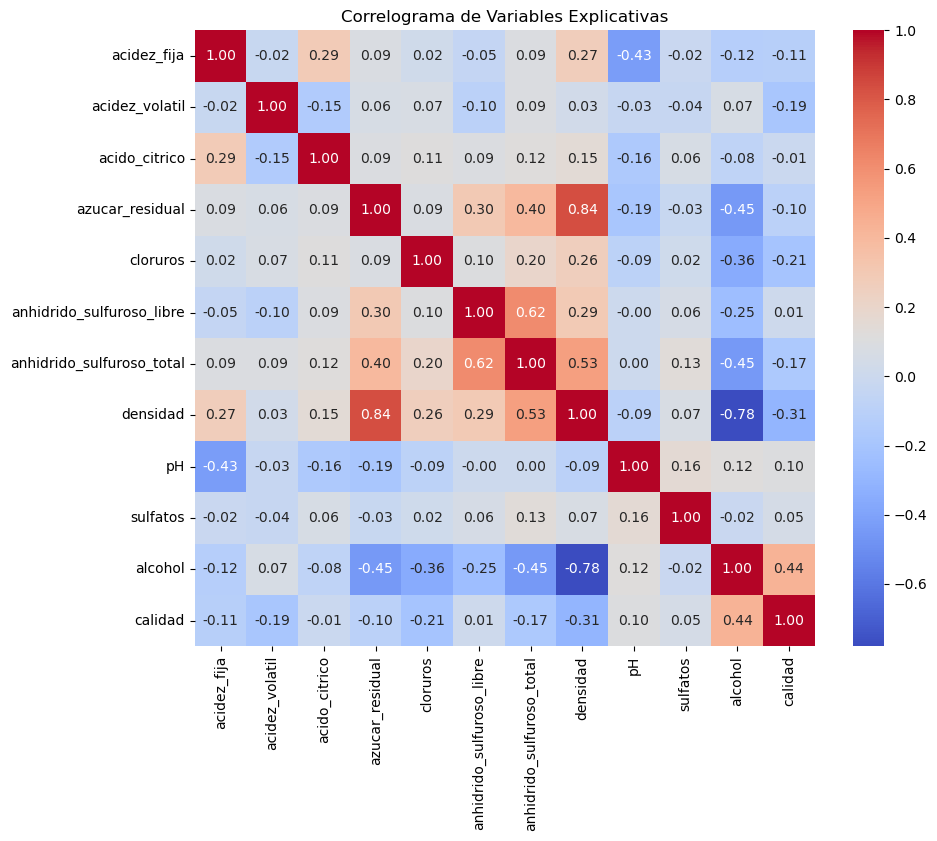

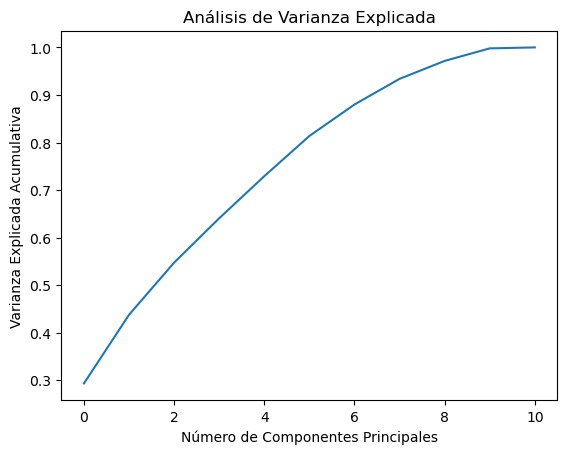

MSE del modelo PCR: 0.640515528356234
MSE del modelo PLS: 0.5772203172277309

Accuracy del modelo de regresión logística: 0.9663265306122449

Matriz de Confusión:
[[  0  30]
 [  3 947]]

Reporte de Clasificación:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        30
           1       0.97      1.00      0.98       950

    accuracy                           0.97       980
   macro avg       0.48      0.50      0.49       980
weighted avg       0.94      0.97      0.95       980



In [6]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Cargar datos
wine_data = pd.read_csv('winequality-white.csv', delimiter=';')

# a) Realizar un correlograma
correlation_matrix = wine_data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlograma de Variables Explicativas')
plt.show()

# b) Partir la base en train-test
X = wine_data.drop('calidad', axis=1)
y = wine_data['calidad']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# c) Ajustar un modelo de PCR
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

pca = PCA()
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Graficar varianza explicada por cada componente principal
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Número de Componentes Principales')
plt.ylabel('Varianza Explicada Acumulativa')
plt.title('Análisis de Varianza Explicada')
plt.show()

# d) Calcular el MSE para este subconjunto de componentes
n_components = 6  # Elegir el número óptimo de componentes basado en el gráfico
pca_model = PCA(n_components=n_components)
X_train_pca = pca_model.fit_transform(X_train_scaled)
X_test_pca = pca_model.transform(X_test_scaled)

# Ajustar modelo de PCR
model_pcr = LinearRegression()
model_pcr.fit(X_train_pca, y_train)

# Realizar predicciones
y_pred_pcr = model_pcr.predict(X_test_pca)

# Calcular el MSE
mse_pcr = mean_squared_error(y_test, y_pred_pcr)
print(f'MSE del modelo PCR: {mse_pcr}')

# e) Realizar el ajuste en este caso con PLS
n_components_pls = 6  # Elegir el número de componentes para PLS
pls_model = PLSRegression(n_components=n_components_pls)
pls_model.fit(X_train_scaled, y_train)

# Realizar predicciones
y_pred_pls = pls_model.predict(X_test_scaled)

# Calcular el MSE
mse_pls = mean_squared_error(y_test, y_pred_pls)
print(f'MSE del modelo PLS: {mse_pls}')

# f) Ajuste un modelo de regresión logística
# Crear variable binaria para calidad (calidad < 5 → 0, calidad ≥ 5 → 1)
wine_data['binary_quality'] = np.where(wine_data['calidad'] < 5, 0, 1)

# Partir la base en train-test
X_log = wine_data.drop(['calidad', 'binary_quality'], axis=1)
y_log = wine_data['binary_quality']
X_train_log, X_test_log, y_train_log, y_test_log = train_test_split(X_log, y_log, test_size=0.2, random_state=42)

X_train_log_scaled = scaler.fit_transform(X_train_log)
X_test_log_scaled = scaler.transform(X_test_log)

# Ajustar modelo de regresión logística
logistic_model = LogisticRegression()
logistic_model.fit(X_train_log_scaled, y_train_log)

# Realizar predicciones
y_pred_log = logistic_model.predict(X_test_log_scaled)

# Evaluar la pertinencia del modelo
accuracy = accuracy_score(y_test_log, y_pred_log)
conf_matrix = confusion_matrix(y_test_log, y_pred_log)
class_report = classification_report(y_test_log, y_pred_log)

print(f'\nAccuracy del modelo de regresión logística: {accuracy}')
print('\nMatriz de Confusión:')
print(conf_matrix)
print('\nReporte de Clasificación:')
print(class_report)

# 3.4. Modelos basados en PCA y PLS

## Ejercicio 3.6.

Usaremos los datos `ChemicalManufacturingProcess` de la biblioteca `AppliedPredictiveModeling` de R. Este conjunto de datos contiene información sobre un proceso de fabricación de productos químicos, en el que el objetivo es comprender la relación entre el proceso y el rendimiento del producto final resultante. La materia prima en este proceso se somete a una secuencia de 27 pasos para generar el producto farmacéutico final. El objetivo de este proyecto fue desarrollar un modelo para predecir el porcentaje de rendimiento del proceso de fabricación. El conjunto de datos consta de 177 muestras de material biológico para las que se midieron 57 características. Los predictores son continuos, de conteo, categóricos; algunos están correlacionados y otros contienen valores faltantes. Las muestras no son independientes porque los conjuntos de muestras provienen del mismo lote de material de partida biológico.

### a) Realizar un análisis cuidadoso de las variables predictoras y una limpieza de la base.

### b) Aplicar PCR y PLS para predecir `Yield` (rendimiento) y comparar los resultados de ambos métodos.


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 176 entries, 0 to 175
Data columns (total 58 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Yield                   176 non-null    float64
 1   BiologicalMaterial01    176 non-null    float64
 2   BiologicalMaterial02    176 non-null    float64
 3   BiologicalMaterial03    176 non-null    float64
 4   BiologicalMaterial04    176 non-null    float64
 5   BiologicalMaterial05    176 non-null    float64
 6   BiologicalMaterial06    176 non-null    float64
 7   BiologicalMaterial07    176 non-null    float64
 8   BiologicalMaterial08    176 non-null    float64
 9   BiologicalMaterial09    176 non-null    float64
 10  BiologicalMaterial10    176 non-null    float64
 11  BiologicalMaterial11    176 non-null    float64
 12  BiologicalMaterial12    176 non-null    float64
 13  ManufacturingProcess01  175 non-null    float64
 14  ManufacturingProcess02  173 non-null    fl

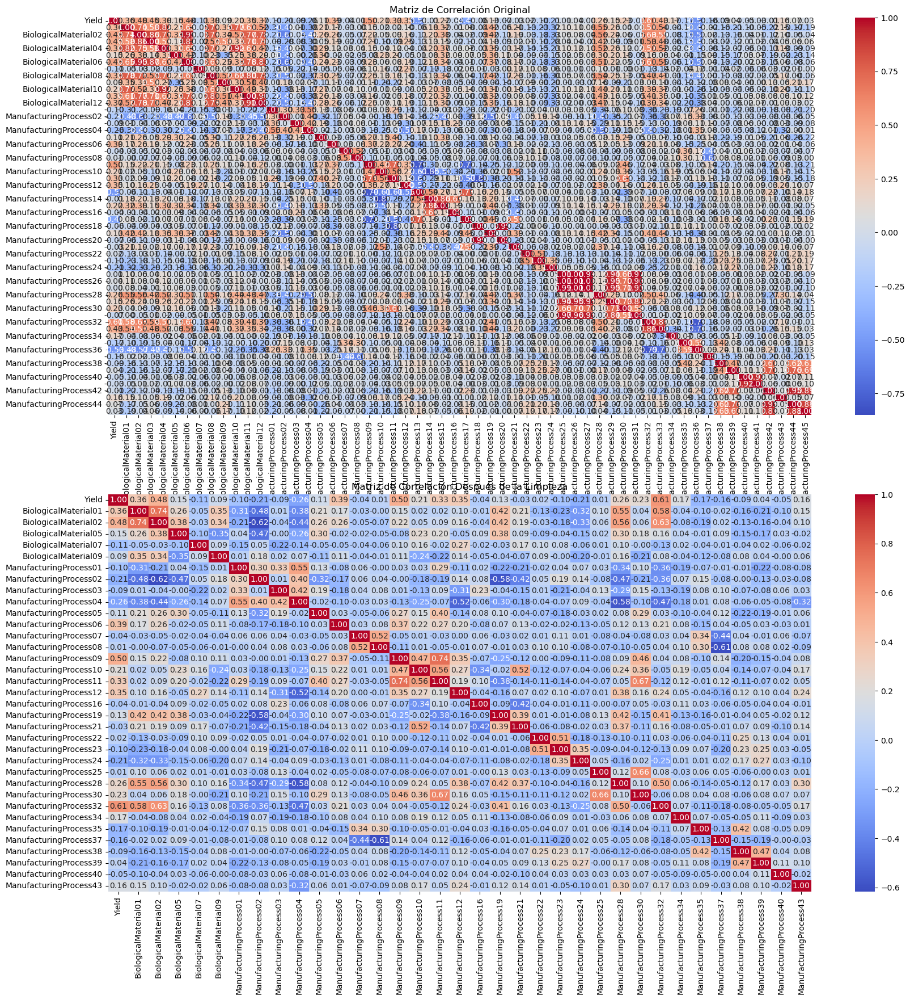

In [146]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.cross_decomposition import PLSRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Cargar datos
chemical_data = pd.read_csv('ChemicalManufacturingProcess.csv')

# Verificar información general del conjunto de datos
print(chemical_data.info())

# Manejar valores faltantes si es necesario
# chemical_data = chemical_data.dropna()  # O imputar valores faltantes según tu estrategia

# Explorar estadísticas descriptivas
print(chemical_data.describe())

# Explorar correlaciones entre variables
correlation_matrix = chemical_data.corr()

# Identificar pares de columnas con correlación mayor a un umbral
correlation_threshold = 0.75
correlated_pairs = []
for i in range(len(correlation_matrix.columns)):
    for j in range(i + 1, len(correlation_matrix.columns)):
        if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
            correlated_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j]))

# Imprimir pares de columnas correlacionadas
print("Pares de columnas correlacionadas:")
for pair in correlated_pairs:
    print(pair)

# Eliminar una de las columnas altamente correlacionadas de cada par
columns_to_drop = set()
for pair in correlated_pairs:
    columns_to_drop.add(pair[1])

# Eliminar columnas altamente correlacionadas del conjunto de datos
chemical_data_cleaned = chemical_data.drop(columns=columns_to_drop)

# Visualizar la matriz de correlación
import seaborn as sns
import matplotlib.pyplot as plt

# Visualizar la matriz de correlación después de la limpieza
plt.figure(figsize=(20, 20))
plt.subplot(2, 1, 1)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación Original')

plt.subplot(2, 1, 2)
sns.heatmap(chemical_data_cleaned.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación Después de la Limpieza')

plt.show()


In [149]:
# Seleccionar variables predictoras y variable respuesta
X = chemical_data_cleaned.dropna().drop('Yield', axis=1)
y = chemical_data_cleaned.dropna()['Yield']

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Escalar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# a) Aplicar PCR
n_components_pcr = 10  # Puedes ajustar el número de componentes principales
pca_model = PCA(n_components=n_components_pcr)
X_train_pcr = pca_model.fit_transform(X_train_scaled)
X_test_pcr = pca_model.transform(X_test_scaled)

# Ajustar modelo PCR
model_pcr = LinearRegression()
model_pcr.fit(X_train_pcr, y_train)

# Realizar predicciones
y_pred_pcr = model_pcr.predict(X_test_pcr)

# Calcular el MSE para PCR
mse_pcr = mean_squared_error(y_test, y_pred_pcr)
print(f'MSE del modelo PCR: {mse_pcr}')

# b) Aplicar PLS
n_components_pls = 10  # Puedes ajustar el número de componentes PLS
pls_model = PLSRegression(n_components=n_components_pls)
pls_model.fit(X_train_scaled, y_train)

# Realizar predicciones
y_pred_pls = pls_model.predict(X_test_scaled)

# Calcular el MSE para PLS
mse_pls = mean_squared_error(y_test, y_pred_pls)
print(f'MSE del modelo PLS: {mse_pls}')


MSE del modelo PCR: 1.7364981008056504
MSE del modelo PLS: 1.4389739386723344


# 4.1. DCA

## Ejercicio 4.1.

Un investigador estudió el contenido en sodio de las marcas de cerveza comercializadas en Capital Federal y Gran Buenos Aires. Para ello, seleccionaron las 6 marcas más prestigiosas del mercado y eligieron botellas o latas de 500 ml de cada marca seleccionada y midieron el contenido en sodio (en miligramos) de cada una de ellas.

Los resultados de este muestreo se presentan en la siguiente tabla:

| Marca 1 | Marca 2 | Marca 3 | Marca 4 | Marca 5 | Marca 6 |
|---------|---------|---------|---------|---------|---------|
| 24.4    | 10.2    | 19.2    | 17.4    | 13.4    | 21.3    |
| 22.6    | 12.1    | 19.4    | 18.1    | 15.0    | 20.2    |
| 23.8    | 10.3    | 19.8    | 16.7    | 14.1    | 20.7    |
| 22.0    | 10.2    | 19.0    | 18.3    | 13.1    | 20.8    |
| 24.5    | 9.9     | 19.6    | 17.6    | 14.9    | 20.1    |
| 22.3    | 11.2    | 18.3    | 17.5    | 15.0    | 18.8    |
| 25.0    | 12.0    | 20.0    | 18.0    | 13.4    | 21.1    |
| 24.5    | 9.5     | 19.4    | 16.4    | 14.8    | 20.3    |

### (a) Graficar la variable observada en los grupos y analizar la presencia de outliers y la igualdad gráfica de las medias y las formas de las distribuciones.

### (b) Calcular la media y el desvío de cada uno de los grupos. ¿Le parece que se satisface el supuesto de homogeneidad?

### (c) Establecer las hipótesis estadísticas de interés.

### (d) Contrastar las hipótesis con un nivel α = 0,05.

### (e) Verificar el cumplimiento de los supuestos de normalidad y homocedasticidad.

### (f) Si se verifican, concluir en el contexto del problema.


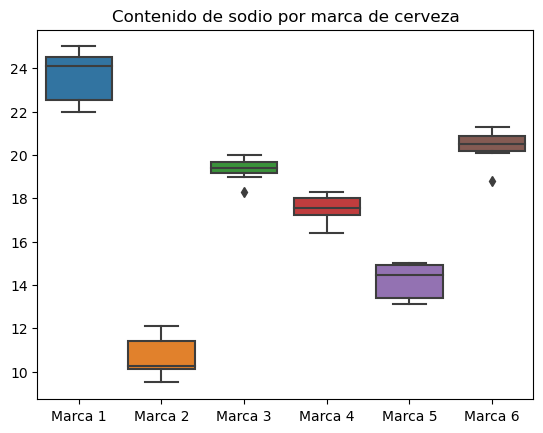

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Crear un DataFrame con los datos
data = pd.DataFrame({
    'Marca 1': [24.4, 22.6, 23.8, 22.0, 24.5, 22.3, 25.0, 24.5],
    'Marca 2': [10.2, 12.1, 10.3, 10.2, 9.9, 11.2, 12.0, 9.5],
    'Marca 3': [19.2, 19.4, 19.8, 19.0, 19.6, 18.3, 20.0, 19.4],
    'Marca 4': [17.4, 18.1, 16.7, 18.3, 17.6, 17.5, 18.0, 16.4],
    'Marca 5': [13.4, 15.0, 14.1, 13.1, 14.9, 15.0, 13.4, 14.8],
    'Marca 6': [21.3, 20.2, 20.7, 20.8, 20.1, 18.8, 21.1, 20.3]
})

# Graficar los datos
sns.boxplot(data=data)
plt.title('Contenido de sodio por marca de cerveza')
plt.show()

In [22]:
# Calcular la media y el desvío de cada grupo
means = data.mean()
stds = data.std()

# Mostrar los resultados
group_stats = pd.DataFrame({'Media': means, 'Desvío Estándar': stds})
print(group_stats)

           Media  Desvío Estándar
Marca 1  23.6375         1.164888
Marca 2  10.6750         0.973580
Marca 3  19.3375         0.526274
Marca 4  17.5000         0.667618
Marca 5  14.2125         0.813173
Marca 6  20.4125         0.779079


In [23]:
# Hipótesis nula (H0): μ1 = μ2 = μ3 = μ4 = μ5 = μ6 (No hay diferencias significativas en el contenido de sodio entre las marcas).
# Hipótesis alternativa (H1): Al menos una de las medias es diferente.

from scipy.stats import f_oneway

# Realizar ANOVA
f_statistic, p_value = f_oneway(data['Marca 1'], data['Marca 2'], data['Marca 3'], data['Marca 4'], data['Marca 5'], data['Marca 6'])

# Mostrar los resultados
print(f'Estadístico F: {f_statistic}')
print(f'Valor p: {p_value}')

Estadístico F: 238.71117392750207
Valor p: 1.0837455034660917e-29


Statistics for Marca 1 Shapiro-Wilk test: 0.8717838525772095, p-value: 0.15689487755298615


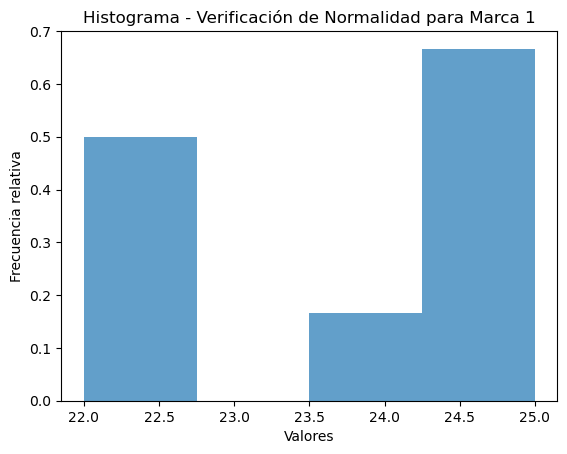

Statistics for Marca 2 Shapiro-Wilk test: 0.8813052773475647, p-value: 0.1938096284866333


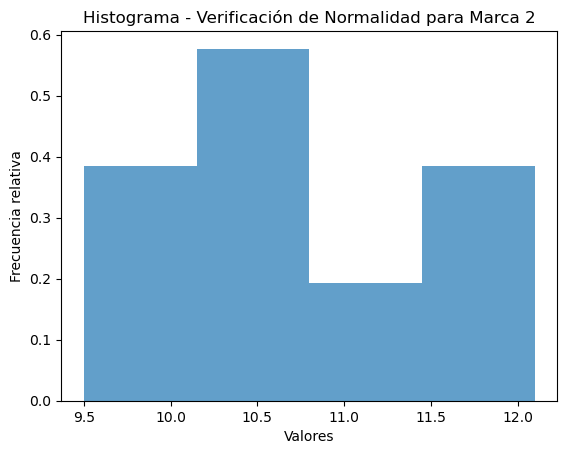

Statistics for Marca 3 Shapiro-Wilk test: 0.9423931241035461, p-value: 0.6347695589065552


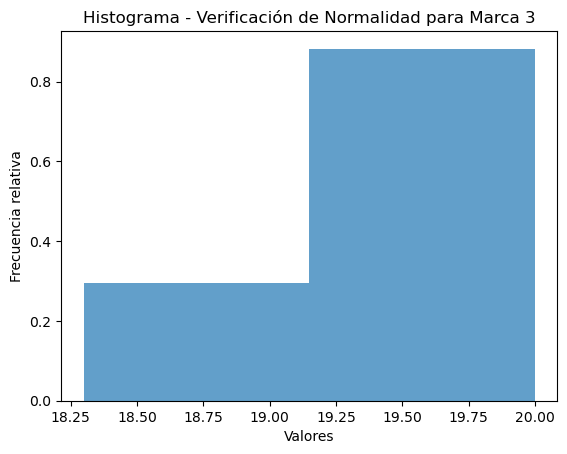

Statistics for Marca 4 Shapiro-Wilk test: 0.9297223091125488, p-value: 0.5135510563850403


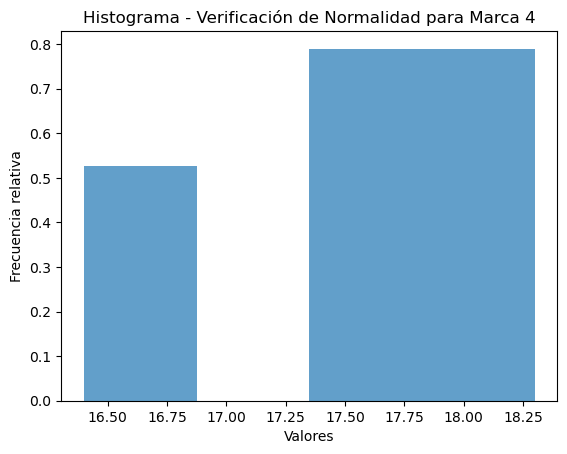

Statistics for Marca 5 Shapiro-Wilk test: 0.8281691074371338, p-value: 0.056818265467882156


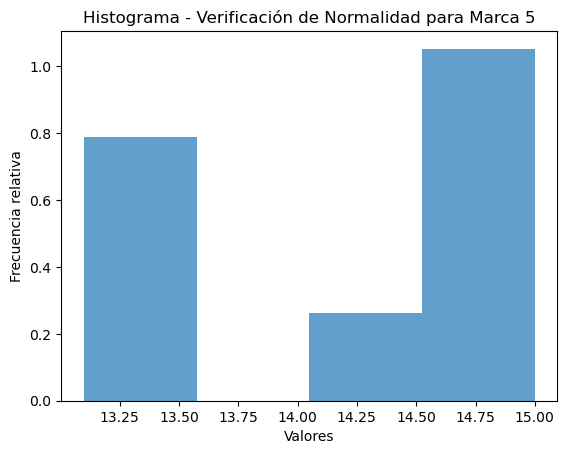

Statistics for Marca 6 Shapiro-Wilk test: 0.9010510444641113, p-value: 0.2953093647956848


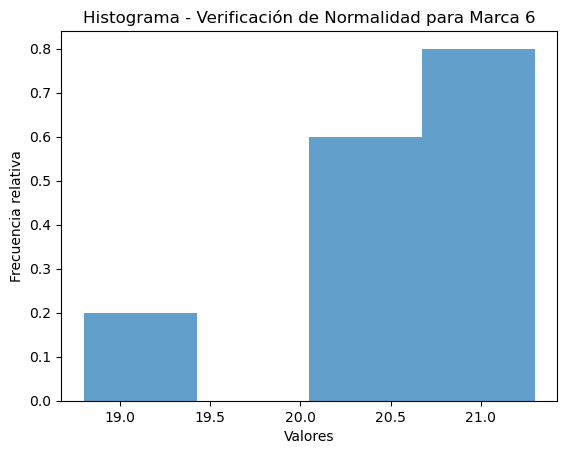

In [32]:
from scipy import stats
import statsmodels.api as sm

for marca in data.columns:
    # Verificar normalidad mediante el test de Shapiro-Wilk
    stat_shapiro, p_value_shapiro = stats.shapiro(data[marca])
    print(f'Statistics for {marca} Shapiro-Wilk test: {stat_shapiro}, p-value: {p_value_shapiro}')

    plt.hist(data[marca], bins='auto', density=True, alpha=0.7)
    plt.title(f'Histograma - Verificación de Normalidad para {marca}')
    plt.xlabel('Valores')
    plt.ylabel('Frecuencia relativa')
    plt.show()

## Ejercicio 4.2.

Para comparar cuatro suplementos "de engorde" en bovinos para carne, se seleccionaron al azar cuarenta animales Hereford de igual edad y sexo, y de pesos homogéneos para ser usados en un experimento.

- Suplemento 1 (S1): Grano partido y fuente A.
- Suplemento 2 (S2): Grano partido y fuente B.
- Suplemento 3 (S3): Grano entero y fuente A.
- Suplemento 4 (S4): Grano entero y fuente B.

Se asignaron aleatoriamente 10 animales por suplemento, los cuales fueron alimentados individualmente con una dieta estándar más el correspondiente suplemento durante 80 días. La variable en estudio (o respuesta) fue la eficiencia de conversión (EfCon) individual (kg Materia Seca/kg Ganancia de Peso), cuyos registros se presentan en la siguiente tabla:

| S1  | S2  | S3  | S4  |
|----|----|----|----|
| 3.3| 4.6| 6.7| 6.3|
| 4.4| 4.5| 5.8| 6.0|
| 4.9| 5.0| 5.0| 6.7|
| 4.9| 4.0| 4.8| 5.5|
| 3.9| 4.5| 5.3| 6.6|
| 4.2| 5.2| 6.2| 6.1|
| 4.7| 4.9| 5.0| 5.3|
| 5.1| 5.5| 6.4| 6.5|
| 4.6| 4.8| 5.9| 6.3|
| 4.5| 5.3| 5.4| 6.8|

### (a) Realice un análisis gráfico y descriptivo de la eficiencia de conversión lograda por los distintos suplementos.

### (b) Establezca las hipótesis de interés del problema y explícite los supuestos necesarios.

### (c) Testee las hipótesis con un nivel de significación del 5 %.

### (d) Analice el cumplimiento de los supuestos del modelo.

### (e) Concluya en términos del problema y, si rechazó H0, indique cuáles medias son diferentes. Utilice para ello las comparaciones a posteriori de Tukey.


Estadísticas descriptivas:
           S1         S2         S3         S4
count  10.000  10.000000  10.000000  10.000000
mean    4.450   4.830000   5.650000   6.210000
std     0.538   0.447338   0.650214   0.497661
min     3.300   4.000000   4.800000   5.300000
25%     4.250   4.525000   5.075000   6.025000
50%     4.550   4.850000   5.600000   6.300000
75%     4.850   5.150000   6.125000   6.575000
max     5.100   5.500000   6.700000   6.800000


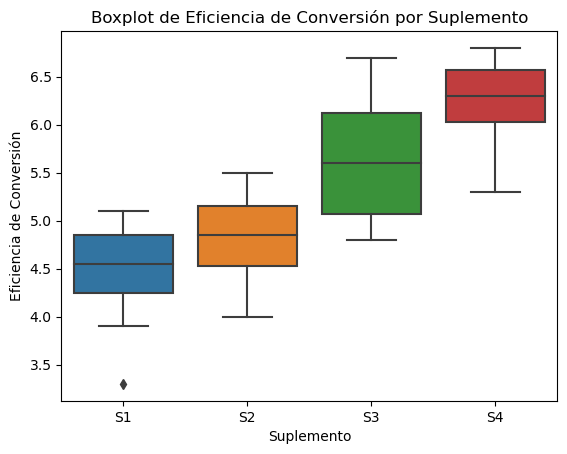


Análisis de varianza (ANOVA):
Estadístico F: 21.759770114942523, Valor p: 3.2647438615952296e-08

Comparación de medias (Tukey):
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj   lower  upper  reject
---------------------------------------------------
    S1     S2     0.38 0.4037 -0.2686 1.0286  False
    S1     S3      1.2 0.0001  0.5514 1.8486   True
    S1     S4     1.76    0.0  1.1114 2.4086   True
    S2     S3     0.82 0.0085  0.1714 1.4686   True
    S2     S4     1.38    0.0  0.7314 2.0286   True
    S3     S4     0.56 0.1111 -0.0886 1.2086  False
---------------------------------------------------


In [3]:
import pandas as pd
from scipy.stats import f_oneway
import seaborn as sns
import matplotlib.pyplot as plt

# Crear un DataFrame con tus datos
data = {
    'S1': [3.3, 4.4, 4.9, 4.9, 3.9, 4.2, 4.7, 5.1, 4.6, 4.5],
    'S2': [4.6, 4.5, 5.0, 4.0, 4.5, 5.2, 4.9, 5.5, 4.8, 5.3],
    'S3': [6.7, 5.8, 5.0, 4.8, 5.3, 6.2, 5.0, 6.4, 5.9, 5.4],
    'S4': [6.3, 6.0, 6.7, 5.5, 6.6, 6.1, 5.3, 6.5, 6.3, 6.8]
}

df = pd.DataFrame(data)

# Análisis descriptivo
print("Estadísticas descriptivas:")
print(df.describe())

# Visualización de los datos
sns.boxplot(data=df)
plt.title('Boxplot de Eficiencia de Conversión por Suplemento')
plt.xlabel('Suplemento')
plt.ylabel('Eficiencia de Conversión')
plt.show()

# Análisis de varianza (ANOVA)
f_statistic, p_value = f_oneway(df['S1'], df['S2'], df['S3'], df['S4'])
print(f'\nAnálisis de varianza (ANOVA):')
print(f'Estadístico F: {f_statistic}, Valor p: {p_value}')

# Verificar diferencias entre grupos mediante pruebas post hoc (por ejemplo, Tukey)
from statsmodels.stats.multicomp import pairwise_tukeyhsd

# Transformar el DataFrame a un formato apilado
df_stacked = pd.melt(df.reset_index(), id_vars=['index'], value_vars=['S1', 'S2', 'S3', 'S4'])

# Realizar la prueba Tukey
tukey_result = pairwise_tukeyhsd(df_stacked['value'], df_stacked['variable'])
print('\nComparación de medias (Tukey):')
print(tukey_result)


**Hipótesis nula (H0):**  
\[ \mu_1 = \mu_2 = \mu_3 = \mu_4 \]  
(No hay diferencias significativas en la eficiencia de conversión entre los suplementos).

**Hipótesis alternativa (H1):**  
Al menos una de las medias es diferente.

**Supuestos del ANOVA:**
1. Normalidad de los residuos.
2. Homogeneidad de las varianzas.
3. Observaciones independientes y aleatorias.

Statistics for Shapiro-Wilk test: 0.9671204090118408, p-value: 0.2906205952167511


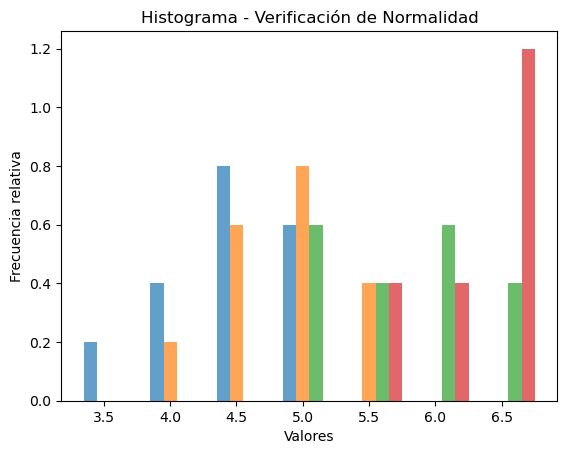

In [6]:
from scipy import stats
import statsmodels.api as sm

# Verificar normalidad mediante el test de Shapiro-Wilk
stat_shapiro, p_value_shapiro = stats.shapiro(df)
print(f'Statistics for Shapiro-Wilk test: {stat_shapiro}, p-value: {p_value_shapiro}')

# Graficar
plt.hist(df, bins='auto', density=True, alpha=0.7)
plt.title('Histograma - Verificación de Normalidad')
plt.xlabel('Valores')
plt.ylabel('Frecuencia relativa')
plt.show()

Statistics for S1 Shapiro-Wilk test: 0.9252986311912537, p-value: 0.4032711386680603


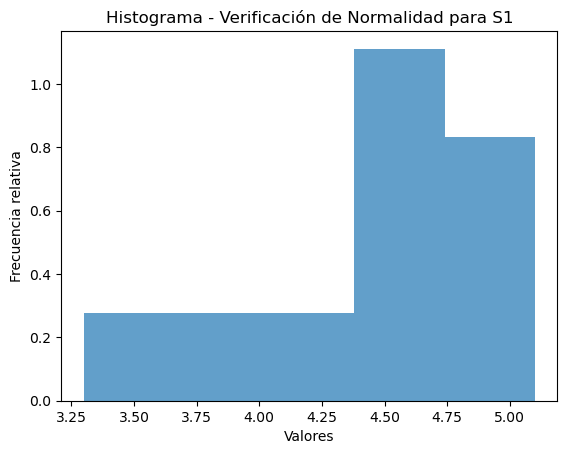

Statistics for S2 Shapiro-Wilk test: 0.9776292443275452, p-value: 0.95122891664505


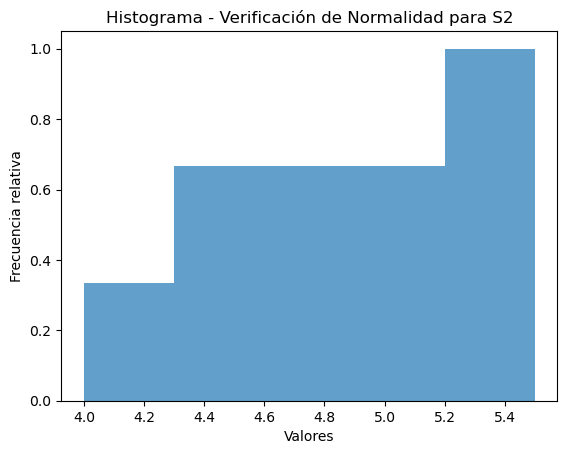

Statistics for S3 Shapiro-Wilk test: 0.9463013410568237, p-value: 0.6249950528144836


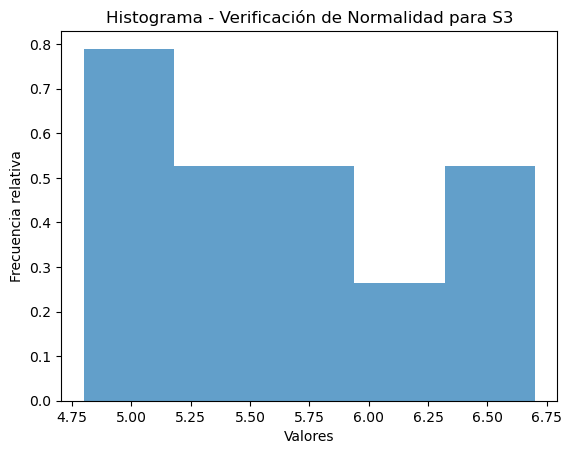

Statistics for S4 Shapiro-Wilk test: 0.921339750289917, p-value: 0.3682650625705719


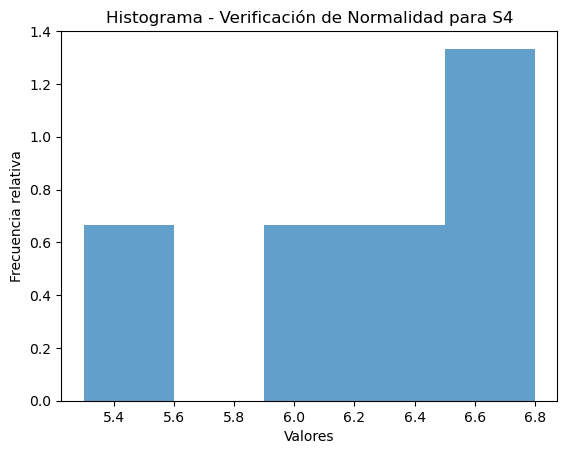

In [35]:
for suplementos in df.columns:
    # Verificar normalidad mediante el test de Shapiro-Wilk
    stat_shapiro, p_value_shapiro = stats.shapiro(df[suplementos])
    print(f'Statistics for {suplementos} Shapiro-Wilk test: {stat_shapiro}, p-value: {p_value_shapiro}')

    plt.hist(df[suplementos], bins='auto', density=True, alpha=0.7)
    plt.title(f'Histograma - Verificación de Normalidad para {suplementos}')
    plt.xlabel('Valores')
    plt.ylabel('Frecuencia relativa')
    plt.show()

## Ejercicio 4.3.

Se desea estudiar el efecto de una nueva droga analgésica para uso farmacéutico en pacientes con neuralgia crónica. Se compara con la aspirina y un placebo. En 30 pacientes elegidos al azar, utilizando el método del doble ciego, se asignan al azar 10 pacientes a cada tratamiento. La variable aleatoria observada es el número de horas en que el paciente está libre de dolor después de haber sido tratado. Los resultados obtenidos fueron:

| Tratamiento | Media | DE    |
|-------------|-------|-------|
| Placebo     | 2.5   | 0.13  |
| Aspirina    | 2.82  | 0.2   |
| Droga       | 3.2   | 0.17  |

### (a) Identifique la variable dependiente y el factor de interés.

- Variable dependiente: Número de horas en que el paciente está libre de dolor.
- Factor de interés: Tipo de tratamiento (Placebo, Aspirina, Droga).

### (b) Escriba el modelo, en general y en términos del problema.

- Modelo general: \(Y_{ij} = \mu + \tau_i + \epsilon_{ij}\)
- Modelo en términos del problema: \(Y_{ij} = \mu + \text{Tratamiento}_i + \epsilon_{ij}\)

### (c) Analice los resultados de las pruebas de hipótesis para los supuestos del modelo.

- Prueba de Levene (p = 0.15): No hay evidencia suficiente para rechazar la igualdad de varianzas.
- Prueba de Shapiro-Wilks de los residuos (): No Hay evidencia suficiente para rechazar la normalidad de los residuos.

### (d) Plantee las hipótesis y construya la tabla de Anova sabiendo que \(SC_{\text{error}} = \sum_{i=1}^{k}(n_i - 1)s_i^2\).

### (e) Compare los tratamientos y utilizando un test t con nivel global 0.05.

### (f) Adicionalmente, se indagó a los pacientes sobre efectos colaterales gástricos. Los resultados se presentan a continuación:

| Placebo | Aspirina | Droga |
|---------|----------|-------|
| 0       | 1        | 4     |
| 3       | 4        | 5     |
| 2       | 3        | 4     |
| 3       | 0        | 2     |
| 4       | 2        | 3     |
| 2       | 3        | 4     |
| 2       | 4        | 1     |
| 3       | 5        | 5     |
| 1       | 2        | 3     |
| 1       | 3        | 0     |

#### (I) ¿Cree que los investigadores deberían utilizar la misma prueba estadística que la empleada para comparar el tiempo libre de dolor? Justifique.

#### (II) ¿Cuáles son las conclusiones de este estudio?


In [20]:
import pandas as pd
import numpy as np
from scipy.stats import levene, shapiro, f_oneway, ttest_ind

# Crear un DataFrame con los datos
data = pd.DataFrame({
    'Tratamiento': ['Placebo', 'Aspirina', 'Droga'],
    'Media': [2.5, 2.82, 3.2],
    'DE': [0.13, 0.2, 0.17]
})

# Verificar la igualdad de varianzas con la prueba de Levene
levene_result = levene(data['Media'], data['DE'])
print("Prueba de Levene p-value:", levene_result.pvalue)

Prueba de Levene p-value: 0.1512078904871098


# 4.2. Alternativa no paramétrica


## Ejercicio 4.4.

Se está estudiando el tiempo de cocción de un alimento antes de lanzarlo al mercado. Se han formado cuatro grupos y se les ha pedido que midan el tiempo transcurrido hasta que, según su juicio, el alimento quede a punto. Como esta sensación es subjetiva, se usa un ANOVA para estimar la varianza que presenta el experimento. Todos los grupos usan fuentes de calor y utensilios similares. Si la tabla siguiente recoge los resultados redondeados en minutos, ¿qué estimación podríamos hacer de la varianza de la población de estos alimentos? ¿Se observan diferencias entre los grupos?

| Grupo A | Grupo B | Grupo C | Grupo D |
|---------|---------|---------|---------|
| 25      | 121     | 81      | 25      |
| 36      | 36      | 81      | 25      |
| 36      | 36      | 36      | 36      |
| 25      | 64      | 9       | 25      |
| 36      | 36      | 25      | 36      |
| 16      | 81      | 36      | 25      |
| 25      | 49      | 9       | 25      |
| 36      | 25      | 49      | 25      |
| 49      | 64      | 169     | 25      |
| 36      | 49      | 1       | 25      |
| 25      | 121     | 81      | 25      |

### (a) Grafique los tiempos de cocción por tratamiento. Calcule las medidas resumen de los mismos.

### (b) Establezca las hipótesis de interés, escriba el modelo detallando los supuestos.

### (c) Realice la prueba y el diagnóstico correspondiente. ¿Son válidos los resultados de la prueba?

### (d) Si respondió afirmativamente en (c) concluya en el contexto del problema. Si concluyó negativamente, intente una transformación de potencia conveniente para normalizar y/o homocedastizar la variable respuesta.

### (e) Realice nuevamente la prueba si fuera necesario y el diagnóstico del modelo correspondiente. Concluya en términos del problema.

### (f) Compare los resultados con los del test no paramétrico.


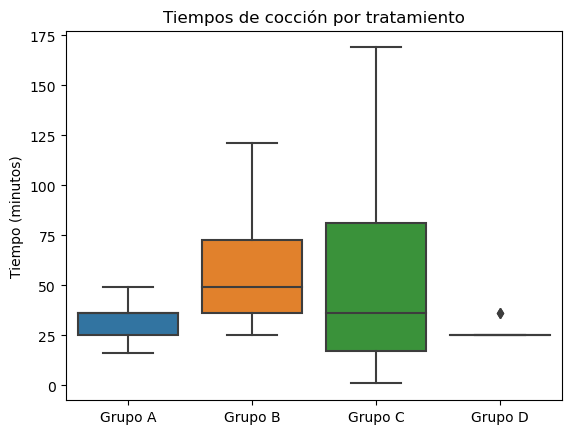

         Grupo A     Grupo B     Grupo C    Grupo D
count  11.000000   11.000000   11.000000  11.000000
mean   31.363636   62.000000   52.454545  27.000000
std     9.036290   33.265598   48.742925   4.449719
min    16.000000   25.000000    1.000000  25.000000
25%    25.000000   36.000000   17.000000  25.000000
50%    36.000000   49.000000   36.000000  25.000000
75%    36.000000   72.500000   81.000000  25.000000
max    49.000000  121.000000  169.000000  36.000000


In [37]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import f_oneway, shapiro, boxcox
from statsmodels.graphics.gofplots import qqplot

# Crear un DataFrame con los datos
data = pd.DataFrame({
    'Grupo A': [25, 36, 36, 25, 36, 16, 25, 36, 49, 36, 25],
    'Grupo B': [121, 36, 36, 64, 36, 81, 49, 25, 64, 49, 121],
    'Grupo C': [81, 81, 36, 9, 25, 36, 9, 49, 169, 1, 81],
    'Grupo D': [25, 25, 36, 25, 36, 25, 25, 25, 25, 25, 25]
})

# Graficar los tiempos de cocción por tratamiento
sns.boxplot(data)
plt.title('Tiempos de cocción por tratamiento')
plt.ylabel('Tiempo (minutos)')
plt.show()

# Calcular medidas resumen
resumen = data.describe()
print(resumen)

In [38]:
# Hipótesis nula (H0): Las medias de los tratamientos son iguales
# Hipótesis alternativa (H1): Al menos una de las medias es diferente
anova_result = f_oneway(data['Grupo A'], data['Grupo B'], data['Grupo C'], data['Grupo D'])
print("Prueba de ANOVA p-value:", anova_result.pvalue)


Prueba de ANOVA p-value: 0.025527888104426816


In [57]:
# Realizar diagnóstico
for grupo in data.columns:
    _, p_value_shapiro = shapiro(data[grupo])
    print(f"Grupo {grupo}: Prueba de Shapiro-Wilks p-value = {p_value_shapiro}")

# Realizar transformación de Box-Cox si es necesario
data_transformada, lambda_valor = boxcox(data.stack(), lmbda=None)
data_transformada = pd.DataFrame(np.split(data_transformada, len(data)))

# Realizar nuevamente la prueba ANOVA con los datos transformados
anova_result_transformada = f_oneway(data_transformada[0], data_transformada[1],
                                     data_transformada[2], data_transformada[3])
print("Prueba de ANOVA (datos transformados) p-value:", anova_result_transformada.pvalue)

Grupo Grupo A: Prueba de Shapiro-Wilks p-value = 0.13885685801506042
Grupo Grupo B: Prueba de Shapiro-Wilks p-value = 0.04701699689030647
Grupo Grupo C: Prueba de Shapiro-Wilks p-value = 0.06217993423342705
Grupo Grupo D: Prueba de Shapiro-Wilks p-value = 1.0208648291154532e-06
Prueba de ANOVA (datos transformados) p-value: 0.05550408514766044


In [58]:
from scipy.stats import kruskal

# Realizar la prueba de Kruskal-Wallis (test no paramétrico)
kruskal_result = kruskal(data['Grupo A'], data['Grupo B'], data['Grupo C'], data['Grupo D'])
print("Prueba de Kruskal-Wallis p-value:", kruskal_result.pvalue)


Prueba de Kruskal-Wallis p-value: 0.0073574424820200685


# 4.3. ANOVA de dos vías con y sin interacción

## Ejercicio 4.5.

Se pretende evaluar el efecto de la humedad en el suelo sobre la germinación de las semillas considerando el factor de cobertura. La base de datos semillas.xlsx contiene 48 registros de germinaciones con diferente porcentaje de humedad del suelo, con y sin cobertura del cultivo y proporción de germinación de las semillas.

(a) Análisis de la Proporción de Germinación Global

(b) Estudio de la Asociación entre la Humedad y la Germinación

(c) Análisis de la Dependencia de la Germinación de la Cobertura y Evaluación de la Interacción entre los Dos Factores

(d) Construcción de un Modelo para Explicar la Relación de los Dos Factores con el Porcentaje de Germinación

(e) Utilización de los Efectos y las Comparaciones a Posteriori para Realizar una Recomendación


In [80]:
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats.anova import anova_lm

# Cargar los datos
data = pd.read_csv('semillas.csv', sep=';')

# Calcular la media global de la proporción de germinación
media_global = data['germ'].mean()
print(f"Media global de la proporción de germinación: {media_global}")

# Análisis de la asociación entre la humedad y la germinación
modelo_humedad = smf.ols('germ ~ humedad', data=data).fit()
anova_humedad = anova_lm(modelo_humedad)
print('\n\n anova_humedad:', anova_humedad)

# Análisis de la dependencia de la germinación de la cobertura y evaluación de la interacción
modelo_interaccion = smf.ols('germ ~ humedad * cobertura', data=data).fit()
anova_interaccion = anova_lm(modelo_interaccion)
print('\n\n anova_interaccion:', anova_interaccion)

# Construcción de un modelo para explicar la relación de los dos factores con el porcentaje de germinación
modelo_final = smf.ols('germ ~ humedad + cobertura + humedad:cobertura', data=data).fit()
print('\n\n modelo_final:', modelo_final.summary())

# Utilización de los efectos y las comparaciones a posteriori
comparaciones_posteriori = ''
print('\n\n', comparaciones_posteriori)

Media global de la proporción de germinación: 47.808510638297875


 anova_humedad:             df        sum_sq      mean_sq         F    PR(>F)
humedad    1.0   4049.982251  4049.982251  5.673075  0.021516
Residual  45.0  32125.294345   713.895430       NaN       NaN


 anova_interaccion:                      df        sum_sq      mean_sq         F    PR(>F)
cobertura           1.0      1.100871     1.100871  0.001625  0.968035
humedad             1.0   4053.996845  4053.996845  5.982918  0.018612
humedad:cobertura   1.0   2983.584107  2983.584107  4.403195  0.041783
Residual           43.0  29136.594773   677.595227       NaN       NaN


 modelo_final:                             OLS Regression Results                            
Dep. Variable:                   germ   R-squared:                       0.195
Model:                            OLS   Adj. R-squared:                  0.138
Method:                 Least Squares   F-statistic:                     3.463
Date:                

# 5.1. Modelo Univariado: interpretación
## Ejercicio 5.1.

En 1986, el transbordador espacial Challenger tuvo un accidente catastrófico debido a un incendio en una de las piezas de sus propulsores. Era la vez 25 en que se lanzaba un transbordador espacial. En todas las ocasiones anteriores se habían inspeccionado los propulsores de las naves, y en algunas de ellas se habían encontrando defectos. El fichero challenger contiene 23 observaciones de las siguientes variables: defecto, que toma los valores 1 y 0 en función de si se encontraron defectos o no en los propulsores; y temp, la temperatura (en grados Fahrenheit) en el momento del lanzamiento. Los datos se encuentran en el fichero Challenger.xlsx.

### a) ¿Se puede afirmar que la temperatura influye en la probabilidad de que los propulsores tengan defectos? ¿Qué test utilizó para responder? Justifique.

### b) Interprete el valor del coeficiente estimado para temperatura en el contexto del problema.

### c) Para qué valores de temperatura la probabilidad estimada de que se produzcan defectos supera 0.1 y 0.5?

In [67]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

# Cargar los datos
data = pd.read_excel('Challenger.xlsx')

# Separar las variables independientes (X) y dependiente (y)
X = data[['Temperature']].to_numpy()
y = data['Incident'].to_numpy()

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear y ajustar el modelo de regresión logística
modelo_logistico_sklearn = LogisticRegression()
modelo_logistico_sklearn.fit(X_train, y_train)

# Evaluar el modelo
y_pred = modelo_logistico_sklearn.predict(X_test)

print("Matriz de confusión:")
print(confusion_matrix(y_test, y_pred))
print("\nReporte de clasificación:")
print(classification_report(y_test, y_pred))

# Coeficiente estimado para temperatura
coef_temp_sklearn = modelo_logistico_sklearn.coef_[0][0]
print(f"Coeficiente estimado para temperatura: {coef_temp_sklearn}")


def calcular_temperatura(modelo, probabilidad):
    """
    Calcula la temperatura para una probabilidad específica.

    Args:
        modelo: El modelo de regresión logística.
        probabilidad: La probabilidad específica.

    Returns:
        La temperatura para la probabilidad específica.
    """
    for t in range(1,101):
        if abs(modelo.predict_proba([[t]])[0][1] - probabilidad) <=0.03:
            break
    return t


# Calcular las temperaturas para las probabilidades específicas
temp_prob_01 = calcular_temperatura(modelo_logistico_sklearn, 0.1)
temp_prob_05 = calcular_temperatura(modelo_logistico_sklearn, 0.5)

print(f"Temperatura para probabilidad estimada de 0.1 está entre: {temp_prob_01} y {temp_prob_01+1}")
print(f"Temperatura para probabilidad estimada de 0.5 está entre: {temp_prob_05} y {temp_prob_05+1}")

Matriz de confusión:
[[3 0]
 [0 2]]

Reporte de clasificación:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         3
           1       1.00      1.00      1.00         2

    accuracy                           1.00         5
   macro avg       1.00      1.00      1.00         5
weighted avg       1.00      1.00      1.00         5

Coeficiente estimado para temperatura: -0.17738424525131713
Temperatura para probabilidad estimada de 0.1 está entre: 75 y 76
Temperatura para probabilidad estimada de 0.5 está entre: 63 y 64


In [102]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.formula.api import glm
from scipy.interpolate import interp1d

# Cargar los datos
data = pd.read_excel('Challenger.xlsx') 

# Ajustar un modelo de regresión logística
modelo_logistico = glm('Incident ~ Temperature', data=data, family=sm.families.Binomial()).fit()
print(modelo_logistico.summary())

# Obtener el coeficiente estimado para temperatura
coef_temp = modelo_logistico.params['Temperature']
print(f"Coeficiente estimado para temperatura: {coef_temp}")

def calcular_temperatura_interpolando(model,treshold, X):
    """
    Calcula la temperatura para una probabilidad específica.

    Args:
        model: modelo logistico.
        treshold: La probabilidad específica.
        X: variable regresora

    Returns:
        La variable predictora para la probabilidad específica.
    """
    return interp1d(model.predict(X),X)(treshold)


# Calcular las temperaturas para las probabilidades específicas
temp_prob_01 = calcular_temperatura_interpolando(modelo_logistico, 0.1, data['Temperature'])
temp_prob_05 = calcular_temperatura_interpolando(modelo_logistico, 0.5, data['Temperature'])

print(f"Temperatura para probabilidad estimada de 0.1: {temp_prob_01}")
print(f"Temperatura para probabilidad estimada de 0.5: {temp_prob_05}")

                 Generalized Linear Model Regression Results                  
Dep. Variable:               Incident   No. Observations:                   23
Model:                            GLM   Df Residuals:                       21
Model Family:                Binomial   Df Model:                            1
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -10.158
Date:                Thu, 23 Nov 2023   Deviance:                       20.315
Time:                        13:08:27   Pearson chi2:                     23.2
No. Iterations:                     5   Pseudo R-squ. (CS):             0.2923
Covariance Type:            nonrobust                                         
                  coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept      15.0429      7.379      2.039      

## Ejercicio 5.2.
Consideremos los datos del archivo diabetes.xlsx. Corresponden a 146 adultos que han participado de un ensayo sobre diabetes para investigar la relación entre la presencia de diabetes y varias medidas químicas. Es importante destacar que la obesidad se consideró un criterio de exclusión. El archivo contiene las siguientes variables explicativas:

### a) Obtenga los box-plots para la variable SSPG para los grupos con y sin diabetes. Compare los valores medios de ambos grupos y comente.

### b) Obtenga el diagrama de dispersión de los valores observados de la variable respuesta (en el eje vertical) y la variable SSPG.

### c) Construya una tabla que contenga para cada grupo etáreo la media de la edad y la media de DIABET, que corresponde a la proporción de individuos que tienen DIABET en cada grupo. Analice.

### d) Ajuste un modelo para estimar diabet en función de SSPG.

### e) Interprete los coeficientes obtenidos en términos del problema planteado.

### f) Para una persona con SSPG igual a 100, ¿qué valores de logit, odds y la probabilidad de tener DIABET estima el modelo? Calcúlelos.

### g) Halle un intervalo de confianza del 95 % del Odds Ratio para DIABET. Interprete.

### h) Evalúe la bondad del ajuste obtenido. Para ello construya una matriz de confusión con un conjunto de validación del 30 % de los datos utilizando como punto de corte pb = 0,5. Hágalo luego con otros puntos de corte.

### i) Realizar el test de Hosmer –Lemeshow y comentar los resultados obtenidos.

### j) Estime el área bajo la curva ROC y explique el resultado.

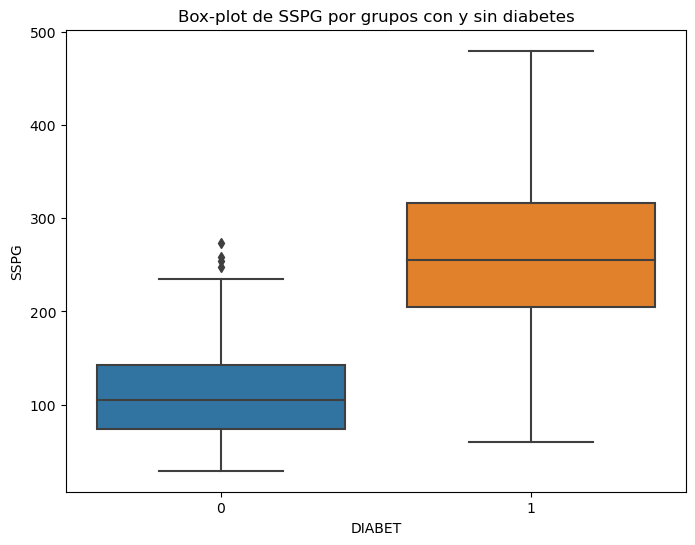

Valor medio de SSPG para diabetes: 261.4
Valor medio de SSPG para no diabetes: 114.0


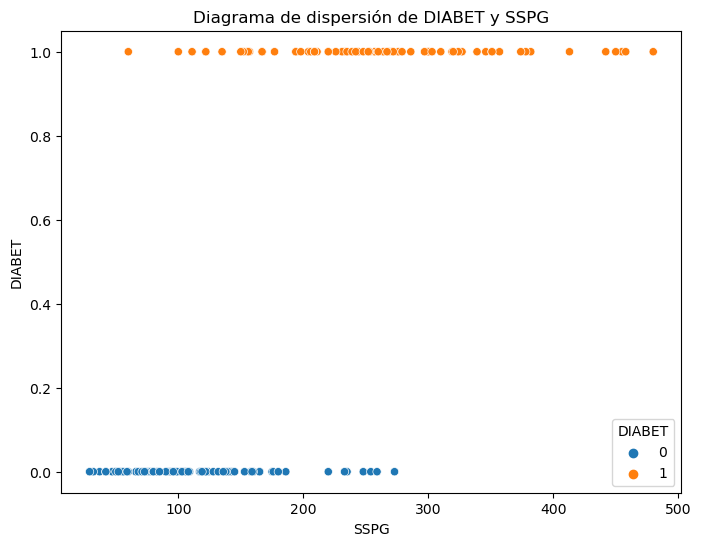

   GROUP  Mean_DIABET  Count
0      1          0.0     76
1      2          1.0     36
2      3          1.0     34
Coeficiente de SSPG: 0.02536034222162619
Intercepto: -4.498137574763473


In [105]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

# Cargar los datos
diabetes_data = pd.read_excel('Diabetes.xls')

# Box-plot para SSPG en grupos con y sin diabetes
plt.figure(figsize=(8, 6))
sns.boxplot(x='DIABET', y='SSPG', data=diabetes_data)
plt.title('Box-plot de SSPG por grupos con y sin diabetes')
plt.show()

# Comparar los valores medios
mean_sspg_diabetes = diabetes_data[diabetes_data['DIABET'] == 1]['SSPG'].mean()
mean_sspg_no_diabetes = diabetes_data[diabetes_data['DIABET'] == 0]['SSPG'].mean()

print(f"Valor medio de SSPG para diabetes: {mean_sspg_diabetes}")
print(f"Valor medio de SSPG para no diabetes: {mean_sspg_no_diabetes}")

# Diagrama de dispersión de DIABET y SSPG
plt.figure(figsize=(8, 6))
sns.scatterplot(x='SSPG', y='DIABET', data=diabetes_data, hue='DIABET', marker='o')
plt.title('Diagrama de dispersión de DIABET y SSPG')
plt.xlabel('SSPG')
plt.ylabel('DIABET')
plt.show()

# Construir una tabla con medias de edad y proporción de DIABET para cada grupo etáreo
age_diabetes_mean = diabetes_data.groupby('GROUP')['DIABET'].agg(['mean', 'count']).reset_index()
age_diabetes_mean.columns = ['GROUP', 'Mean_DIABET', 'Count']

print(age_diabetes_mean)

# Dividir los datos en conjunto de entrenamiento y validación
X_train, X_val, y_train, y_val = train_test_split(diabetes_data[['SSPG']], diabetes_data['DIABET'], test_size=0.3, random_state=42)

# Ajustar el modelo de regresión logística
logreg_model = LogisticRegression()
logreg_model.fit(X_train, y_train)

# (e) Interpretar los coeficientes obtenidos en términos del problema planteado.
# Coeficientes y punto de corte del modelo
coeficientes = logreg_model.coef_[0]
intercepto = logreg_model.intercept_[0]

print(f"Coeficiente de SSPG: {coeficientes[0]}")
print(f"Intercepto: {intercepto}")

In [107]:
# Definir el valor de SSPG para la predicción
sspg_value = 100

# Calcular el logit
logit_value = intercepto + coeficientes[0] * sspg_value

# Calcular las odds
odds_value = np.exp(logit_value)

# Calcular la probabilidad
prob_diabetes = odds_value / (1 + odds_value)

print(f"Logit para SSPG = {sspg_value}: {logit_value}")
print(f"Odds para SSPG = {sspg_value}: {odds_value}")
print(f"Probabilidad de tener diabetes para SSPG = {sspg_value}: {prob_diabetes}")

from statsmodels.stats import proportion

# Ajustar modelo logístico usando statsmodels para obtener el intervalo de confianza
X_train_statsmodels = sm.add_constant(X_train)
logit_model_statsmodels = sm.Logit(y_train, X_train_statsmodels)
result_statsmodels = logit_model_statsmodels.fit()

# Obtener el intervalo de confianza del 95% para el Odds Ratio
odds_ratio_ci = result_statsmodels.conf_int(alpha=0.05, cols=None)

print(f"Intervalo de confianza del 95 % para Odds Ratio: \n{odds_ratio_ci}")

Logit para SSPG = 100: -1.9621033526008542
Odds para SSPG = 100: 0.14056245736202347
Probabilidad de tener diabetes para SSPG = 100: 0.12323959679255675
Optimization terminated successfully.
         Current function value: 0.378906
         Iterations 7
Intervalo de confianza del 95 % para Odds Ratio: 
              0         1
const -6.179669 -2.816802
SSPG   0.016135  0.034586


In [128]:
# Predecir en el conjunto de validación
X_val_statsmodels = sm.add_constant(X_val)
y_pred_val = logreg_model.predict(X_val)

# Crear una matriz de confusión
conf_matrix = confusion_matrix(y_val, y_pred_val)
print(f"Matriz de Confusión: \n{conf_matrix}")

from statsmodels.stats import diagnostic

# Calcular la estadística de prueba y el p-valor
hl_stat, hl_p_value = HosmerLemeshow(logreg_model, y_val, X_val) #CONSULTAR!!!!!!!!!!!!!

print(f"Estadística de prueba de Hosmer-Lemeshow: {hl_stat}")
print(f"P-valor: {hl_p_value}")

from sklearn.metrics import roc_auc_score

# Calcular el AUC
auc_score = roc_auc_score(y_val, y_pred_val)

print(f"Área Bajo la Curva ROC: {auc_score}")


Matriz de Confusión: 
[[23  2]
 [ 4 15]]
Estadística de prueba de Hosmer-Lemeshow: Chi2
P-valor: p_value
Área Bajo la Curva ROC: 0.8547368421052632


C:\Users\jfran\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\jfran\anaconda3\lib\site-packages\numpy\core\_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [126]:
HosmerLemeshow(logreg_model, y_val, X_val)

C:\Users\jfran\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\jfran\anaconda3\lib\site-packages\numpy\core\_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,Chi2,p_value
0,NaN,NaN


In [124]:
import matplotlib.pyplot as plt

import pandas as pd 
import numpy as np
from scipy.stats import chi2

# This could be made into a neat function of Hosmer-Lemeshow. 
def HosmerLemeshow (model,Y,X_val):
    
    pihat=model.predict(X_val)
    pihatcat=pd.cut(pihat, np.percentile(pihat,[0,25,50,75,100]),labels=False,include_lowest=True, duplicates='drop') #here we've chosen only 4 groups


    meanprobs =[0]*4 
    expevents =[0]*4
    obsevents =[0]*4 
    meanprobs2=[0]*4 
    expevents2=[0]*4
    obsevents2=[0]*4 

    for i in range(4):
       meanprobs[i]=np.mean(pihat[pihatcat==i])
       expevents[i]=np.sum(pihatcat==i)*np.array(meanprobs[i])
       obsevents[i]=np.sum(Y[pihatcat==i])
       meanprobs2[i]=np.mean(1-pihat[pihatcat==i])
       expevents2[i]=np.sum(pihatcat==i)*np.array(meanprobs2[i])
       obsevents2[i]=np.sum(1-Y[pihatcat==i]) 


    data1={'meanprobs':meanprobs,'meanprobs2':meanprobs2}
    data2={'expevents':expevents,'expevents2':expevents2}
    data3={'obsevents':obsevents,'obsevents2':obsevents2}
    m=pd.DataFrame(data1)
    e=pd.DataFrame(data2)
    o=pd.DataFrame(data3)
    
    # The statistic for the test, which follows, under the null hypothesis,
    # The chi-squared distribution with degrees of freedom equal to amount of groups - 2. Thus 4 - 2 = 2
    tt=sum(sum((np.array(o)-np.array(e))**2/np.array(e))) 
    pvalue=1-chi2.cdf(tt,2)

    return pd.DataFrame([[chi2.cdf(tt,2).round(2), pvalue.round(2)]],columns = ["Chi2", "p_value"])


## Ejercicio 5.3. 

Utilizaremos los datos que se encuentran en el archivo bajopeso.xlsx de un estudio, cuyo objetivo era identificar factores de riesgo asociados con el bajo peso al nacimiento (menor a 2500 gramos), se registraron las variables que se presentan en la siguiente tabla en 190 mujeres en el momento del parto. Los datos están disponibles en shorturl.at/dkpyZ.

ID: Código de Identificación
LOW: variable categórica que indica 1(bajo peso al nacer) 0(no).
AGE: edad de la madre en años.
LWT: peso de la madre en libras en el último periodo menstrual.
RACE: variable categórica con niveles: 1(blanca), 2(negra) y 3(otra.)
SMOKE: variable categórica con dos niveles 1(fumó durante el embarazo) y 0 (no).
PTL: cantidad de episodios de trabajo de parto prematuro.
HT: antecedentes de hipertensión 1 (si) y 0 (no).
UI: presencia de irritabilidad uterina 1(si) y 0(no).
FTV: cantidad de consultas durante el primer trimestre.

### a) Estudie la relación entre bajo peso al nacer (LOW =1) y fumar durante el embarazo (SMOKE=1) mediante un modelo logístico.

### b) Escriba la expresión del modelo ajustado e interprete los coeficientes. Es significativa la variable smoke? Básese en el test de Wald para responder a esta pregunta.

### c) Construya la matriz de confusión para un conjunto de validación de un tercio de la base.

### d) Testee basándose en la verosimilitud este modelo versus otro que considere también la edad de la madre. Interprete los resultados.

In [158]:
import statsmodels.api as sm
import pandas as pd
from scipy.stats import chi2

df=pd.read_excel('bajo_peso.xlsx')
# Definir las variables independientes y dependientes
X = df.drop('LOW', axis=1)
y = df['LOW']

# Ajustar el modelo logístico
model = sm.Logit(y, X['SMOKE']).fit()

# Imprimir el resumen del modelo
print(model.summary())

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

# Dividir los datos
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.33, random_state=42)

# Ajustar el modelo en los datos de entrenamiento
model_train = sm.Logit(y_train, X_train).fit()

# Predecir en los datos de validación
y_pred = model_train.predict(X_valid)
threshold = 0.5  # Punto de corte

# Crear la matriz de confusión
conf_matrix = confusion_matrix(y_valid, y_pred > threshold)
print("Matriz de Confusión:")
print(conf_matrix)

# Ajustar modelo solo con SMOKE
model_smoke = sm.Logit(y_train, X_train[['SMOKE']]).fit()

# Ajustar modelo con SMOKE y AGE
model_smoke_age = sm.Logit(y_train, X_train[['SMOKE','AGE']]).fit()

# Calcula la estadística de prueba de razón de verosimilitud (LR test)
LR = 2 * abs(model_smoke.llf - model_smoke_age.llf) ## Consultar!!!! Log likelihood of model
p_value = 1 - chi2.cdf(LR, 1)

print(f"La estadística de prueba de razón de verosimilitud es {LR:.4f} y el valor p es {p_value:.4f}.")

Optimization terminated successfully.
         Current function value: 0.687187
         Iterations 4
                           Logit Regression Results                           
Dep. Variable:                    LOW   No. Observations:                  190
Model:                          Logit   Df Residuals:                      189
Method:                           MLE   Df Model:                            0
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                 -0.1019
Time:                        16:41:09   Log-Likelihood:                -130.57
converged:                       True   LL-Null:                       -118.49
Covariance Type:            nonrobust   LLR p-value:                       nan
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
SMOKE         -0.3502      0.234     -1.493      0.135      -0.810       0.109
Optimization terminated succe

# 5.2. Modelo Multivariado

## Ejercicio 5.4.

El 4 de julio de 1999 una tormenta con vientos que excedían los 145 kilómetros por hora azotó el nordeste de Minnesota, en EEUU, causando graves daños en un parque natural de la zona. Los científicos analizaron los efectos de la tormenta determinando para más de 3600 árboles del parque, su diámetro en cm, una medida de la severidad local de la tormenta relacionada con el porcentaje inerte de área basal de cuatro especies, una variable que registraba si cada árbol había muerto (Y=1) o si había soportado la tormenta (Y=0) y finalmente la especie a la que pertenecía cada árbol. Estos datos se encuentran en el archivo tormenta.xlsx disponibles en [este enlace](shorturl.at/ACFHN). Fueron analizados por Weisberg et al. (2005).

### a) Análisis de Supervivencia

- ¿Hay alguna especie que le parece que sobrevivió más que otra?
- ¿Considera que la supervivencia se asocia con la severidad de la tormenta?
- ¿Y con el diámetro del árbol?

### b) Modelo con Diámetro

Proponga un modelo que sólo utilice como predictora la variable diámetro. Halle la bondad de ajuste y la precisión de la predicción lograda.

### c) Modelo con Diámetro y Severidad

Proponga un segundo modelo que considere como predictoras al diámetro y a la severidad de la tormenta. Halle la bondad de ajuste y la precisión de la predicción lograda.

### d) Comparación de Modelos

Compare ambos modelos considerando la verosimilitud, la bondad de ajuste y el área bajo la curva ROC de cada uno.

### e) Estimación de Probabilidad

Estimar la probabilidad de que no sobreviva un árbol cuyo diámetro es de 30 cm y esté situado en una zona en la que la fuerza de la tormenta viene dada por S=0.8.

### f) Comparación de Precisión

Compare la precisión del mejor de los modelos con un análisis discriminante lineal y con un análisis discriminante cuadrático.


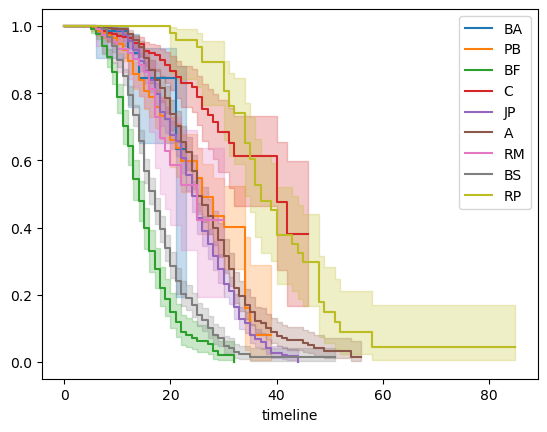

In [20]:
import pandas as pd
import lifelines as ll
from lifelines.statistics import logrank_test

# Cargar los datos
df = pd.read_excel("tormenta.xlsx")

# Estimar la función de supervivencia y realizar la prueba de log-rank
kmf = ll.KaplanMeierFitter()

# a.1) Comparar supervivencia entre especies
groups_species = df['especie'].unique()
for species in groups_species:
    data_species = df[df['especie'] == species]
    kmf.fit(data_species['diametro'], event_observed=data_species['murio'])
    kmf.plot_survival_function(label=species)

In [21]:
# a.2) Comparar supervivencia con severidad de la tormenta
logrank_test(df['severidad'], df['murio'], alpha=0.95)

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
             alpha = 0.95
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
        5763.01 <0.005       inf

In [22]:
# a.3) Comparar supervivencia con diámetro del árbol
logrank_test(df['diametro'], df['murio'], alpha=0.95)

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
             alpha = 0.95
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
        7535.51 <0.005       inf

In [25]:
from lifelines.utils import concordance_index
from sklearn.metrics import roc_curve, auc
from lifelines import CoxPHFitter

# Modelo con diámetro
cox_model_diameter = ll.CoxPHFitter()
cox_model_diameter.fit(df[['diametro', 'murio']], 'murio')
cox_model_diameter.print_summary()

# Verosimilitud
print(f"La verosimilitud es {cox_model_diameter.log_likelihood_:.4f}.")

# Evaluar la bondad de ajuste del modelo con diámetro
results_diameter = cox_model_diameter.summary
c_index_diameter = concordance_index(df['diametro'], -cox_model_diameter.predict_partial_hazard(df), df['murio'])
print(f"El valor del índice de concordancia (C-index) para el modelo con diámetro es {c_index_diameter:.4f}.")

# Evaluar la precisión de la predicción del modelo con diámetro
fpr_diameter, tpr_diameter, thresholds_diameter = roc_curve(df['murio'], -cox_model_diameter.predict_partial_hazard(df))
auc_diameter = auc(fpr_diameter, tpr_diameter)
print(f"El valor del área bajo la curva ROC (AUC) para el modelo con diámetro es {auc_diameter:.4f}.")

# Modelo con diámetro y severidad
cox_model_combined = ll.CoxPHFitter()
cox_model_combined.fit(df[['diametro', 'severidad', 'murio']], 'murio')
cox_model_combined.print_summary()

# Verosimilitud
print(f"La verosimilitud es {cox_model_combined.log_likelihood_:.4f}.")

# Evaluar la bondad de ajuste del modelo con diámetro y severidad
results_combined = cox_model_combined.summary
c_index_combined = concordance_index(df[['diametro']], -cox_model_combined.predict_partial_hazard(df), df['murio']) # revisar por que no admite df[['diametro','severidad']]
print(f"El valor del índice de concordancia (C-index) para el modelo con diámetro y severidad es {c_index_combined:.4f}.")

# Evaluar la precisión de la predicción del modelo con diámetro y severidad
fpr_combined, tpr_combined, thresholds_combined = roc_curve(df['murio'], -cox_model_combined.predict_partial_hazard(df))
auc_combined = auc(fpr_combined, tpr_combined)
print(f"El valor del área bajo la curva ROC (AUC) para el modelo con diámetro y severidad es {auc_combined:.4f}.")


<lifelines.CoxPHFitter: fitted with 3666 total observations, 0 right-censored observations>
             duration col = 'murio'
      baseline estimation = breslow
   number of observations = 3666
number of events observed = 3666
   partial log-likelihood = -26293.14
         time fit was run = 2023-11-23 22:38:09 UTC

---
            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                         
diametro   -0.03       0.97       0.00            -0.04            -0.03                 0.96                 0.97

            cmp to      z      p   -log2(p)
covariate                                  
diametro      0.00 -15.54 <0.005     178.39
---
Concordance = 0.73
Partial AIC = 52588.28
log-likelihood ratio test = 264.44 on 1 df
-log2(p) of ll-ratio test = 195.11

La verosimilitud es -26293.1395.
El valor del índice de concordancia (C-index) para el modelo con diámetro es 0.9763.
El valor del área bajo la curva ROC (AUC) para el modelo con diámetro es 0.7335.


<lifelines.CoxPHFitter: fitted with 3666 total observations, 0 right-censored observations>
             duration col = 'murio'
      baseline estimation = breslow
   number of observations = 3666
number of events observed = 3666
   partial log-likelihood = -26125.04
         time fit was run = 2023-11-23 22:38:09 UTC

---
            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                         
diametro   -0.03       0.97       0.00            -0.03            -0.03                 0.97                 0.97
severidad  -0.14       0.87       0.01            -0.15            -0.12                 0.86                 0.88

            cmp to      z      p   -log2(p)
covariate                                  
diametro      0.00 -13.70 <0.005     139.50
severidad     0.00 -18.14 <0.005     241.95
---
Concordance = 0.81
Partial AIC = 52254.08
log-likelihood ratio test = 600.63 on 2 df
-log2(p) of ll-ratio test = 433.26

La verosimilitud es -26125.0420.
El valor del índice de concordancia (C-index) para el modelo con diámetro y severidad es 0.6050.
El valor del área bajo la curva ROC (AUC) para el modelo con diámetro y severidad es 0.8124.


In [253]:
new_data = pd.DataFrame({'diametro': [30], 'severidad': [0.8]})

# Estimar la probabilidad de supervivencia
prob_survival = cox_model_combined.predict_survival_function(new_data, times=[0])
prob_not_survive = 1 - prob_survival.iloc[0, 0]

print(f"Probabilidad de no sobrevivir: {prob_not_survive:.4f}")

Probabilidad de no sobrevivir: 0.4000


In [248]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

# Supongamos que X es el conjunto de características y y es la variable de respuesta
X = df[['diametro', 'severidad']]
y = df['murio']

# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Ajustar modelos de análisis discriminante lineal y cuadrático
lda_model = LinearDiscriminantAnalysis()
lda_model.fit(X_train, y_train)

qda_model = QuadraticDiscriminantAnalysis()
qda_model.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred_lda = lda_model.predict(X_test)
y_pred_qda = qda_model.predict(X_test)

# Calcular la precisión
accuracy_lda = accuracy_score(y_test, y_pred_lda)
accuracy_qda = accuracy_score(y_test, y_pred_qda)

print(f"Precisión (LDA): {accuracy_lda:.4f}")
print(f"Precisión (QDA): {accuracy_qda:.4f}")

# Construir matriz de confusión para el mejor modelo de regresión de Cox
y_pred_cox = cox_model_combined.predict_expectation(X_test)
y_pred_cox_binary = (y_pred_cox > 0.5).astype(int)

# Calcular la precisión
accuracy_cox = accuracy_score(y_test, y_pred_cox_binary)
print(f"Precisión (Cox): {accuracy_cox:.4f}")


Precisión (LDA): 0.7418
Precisión (QDA): 0.7400
Precisión (Cox): 0.6982


# 5.5. Modelo de Regresión Logística para Cáncer de Próstata

## Ejercicio 5.5.

Se ha conducido un estudio acerca de cáncer de próstata. Se analizó una base de una muestra aleatoria de 100 pacientes masculinos. Los datos corresponden al archivo prostata.xlsx. Sobre cada paciente se le han medido las siguientes variables o características:

- `volumen_pros`: Volumen de la próstata estimado.
- `peso_pros`: Peso de la próstata estimado.
- `penetrac_capsular`: Variable categórica que indica invasión de la cápsula.
- `invade_vesic_semin`: Variable categórica que indica invasión de la vesícula seminal.
- `gleason`: Indicador de características de agresividad de las células.
- `Edad`: Edad del paciente.
- `log_psa`: Logaritmo natural del indicador de antígeno prostático.

### a) Construcción del Modelo

Construye un modelo de regresión logística a fin de establecer una relación que permita predecir la presencia de invasión de las vesículas seminales.

### b) Selección de Variables

Selecciona la/s variable/s adecuadas para informar cuáles de las variables incluidas en el modelo inicial son significativas.

### c) Modelo Final

Escribe la expresión del modelo final si solo se incluyeran en él las variables que resultaron significativas.

### d) Interacciones Dobles

Prueba interacciones dobles e incluye alguna en el modelo si resulta significativa.

### e) Clasificación de Individuos

Considerando como valor de corte 0.5, clasifica un individuo que tiene Gleason 4 y penetración capsular.

In [261]:
df

,volumen_pros,peso_pros,edad,log_hiperp_benig,invade_vesic_semin,penetrac_capsular,gleason,porc_punt_gleas_45,log_psa
0,-0.579818,2.769459,50,-1.386294,0,-1.386294,6,0,-0.430783
1,-0.994252,3.319626,58,-1.386294,0,-1.386294,6,0,-0.162519
2,-0.510826,2.691243,74,-1.386294,0,-1.386294,7,20,-0.162519
3,-1.203973,3.282789,58,-1.386294,0,-1.386294,6,0,-0.162519
4,0.751416,3.432373,62,-1.386294,0,-1.386294,6,0,0.371564
...,...,...,...,...,...,...,...,...,...
94,2.882564,3.773910,68,1.558145,1,1.558145,7,80,5.477509
95,3.471966,3.974998,68,0.438255,1,2.904165,7,20,5.582932
96,1.189511,4.791020,72,2.326302,0,-0.798402,7,5,2.972975
97,1.874400,3.601420,60,-1.386294,1,1.321756,7,59,3.013081


In [262]:
import pandas as pd
import statsmodels.api as sm

# Cargar los datos
df = pd.read_csv("prostata.csv", sep=';')

# Definir las variables independientes (X) y la variable dependiente (y)
X = df[['volumen_pros', 'peso_pros', 'penetrac_capsular', 'gleason', 'edad', 'log_psa']]
y = df['invade_vesic_semin']

# Agregar una constante a X para el término independiente
X = sm.add_constant(X)

# Ajustar el modelo de regresión logística
logit_model = sm.Logit(y, X)
result = logit_model.fit()

# Mostrar los resultados del modelo
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.202877
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:     invade_vesic_semin   No. Observations:                   99
Model:                          Logit   Df Residuals:                       92
Method:                           MLE   Df Model:                            6
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.6170
Time:                        18:24:26   Log-Likelihood:                -20.085
converged:                       True   LL-Null:                       -52.441
Covariance Type:            nonrobust   LLR p-value:                 4.939e-12
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -7.0715      6.742     -1.049      0.294     -20.285       6.142
volumen_

In [268]:
# Definir las variables independientes (X) y la variable dependiente (y) con variables significativas
X_significativas = df[['log_psa', 'penetrac_capsular', 'edad']] # Elegí por su p valor
y_significativas = df['invade_vesic_semin']

# Agregar una constante a X_significativas para el término independiente
X_significativas = sm.add_constant(X_significativas)

# Ajustar el modelo de regresión logística con variables significativas
logit_model_significativas = sm.Logit(y_significativas, X_significativas)
result_significativas = logit_model_significativas.fit()

# Mostrar los resultados del modelo con variables significativas
print(result_significativas.summary())


Optimization terminated successfully.
         Current function value: 0.206107
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:     invade_vesic_semin   No. Observations:                   99
Model:                          Logit   Df Residuals:                       95
Method:                           MLE   Df Model:                            3
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.6109
Time:                        18:40:26   Log-Likelihood:                -20.405
converged:                       True   LL-Null:                       -52.441
Covariance Type:            nonrobust   LLR p-value:                 7.920e-14
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const               -10.7037      5.085     -2.105      0.035     -20.670      -0.737
log_psa 

In [269]:
import statsmodels.formula.api as smf

# Agregar interacciones dobles y ajustar el modelo
# Ajustar el modelo de regresión logística con interacciones
logit_model_interacciones = smf.logit(formula='invade_vesic_semin ~ log_psa*edad + penetrac_capsular*edad+log_psa*penetrac_capsular', data=df)#(y_significativas, X_interacciones)
result_interacciones = logit_model_interacciones.fit()

# Mostrar los resultados del modelo con interacciones dobles
print(result_interacciones.summary())

Optimization terminated successfully.
         Current function value: 0.185611
         Iterations 11
                           Logit Regression Results                           
Dep. Variable:     invade_vesic_semin   No. Observations:                   99
Model:                          Logit   Df Residuals:                       92
Method:                           MLE   Df Model:                            6
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.6496
Time:                        18:42:04   Log-Likelihood:                -18.375
converged:                       True   LL-Null:                       -52.441
Covariance Type:            nonrobust   LLR p-value:                 9.878e-13
                                coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept                    -8.6167     18.372     -0.469      0.639     -44

In [270]:
import statsmodels.formula.api as smf

# Agregar interacciones dobles y ajustar el modelo
# Ajustar el modelo de regresión logística con interacciones
logit_model_interacciones = smf.logit(formula='invade_vesic_semin ~ penetrac_capsular*edad+log_psa', data=df)
result_interacciones = logit_model_interacciones.fit()

# Mostrar los resultados del modelo con interacciones dobles
print(result_interacciones.summary())

Optimization terminated successfully.
         Current function value: 0.198240
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:     invade_vesic_semin   No. Observations:                   99
Model:                          Logit   Df Residuals:                       94
Method:                           MLE   Df Model:                            4
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.6258
Time:                        18:43:37   Log-Likelihood:                -19.626
converged:                       True   LL-Null:                       -52.441
Covariance Type:            nonrobust   LLR p-value:                 1.895e-13
                             coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                 -8.3097      4.677     -1.777      0.076     -17.476      

In [272]:
import statsmodels.formula.api as smf

# Clasificar un individuo con Gleason 4 y penetración capsular
logit_model_interacciones = smf.logit(formula='invade_vesic_semin ~ penetrac_capsular+gleason', data=df)#(y_significativas, X_interacciones)
result_interacciones = logit_model_interacciones.fit()

new_data = pd.DataFrame({'penetrac_capsular': [1], 'gleason': [4]})
new_data = sm.add_constant(new_data)

# Predecir la probabilidad de invasión de vesículas seminales
prob_prediction = result_interacciones.predict(new_data)

# Clasificar el individuo con un umbral de 0.5
clasificacion = (prob_prediction >= 0.5).astype(int)

print(f"Probabilidad de invasión de vesículas seminales: {prob_prediction.iloc[0]:.4f}")
print(f"Clasificación con umbral de 0.5: {clasificacion.iloc[0]}")

Optimization terminated successfully.
         Current function value: 0.286811
         Iterations 7
Probabilidad de invasión de vesículas seminales: 0.4626
Clasificación con umbral de 0.5: 0


# 5.6. Modelo Logístico para Diabetes en Mujeres Pima

## Ejercicio 5.6.

Una población de mujeres que tenían al menos 21 años de edad, descendientes de indígenas pima y que vivían cerca de Phoenix, Arizona, se sometieron a pruebas de diabetes de acuerdo con los criterios de la Organización Mundial de la Salud. Los datos fueron recopilados por el Instituto Nacional de Diabetes y Enfermedades Digestivas y Renales de EE. UU. Usamos los 532 registros completos después de descartar los datos (principalmente faltantes) sobre la insulina sérica. La base está disponible en la biblioteca Mass de R con el nombre Pima.tr.

### a) Ajuste del Modelo Logístico

Ajusta un modelo logístico considerando como variable predictora el `bmi` y como respuesta `type`. Utiliza el test de razón de verosimilitudes para evaluar la significación del modelo, comparándolo con el modelo nulo.

### b) Variable Categórica de Embarazos Previos

Define una variable categórica que separe a las mujeres que no han tenido embarazos previos de las que sí. Ajusta un modelo para evaluar si esta variable es significativa para predecir `type`.

### c) Modelo con Edad, Variable Categórica y BMI

Ajusta un modelo utilizando como predictoras la edad, la variable categórica definida en el ítem anterior y el `bmi`.

### d) Modelo con Edad, BMI y Número de Embarazos Previos

Ajusta un modelo utilizando como predictoras la edad, el `bmi` y el número de embarazos previos.

### e) Selección del Mejor Modelo

Selecciona el mejor modelo mediante el test de razón de verosimilitudes.


In [43]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
import statsmodels.formula.api as smf
import numpy as np
from scipy.stats import chi2

df = pd.read_csv('Pimatr.csv')
df['type'] = list(map(lambda x: 1 if x == "Yes" else 0, df['type']))

logit_model = smf.logit(formula='type ~ bmi', data=df)
logit_result = logit_model.fit()

X_nulo = np.ones((len(df['type']), 1))  # Matriz de unos para la constante

# 'y' es tu variable de respuesta binaria
y = df['type'].values

# Crear y ajustar el modelo nulo
modelo_nulo = LogisticRegression(penalty=None, solver='newton-cg')
modelo_nulo.fit(X_nulo, y)

# Calcula la estadística de prueba de razón de verosimilitud (LR test)
LR = 2 * (logit_result.llf - modelo_nulo.score(X_nulo, y))# ESTO ESTA MAL ¿Como obtengo el llf del modelo nulo?
p_value = 1 - chi2.cdf(LR, 1)
print(f"La estadística de prueba de razón de verosimilitud es {LR:.4f} y el valor p es {p_value:.4f}.")

Optimization terminated successfully.
         Current function value: 0.599923
         Iterations 5
La estadística de prueba de razón de verosimilitud es -241.2892 y el valor p es 1.0000.


In [44]:
# Define la variable categórica 'embarazos_previos'
df['embarazos_previos'] = (df['npreg'] > 0).astype(int)

# Ajustar el modelo para evaluar la variable categórica
logit_preg = smf.logit(formula='type ~ embarazos_previos', data=df)
logit_preg_result = logit_preg.fit()


# Mostrar los resultados del modelo con la variable categórica
print(logit_preg_result.summary())

Optimization terminated successfully.
         Current function value: 0.638272
         Iterations 4
                           Logit Regression Results                           
Dep. Variable:                   type   No. Observations:                  200
Model:                          Logit   Df Residuals:                      198
Method:                           MLE   Df Model:                            1
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                0.004312
Time:                        20:28:29   Log-Likelihood:                -127.65
converged:                       True   LL-Null:                       -128.21
Covariance Type:            nonrobust   LLR p-value:                    0.2931
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            -0.2877      0.382     -0.753      0.451      -1.036       0.461
embarazo

In [45]:
# Ajustar el modelo
logit_multi = smf.logit(formula='type ~ embarazos_previos + age + bmi', data=df)
logit_multi_result = logit_multi.fit()


# Mostrar los resultados del modelo con la variable categórica
print(logit_multi_result.summary())

Optimization terminated successfully.
         Current function value: 0.532389
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                   type   No. Observations:                  200
Model:                          Logit   Df Residuals:                      196
Method:                           MLE   Df Model:                            3
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.1695
Time:                        20:28:30   Log-Likelihood:                -106.48
converged:                       True   LL-Null:                       -128.21
Covariance Type:            nonrobust   LLR p-value:                 1.967e-09
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            -5.7619      1.237     -4.659      0.000      -8.186      -3.338
embarazo

In [46]:
# Ajustar el modelo
logit_multi_b = smf.logit(formula='type ~ npreg + age + bmi', data=df)
logit_multi_result_b = logit_multi_b.fit()


# Mostrar los resultados del modelo con la variable categórica
print(logit_multi_result_b.summary())

Optimization terminated successfully.
         Current function value: 0.536562
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                   type   No. Observations:                  200
Model:                          Logit   Df Residuals:                      196
Method:                           MLE   Df Model:                            3
Date:                Thu, 23 Nov 2023   Pseudo R-squ.:                  0.1630
Time:                        20:28:30   Log-Likelihood:                -107.31
converged:                       True   LL-Null:                       -128.21
Covariance Type:            nonrobust   LLR p-value:                 4.447e-09
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -6.4446      1.184     -5.445      0.000      -8.764      -4.125
npreg          0.0651      0.

In [48]:
# Calcula la estadística de prueba de razón de verosimilitud (LR test)
LR = 2 * (logit_multi_result_b.llf - logit_multi_result.llf)
p_value = 1 - chi2.cdf(LR, 1)
print(f"La estadística de prueba de razón de verosimilitud es {LR:.4f} y el valor p es {p_value:.4f}.")

La estadística de prueba de razón de verosimilitud es -1.6694 y el valor p es 1.0000.
